In [1]:
import sys 
sys.path.append("/mnt/shared/users/wessim.omezzine/hip-analysis")
from hip.analysis.aoi import AnalysisArea
from hip.analysis.data._datasources import DATASOURCE_CONFIGS
import os
import dask
from dask.distributed import Client, progress
import rioxarray as rxr
import glob
import tqdm
import numpy as np
import matplotlib.pyplot as plt
import netCDF4 as nc
import datetime

import numpy as np
import matplotlib.pyplot as plt
import torch
import pandas as pd
import rasterio

import warnings
warnings.filterwarnings("ignore")

import s3fs
import xarray as xr
import dask
# Create a dask client to distribute (speed up) the coputation

# if dashboard.link set to default value and running behind hub, make dashboard link go via proxy
if dask.config.get("distributed.dashboard.link") == '{scheme}://{host}:{port}/status':
    jup_prefix = os.environ.get('JUPYTERHUB_SERVICE_PREFIX')
    if jup_prefix is not None:
        jup_prefix = jup_prefix.rstrip('/')
        dask.config.set({"distributed.dashboard.link": f"{jup_prefix}/proxy/{{port}}/status"})

client = Client()
client

GDAL_DATA                    = /envs/user/fix_hdc/share/gdal
GDAL_DISABLE_READDIR_ON_OPEN = EMPTY_DIR
GDAL_HTTP_MAX_RETRY          = 10
GDAL_HTTP_RETRY_DELAY        = 0.5
AWS_ACCESS_KEY_ID            = xx..xx
AWS_SECRET_ACCESS_KEY        = xx..xx
AWS_SESSION_TOKEN            = xx..xx


INFO:distributed.http.proxy:To route to workers diagnostics web server please install jupyter-server-proxy: python -m pip install jupyter-server-proxy
INFO:distributed.scheduler:State start
INFO:distributed.scheduler:  Scheduler at:     tcp://127.0.0.1:35531
INFO:distributed.scheduler:  dashboard at:  /user/wessim.omezzine/proxy/8787/status
INFO:distributed.nanny:        Start Nanny at: 'tcp://127.0.0.1:33363'
INFO:distributed.nanny:        Start Nanny at: 'tcp://127.0.0.1:36861'
INFO:distributed.nanny:        Start Nanny at: 'tcp://127.0.0.1:35863'
INFO:distributed.nanny:        Start Nanny at: 'tcp://127.0.0.1:40681'
INFO:distributed.scheduler:Register worker <WorkerState 'tcp://127.0.0.1:34473', name: 1, status: init, memory: 0, processing: 0>
INFO:distributed.scheduler:Starting worker compute stream, tcp://127.0.0.1:34473
INFO:distributed.core:Starting established connection to tcp://127.0.0.1:57020
INFO:distributed.scheduler:Register worker <WorkerState 'tcp://127.0.0.1:40249', na

Connection method: Cluster object,Cluster type: distributed.LocalCluster
Dashboard: /user/wessim.omezzine/proxy/8787/status,
Dashboard: /user/wessim.omezzine/proxy/8787/status,Workers: 4
Total threads: 4,Total memory: 15.20 GiB
Status: running,Using processes: True
Comm: tcp://127.0.0.1:35531,Workers: 4
Dashboard: /user/wessim.omezzine/proxy/8787/status,Total threads: 4
Started: Just now,Total memory: 15.20 GiB
Comm: tcp://127.0.0.1:44901,Total threads: 1
Dashboard: /user/wessim.omezzine/proxy/46075/status,Memory: 3.80 GiB
Nanny: tcp://127.0.0.1:33363,


In [2]:
def seasonality(bbox,start=True):
    
    longitude_1, longitude_2  = bbox[0], bbox[2] 
    lattitude_1, lattitude_2  = bbox[1], bbox[3]
    ## Read a particular index for each year 
    
    if start:
        file_list = [f"/s3/scratch/public-share/seasonality/1_soc_eoc/soc_1_idx_from_r1h_lta.tif" ]
    else:
        file_list = [f"/s3/scratch/public-share/seasonality/1_soc_eoc/eoc_1_idx_from_r1h_lta.tif" ]

    
    print(longitude_1, longitude_2)
    test = xr.open_mfdataset(file_list, 
                             engine='rasterio', 
                             combine='nested',
                             parallel=True)
    
    print(test)
    data = test.band_data.isel(band=0)
    # data = data.sel(x=slice(lattitude_1, lattitude_2), y =slice(longitude_1, longitude_2))
    data = data.sel(y=slice(lattitude_2, lattitude_1))
    data = data.sel(x=slice(longitude_1, longitude_2))
    
    
    # data.sel(latitude=slice(lattitude_1, lattitude_2), longitude=slice(longitude_1, longitude_2), method='nearest')
    return data
    




# Indonesia

In [2]:
region="Indonesia"

### Extract Seasonality

In [3]:
start_season =2
end_season =7

## Import RFH CHIRPS

In [ ]:
bbox = (110.214844,-2.416276,116.037598,1.515936) 
area = AnalysisArea(
    bbox=bbox,
    datetime_range="1983-01-01/2023-06-30"  # change the starting date 1983  
)
rfh = area.get_dataset(["CHIRPS","rfh_dekad"])
r1h = area.get_dataset(["CHIRPS","r1h_dekad"])


In [ ]:
rfh = rfh.load()
r1h = r1h.load()

In [ ]:
rfh = rfh.sel(time=rfh['time.month'].isin(range(2, 7)))
r1h = r1h.sel(time=r1h['time.month'].isin(range(2, 7))) # déjà rolled

## Import ECMWF Prediction

In [ ]:
path_issue = f's3://wfp-seasmon/zarr/seasonal-forecasts/0{start_season-1}/01'

with dask.config.set(**{'array.slicing.split_large_chunks': False}):
    ds_issue = xr.open_mfdataset(f'{path_issue}/*.zarr', chunks={"latitude":36, "longitude":70, "ensemble":-1}, engine='zarr')
ds_issue = ds_issue.sel(latitude = slice(bbox[3], bbox[1]),longitude = slice(bbox[0], bbox[2])) 

In [ ]:
ds_issue = ds_issue.tp.load()

In [10]:
da_issue= ds_issue.groupby("time.year").apply(lambda da :  da.diff(dim='time', n=1))
da_issue = da_issue.mean("ensemble") #Output 1 ensemble
#da_issue = da_issue.diff(dim='time', n=1).fillna(0)  # Non cumulative

In [11]:
# DONT RUN only for dekad!!!!!

np.set_printoptions(threshold=np.inf)

from hdc.algo.accessors import Dekad
from odc import stac
import datetime

def dekad_to_date(dekad):
    dek = str(dekad)
    DEKAD = {'1':1,'2':11,'3':21}
    
    return np.datetime64(datetime.date(int(dek[:4]), int(dek[4:6]), DEKAD[dek[-1]]))



start_date = datetime.datetime(1983,1,1)
end_date = datetime.datetime(2023,6,21)

da_issue_dek = da_issue.sel(time=slice(start_date, end_date))
da_issue_dek = da_issue_dek.where(da_issue_dek.time.dt.month.isin(range(start_season, end_season)), drop=True)
da_issue_dek = da_issue_dek.assign_coords(dek=Dekad(da_issue_dek.time).label)
da_issue_dek = da_issue_dek.groupby(da_issue_dek.dek).sum()

time = [dekad_to_date(dekad.values) for dekad in da_issue_dek.dek]
da_issue_dek['dek'] = time

da_issue  =da_issue_dek.rename(dek='time')

# start_date = datetime.datetime(1983,3,1)
# end_date = datetime.datetime(2023,6,21)

# da_monthly_sum = da_issue.sel(time=slice(start_date, end_date)).resample(time='10D').sum().time
# da_monthly_sum.time.values


In [12]:
da_issue

INFO:distributed.utils_perf:full garbage collection released 208.09 MiB from 5268 reference cycles (threshold: 9.54 MiB)


<xarray.DataArray 'tp' (time: 615, latitude: 4, longitude: 6)>
array([[[0.09155579, 0.07420044, 0.07810425, 0.08076233, 0.04851013,
         0.02779053],
        [0.07418334, 0.07464295, 0.08802368, 0.08002929, 0.049776  ,
         0.03574951],
        [0.11312256, 0.09101807, 0.09227051, 0.07622253, 0.05815186,
         0.03286804],
        [0.11883545, 0.10056885, 0.08557129, 0.07814942, 0.06333435,
         0.04423218]],

       [[0.08533936, 0.06743041, 0.07734253, 0.08736938, 0.05952881,
         0.03434326],
        [0.06311768, 0.06955078, 0.0964563 , 0.09697265, 0.07265259,
         0.04792481],
        [0.09128784, 0.08155274, 0.0960144 , 0.09642211, 0.08436401,
         0.04467041],
        [0.10589723, 0.09303467, 0.08874512, 0.08826782, 0.07634766,
         0.06062378]],

       [[0.07508667, 0.06506104, 0.07479492, 0.09326538, 0.065     ,
         0.03761841],
...
        [0.05308317, 0.05461384, 0.05956845, 0.06513821, 0.06412335,
         0.05546952]],

       [[0.06211655, 0.05751976, 0.06733685, 0.08414067, 0.07711684,
         0.06702569],
        [0.05443091, 0.05281527, 0.06696107, 0.06821528, 0.07066147,
         0.0755012 ],
        [0.06029028, 0.0493602 , 0.05945135, 0.06885435, 0.07060163,
         0.05797454],
        [0.05917609, 0.05824501, 0.06074027, 0.05834673, 0.05761192,
         0.05384689]],

       [[0.00531126, 0.00524663, 0.00678807, 0.0068515 , 0.00691373,
         0.00636321],
        [0.00432153, 0.00507549, 0.00593118, 0.00548239, 0.00627944,
         0.00667796],
        [0.00464466, 0.00395891, 0.00555899, 0.00769282, 0.00614301,
         0.00517363],
        [0.0038512 , 0.0045178 , 0.00488401, 0.00533399, 0.00488281,
         0.0045537 ]]], dtype=float32)
Coordinates:
  * latitude     (latitude) float64 1.5 0.5 -0.5 -1.5
  * longitude    (longitude) float64 110.5 111.5 112.5 113.5 114.5 115.5
    spatial_ref  int32 4326
  * time         (time) datetime64[ns] 1983-02-01 1983-02-11 ... 2023-06-21

In [13]:
window_size = 3  # Number of previous dates to include in the sum
da_issue_agg = da_issue.rolling(time=window_size, min_periods=window_size).sum()
# da_issue_agg = da_issue.isel(time=slice(window_size - 1, None))
da_issue_agg =  da_issue_agg.combine_first(da_issue)
da_issue_agg 

<xarray.DataArray 'tp' (time: 615, latitude: 4, longitude: 6)>
array([[[0.09155579, 0.07420044, 0.07810425, 0.08076233, 0.04851013,
         0.02779053],
        [0.07418334, 0.07464295, 0.08802368, 0.08002929, 0.049776  ,
         0.03574951],
        [0.11312256, 0.09101807, 0.09227051, 0.07622253, 0.05815186,
         0.03286804],
        [0.11883545, 0.10056885, 0.08557129, 0.07814942, 0.06333435,
         0.04423218]],

       [[0.08533936, 0.06743041, 0.07734253, 0.08736938, 0.05952881,
         0.03434326],
        [0.06311768, 0.06955078, 0.0964563 , 0.09697265, 0.07265259,
         0.04792481],
        [0.09128784, 0.08155274, 0.0960144 , 0.09642211, 0.08436401,
         0.04467041],
        [0.10589723, 0.09303467, 0.08874512, 0.08826782, 0.07634766,
         0.06062378]],

       [[0.2519818 , 0.20669189, 0.23024169, 0.2613971 , 0.17303893,
         0.0997522 ],
...
        [0.18296298, 0.18950339, 0.2034875 , 0.21239766, 0.20319895,
         0.176844  ]],

       [[0.19517072, 0.18560137, 0.21376291, 0.2588405 , 0.23598456,
         0.2198756 ],
        [0.17087148, 0.1759051 , 0.2167508 , 0.21714984, 0.2319716 ,
         0.25671327],
        [0.19724615, 0.17164496, 0.19467326, 0.22557467, 0.23109323,
         0.19114491],
        [0.17662802, 0.17883013, 0.19080009, 0.19430445, 0.18662682,
         0.16797069]],

       [[0.12790325, 0.11901727, 0.1381827 , 0.16770351, 0.15764819,
         0.14508644],
        [0.11165108, 0.1100522 , 0.13858318, 0.14121537, 0.15027112,
         0.16542068],
        [0.12497021, 0.10687395, 0.12698214, 0.14967611, 0.15421093,
         0.1281499 ],
        [0.11611032, 0.11737657, 0.12519252, 0.12881897, 0.12661776,
         0.11387005]]], dtype=float32)
Coordinates:
  * latitude     (latitude) float64 1.5 0.5 -0.5 -1.5
  * longitude    (longitude) float64 110.5 111.5 112.5 113.5 114.5 115.5
    spatial_ref  int32 4326
  * time         (time) datetime64[ns] 1983-02-01 1983-02-11 ... 2023-06-21

In [38]:
r1h

<xarray.DataArray 'band' (time: 615, latitude: 32, longitude: 32)>
array([[[ 908.,  857.,  807.,  834.,  728.,  714.,  743.,  635.,  513.,
          502.,  430.,  343.,  333.,  325.,  330.,  317.,  309.,  305.,
          292.,  328.,  339.,  387.,  415.,  415.,  414.,  434.,  441.,
          492.,  520.,  492.,  466.,  462.],
        [ 905.,  831.,  793.,  818.,  724.,  690.,  677.,  590.,  519.,
          501.,  429.,  340.,  330.,  322.,  324.,  309.,  299.,  298.,
          285.,  322.,  329.,  382.,  423.,  406.,  381.,  400.,  430.,
          481.,  524.,  494.,  463.,  473.],
        [ 841.,  782.,  756.,  770.,  694.,  646.,  620.,  578.,  520.,
          497.,  421.,  339.,  317.,  305.,  297.,  314.,  307.,  304.,
          247.,  287.,  305.,  333.,  384.,  330.,  345.,  396.,  401.,
          438.,  457.,  415.,  427.,  439.],
        [ 781.,  691.,  666.,  703.,  675.,  626.,  651.,  515.,  438.,
          435.,  412.,  365.,  328.,  315.,  301.,  308.,  302.,  299.,
          273.,  262.,  276.,  306.,  352.,  362.,  374.,  381.,  396.,
          438.,  391.,  400.,  395.,  374.],
        [ 795.,  704.,  669.,  673.,  556.,  543.,  534.,  459.,  462.,
          497.,  382.,  376.,  351.,  331.,  328.,  325.,  313.,  292.,
          299.,  278.,  291.,  297.,  310.,  317.,  349.,  366.,  379.,
          372.,  378.,  431.,  424.,  354.],
...
        [ 200.,  196.,  206.,  218.,  203.,  219.,  239.,  244.,  229.,
          239.,  259.,  238.,  233.,  234.,  247.,  266.,  264.,  265.,
          264.,  278.,  249.,  259.,  266.,  243.,  247.,  251.,  252.,
          259.,  276.,  268.,  254.,  258.],
        [ 210.,  206.,  223.,  223.,  221.,  229.,  228.,  230.,  223.,
          239.,  257.,  242.,  237.,  235.,  240.,  247.,  257.,  255.,
          270.,  272.,  254.,  259.,  247.,  258.,  253.,  247.,  249.,
          267.,  269.,  258.,  250.,  251.],
        [ 224.,  227.,  235.,  243.,  227.,  223.,  228.,  229.,  219.,
          236.,  256.,  239.,  233.,  239.,  254.,  253.,  258.,  260.,
          279.,  279.,  257.,  251.,  257.,  258.,  247.,  242.,  252.,
          273.,  266.,  269.,  256.,  267.],
        [ 211.,  209.,  235.,  249.,  233.,  233.,  242.,  239.,  226.,
          240.,  245.,  233.,  236.,  233.,  228.,  234.,  238.,  245.,
          254.,  259.,  240.,  241.,  232.,  237.,  237.,  233.,  232.,
          246.,  239.,  252.,  239.,  239.],
        [ 215.,  207.,  244.,  238.,  225.,  224.,  234.,  239.,  222.,
          236.,  236.,  220.,  227.,  229.,  232.,  231.,  228.,  238.,
          242.,  244.,  242.,  242.,  232.,  233.,  227.,  229.,  228.,
          235.,  230.,  231.,  222.,  225.]]])
Coordinates:
  * latitude     (latitude) float64 1.475 1.425 1.375 ... 0.025 -0.025 -0.075
  * longitude    (longitude) float64 110.5 110.6 110.6 ... 112.0 112.0 112.1
    spatial_ref  int32 4326
  * time         (time) datetime64[ns] 1983-02-01 1983-02-11 ... 2023-06-21
Attributes:
    nodata:   nan

In [22]:
# da_monthly_sum = da_issue.resample(time='1M').sum()
# da_monthly_sum_season  = da_monthly_sum.sel(time=(da_monthly_sum['time.month'] >= start_season) & (da_monthly_sum['time.month'] <= end_season), drop=True) 
da_monthly_sum_season_near = da_issue_agg.rio.write_crs(ds_issue.rio.crs).rio.reproject(rfh.rio.crs, 
                                                             resolution=(-0.05,0.05), 
                                                             resampling=rasterio.enums.Resampling.nearest)

da_monthly_sum_season_near = da_monthly_sum_season_near.rename({'y': 'latitude', 'x': 'longitude'})
da_monthly_sum_season_near = da_monthly_sum_season_near 

rfh_resample = rfh.sel(latitude = slice(1.5, -1.5 ), longitude = slice(110.5, 115.5))
r1h_resample = r1h.sel(latitude = slice(1.5, -1.5 ), longitude = slice(110.5, 115.5))
da_monthly_sum_season_near_resample =da_monthly_sum_season_near.sel(latitude = rfh_resample.latitude.values, longitude= rfh_resample.longitude.values, method = "nearest")


latitude_size, longitude_size = 32,32


In [35]:

rfh = rfh_resample.isel(latitude=slice(0,latitude_size), longitude=slice(0,longitude_size))
r1h = r1h_resample.isel(latitude=slice(0,latitude_size), longitude=slice(0,longitude_size))
da_monthly_sum_season_near  = da_monthly_sum_season_near_resample.isel(latitude=slice(0,latitude_size), longitude=slice(0,longitude_size))
# da_monthly_sum_season_near.to_netcdf(f'Data/Downscaling/Rainfall/Jordan/data/da_monthly_sum_season_near_01.nc')

# rfh = rfh.sel(time=(rfh['time.month'] >= start_season) & (rfh['time.month'] <= end_season), drop=True) 
# scaling_factors = rfh.max() / da_monthly_sum_season_near.max()
scaling_factors = 1e3
print(scaling_factors)
forecast = da_monthly_sum_season_near*scaling_factors

1000.0


In [ ]:
da_monthly_sum_season_near.values

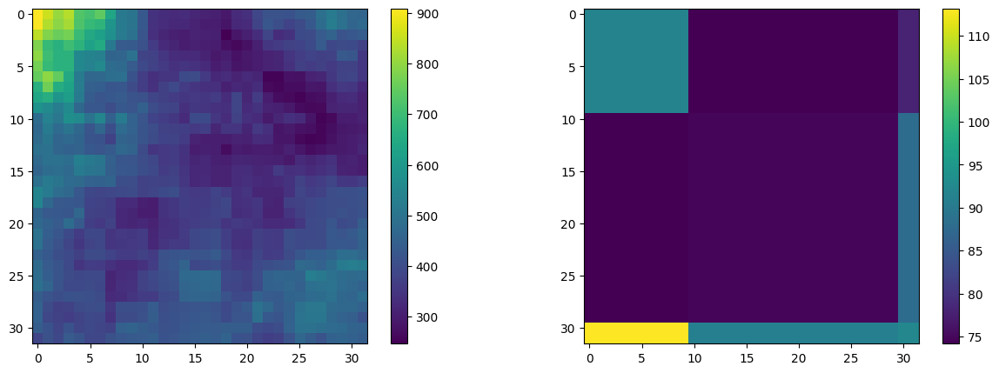

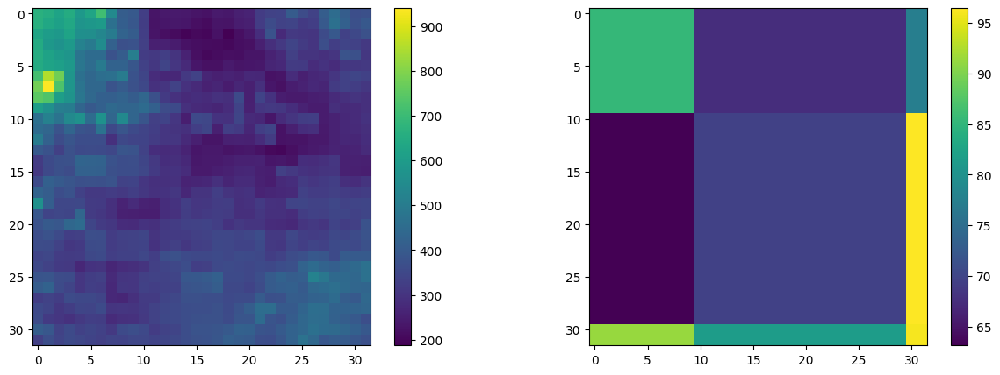

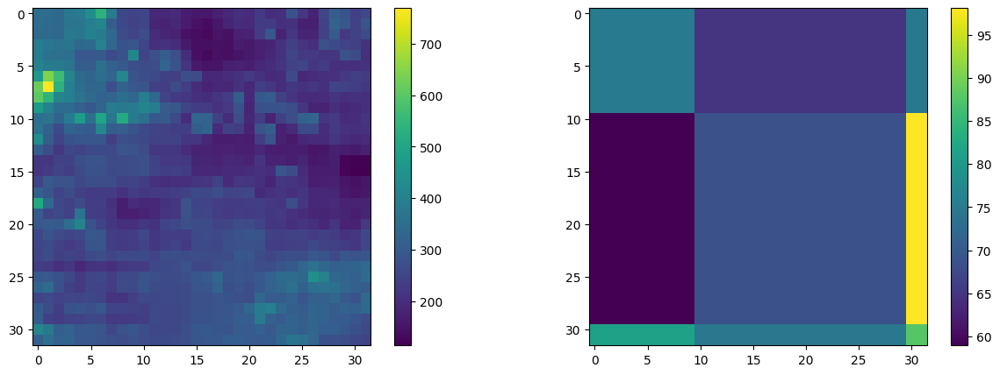

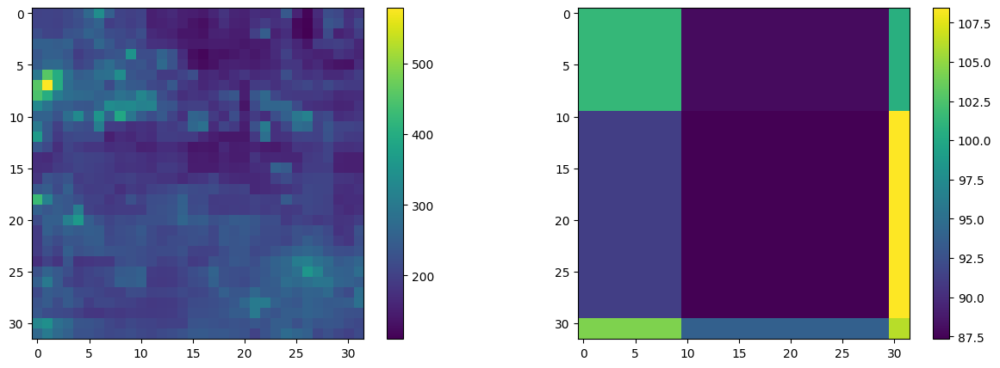

In [37]:
for index in range(4):
    fig, axes = plt.subplots(1, 2, figsize=(15, 5))
    im1 = axes[0].imshow(r1h.values[index])

    im2 = axes[1].imshow(forecast.values[index])

   
    fig.colorbar(im1)
    fig.colorbar(im2)


    plt.show()


In [ ]:
forecast.to_netcdf(f'Data/Downscaling/Rainfall/{region}_more/data/forecast.nc')
rfh.to_netcdf(f'Data/Downscaling/Rainfall/{region}_more/data/rfh_monthly.nc')

## LTA

In [ ]:
forecast_near = xr.open_dataset(f'Data/Downscaling/Rainfall/{region}_more/data/forecast.nc')
# forecast_near = forecast_near.update(forecast_near*1e4) ## CHANGE!!!
rfh = xr.open_dataset(f'Data/Downscaling/Rainfall/{region}_more/data/rfh_monthly.nc')

In [ ]:
forecast_near.time

In [ ]:
rfh.time

In [ ]:
rfh_lta = rfh.sel(time=slice("1983-02-28","2018-05-31"))
rfh_lta  = rfh_lta .groupby(rfh_lta.time.dt.strftime("%m-%d")).mean()
rfh_lta = rfh_lta.sel(strftime=rfh.time.dt.strftime("%m-%d"))

In [ ]:
rfh_lta.to_netcdf(f'Data/Downscaling/Rainfall/{region}_more/data/rfh_lta.nc')

In [ ]:
xr.open_dataset(f'Data/Downscaling/Rainfall/{region}_more/data/forecast.nc')

In [ ]:
for index in range(4):
    fig, axes = plt.subplots(1, 3, figsize=(15, 5))
    im1 = axes[0].imshow(rfh['band'][index])

    im2 = axes[1].imshow(forecast_near['tp'][index])

    im3 = axes[2].imshow(rfh_lta['band'][index])
    

    fig.colorbar(im1)
    fig.colorbar(im2)
    fig.colorbar(im3)

    plt.show()


## Weighted mask

In [40]:
import numpy as np
# Define a custom weighting function (e.g., higher weights in center)
def custom_weight_function_mean(square):
    normalized_weights = square/np.mean(square)
    return normalized_weights

def custom_weight_function(square):
    local_std = np.std(square)
    normalized_weights = local_std / np.mean(square)
    
    
    return normalized_weights

def Downscale_Weight(rfh_lta,forecast, verbose=False):

    # Initialize an empty weight mask
    weight_mask = np.zeros_like(forecast)

    # Compute weights and apply them
    
    step = 10
    for row in range(0,30,step):
        for col in range(0,60,10):
            rfh_lta_square = rfh_lta[row:row + step, col:col + step]
            weights = custom_weight_function_mean(rfh_lta_square)
            weight_mask[row:row + step, col:col + step] = weights
            
    
    for row in range(0,32,step):
            rfh_lta_square = rfh_lta[row:row + step, 60:]
            weights = custom_weight_function_mean(rfh_lta_square)
            weight_mask[row:row + step, 60:] = weights
        
        
    for col in range(0,64,step):
            rfh_lta_square = rfh_lta[30:, col:col + step]
            weights = custom_weight_function_mean(rfh_lta_square)
            weight_mask[30:, col:col + step] = weights



    # Apply the weight mask to forecast
    weighted_forecast = forecast * weight_mask


    if verbose:
        fig, axes = plt.subplots(1, 4, figsize=(15, 5))
        axes[0].imshow(forecast)
        axes[1].imshow(rfh_lta)
        axes[2].imshow(weighted_forecast)
        axes[3].imshow(weighted_forecast-rfh_lta)

        axes[0].set_title(f"forecastKm", fontsize='xx-large')
        axes[1].set_title(f"rfh_lta", fontsize='xx-large')
        axes[2].set_title(f"NDVI_Downscaled_det", fontsize='xx-large')
        axes[3].set_title(f"Bias", fontsize='xx-large')
        plt.show()

    return weighted_forecast


rfh_lta_array = rfh_lta.band.values
forecast_array = forecast_near.tp.values




rfh_lta_array = rfh_lta.band.values
forecast_array = forecast_near.tp.values
weighted_forecast_array = np.copy(rfh_lta_array)


for i in range(rfh_lta_array.shape[0]):
    
    weighted_forecast_array[i] = Downscale_Weight(rfh_lta_array[i], forecast_array[i])
    


# Assuming you have 'rfh_lta' defined, you can create a new xarray Dataset
weighted_forecast_xarray = xr.Dataset()

# Copy the coordinates and dimensions from 'rfh_lta'
weighted_forecast_xarray = rfh_lta.copy(deep=False)

# Assign 'weighted_forecast_array' as a data variable named 'band'
weighted_forecast_xarray['band'] = (('time', 'latitude', 'longitude'), weighted_forecast_array)

# Now, 'weighted_forecast_xarray' has the same dimensions, data variables, and coordinates as 'rfh_lta', with 'weighted_forecast_array' as one of its data variables.


    # Print or manipulate the resulting xarray as needed
weighted_forecast_xarray.to_netcdf(f'Data/Downscaling/Rainfall/{region}_more/data/weighted_forecast.nc')

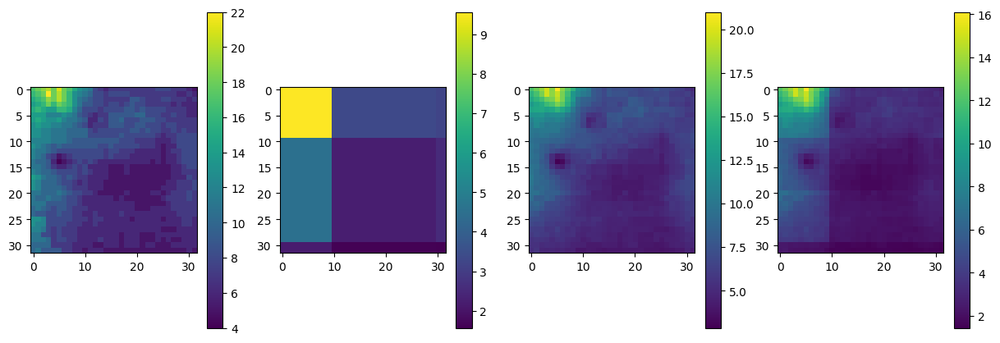

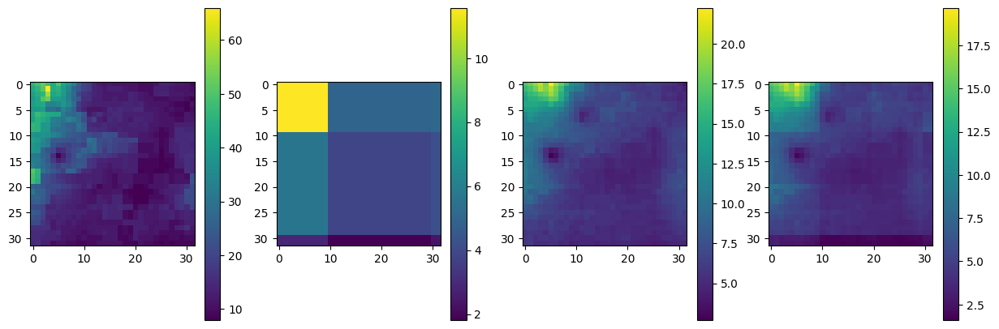

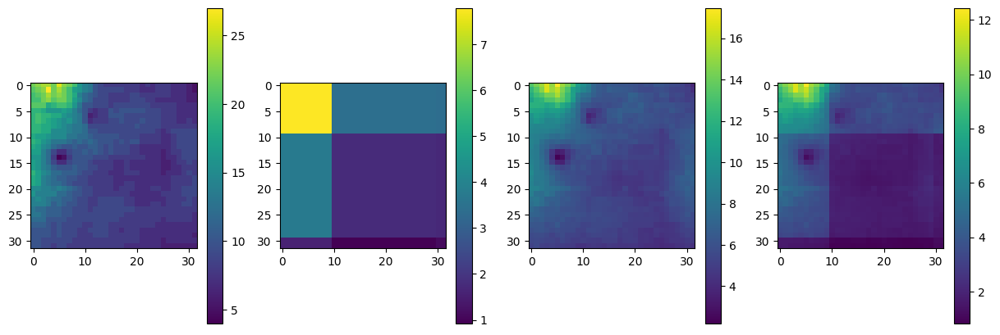

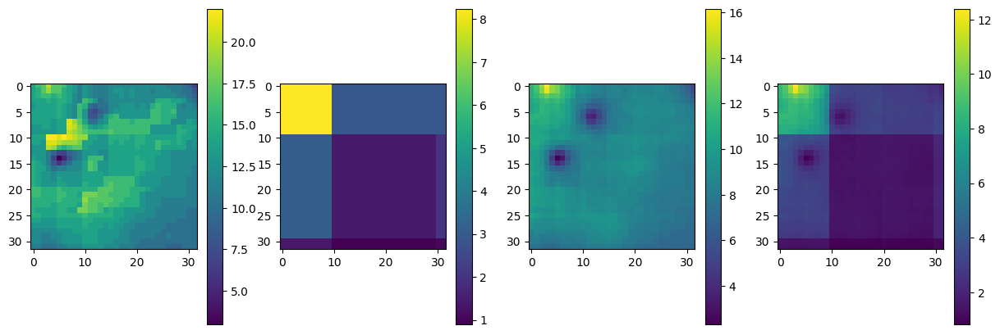

In [42]:
for index in range(4):
    fig, axes = plt.subplots(1, 4, figsize=(15, 5))
    im1 = axes[0].imshow(rfh['band'][index])

    im2 = axes[1].imshow(forecast_near['tp'][index])

    im3 = axes[2].imshow(rfh_lta['band'][index])
    
    im4 = axes[3].imshow(weighted_forecast_xarray['band'][index])
    

    fig.colorbar(im1)
    fig.colorbar(im2)
    fig.colorbar(im3)
    fig.colorbar(im4)

    plt.show()


In [46]:
data = np.load(f"Data/Downscaling/Rainfall/Jordan_more/data_npz/train/1985_00_inp.npz")
vars(data)

{'_files': ['rfh_lta.npy', 'forecast.npy', 'weighted.npy'],
 'files': ['rfh_lta', 'forecast', 'weighted'],
 'allow_pickle': False,
 'max_header_size': 10000,
 'pickle_kwargs': {'encoding': 'ASCII', 'fix_imports': True},
 'zip': <zipfile.ZipFile file=<_io.BufferedReader name='Data/Downscaling/Rainfall/Jordan_more/data_npz/train/1985_00_inp.npz'> mode='r'>,
 'f': <numpy.lib.npyio.BagObj at 0x7f27192035e0>,
 'fid': <_io.BufferedReader name='Data/Downscaling/Rainfall/Jordan_more/data_npz/train/1985_00_inp.npz'>}

# Mozambique

In [ ]:
region="Mozambique"

## Import RFH CHIRPS

In [ ]:
bbox = (29.201660,-23.905927,39.309082,-15.072124) #Sudan
area = AnalysisArea(
    bbox=bbox,
    datetime_range="1983-01-01/2023-06-30"  # change the starting date 1983  
)
rfh = area.get_dataset(["CHIRPS","rfh_dekad"])


In [ ]:
rfh = rfh.load()

### Extract Seasonality

In [ ]:
start_season =2
end_season =5

### Agregation over every month

In [ ]:
rfh_resample = rfh.resample(time='M').sum()

## Import ECMWF Prediction

In [ ]:
path_issue = f's3://wfp-seasmon/zarr/seasonal-forecasts/0{start_season}/01'

with dask.config.set(**{'array.slicing.split_large_chunks': False}):
    ds_issue = xr.open_mfdataset(f'{path_issue}/*.zarr', chunks={"latitude":36, "longitude":70, "ensemble":-1}, engine='zarr')
ds_issue = ds_issue.sel(latitude = slice(bbox[3], bbox[1]),longitude = slice(bbox[0], bbox[2])) 

In [ ]:
da_issue = ds_issue.tp.load()

In [ ]:
da_issue = da_issue.mean("ensemble") #Output 1 ensemble
da_issue = da_issue.diff(dim='time', n=1).fillna(0)  # Non cumulative

In [ ]:
da_issue.longitude

In [ ]:
# path_issue = f's3://wfp-seasmon/zarr/seasonal-forecasts/{mm}/01'

# with dask.config.set(**{'array.slicing.split_large_chunks': False}):
#     ds_issue = xr.open_mfdataset(f'{path_issue}/*.zarr', chunks={"latitude":36, "longitude":36, "ensemble":-1}, engine='zarr')
    
# ds_issue = ds_issue.sel(latitude = slice(bbox[3], bbox[1]),longitude = slice(bbox[0], bbox[2])) 
# da_issue = ds_issue.tp.load()
# da_issue = da_issue.mean("ensemble")


da_monthly_sum = da_issue.resample(time='M').sum()
da_monthly_sum_season  = da_monthly_sum.sel(time=(da_monthly_sum['time.month'] >= start_season) & (da_monthly_sum['time.month'] <= end_season), drop=True) 
da_monthly_sum_season_near = da_monthly_sum_season.rio.reproject(rfh_resample.rio.crs, 
                                                             resolution=(-0.05,0.05), 
                                                             resampling=rasterio.enums.Resampling.nearest)

da_monthly_sum_season_near = da_monthly_sum_season_near.rename({'y': 'latitude', 'x': 'longitude'})
da_monthly_sum_season_near = da_monthly_sum_season_near 

rfh_resample = rfh_resample.sel(latitude = slice(29.5, 38.5), longitude = slice(-23.5, -14.5))
da_monthly_sum_season_near_resample =da_monthly_sum_season_near.sel(latitude = rfh_resample.latitude.values, longitude= rfh_resample.longitude.values, method = "nearest")


latitude_size, longitude_size = 32,32

rfh = rfh_resample.isel(latitude=slice(0,latitude_size), longitude=slice(0,longitude_size))
da_monthly_sum_season_near  = da_monthly_sum_season_near_resample.isel(latitude=slice(0,latitude_size), longitude=slice(0,longitude_size))
# da_monthly_sum_season_near.to_netcdf(f'Data/Downscaling/Rainfall/Jordan/data/da_monthly_sum_season_near_01.nc')

In [ ]:
scale_rate = 10

rfh = rfh.sel(time=(rfh['time.month'] >= start_season) & (rfh['time.month'] <= end_season), drop=True) 
scaling_factors = rfh.max() / da_monthly_sum_season_near.max()

forecast = da_monthly_sum_season_near*scaling_factors['band'].values

In [ ]:
forecast.to_netcdf(f'Data/Downscaling/Rainfall/{region}/data/forecast.nc')
rfh.to_netcdf(f'Data/Downscaling/Rainfall/{region}/data/rfh_monthly.nc')

## LTA

In [ ]:
forecast_near = xr.open_dataset(f'Data/Downscaling/Rainfall/{region}/data/forecast.nc')
# forecast_near = forecast_near.update(forecast_near*1e4) ## CHANGE!!!
rfh = xr.open_dataset(f'Data/Downscaling/Rainfall/{region}/data/rfh_monthly.nc')

In [ ]:
rfh_lta = rfh.sel(time=slice("1983-02-28","2018-05-31"))
rfh_lta  = rfh_lta .groupby(rfh_lta.time.dt.strftime("%m-%d")).mean()
rfh_lta = rfh_lta.sel(strftime=rfh.time.dt.strftime("%m-%d"))

In [ ]:
rfh_lta.to_netcdf(f'Data/Downscaling/Rainfall/{region}/data/rfh_lta.nc')

In [ ]:
xr.open_dataset(f'Data/Downscaling/Rainfall/{region}/data/forecast.nc')

In [ ]:
forecast_near

In [ ]:
for index in range(4):
    fig, axes = plt.subplots(1, 4, figsize=(15, 5))
    im1 = axes[0].imshow(rfh['band'][index])

    im2 = axes[1].imshow(forecast_near['tp'][index])

    im3 = axes[2].imshow(rfh_lta['band'][index])
    
    im4 = axes[3].imshow(scaled_forecast_near['tp'][index])

    fig.colorbar(im1)
    fig.colorbar(im2)
    fig.colorbar(im3)
    fig.colorbar(im4)

    plt.show()


# Niger

In [ ]:
region="Niger"

## Import RFH CHIRPS

In [ ]:
bbox = (5.031738,14.157882,13.491211,20.488773) #Sudan
area = AnalysisArea(
    bbox=bbox,
    datetime_range="1983-01-01/2023-06-30"  # change the starting date 1983  
)
rfh = area.get_dataset(["CHIRPS","rfh_dekad"])


In [ ]:
rfh = rfh.load()

### Extract Seasonality

In [ ]:
start_season =2
end_season =5

### Agregation over every month

In [ ]:
rfh_resample = rfh.resample(time='M').sum()

## Import ECMWF Prediction

In [ ]:
path_issue = f's3://wfp-seasmon/zarr/seasonal-forecasts/0{start_season}/01'

with dask.config.set(**{'array.slicing.split_large_chunks': False}):
    ds_issue = xr.open_mfdataset(f'{path_issue}/*.zarr', chunks={"latitude":36, "longitude":70, "ensemble":-1}, engine='zarr')
ds_issue = ds_issue.sel(latitude = slice(bbox[3], bbox[1]),longitude = slice(bbox[0], bbox[2])) 

In [ ]:
da_issue = ds_issue.tp.load()

In [ ]:
da_issue = da_issue.mean("ensemble") #Output 1 ensemble
da_issue = da_issue.diff(dim='time', n=1).fillna(0)  # Non cumulative

In [ ]:
da_issue.longitude

In [ ]:
# path_issue = f's3://wfp-seasmon/zarr/seasonal-forecasts/{mm}/01'

# with dask.config.set(**{'array.slicing.split_large_chunks': False}):
#     ds_issue = xr.open_mfdataset(f'{path_issue}/*.zarr', chunks={"latitude":36, "longitude":36, "ensemble":-1}, engine='zarr')
    
# ds_issue = ds_issue.sel(latitude = slice(bbox[3], bbox[1]),longitude = slice(bbox[0], bbox[2])) 
# da_issue = ds_issue.tp.load()
# da_issue = da_issue.mean("ensemble")


da_monthly_sum = da_issue.resample(time='M').sum()
da_monthly_sum_season  = da_monthly_sum.sel(time=(da_monthly_sum['time.month'] >= start_season) & (da_monthly_sum['time.month'] <= end_season), drop=True) 
da_monthly_sum_season_near = da_monthly_sum_season.rio.reproject(rfh_resample.rio.crs, 
                                                             resolution=(-0.05,0.05), 
                                                             resampling=rasterio.enums.Resampling.nearest)

da_monthly_sum_season_near = da_monthly_sum_season_near.rename({'y': 'latitude', 'x': 'longitude'})
da_monthly_sum_season_near = da_monthly_sum_season_near 

rfh_resample = rfh_resample.sel(latitude = slice(5.5, 12.5), longitude = slice(14.5, 19.5))
da_monthly_sum_season_near_resample =da_monthly_sum_season_near.sel(latitude = rfh_resample.latitude.values, longitude= rfh_resample.longitude.values, method = "nearest")


latitude_size, longitude_size = 32,32

rfh = rfh_resample.isel(latitude=slice(0,latitude_size), longitude=slice(0,longitude_size))
da_monthly_sum_season_near  = da_monthly_sum_season_near_resample.isel(latitude=slice(0,latitude_size), longitude=slice(0,longitude_size))
# da_monthly_sum_season_near.to_netcdf(f'Data/Downscaling/Rainfall/Jordan/data/da_monthly_sum_season_near_01.nc')

In [ ]:
scale_rate = 10

rfh = rfh.sel(time=(rfh['time.month'] >= start_season) & (rfh['time.month'] <= end_season), drop=True) 
scaling_factors = rfh.max() / da_monthly_sum_season_near.max()

forecast = da_monthly_sum_season_near*scaling_factors['band'].values

In [ ]:
forecast.to_netcdf(f'Data/Downscaling/Rainfall/{region}/data/forecast.nc')
rfh.to_netcdf(f'Data/Downscaling/Rainfall/{region}/data/rfh_monthly.nc')

## LTA

In [ ]:
forecast_near = xr.open_dataset(f'Data/Downscaling/Rainfall/{region}/data/forecast.nc')
# forecast_near = forecast_near.update(forecast_near*1e4) ## CHANGE!!!
rfh = xr.open_dataset(f'Data/Downscaling/Rainfall/{region}/data/rfh_monthly.nc')

In [ ]:
rfh_lta = rfh.sel(time=slice("1983-02-28","2018-05-31"))
rfh_lta  = rfh_lta .groupby(rfh_lta.time.dt.strftime("%m-%d")).mean()
rfh_lta = rfh_lta.sel(strftime=rfh.time.dt.strftime("%m-%d"))

In [ ]:
rfh_lta.to_netcdf(f'Data/Downscaling/Rainfall/{region}/data/rfh_lta.nc')

In [ ]:
xr.open_dataset(f'Data/Downscaling/Rainfall/{region}/data/forecast.nc')

In [ ]:
forecast_near

In [ ]:
for index in range(4):
    fig, axes = plt.subplots(1, 4, figsize=(15, 5))
    im1 = axes[0].imshow(rfh['band'][index])

    im2 = axes[1].imshow(forecast_near['tp'][index])

    im3 = axes[2].imshow(rfh_lta['band'][index])
    
    im4 = axes[3].imshow(scaled_forecast_near['tp'][index])

    fig.colorbar(im1)
    fig.colorbar(im2)
    fig.colorbar(im3)
    fig.colorbar(im4)

    plt.show()


# Cuba

In [ ]:
region="Cuba"

## Import RFH CHIRPS

In [ ]:
bbox = (-76.113281,-3.513421,-63.852539,6.795535) #Sudan
area = AnalysisArea(
    bbox=bbox,
    datetime_range="1983-01-01/2023-06-30"  # change the starting date 1983  
)
rfh = area.get_dataset(["CHIRPS","rfh_dekad"])


In [ ]:
rfh = rfh.load()

### Extract Seasonality

In [ ]:
start_season =2
end_season =5

### Agregation over every month

In [ ]:
rfh_resample = rfh.resample(time='M').sum()

## Import ECMWF Prediction

In [ ]:
path_issue = f's3://wfp-seasmon/zarr/seasonal-forecasts/0{start_season}/01'

with dask.config.set(**{'array.slicing.split_large_chunks': False}):
    ds_issue = xr.open_mfdataset(f'{path_issue}/*.zarr', chunks={"latitude":36, "longitude":70, "ensemble":-1}, engine='zarr')
ds_issue = ds_issue.sel(latitude = slice(bbox[3], bbox[1]),longitude = slice(bbox[0], bbox[2])) 

In [ ]:
da_issue = ds_issue.tp.load()

In [ ]:
da_issue = da_issue.mean("ensemble") #Output 1 ensemble
da_issue = da_issue.diff(dim='time', n=1).fillna(0)  # Non cumulative

In [ ]:
da_issue.longitude

In [ ]:
# path_issue = f's3://wfp-seasmon/zarr/seasonal-forecasts/{mm}/01'

# with dask.config.set(**{'array.slicing.split_large_chunks': False}):
#     ds_issue = xr.open_mfdataset(f'{path_issue}/*.zarr', chunks={"latitude":36, "longitude":36, "ensemble":-1}, engine='zarr')
    
# ds_issue = ds_issue.sel(latitude = slice(bbox[3], bbox[1]),longitude = slice(bbox[0], bbox[2])) 
# da_issue = ds_issue.tp.load()
# da_issue = da_issue.mean("ensemble")


da_monthly_sum = da_issue.resample(time='M').sum()
da_monthly_sum_season  = da_monthly_sum.sel(time=(da_monthly_sum['time.month'] >= start_season) & (da_monthly_sum['time.month'] <= end_season), drop=True) 
da_monthly_sum_season_near = da_monthly_sum_season.rio.reproject(rfh_resample.rio.crs, 
                                                             resolution=(-0.05,0.05), 
                                                             resampling=rasterio.enums.Resampling.nearest)

da_monthly_sum_season_near = da_monthly_sum_season_near.rename({'y': 'latitude', 'x': 'longitude'})
da_monthly_sum_season_near = da_monthly_sum_season_near 

rfh_resample = rfh_resample.sel(latitude = slice(-75.5, -63.5), longitude = slice(-3.5, 6.5))
da_monthly_sum_season_near_resample =da_monthly_sum_season_near.sel(latitude = rfh_resample.latitude.values, longitude= rfh_resample.longitude.values, method = "nearest")


latitude_size, longitude_size = 32,32

rfh = rfh_resample.isel(latitude=slice(0,latitude_size), longitude=slice(0,longitude_size))
da_monthly_sum_season_near  = da_monthly_sum_season_near_resample.isel(latitude=slice(0,latitude_size), longitude=slice(0,longitude_size))
# da_monthly_sum_season_near.to_netcdf(f'Data/Downscaling/Rainfall/Jordan/data/da_monthly_sum_season_near_01.nc')

In [ ]:
scale_rate = 10

rfh = rfh.sel(time=(rfh['time.month'] >= start_season) & (rfh['time.month'] <= end_season), drop=True) 
scaling_factors = rfh.max() / da_monthly_sum_season_near.max()

forecast = da_monthly_sum_season_near*scaling_factors['band'].values

In [ ]:
forecast.to_netcdf(f'Data/Downscaling/Rainfall/{region}/data/forecast.nc')
rfh.to_netcdf(f'Data/Downscaling/Rainfall/{region}/data/rfh_monthly.nc')

## LTA

In [ ]:
forecast_near = xr.open_dataset(f'Data/Downscaling/Rainfall/{region}/data/forecast.nc')
# forecast_near = forecast_near.update(forecast_near*1e4) ## CHANGE!!!
rfh = xr.open_dataset(f'Data/Downscaling/Rainfall/{region}/data/rfh_monthly.nc')

In [ ]:
rfh_lta = rfh.sel(time=slice("1983-02-28","2018-05-31"))
rfh_lta  = rfh_lta .groupby(rfh_lta.time.dt.strftime("%m-%d")).mean()
rfh_lta = rfh_lta.sel(strftime=rfh.time.dt.strftime("%m-%d"))

In [ ]:
rfh_lta.to_netcdf(f'Data/Downscaling/Rainfall/{region}/data/rfh_lta.nc')

In [ ]:
xr.open_dataset(f'Data/Downscaling/Rainfall/{region}/data/forecast.nc')

In [ ]:
forecast_near

In [ ]:
for index in range(4):
    fig, axes = plt.subplots(1, 4, figsize=(15, 5))
    im1 = axes[0].imshow(rfh['band'][index])

    im2 = axes[1].imshow(forecast_near['tp'][index])

    im3 = axes[2].imshow(rfh_lta['band'][index])
    
    im4 = axes[3].imshow(scaled_forecast_near['tp'][index])

    fig.colorbar(im1)
    fig.colorbar(im2)
    fig.colorbar(im3)
    fig.colorbar(im4)

    plt.show()


# Indonesie

In [ ]:
region="Indonesie"

## Import RFH CHIRPS

In [ ]:
bbox = (110.412598,-2.723583,115.971680,1.076597) #Sudan
area = AnalysisArea(
    bbox=bbox,
    datetime_range="1983-01-01/2023-06-30"  # change the starting date 1983  
)
rfh = area.get_dataset(["CHIRPS","rfh_dekad"])


In [ ]:
rfh = rfh.load()

### Extract Seasonality

In [ ]:
start_season =2
end_season =5

### Agregation over every month

In [ ]:
rfh_resample = rfh.resample(time='M').sum()

## Import ECMWF Prediction

In [ ]:
path_issue = f's3://wfp-seasmon/zarr/seasonal-forecasts/0{start_season}/01'

with dask.config.set(**{'array.slicing.split_large_chunks': False}):
    ds_issue = xr.open_mfdataset(f'{path_issue}/*.zarr', chunks={"latitude":36, "longitude":70, "ensemble":-1}, engine='zarr')
ds_issue = ds_issue.sel(latitude = slice(bbox[3], bbox[1]),longitude = slice(bbox[0], bbox[2])) 

In [ ]:
da_issue = ds_issue.tp.load()

In [ ]:
da_issue = da_issue.mean("ensemble") #Output 1 ensemble
da_issue = da_issue.diff(dim='time', n=1).fillna(0)  # Non cumulative

In [ ]:
da_issue.longitude

In [ ]:
# path_issue = f's3://wfp-seasmon/zarr/seasonal-forecasts/{mm}/01'

# with dask.config.set(**{'array.slicing.split_large_chunks': False}):
#     ds_issue = xr.open_mfdataset(f'{path_issue}/*.zarr', chunks={"latitude":36, "longitude":36, "ensemble":-1}, engine='zarr')
    
# ds_issue = ds_issue.sel(latitude = slice(bbox[3], bbox[1]),longitude = slice(bbox[0], bbox[2])) 
# da_issue = ds_issue.tp.load()
# da_issue = da_issue.mean("ensemble")


da_monthly_sum = da_issue.resample(time='M').sum()
da_monthly_sum_season  = da_monthly_sum.sel(time=(da_monthly_sum['time.month'] >= start_season) & (da_monthly_sum['time.month'] <= end_season), drop=True) 
da_monthly_sum_season_near = da_monthly_sum_season.rio.reproject(rfh_resample.rio.crs, 
                                                             resolution=(-0.05,0.05), 
                                                             resampling=rasterio.enums.Resampling.nearest)

da_monthly_sum_season_near = da_monthly_sum_season_near.rename({'y': 'latitude', 'x': 'longitude'})
da_monthly_sum_season_near = da_monthly_sum_season_near 

rfh_resample = rfh_resample.sel(latitude = slice(110.5, 115.5), longitude = slice(-2.5, 0.5))
da_monthly_sum_season_near_resample =da_monthly_sum_season_near.sel(latitude = rfh_resample.latitude.values, longitude= rfh_resample.longitude.values, method = "nearest")


latitude_size, longitude_size = 32,32

rfh = rfh_resample.isel(latitude=slice(0,latitude_size), longitude=slice(0,longitude_size))
da_monthly_sum_season_near  = da_monthly_sum_season_near_resample.isel(latitude=slice(0,latitude_size), longitude=slice(0,longitude_size))
# da_monthly_sum_season_near.to_netcdf(f'Data/Downscaling/Rainfall/Jordan/data/da_monthly_sum_season_near_01.nc')

In [ ]:
scale_rate = 10

rfh = rfh.sel(time=(rfh['time.month'] >= start_season) & (rfh['time.month'] <= end_season), drop=True) 
scaling_factors = rfh.max() / da_monthly_sum_season_near.max()

forecast = da_monthly_sum_season_near*scaling_factors['band'].values

In [ ]:
forecast.to_netcdf(f'Data/Downscaling/Rainfall/{region}/data/forecast.nc')
rfh.to_netcdf(f'Data/Downscaling/Rainfall/{region}/data/rfh_monthly.nc')

## LTA

In [ ]:
forecast_near = xr.open_dataset(f'Data/Downscaling/Rainfall/{region}/data/forecast.nc')
# forecast_near = forecast_near.update(forecast_near*1e4) ## CHANGE!!!
rfh = xr.open_dataset(f'Data/Downscaling/Rainfall/{region}/data/rfh_monthly.nc')

In [ ]:
rfh_lta = rfh.sel(time=slice("1983-02-28","2018-05-31"))
rfh_lta  = rfh_lta .groupby(rfh_lta.time.dt.strftime("%m-%d")).mean()
rfh_lta = rfh_lta.sel(strftime=rfh.time.dt.strftime("%m-%d"))

In [ ]:
rfh_lta.to_netcdf(f'Data/Downscaling/Rainfall/{region}/data/rfh_lta.nc')

In [ ]:
xr.open_dataset(f'Data/Downscaling/Rainfall/{region}/data/forecast.nc')

In [ ]:
forecast_near

In [ ]:
for index in range(4):
    fig, axes = plt.subplots(1, 4, figsize=(15, 5))
    im1 = axes[0].imshow(rfh['band'][index])

    im2 = axes[1].imshow(forecast_near['tp'][index])

    im3 = axes[2].imshow(rfh_lta['band'][index])
    
    im4 = axes[3].imshow(scaled_forecast_near['tp'][index])

    fig.colorbar(im1)
    fig.colorbar(im2)
    fig.colorbar(im3)
    fig.colorbar(im4)

    plt.show()


# Bilinear interpolation 

In [1]:
def bilinear_interpolate (forecast,verbose=False):
    new_height = forecast.shape[1]
    new_width = forecast.shape[2]
    forecast_resample=forecast[0]
    image_tensor  = forecast_resample[:30:5,:30:5]
    
    rescaled_image = F.interpolate(image_tensor.unsqueeze(0).unsqueeze(0), size=(new_height, new_width), mode='bilinear', align_corners=False)[0]
    
    if verbose:
        
        plt.imshow(rescaled_image)
        plt.show()
    
    
    
    return rescaled_image

# Weighted Mask

In [2]:
import numpy as np
# Define a custom weighting function (e.g., higher weights in center)
def custom_weight_function_mean(square):
    normalized_weights = square/np.mean(square)
    return normalized_weights

def custom_weight_function(square):
    local_std = np.std(square)
    normalized_weights = local_std / np.mean(square)
    
    
    return normalized_weights

def Downscale_Weight(rfh_lta,forecast, verbose=False):

    # Initialize an empty weight mask
    weight_mask = np.zeros_like(forecast)

    # Compute weights and apply them
    
    step = 10
    for row in range(0,30,step):
        for col in range(0,60,10):
            rfh_lta_square = rfh_lta[row:row + step, col:col + step]
            weights = custom_weight_function_mean(rfh_lta_square)
            weight_mask[row:row + step, col:col + step] = weights
            
    
    for row in range(0,32,step):
            rfh_lta_square = rfh_lta[row:row + step, 60:]
            weights = custom_weight_function_mean(rfh_lta_square)
            weight_mask[row:row + step, 60:] = weights
        
        
    for col in range(0,64,step):
            rfh_lta_square = rfh_lta[30:, col:col + step]
            weights = custom_weight_function_mean(rfh_lta_square)
            weight_mask[30:, col:col + step] = weights



    # Apply the weight mask to forecast
    weighted_forecast = forecast * weight_mask


    if verbose:
        fig, axes = plt.subplots(1, 4, figsize=(15, 5))
        axes[0].imshow(forecast)
        axes[1].imshow(rfh_lta)
        axes[2].imshow(weighted_forecast)
        axes[3].imshow(weighted_forecast-rfh_lta)

        axes[0].set_title(f"forecastKm", fontsize='xx-large')
        axes[1].set_title(f"rfh_lta", fontsize='xx-large')
        axes[2].set_title(f"NDVI_Downscaled_det", fontsize='xx-large')
        axes[3].set_title(f"Bias", fontsize='xx-large')
        plt.show()

    return weighted_forecast

# Metrics

In [3]:
def lat_weighted_mse_val(pred, y, transform, lat):
    """Latitude weighted mean squared error
    Args:
        y: [B, V, H, W]
        pred: [B, V, H, W]
        vars: list of variable names
        lat: H
    """
    
  

    error = (pred - y) ** 2  # [B, V, H, W]

    # lattitude weights
    w_lat = np.cos(np.deg2rad(lat))

    w_lat = w_lat / w_lat.mean()  # (H, )
    w_lat = torch.from_numpy(w_lat).unsqueeze(0).unsqueeze(-1).to(dtype=error.dtype, device=error.device)  # (1, H, 1)

    loss_dict = {}
    with torch.no_grad(): 
        
            res =  (error * w_lat).mean()
    return res

In [4]:
def lat_weighted_rmse(pred, y, transform, lat ):
    """Latitude weighted root mean squared error

    Args:
        y: [B, V, H, W]
        pred: [B, V, H, W]
        vars: list of variable names
        lat: H
    """

    # pred = transform(pred)
    # y = transform(y)

    error = (pred - y) ** 2  # [B, V, H, W]

    # lattitude weights
    w_lat = np.cos(np.deg2rad(lat))
    w_lat = w_lat / w_lat.mean()  # (H, )
    w_lat = torch.from_numpy(w_lat).unsqueeze(0).unsqueeze(-1).to(dtype=error.dtype, device=error.device)

    with torch.no_grad():
        res = torch.mean(
                torch.sqrt(torch.mean(error * w_lat, dim=(-2, -1)))
            )

    return res



In [5]:
import torch 

def remove_nans(pred: torch.Tensor, gt: torch.Tensor):
    # pred and gt are two flattened arrays
    pred_nan_ids = torch.isnan(pred) | torch.isinf(pred)
    pred = pred[~pred_nan_ids]
    gt = gt[~pred_nan_ids]

    gt_nan_ids = torch.isnan(gt) | torch.isinf(gt)
    pred = pred[~gt_nan_ids]
    gt = gt[~gt_nan_ids]

    return pred, gt


def pearson(pred, y, transform,lat):
    """
    y: [N, T, 3, H, W]
    pred: [N, T, 3, H, W]
    vars: list of variable names
    lat: H
    """

    # pred = transform(pred)
    # y = transform(y)

    loss_dict = {}
    with torch.no_grad():
        pred_, y_ = pred.flatten(), y.flatten()
        pred_, y_ = remove_nans(pred_, y_)
        res = stats.pearsonr(pred_.cpu().numpy(), y_.cpu().numpy())[0]

    return res

def spearman(pred, y, transform,lat):
    """
    y: [N, T, 3, H, W]
    pred: [N, T, 3, H, W]
    vars: list of variable names
    lat: H
    """

    # pred = transform(pred)
    # y = transform(y)

    loss_dict = {}
    with torch.no_grad():
        pred_, y_ = pred.flatten(), y.flatten()
        pred_, y_ = remove_nans(pred_, y_)
        res = stats.spearmanr(pred_.cpu().numpy(), y_.cpu().numpy())[0]

    return res

def mean_bias(pred, y, transform,lat):
    """
    y: [B, V, H, W]
    pred: [B, V, H, W]
    vars: list of variable names
    lat: H
    """

    # pred = transform(pred)
    # y = transform(y)

    loss_dict = {}
    with torch.no_grad():
        pred_, y_ = pred.flatten(), y.flatten()
        pred_, y_ = remove_nans(pred_, y_)
        res= pred_.mean() - y_.mean()

    return res





# Results

In [6]:
import sys
sys.path.append('/mnt/shared/users/wessim.omezzine/ClimaX/src/climax')
sys.path.append('/mnt/shared/users/wessim.omezzine/ClimaX/src/')
import torch 
import os
import random
import numpy as np
import torch
import matplotlib.pyplot as plt
from datetime import datetime
from torchvision.transforms import transforms
import torch.nn.functional as F
from prettytable import PrettyTable
from scipy import stats


from skimage.metrics import structural_similarity as ssim


from climax.climate_downscaling.module import ClimateDownscalingModule
from climax.climate_downscaling.datamodule import ClimateDownscalingDataModule
from pytorch_lightning.cli import LightningCLI
from pytorch_lightning import Trainer
from climax.arch import ClimaX


TASK_TO_RANGE = {
    '0 days' : 0,
    '10 days' : 1,
    '40 days': 4,
    '50 days': 5,
    '60 days': 6,
    '20 days': 2,
    '30 days': 3,
}

/envs/user/fix_hdc/lib/python3.10/site-packages/tqdm/auto.py:22: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm


In [7]:
def plot_pred(tensors, var_name, pred_task, time):
    
    index = 0
    fig, axes = plt.subplots(1, 4, figsize=(28, 3), squeeze = False)
    
    
    
    image1_np = tensors[0][time].detach().squeeze().cpu().numpy()
    image2_np = tensors[1][time].detach().squeeze().cpu().numpy()
    image3_np = tensors[2][time].detach().squeeze().cpu().numpy()
    vmin = min(np.min(image2_np), np.min(image3_np))
    vmax = max(np.max(image2_np), np.max(image3_np))
    
    
    
    for i, tensor in enumerate(tensors):
        ax = axes[index][i]
        if i==1 or i==2 : 
            im = ax.imshow(tensor[time].detach().squeeze().cpu().numpy(),vmin=vmin, vmax=vmax)

        else : 
            im = ax.imshow(tensor[time].detach().squeeze().cpu().numpy())
            
            
        im.set_cmap(cmap=plt.cm.RdBu)
        fig.colorbar(im, ax=ax)
        ax.tick_params(
            axis='x',          # changes apply to the x-axis
            which='both',      # both major and minor ticks are affected
            bottom=False,      # ticks along the bottom edge are off
            top=False,         # ticks along the top edge are off
            labelbottom=False
        ) # labels along the bottom edge are off
        ax.tick_params(
            axis='y',          # changes apply to the x-axis
            which='both',      # both major and minor ticks are affected
            left=False,      # ticks along the bottom edge are off
            right=False,        # ticks along the top edge are off
            labelleft=False
        ) # labels along the bottom edge are off



        axes[index][0].text(-10, 64, var_name, fontsize=28, rotation=90, va='center', ha='center')
        axes[index][0].set_title(f"Initial condition", fontsize='xx-large')
        axes[index][1].set_title(f"Ground truth", fontsize='xx-large')
        axes[index][2].set_title(f"Downscaled", fontsize='xx-large')
        axes[index][3].set_title(f"Bias", fontsize='xx-large')

    plt.show()


def plot_inputs(tensors, var_name, pred_task,time):
    index = 0
    fig, axes = plt.subplots(1, 4, figsize=(28, 2), squeeze = False)
    
    timesteps = tensors[0].shape[0]
    
    
    for i, tensor in enumerate(tensors):
        ax = axes[index][i]
        im = ax.imshow(tensor[time].detach().squeeze().cpu().numpy())
        im.set_cmap(cmap=plt.cm.RdBu)
        fig.colorbar(im, ax=ax)
        ax.tick_params(
            axis='x',          # changes apply to the x-axis
            which='both',      # both major and minor ticks are affected
            bottom=False,      # ticks along the bottom edge are off
            top=False,         # ticks along the top edge are off
            labelbottom=False
        ) # labels along the bottom edge are off
        ax.tick_params(
            axis='y',          # changes apply to the x-axis
            which='both',      # both major and minor ticks are affected
            left=False,      # ticks along the bottom edge are off
            right=False,        # ticks along the top edge are off
            labelleft=False
        ) # labels along the bottom edge are off



    axes[index][0].text(-10, 64, "Inputs", fontsize=28, rotation=90, va='center', ha='center')
    axes[index][0].set_title(f"Forecast", fontsize='xx-large')
    axes[index][1].set_title(f"RFH_LTA", fontsize='xx-large')
    axes[index][2].set_title(f"R2H", fontsize='xx-large')
    axes[index][3].set_title(f"R3h", fontsize='xx-large')



    plt.show()
    
    

    


In [8]:
def compare_results(gt, forecast, pred, bilinear_interp, weighted_mask, model,t,denormalize_out):
    
    # Check if GPU is available
    if torch.cuda.is_available():
        device = torch.device('cuda:0')
    else:
        device = torch.device('cpu')

    print("Selected device:", device)
    
    # Create a table with three columns
    table = PrettyTable(["","Coarse", "ClimaX", "Bilinear Interpolation", "Weighted Mask"])
    
    transform = denormalize_out
    lat = model.lat
    

    for method in [lat_weighted_mse_val, lat_weighted_rmse, spearman,mean_bias, pearson]:
        
        coarse = method(gt[0],forecast[t].unsqueeze(0), transform, lat).item()
        climax = method(pred[t], gt[t], transform, lat).item()
        bilinear = method(bilinear_interp, gt[t], transform, lat).item()
        mask = method(torch.Tensor(weighted_mask).unsqueeze(0).to(device), gt[t], transform, lat).item()

        table.add_row([method.__name__,coarse, climax, bilinear, mask])
        


    # Set the style of the table (optional)
    table.border = True  # Add a border around the table
    table.align = "l"    # Align columns to the left

    # Print the table
    print(table)

def plot_compare(gt,coarse, pred, bilinear_inter, weighted_mask,t,denormalize_out ):
    fig, axes = plt.subplots(2, 5, figsize=(12, 6))

    
    
    # Plot the first figure on the left subplot
    im1 = axes[0,0].imshow(coarse.cpu().numpy()[t], cmap=plt.cm.RdBu)  # You can change the colormap as needed
    axes[0,0].set_title('ClimaX')
    
    im2 = axes[0,1].imshow(pred.cpu().numpy()[t][0], cmap=plt.cm.RdBu)  # You can change the colormap as needed
    axes[0,1].set_title('ClimaX')

    # Plot the second figure on the right subplot
    im3 = axes[0,2].imshow(bilinear_inter.cpu().numpy()[0], cmap=plt.cm.RdBu)  # You can change the colormap as needed
    axes[0,2].set_title('Bilinear Interpolation')
    
    im4 = axes[0,3].imshow(weighted_mask, cmap=plt.cm.RdBu)  # You can change the colormap as needed
    axes[0,3].set_title('Weighted Mask')
    
    im5 = axes[0,4].imshow(gt.cpu().numpy()[t,0], cmap=plt.cm.RdBu)  # You can change the colormap as needed
    axes[0,4].set_title('Original')
    
    fig.colorbar(im1)
    fig.colorbar(im2)
    fig.colorbar(im3)
    fig.colorbar(im4)
    fig.colorbar(im5)
    
    axes[1,0].hist((coarse.cpu().numpy()[t] - gt.cpu().numpy()[t][0]).ravel(), bins=50, color='b', alpha=0.7) # You can change the colormap as needed
    axes[1,0].set_title('Coarse')

    # Plot the second figure on the right subplot
    axes[1,1].hist((pred.cpu().numpy()[0] - gt.cpu().numpy()[t][0]).ravel(), bins=50, color='g', alpha=0.7)
    axes[1,1].set_title('ClimaX')
    
    axes[1,2].hist((bilinear_inter.cpu().numpy() - gt.cpu().numpy()[t][0]).ravel(), bins=50, color='r', alpha=0.7)
    axes[1,2].set_title('Bilinear Interpolation')
    
    
    axes[1,3].hist((weighted_mask - gt.cpu().numpy()[t][0]).ravel(), bins=50, color='r', alpha=0.7)
    axes[1,3].set_title('Weighted mask')
    

    
   

    # Adjust spacing between subplots
    plt.tight_layout()

    # Show the plot
    plt.show()

    

In [9]:
def visualize_downscale(model_module, data_module,mean_norm, std_norm, pred_task, var_name, var_id,data_path=None, save_path = None, desired_batch_index = 25):
    
    
    # Check if GPU is available
    if torch.cuda.is_available():
        device = torch.device('cuda:0')
    else:
        device = torch.device('cpu')

    print("Selected device:", device)

    
    model_module.eval()
    
    if torch.cuda.is_available():
         model_module.cuda()
    else:
         model_module.cpu()
    

    dataloader = data_module.test_dataloader()
    
   

    for batch_idx, batch_data in enumerate(dataloader, 1):        
        if batch_idx == desired_batch_index:
            # Process the nth batch (e.g., 10th batch)
            x, y, lead_times, in_vars, out_vars = batch_data
            
    
#     print("x.shape", x.shape)
#     print("y.shape", y.shape)
    
    
    if torch.cuda.is_available():
        lead_times = lead_times.cuda()
    else:
        lead_times = lead_times.cpu()

            
    if torch.cuda.is_available():
        x = x.cuda()
        y = y.cuda()
    else:
        x = x.cpu()
        y = y.cpu()
    
    with torch.no_grad():
        _, pred = model_module.net.forward(x, y, lead_times, in_vars, out_vars, None, model_module.lat)
    
    inv_normalize = model_module.denormalization
    
    
    tensors=[]
    for i in range(x.shape[1]):
        tensors.append(inv_normalize(x)[:,i])
    init_condition = inv_normalize(x)[:,0]

    
    normalization = data_module.output_transforms
    mean_norm, std_norm = normalization.mean, normalization.std
    x = x[:, var_id,:]
    gt = y * torch.Tensor(std_norm).to(device) + torch.Tensor(mean_norm).to(device)
    pred = pred * torch.Tensor(std_norm).to(device) + torch.Tensor(mean_norm).to(device)
    bias = pred - gt
    tensors_pred = [init_condition, gt, pred, bias]
    
    
    
    
    # plt.imshow(pred.detach().squeeze().cpu().numpy())
    # plt.show()
    
        
    del x
    del y
    return gt,pred,tensors,var_name, pred_task,tensors_pred

torch.Size([1, 4, 32, 32])
torch.Size([1, 1, 32, 32])
torch.Size([1, 1, 32, 32]) torch.Size([1, 1, 32, 32])


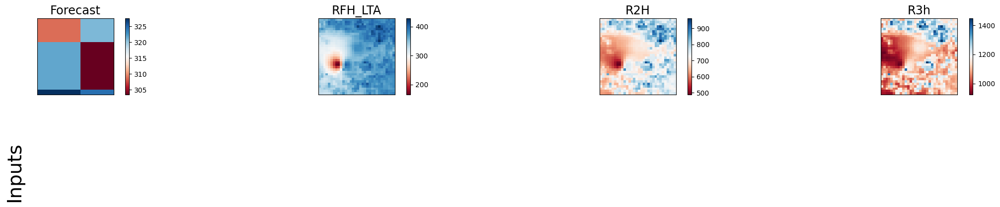

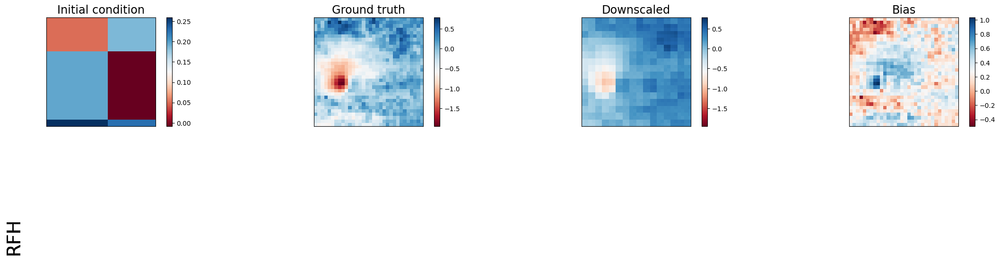

torch.Size([1, 1, 32, 32]) torch.Size([1, 1, 32, 32])


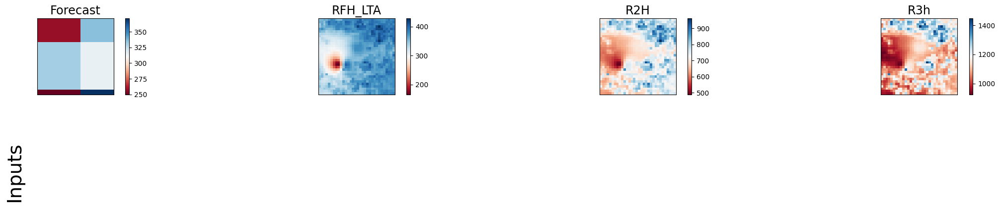

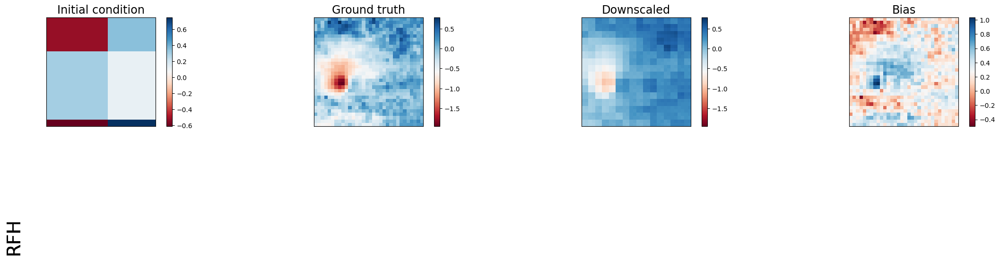

In [95]:
data = np.load("Data/Downscaling/Rainfall/Indonesia2_more/data_npz/test/2021_00_inp.npz")
data_out = np.load("Data/Downscaling/Rainfall/Indonesia2_more/data_npz/test/2021_00_out.npz")

time = 35

rfh_lta_2021 = data['rfh_lta']
forecast_2021 = data['forecast']
r2h_2021 = data['r2h']
r3h_2021 = data['r3h']
rfh_2021 = data_out['rfh']

rfh_lta_2021_02_01 = rfh_lta_2021[time]
rfh_2021_02_01 = rfh_2021[time]
r2h_2021_02_01 = r2h_2021[time]
r3h_2021_02_01 = r3h_2021[time]
forecast_2021_02_01 = forecast_2021[time]
forecast_2021_02_00 = forecast_2021[0]



forecast_2021_02_01 = torch.from_numpy(forecast_2021_02_01)
forecast_2021_02_00 = torch.from_numpy(forecast_2021_02_00)
rfh_lta_2021_02_01 = torch.from_numpy(rfh_lta_2021_02_01)
r2h_2021_02_01 = torch.from_numpy(r2h_2021_02_01)
r3h_2021_02_01 = torch.from_numpy(r3h_2021_02_01)

stacked_tensor = torch.cat((forecast_2021_02_01, rfh_lta_2021_02_01, r2h_2021_02_01, r3h_2021_02_01), dim=0)
x_2021_02_01 = datamodule.transforms(stacked_tensor.unsqueeze(0))
y_2021_02_01= datamodule.output_transforms(torch.from_numpy(rfh_2021_02_01).unsqueeze(0))

stacked_tensor = torch.cat((forecast_2021_02_00, rfh_lta_2021_02_01, r2h_2021_02_01, r3h_2021_02_01), dim=0)
x_2021_02_00 = datamodule.transforms(stacked_tensor.unsqueeze(0))

x_2021_02_01 = x_2021_02_01.float()  # Convert input to float data type
x_2021_02_00 = x_2021_02_00.float()  # Convert input to float data type
y_2021_02_01 = y_2021_02_01.float()  #

# The resulting tensor will have a size of (1, 4, 32, 32).
print(x_2021_02_01.shape)
print(y_2021_02_01.shape)

model.eval()
    



dataloader = datamodule.test_dataloader()

for batch_idx, batch_data in enumerate(dataloader, 1):        
    if batch_idx == 1:
        # Process the nth batch (e.g., 10th batch)
        x, y, lead_times, in_vars, out_vars = batch_data 
        
        
inv_normalize = model.denormalization
    
    
tensors=[]
for i in range(x_2021_02_01.shape[1]):
    tensors.append(inv_normalize(x_2021_02_01)[:,i])
    
tensors_0=[]
for i in range(x_2021_02_01.shape[1]):
    tensors_0.append(inv_normalize(x_2021_02_00)[:,i])

if torch.cuda.is_available():
    lead_times = lead_times.cuda()
else:
    lead_times = lead_times.cpu()


with torch.no_grad():
    _, pred = model.net.forward(x_2021_02_01, y_2021_02_01, lead_times[0:4], in_vars, out_vars, None, model.lat)
    _, pred_0 = model.net.forward(x_2021_02_00, y_2021_02_01, lead_times[0:4], in_vars, out_vars, None, model.lat)
    

tensors_pred = [x_2021_02_01[:,0:1,:], y_2021_02_01, pred[:,0:1,:], pred - y_2021_02_01[:,0:1,:]]
print(x_2021_02_01[:,0:1,:].shape, pred[0:1,:].shape)
plot_inputs(tensors, var_name, pred_task,0)
plot_pred(tensors_pred, var_name, pred_task,0)


tensors_pred = [x_2021_02_00[:,0:1,:], y_2021_02_01, pred_0[:,0:1,:], pred_0 -y_2021_02_01[:,0:1,:]]
print(x_2021_02_00[:,0:1,:].shape, pred_0[0:1,:].shape)
plot_inputs(tensors_0, var_name, pred_task,0)
plot_pred(tensors_pred, var_name, pred_task,0)


plt.imshow(pred_0[])
plt.show()

## Members in one block

In [10]:
task = "10 days"
pred_range = TASK_TO_RANGE[task]

net_args = {
    'default_vars': [
        'forecast', 'rfh_lta', 'rfh','r2h','r3h']
    ,"img_size" :  [32, 32],
      "patch_size" :  2,
      "embed_dim":   2048,
      "depth" : 8,
      "decoder_depth" :  2,
      "num_heads": 16,
    "mlp_ratio": 2,
    "drop_path": 0.5,
    "drop_rate": 0.5,
    
}
net = ClimaX(**net_args)
model = ClimateDownscalingModule(net=net, pretrained_path='ClimaX/exps/downscale/checkpoints/epoch_000-v1.ckpt')

datamodule = ClimateDownscalingDataModule(root_dir=f'Data/Downscaling/Rainfall/Indonesia2_more/data_npz',
    variables=['forecast', 'rfh_lta', 'r2h','r3h'],
    out_variables=['rfh'],
    buffer_size= 2000,
    batch_size= 80
)

normalization = datamodule.transforms
print(normalization)
mean_norm, std_norm = normalization.mean, normalization.std
mean_denorm, std_denorm = -mean_norm / std_norm, 1 / std_norm
model.set_denormalization(mean_denorm, std_denorm)
model.set_lat_lon(*datamodule.get_lat_lon())

denormalize_out = transforms.Normalize(datamodule.output_transforms.mean /datamodule.output_transforms.std , 1/datamodule.output_transforms.std)

datamodule.setup()


gt,pred,tensors,var_name, pred_task,tensors_pred = visualize_downscale(model, datamodule,mean_norm, std_norm, pred_range, var_name = "RFH", var_id = 1,desired_batch_index=1)
forecast, rfh_lta = tensors[0], tensors[1]
timesteps=gt.shape[0]

Loading pre-trained checkpoint from: ClimaX/exps/downscale/checkpoints/epoch_000-v1.ckpt
<All keys matched successfully>
Normalize(mean=[ 304.16600998  352.55984266  723.97152215 1109.51157134], std=[ 89.65293822  56.13912941  86.60086883 114.82800712])


/mnt/shared/users/wessim.omezzine/.local/lib/python3.10/site-packages/torch/cuda/__init__.py:546: UserWarning: Can't initialize NVML
  warnings.warn("Can't initialize NVML")


Selected device: cpu
self.var_map=== {'forecast': 0, 'rfh_lta': 1, 'rfh': 2, 'r2h': 3, 'r3h': 4}
self.var_map=== {'forecast': 0, 'rfh_lta': 1, 'rfh': 2, 'r2h': 3, 'r3h': 4}


Time step 0
torch.Size([80, 1, 32, 32])


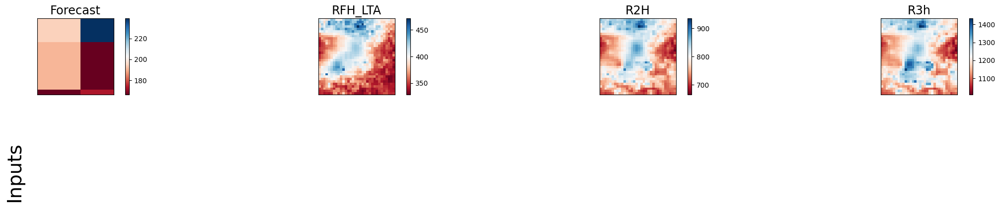

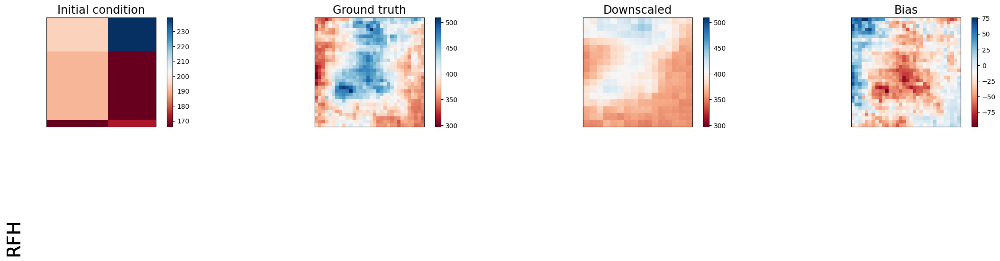

/mnt/shared/users/wessim.omezzine/.local/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3464: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/mnt/shared/users/wessim.omezzine/.local/lib/python3.10/site-packages/numpy/core/_methods.py:192: RuntimeWarning: invalid value encountered in divide
  ret = ret.dtype.type(ret / rcount)


Selected device: cpu
+----------------------+--------------------+---------------------+------------------------+---------------------+
|                      | Coarse             | ClimaX              | Bilinear Interpolation | Weighted Mask       |
+----------------------+--------------------+---------------------+------------------------+---------------------+
| lat_weighted_mse_val | 46377.09765625     | 1124.96240234375    | 45626.078125           | 46079.1171875       |
| lat_weighted_rmse    | 215.35342407226562 | 33.54045867919922   | 213.6026153564453      | 214.6604766845703   |
| spearman             | 0.2388069672535636 | 0.6908732602346528  | 0.27759430685874237    | 0.4828784236970426  |
| mean_bias            | 211.736572265625   | -18.956268310546875 | -210.24169921875       | -211.71363830566406 |
| pearson              | 0.2373912904158088 | 0.6915754681438449  | 0.24480186856370445    | 0.42312660272428243 |
+----------------------+--------------------+--------------

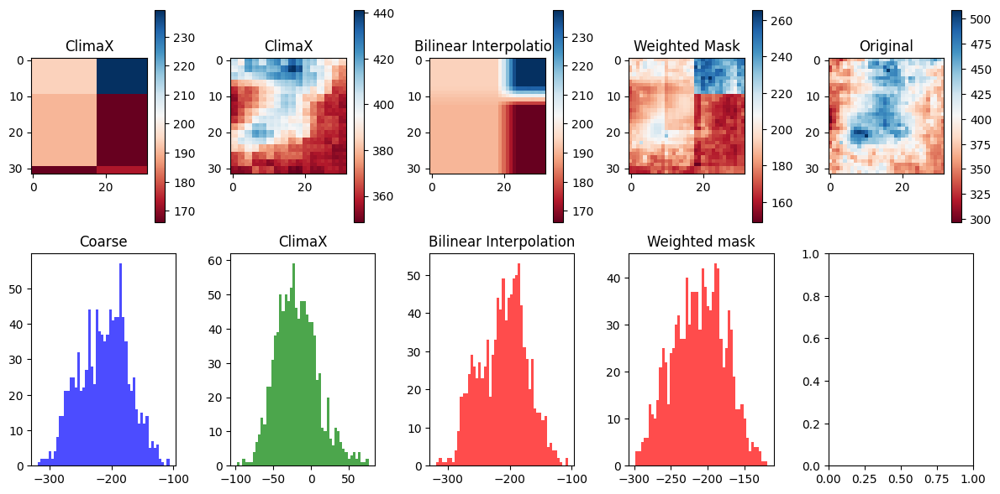

Time step 1
torch.Size([80, 1, 32, 32])


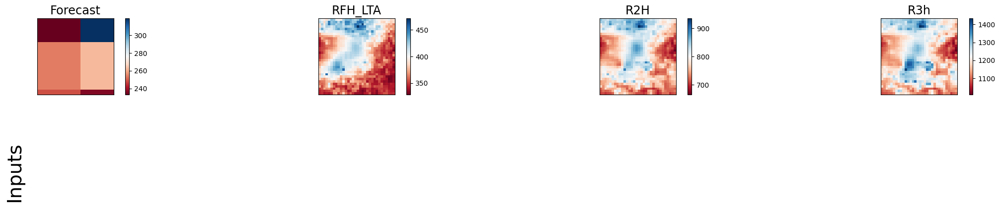

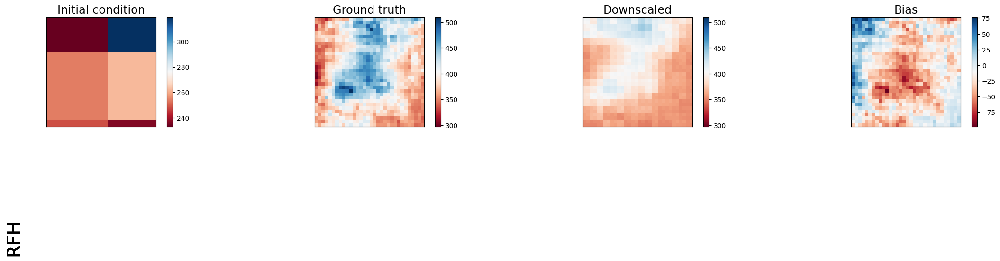

Selected device: cpu
+----------------------+---------------------+--------------------+------------------------+---------------------+
|                      | Coarse              | ClimaX             | Bilinear Interpolation | Weighted Mask       |
+----------------------+---------------------+--------------------+------------------------+---------------------+
| lat_weighted_mse_val | 21681.7109375       | 1124.84912109375   | 22497.125              | 21323.609375        |
| lat_weighted_rmse    | 147.24710083007812  | 33.53876876831055  | 149.99041748046875     | 146.02606201171875  |
| spearman             | 0.0411120463407614  | 0.6908780009408239 | -0.16242741810149847   | 0.38968667496283954 |
| mean_bias            | 140.88092041015625  | -18.95367431640625 | -143.2718505859375     | -140.86666870117188 |
| pearson              | 0.12566593979075263 | 0.6915836577645842 | -0.04607087285111562   | 0.35473886012321554 |
+----------------------+---------------------+-------------

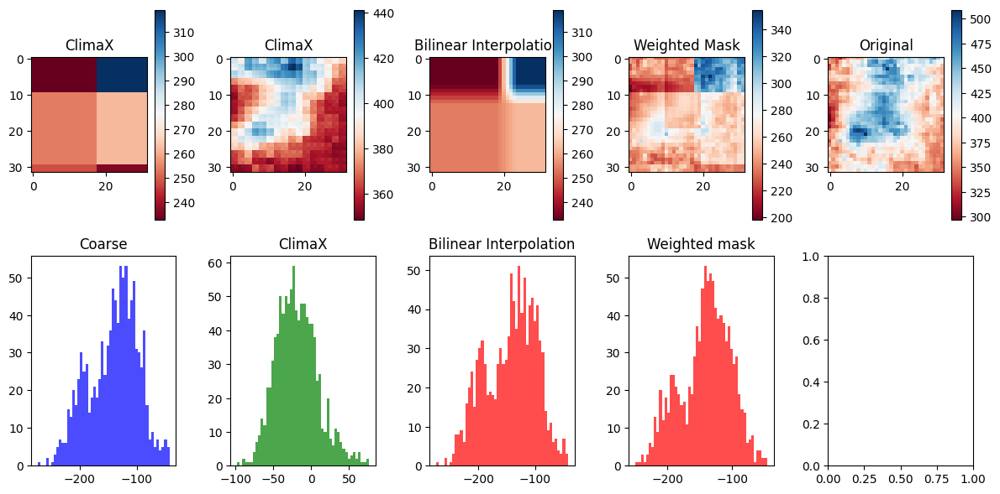

Time step 2
torch.Size([80, 1, 32, 32])


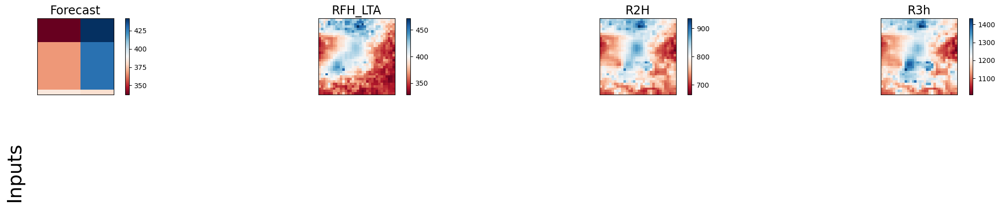

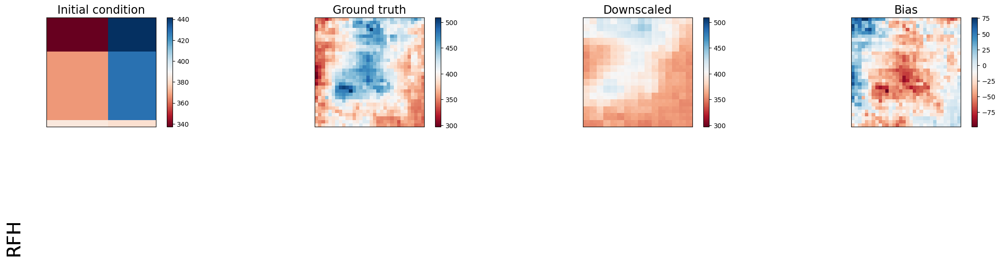

Selected device: cpu
+----------------------+-----------------------+--------------------+------------------------+---------------------+
|                      | Coarse                | ClimaX             | Bilinear Interpolation | Weighted Mask       |
+----------------------+-----------------------+--------------------+------------------------+---------------------+
| lat_weighted_mse_val | 3203.105712890625     | 1124.70458984375   | 3702.969970703125      | 2767.31689453125    |
| lat_weighted_rmse    | 56.595985412597656    | 33.536617279052734 | 60.85203170776367      | 52.60529327392578   |
| spearman             | -0.030878581573598983 | 0.6908728355330411 | -0.19617713651662702   | 0.18352114536371786 |
| mean_bias            | 11.92340087890625     | -18.9500732421875  | -19.382568359375       | -11.938812255859375 |
| pearson              | -0.06127648868210968  | 0.6915835720288233 | -0.24858283948666837   | 0.1858867239807712  |
+----------------------+-------------------

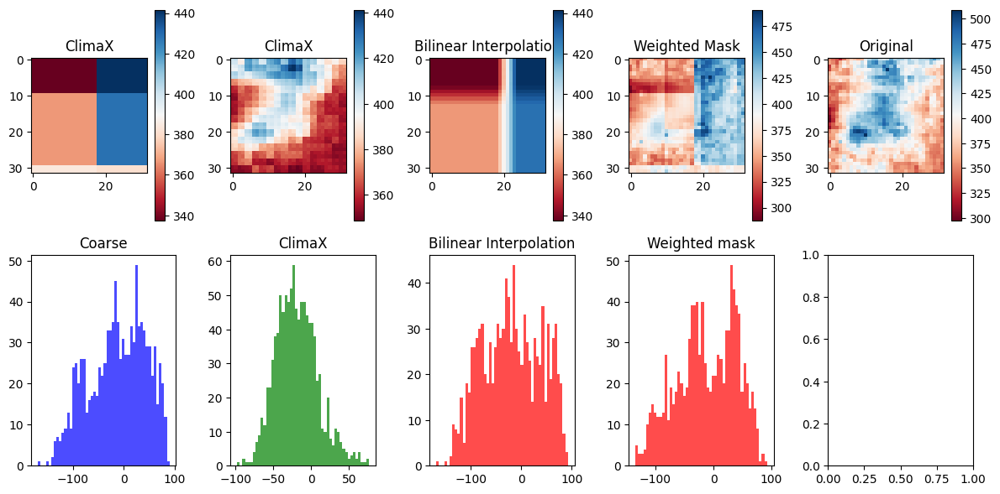

Time step 3
torch.Size([80, 1, 32, 32])


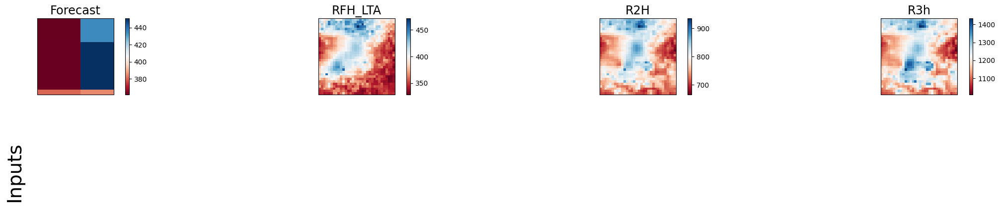

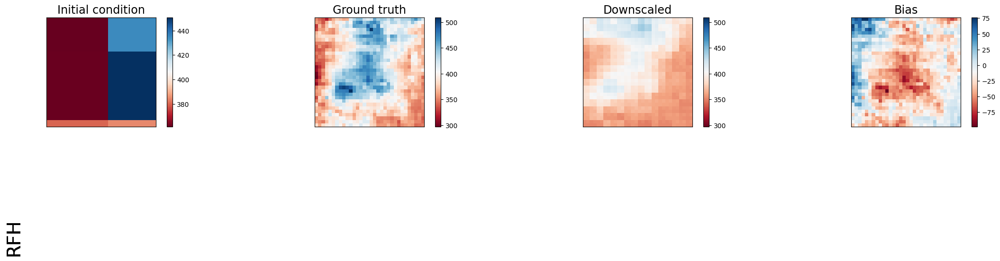

Selected device: cpu
+----------------------+----------------------+--------------------+------------------------+---------------------+
|                      | Coarse               | ClimaX             | Bilinear Interpolation | Weighted Mask       |
+----------------------+----------------------+--------------------+------------------------+---------------------+
| lat_weighted_mse_val | 3497.751953125       | 1124.7022705078125 | 3821.958984375         | 3045.15087890625    |
| lat_weighted_rmse    | 59.14179611206055    | 33.536582946777344 | 61.82199478149414      | 55.182884216308594  |
| spearman             | -0.13608023565406074 | 0.6908649953177611 | -0.24701806698170578   | 0.14156424503657028 |
| mean_bias            | 4.27392578125        | -18.9498291015625  | -12.01666259765625     | -4.31317138671875   |
| pearson              | -0.12458060813660425 | 0.6915794227963601 | -0.30663953539248323   | 0.11664165605493292 |
+----------------------+----------------------+----

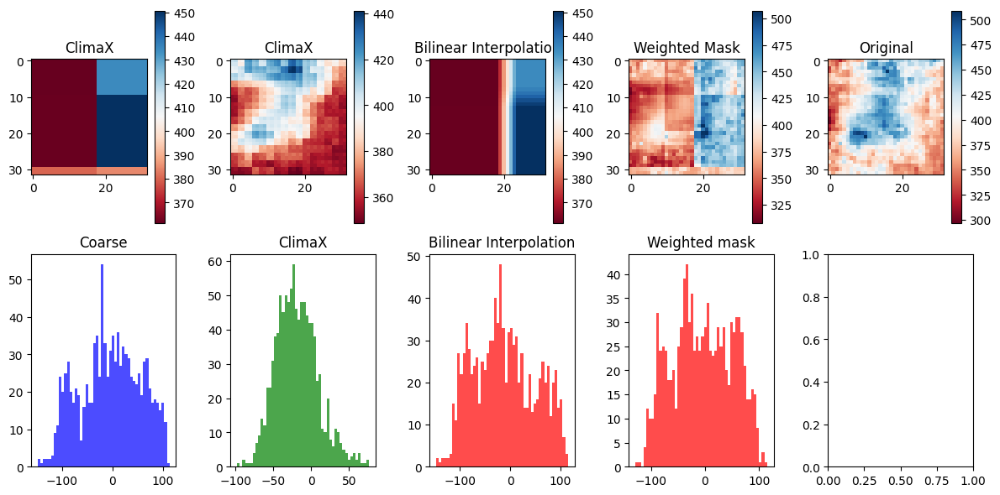

Time step 4
torch.Size([80, 1, 32, 32])


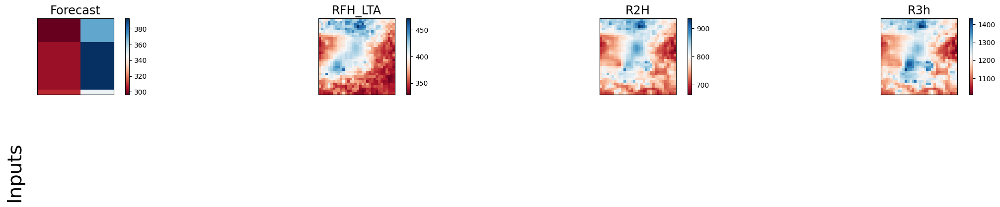

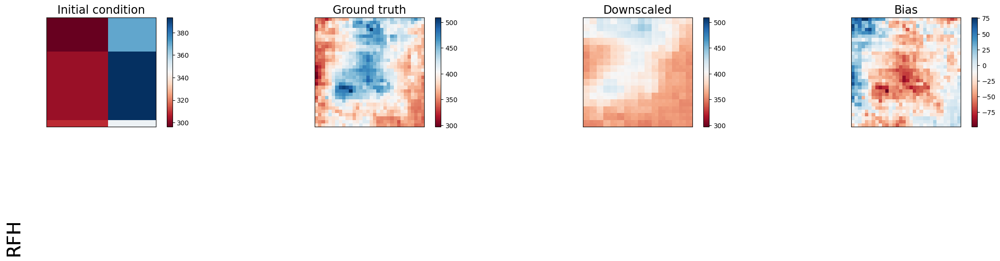

Selected device: cpu
+----------------------+----------------------+--------------------+------------------------+----------------------+
|                      | Coarse               | ClimaX             | Bilinear Interpolation | Weighted Mask        |
+----------------------+----------------------+--------------------+------------------------+----------------------+
| lat_weighted_mse_val | 7802.23291015625     | 1124.7645263671875 | 9039.12890625          | 7374.06640625        |
| lat_weighted_rmse    | 88.33024597167969    | 33.53750991821289  | 95.07433319091797      | 85.87238311767578    |
| spearman             | -0.13608023565406074 | 0.6908702593824751 | -0.2519894475007175    | 0.10749815578178111  |
| mean_bias            | 64.48291015625       | -18.95147705078125 | -72.56671142578125     | -64.52761840820312   |
| pearson              | -0.14727228452636026 | 0.6915830967225771 | -0.3152618580726674    | 0.056879211903251445 |
+----------------------+-------------------

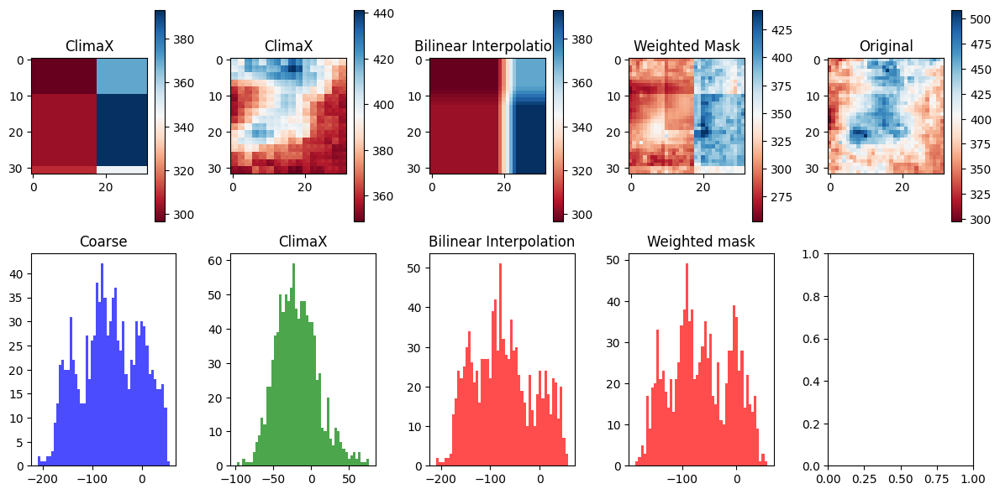

Time step 5
torch.Size([80, 1, 32, 32])


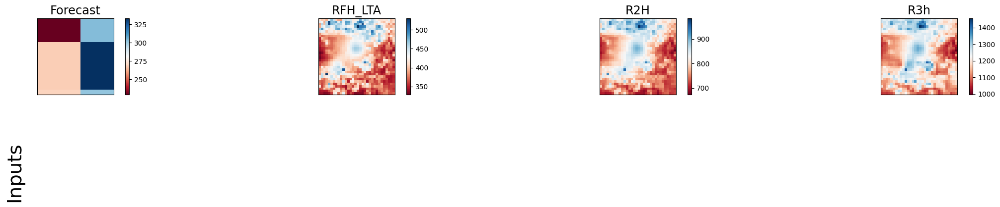

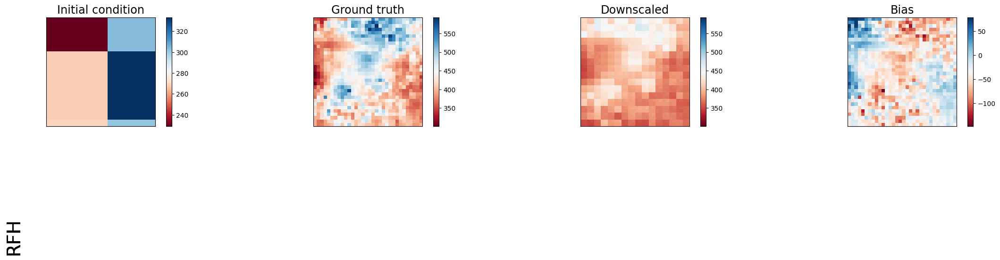

Selected device: cpu
+----------------------+----------------------+---------------------+------------------------+---------------------+
|                      | Coarse               | ClimaX              | Bilinear Interpolation | Weighted Mask       |
+----------------------+----------------------+---------------------+------------------------+---------------------+
| lat_weighted_mse_val | 16738.134765625      | 2396.018310546875   | 29113.712890625        | 25900.375           |
| lat_weighted_rmse    | 129.37594604492188   | 48.94913864135742   | 170.62741088867188     | 160.93592834472656  |
| spearman             | -0.13608023565406074 | 0.7720955068937693  | -0.28239438487780827   | 0.11372536205646556 |
| mean_bias            | 116.4920654296875    | -36.348663330078125 | -156.679931640625      | -149.64300537109375 |
| pearson              | -0.14040960279776815 | 0.7671657801690954  | -0.3031806524071964    | 0.14750867682347996 |
+----------------------+-------------------

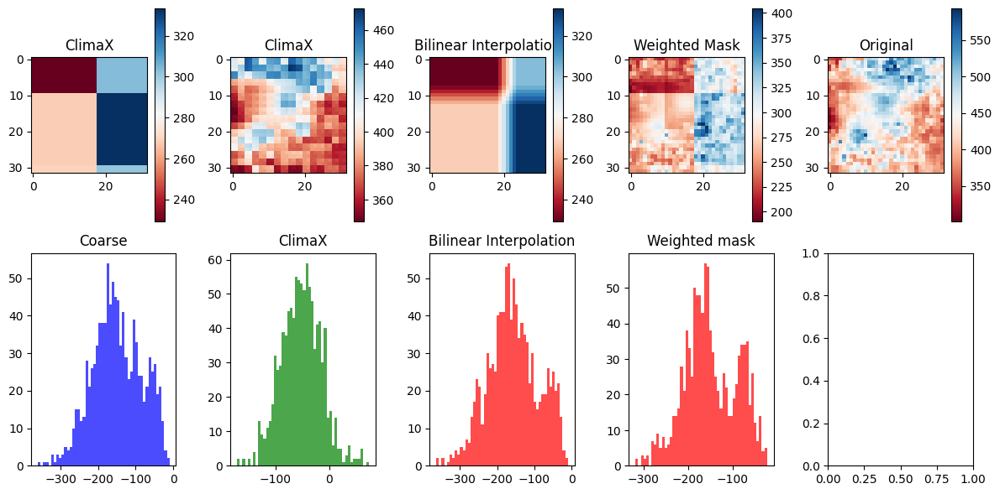

Time step 6
torch.Size([80, 1, 32, 32])


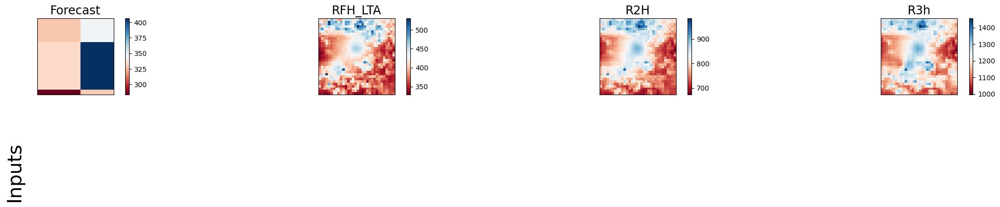

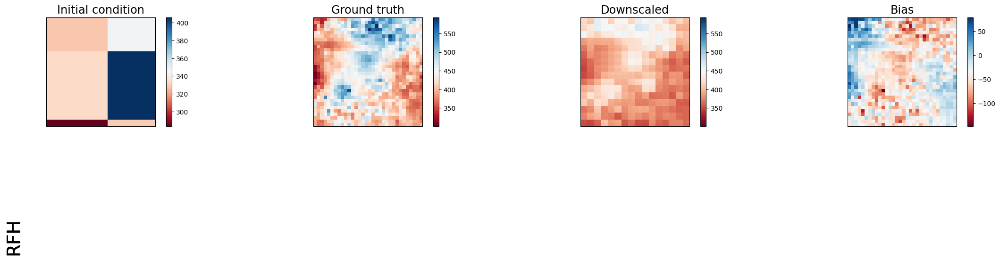

Selected device: cpu
+----------------------+----------------------+--------------------+------------------------+---------------------+
|                      | Coarse               | ClimaX             | Bilinear Interpolation | Weighted Mask       |
+----------------------+----------------------+--------------------+------------------------+---------------------+
| lat_weighted_mse_val | 5483.62109375        | 2395.8486328125    | 11524.08984375         | 10334.208984375     |
| lat_weighted_rmse    | 74.05147552490234    | 48.94740676879883  | 107.35031127929688     | 101.65731048583984  |
| spearman             | -0.06025847117515135 | 0.7720847107214315 | -0.2700454431815006    | 0.1672022037390214  |
| mean_bias            | 49.40753173828125    | -36.34613037109375 | -85.06704711914062     | -82.5885009765625   |
| pearson              | -0.15037449059262428 | 0.767156166812117  | -0.39117802214751407   | 0.15474201565359202 |
+----------------------+----------------------+----

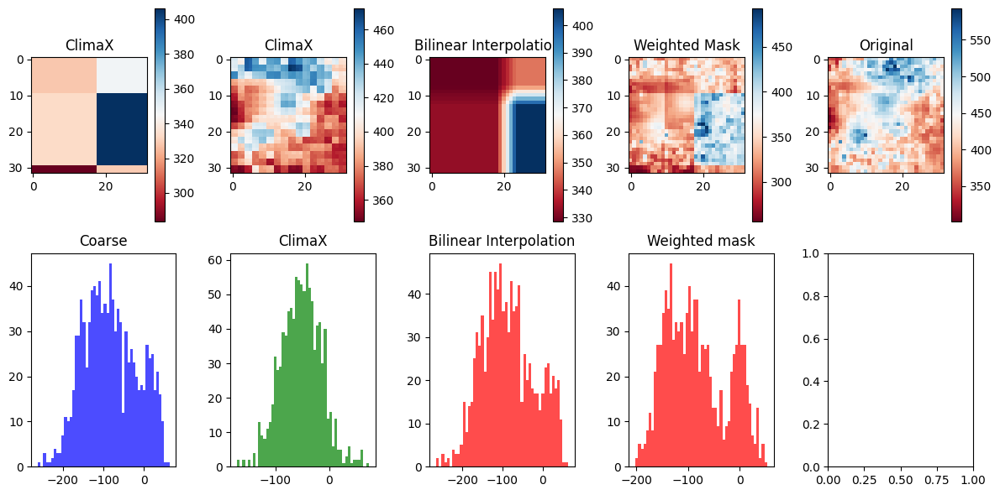

Time step 7
torch.Size([80, 1, 32, 32])


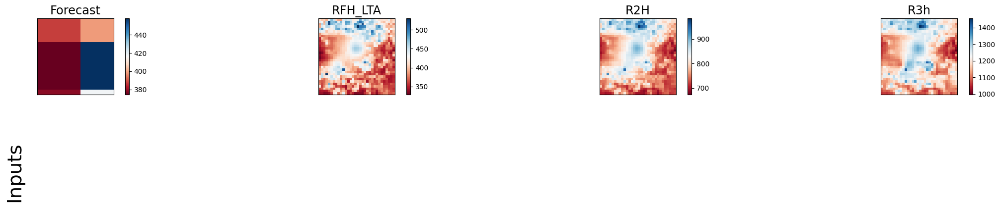

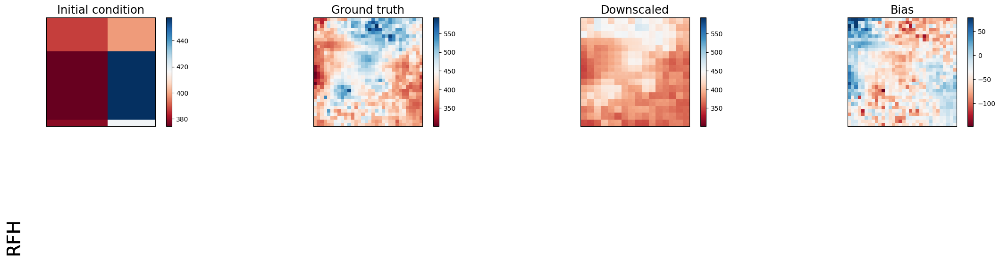

Selected device: cpu
+----------------------+----------------------+---------------------+------------------------+---------------------+
|                      | Coarse               | ClimaX              | Bilinear Interpolation | Weighted Mask       |
+----------------------+----------------------+---------------------+------------------------+---------------------+
| lat_weighted_mse_val | 3211.604248046875    | 2395.73974609375    | 5683.86572265625       | 4535.29345703125    |
| lat_weighted_rmse    | 56.671016693115234   | 48.946292877197266  | 75.39141845703125      | 67.34458923339844   |
| spearman             | -0.20429724718716072 | 0.7720906005587215  | -0.20481664781448328   | 0.15168250409531095 |
| mean_bias            | -2.39312744140625    | -36.344696044921875 | -36.44091796875        | -30.788970947265625 |
| pearson              | -0.22110080320045916 | 0.7671549356296685  | -0.35087345017688093   | 0.1661872091528656  |
+----------------------+-------------------

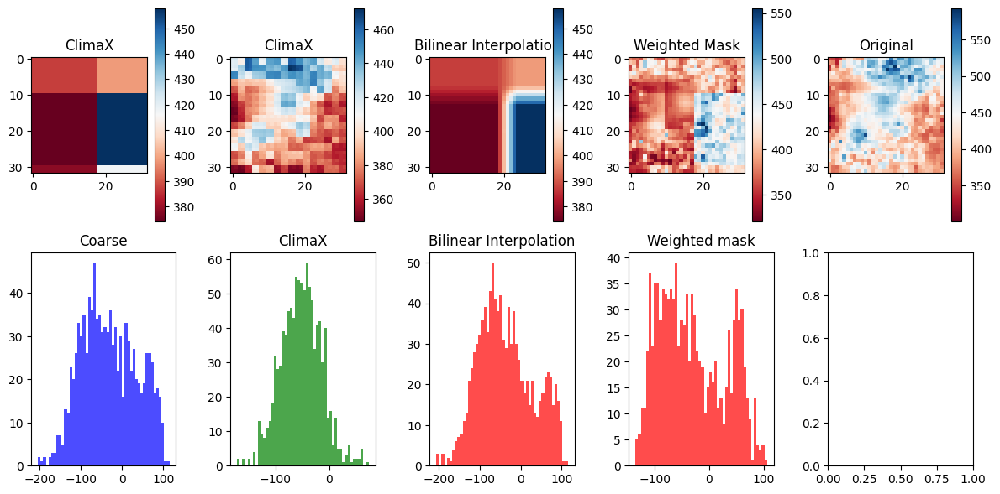

Time step 8
torch.Size([80, 1, 32, 32])


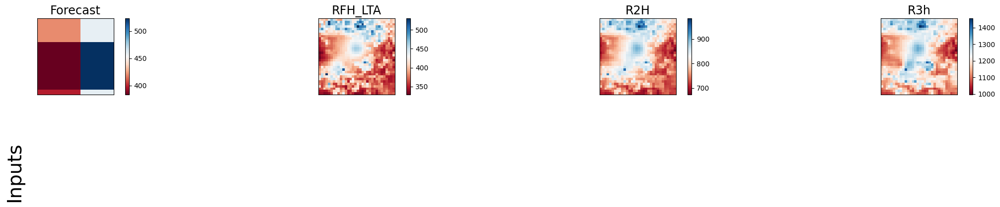

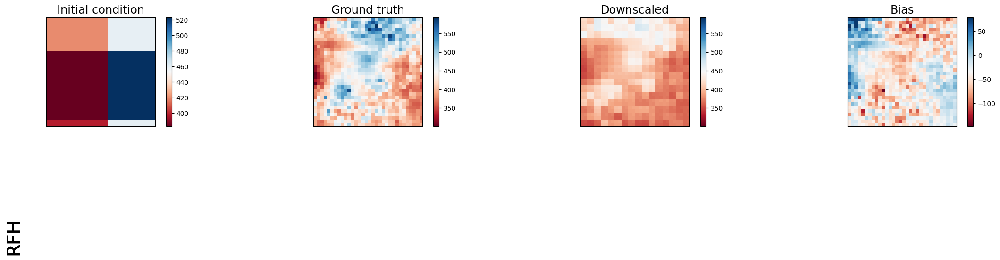

Selected device: cpu
+----------------------+----------------------+---------------------+------------------------+---------------------+
|                      | Coarse               | ClimaX              | Bilinear Interpolation | Weighted Mask       |
+----------------------+----------------------+---------------------+------------------------+---------------------+
| lat_weighted_mse_val | 7045.0546875         | 2395.66943359375    | 6316.9951171875        | 5735.296875         |
| lat_weighted_rmse    | 83.93482208251953    | 48.94557571411133   | 79.47952270507812      | 75.73174285888672   |
| spearman             | -0.20429724718716072 | 0.7720902932142708  | -0.1940559069273651    | 0.12041216617673162 |
| mean_bias            | -39.40679931640625   | -36.343780517578125 | -3.827392578125        | 6.2391357421875     |
| pearson              | -0.19618863554164437 | 0.7671544992959398  | -0.2647893398517339    | 0.12277798918799467 |
+----------------------+-------------------

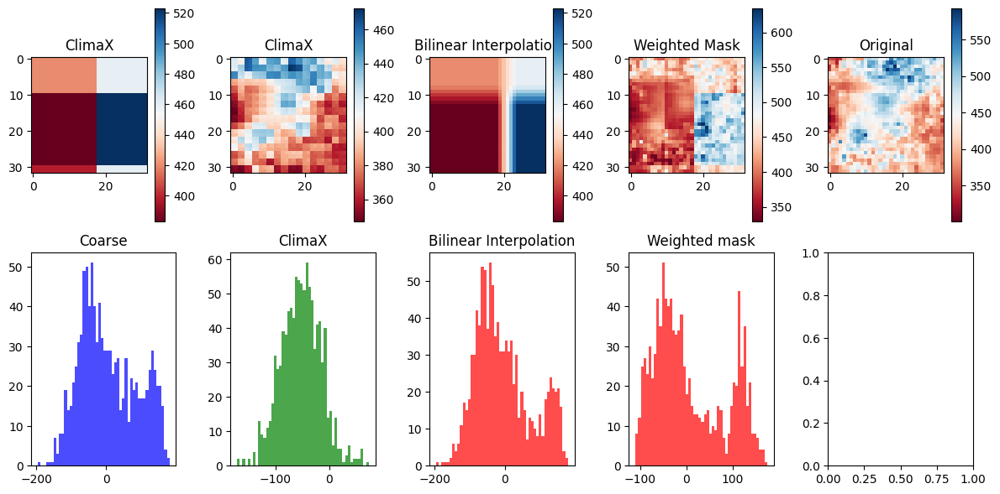

Time step 9
torch.Size([80, 1, 32, 32])


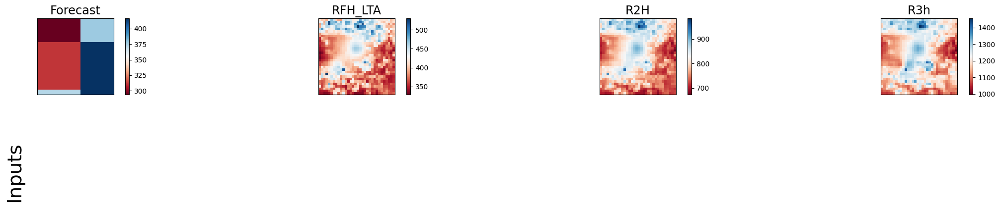

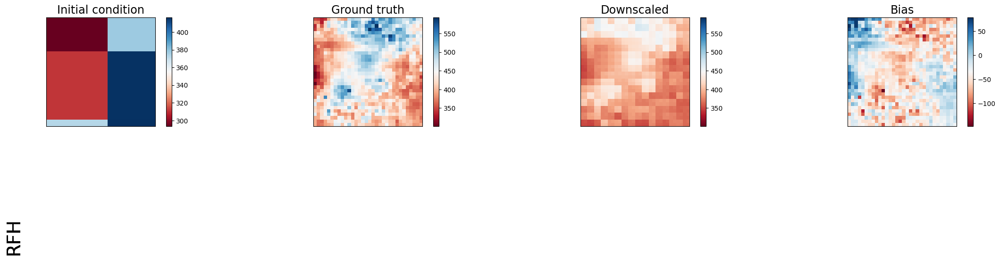

Selected device: cpu
+----------------------+----------------------+--------------------+------------------------+---------------------+
|                      | Coarse               | ClimaX             | Bilinear Interpolation | Weighted Mask       |
+----------------------+----------------------+--------------------+------------------------+---------------------+
| lat_weighted_mse_val | 7308.50927734375     | 2395.856201171875  | 15041.3203125          | 11977.0751953125    |
| lat_weighted_rmse    | 85.48982238769531    | 48.94748306274414  | 122.64305877685547     | 109.43982696533203  |
| spearman             | -0.18809551233306873 | 0.7720907905534727 | -0.2521577845597778    | 0.10187411477333441 |
| mean_bias            | 50.91259765625       | -36.346435546875   | -97.05694580078125     | -84.0577392578125   |
| pearson              | -0.19986934121951144 | 0.7671632664106426 | -0.2807075662200731    | 0.10232222464761404 |
+----------------------+----------------------+----

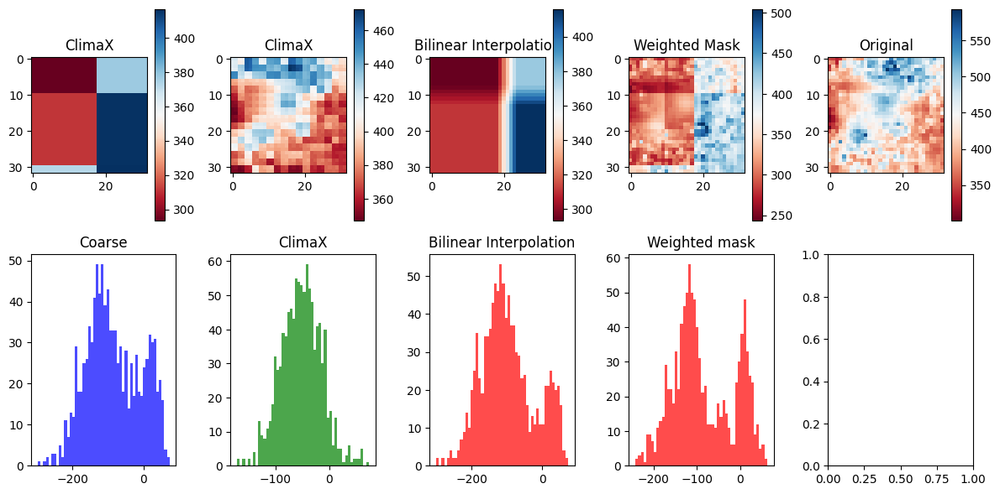

Time step 10
torch.Size([80, 1, 32, 32])


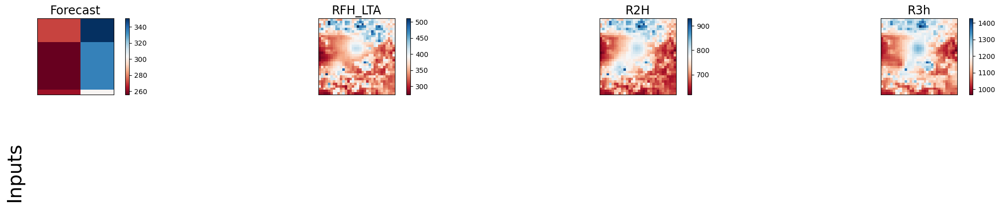

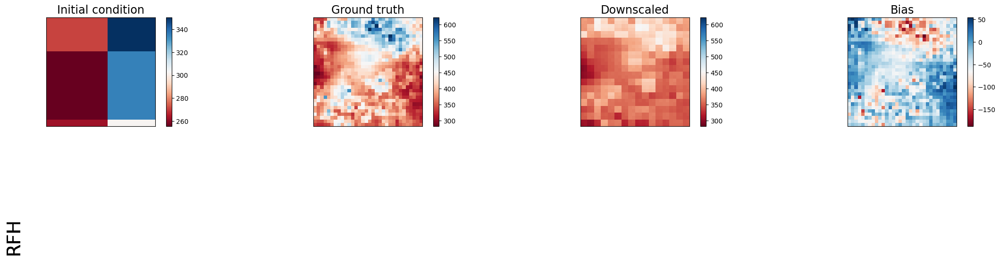

Selected device: cpu
+----------------------+----------------------+--------------------+------------------------+---------------------+
|                      | Coarse               | ClimaX             | Bilinear Interpolation | Weighted Mask       |
+----------------------+----------------------+--------------------+------------------------+---------------------+
| lat_weighted_mse_val | 14721.0703125        | 3142.202392578125  | 20027.646484375        | 16675.44140625      |
| lat_weighted_rmse    | 121.3304214477539    | 56.05535125732422  | 141.51907348632812     | 129.1334228515625   |
| spearman             | -0.07915035933722339 | 0.8434491757043603 | 0.055325153803737      | 0.38813740215629694 |
| mean_bias            | 107.03228759765625   | -38.62835693359375 | -121.63323974609375    | -114.18472290039062 |
| pearson              | -0.09718410385977955 | 0.8430747431881352 | -0.005330357619366725  | 0.429156751830458   |
+----------------------+----------------------+----

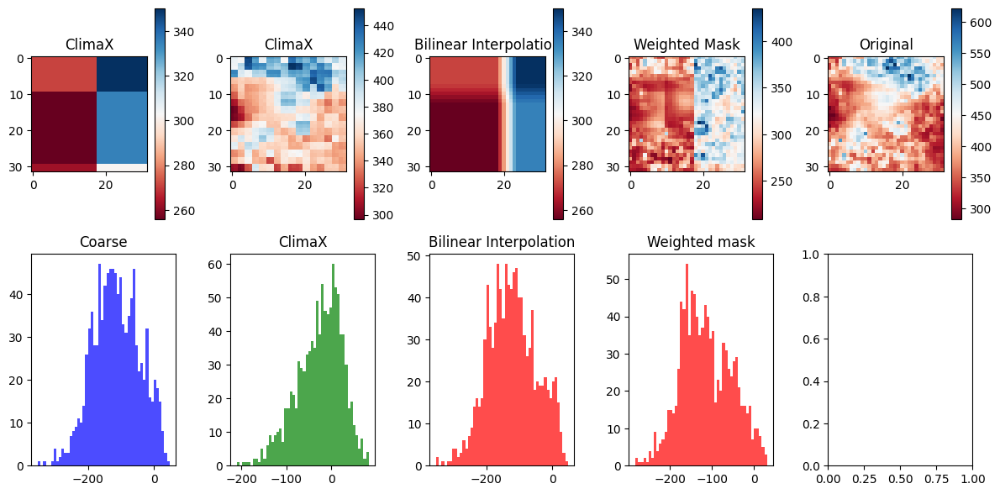

Time step 11
torch.Size([80, 1, 32, 32])


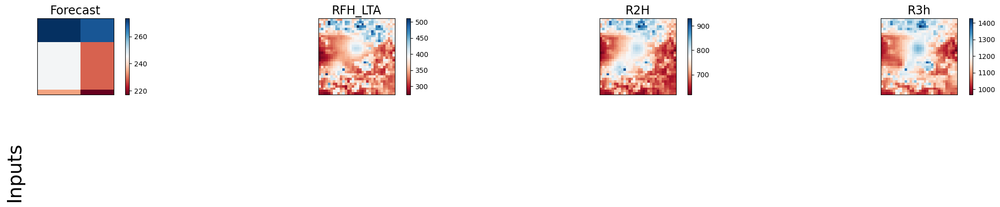

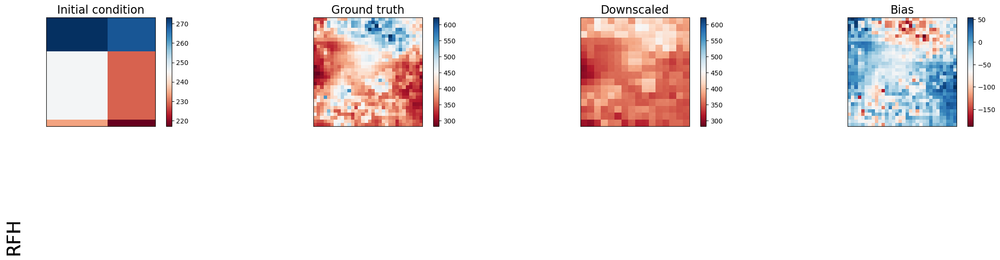

Selected device: cpu
+----------------------+---------------------+--------------------+------------------------+---------------------+
|                      | Coarse              | ClimaX             | Bilinear Interpolation | Weighted Mask       |
+----------------------+---------------------+--------------------+------------------------+---------------------+
| lat_weighted_mse_val | 25065.6953125       | 3142.3212890625    | 28075.634765625        | 27812.33203125      |
| lat_weighted_rmse    | 158.3214874267578   | 56.05641174316406  | 167.557861328125       | 166.77029418945312  |
| spearman             | 0.23427918446753107 | 0.8434449176142894 | 0.5405793151749037     | 0.7991106795537026  |
| mean_bias            | 153.65211486816406  | -38.6297607421875  | -158.18226623535156    | -160.94338989257812 |
| pearson              | 0.21724769190774568 | 0.843076310852914  | 0.5812963138883613     | 0.8013257538826668  |
+----------------------+---------------------+-------------

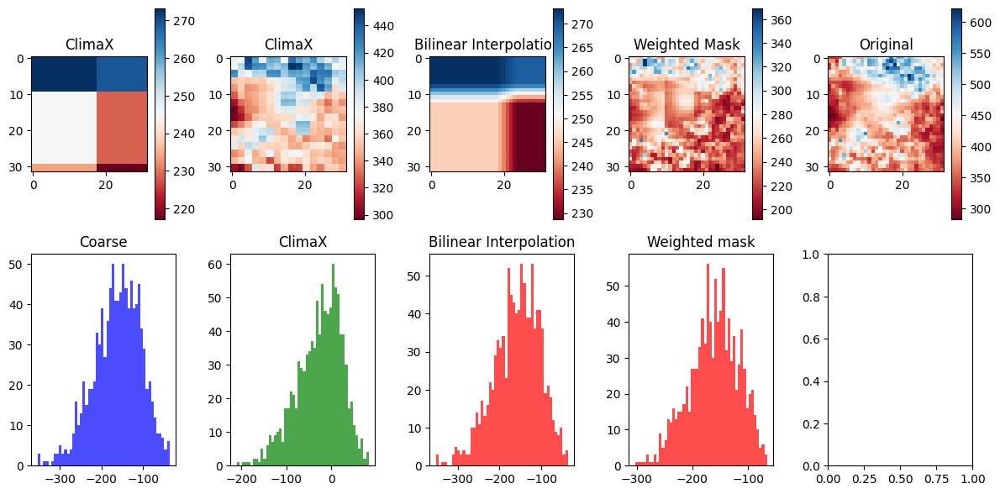

Time step 12
torch.Size([80, 1, 32, 32])


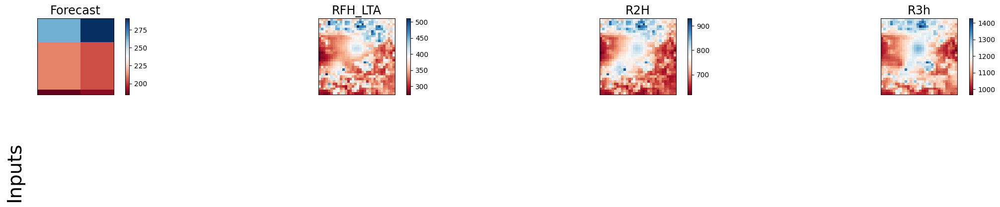

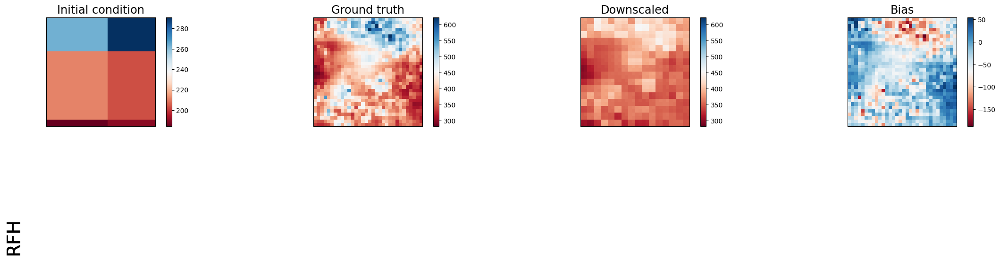

Selected device: cpu
+----------------------+---------------------+--------------------+------------------------+---------------------+
|                      | Coarse              | ClimaX             | Bilinear Interpolation | Weighted Mask       |
+----------------------+---------------------+--------------------+------------------------+---------------------+
| lat_weighted_mse_val | 32427.142578125     | 3142.357666015625  | 34718.46875            | 34416.2109375       |
| lat_weighted_rmse    | 180.07537841796875  | 56.05673599243164  | 186.3289337158203      | 185.5160675048828   |
| spearman             | 0.26135492550865874 | 0.8434488595423827 | 0.5913049078640829     | 0.768836691192973   |
| mean_bias            | 174.07455444335938  | -38.6304931640625  | -179.05511474609375    | -181.33583068847656 |
| pearson              | 0.17298028905987614 | 0.8430760996294688 | 0.5832156273332179     | 0.800679665832057   |
+----------------------+---------------------+-------------

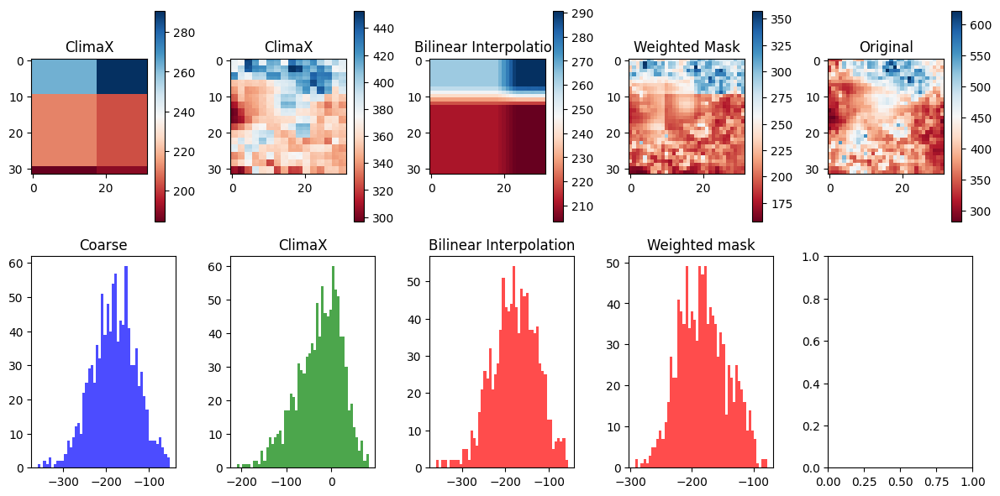

Time step 13
torch.Size([80, 1, 32, 32])


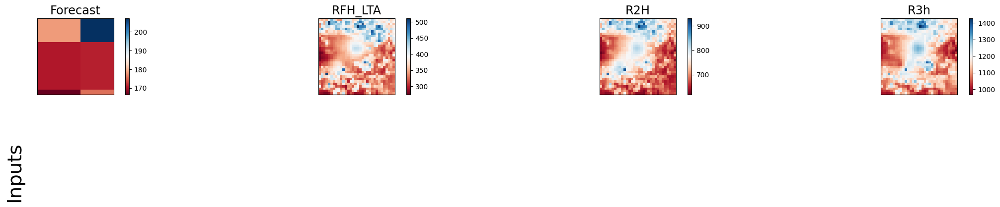

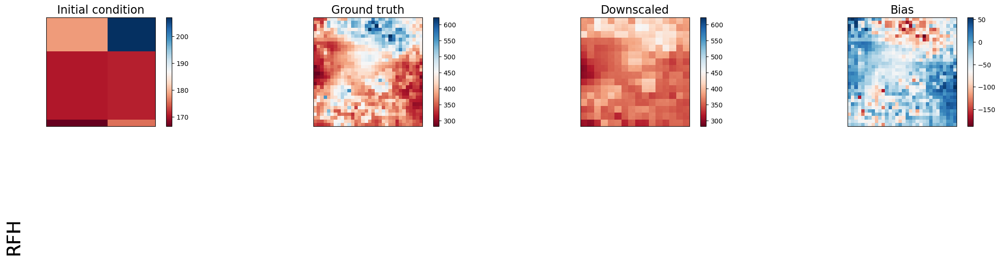

Selected device: cpu
+----------------------+----------------------+--------------------+------------------------+---------------------+
|                      | Coarse               | ClimaX             | Bilinear Interpolation | Weighted Mask       |
+----------------------+----------------------+--------------------+------------------------+---------------------+
| lat_weighted_mse_val | 51897.83984375       | 3142.587646484375  | 57449.265625           | 56060.34375         |
| lat_weighted_rmse    | 227.81097412109375   | 56.05878829956055  | 239.68576049804688     | 236.77066040039062  |
| spearman             | -0.00944464471424934 | 0.8434550152110847 | 0.34803519782536285    | 0.7681740223565151  |
| mean_bias            | 224.5829315185547    | -38.63275146484375 | -232.4747772216797     | -231.83709716796875 |
| pearson              | 0.1363688929887004   | 0.8430761412245076 | 0.4937633398244268     | 0.8086527061085568  |
+----------------------+----------------------+----

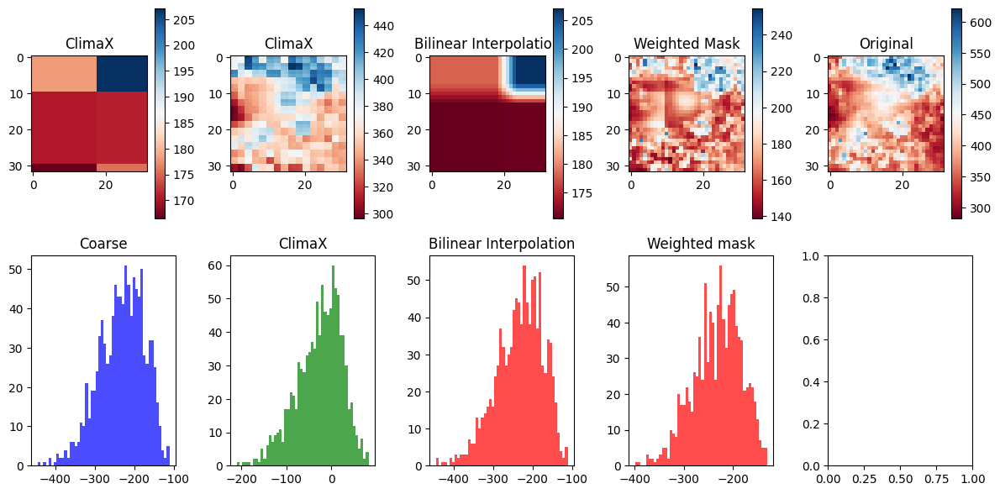

Time step 14
torch.Size([80, 1, 32, 32])


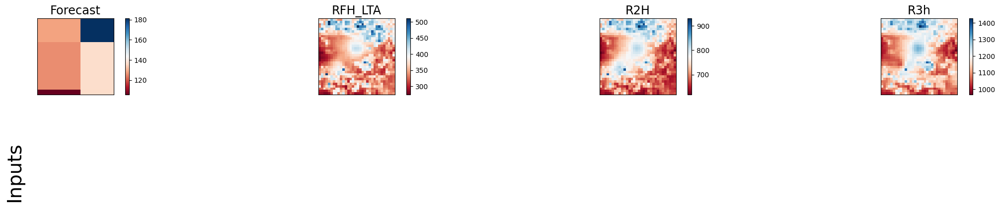

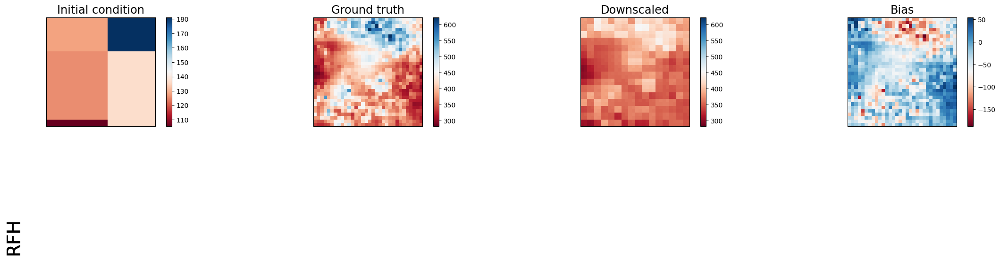

Selected device: cpu
+----------------------+-----------------------+--------------------+------------------------+---------------------+
|                      | Coarse                | ClimaX             | Bilinear Interpolation | Weighted Mask       |
+----------------------+-----------------------+--------------------+------------------------+---------------------+
| lat_weighted_mse_val | 72035.421875          | 3142.757080078125  | 78641.5390625          | 76767.453125        |
| lat_weighted_rmse    | 268.3941650390625     | 56.060298919677734 | 280.4309997558594      | 277.06939697265625  |
| spearman             | -0.061893747479157796 | 0.8434556410720925 | 0.11213407131864749    | 0.5952470996767446  |
| mean_bias            | 265.2625427246094     | -38.63470458984375 | -274.007080078125      | -272.49200439453125 |
| pearson              | 0.08626977663915347   | 0.8430755315827826 | 0.3171440570788496     | 0.6809435751444137  |
+----------------------+-------------------

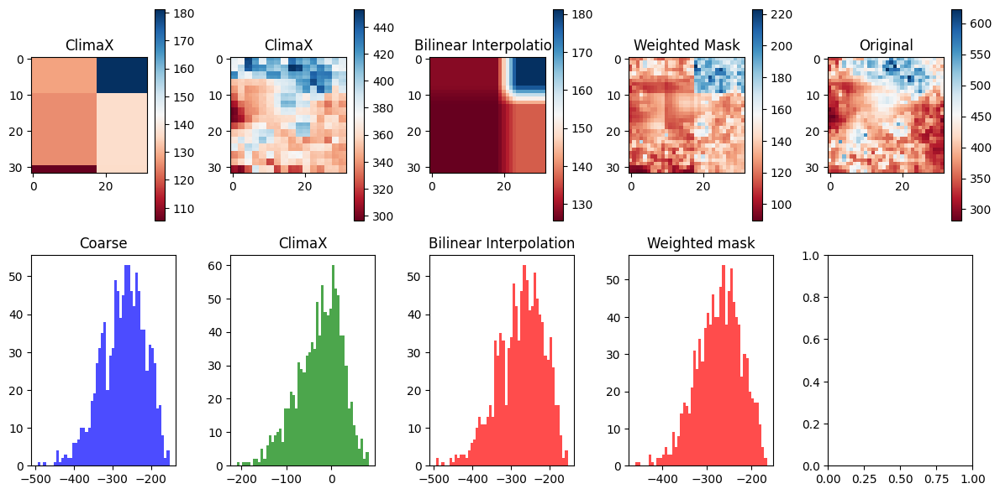

Time step 15
torch.Size([80, 1, 32, 32])


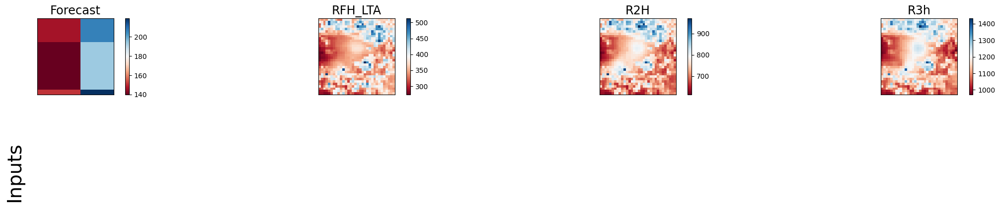

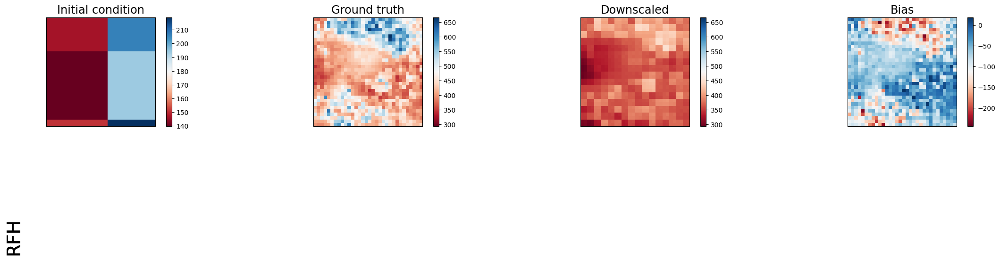

Selected device: cpu
+----------------------+----------------------+--------------------+------------------------+---------------------+
|                      | Coarse               | ClimaX             | Bilinear Interpolation | Weighted Mask       |
+----------------------+----------------------+--------------------+------------------------+---------------------+
| lat_weighted_mse_val | 57422.02734375       | 8303.6064453125    | 88154.9921875          | 83244.3671875       |
| lat_weighted_rmse    | 239.62893676757812   | 91.12413024902344  | 296.9090576171875      | 288.52099609375     |
| spearman             | -0.13499677258078036 | 0.7068689026986971 | 0.14295311187267537    | 0.405576622023548   |
| mean_bias            | 234.18991088867188   | -78.8135986328125  | -289.5975036621094     | -282.726806640625   |
| pearson              | -0.146225131932555   | 0.7299413817526338 | 0.0688651211819394     | 0.40375166011256564 |
+----------------------+----------------------+----

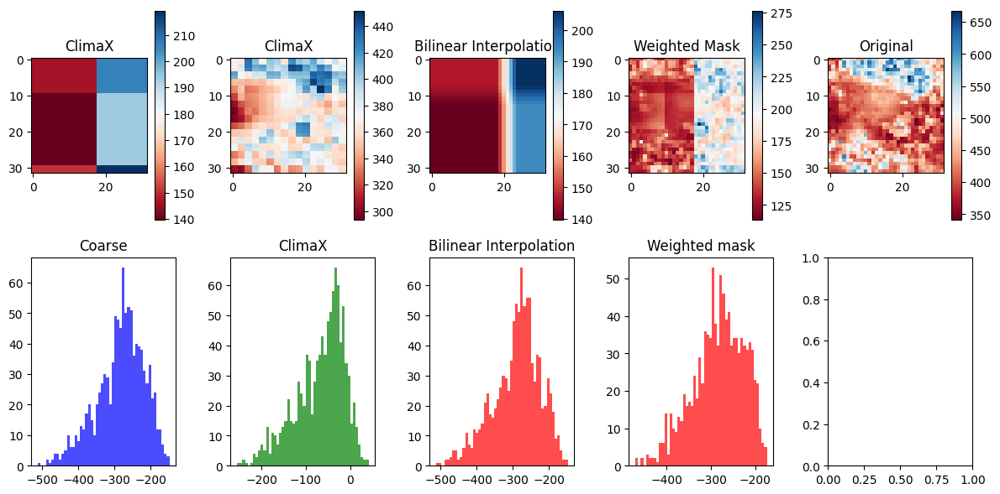

Time step 16
torch.Size([80, 1, 32, 32])


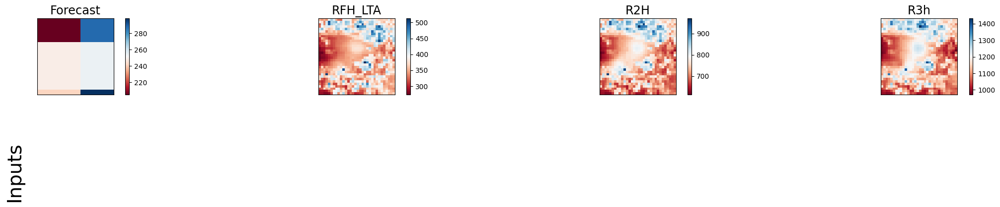

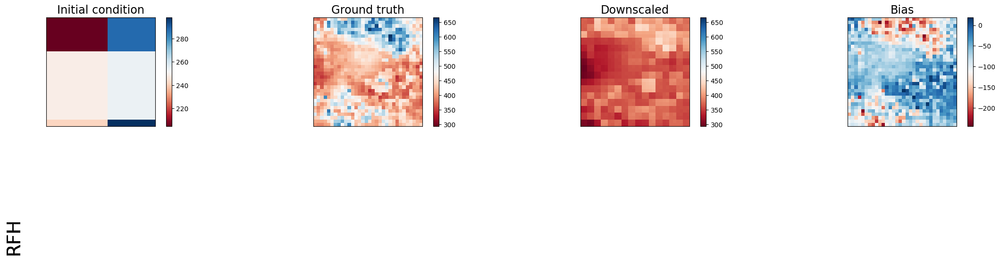

Selected device: cpu
+----------------------+-----------------------+--------------------+------------------------+---------------------+
|                      | Coarse                | ClimaX             | Bilinear Interpolation | Weighted Mask       |
+----------------------+-----------------------+--------------------+------------------------+---------------------+
| lat_weighted_mse_val | 25395.37890625        | 8303.0361328125    | 46948.01171875         | 43580.81640625      |
| lat_weighted_rmse    | 159.35928344726562    | 91.1209945678711   | 216.67489624023438     | 208.76019287109375  |
| spearman             | -0.06976846707787686  | 0.706875811542708  | -0.11598564916334456   | 0.45680112739738366 |
| mean_bias            | 152.6959228515625     | -78.81015014648438 | -205.81358337402344    | -201.28048706054688 |
| pearson              | -0.011379533939249585 | 0.7299481476547071 | -0.08468932127200463   | 0.4643402091400288  |
+----------------------+-------------------

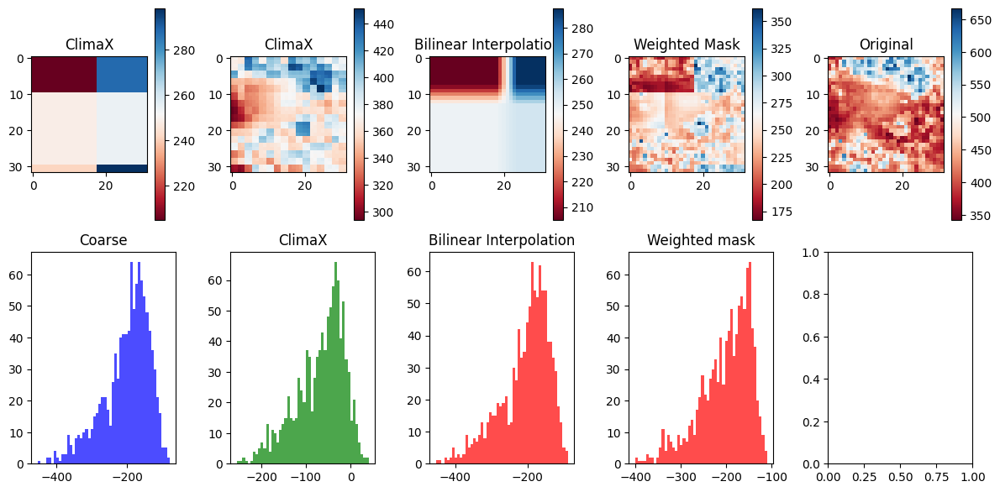

Time step 17
torch.Size([80, 1, 32, 32])


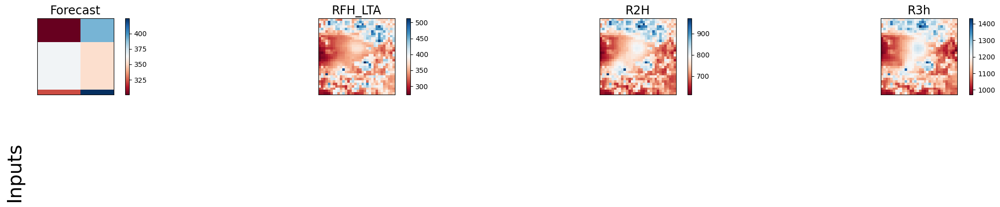

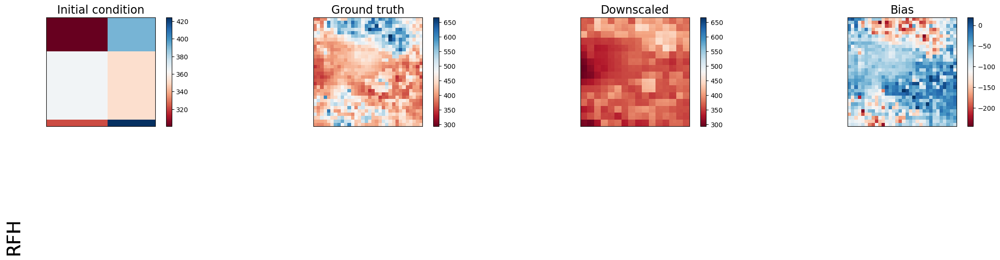

Selected device: cpu
+----------------------+----------------------+--------------------+------------------------+---------------------+
|                      | Coarse               | ClimaX             | Bilinear Interpolation | Weighted Mask       |
+----------------------+----------------------+--------------------+------------------------+---------------------+
| lat_weighted_mse_val | 4586.1767578125      | 8302.4736328125    | 14936.4755859375       | 12607.87109375      |
| lat_weighted_rmse    | 67.7213134765625     | 91.11791229248047  | 122.21487426757812     | 112.28477478027344  |
| spearman             | 0.11835826486253953  | 0.7068871589617158 | 0.006058462951550794   | 0.46908308327320825 |
| mean_bias            | 47.89971923828125    | -78.80685424804688 | -99.7276611328125      | -96.51080322265625  |
| pearson              | 0.019343130799933852 | 0.729951017188492  | -0.13995845746748706   | 0.45817700569708164 |
+----------------------+----------------------+----

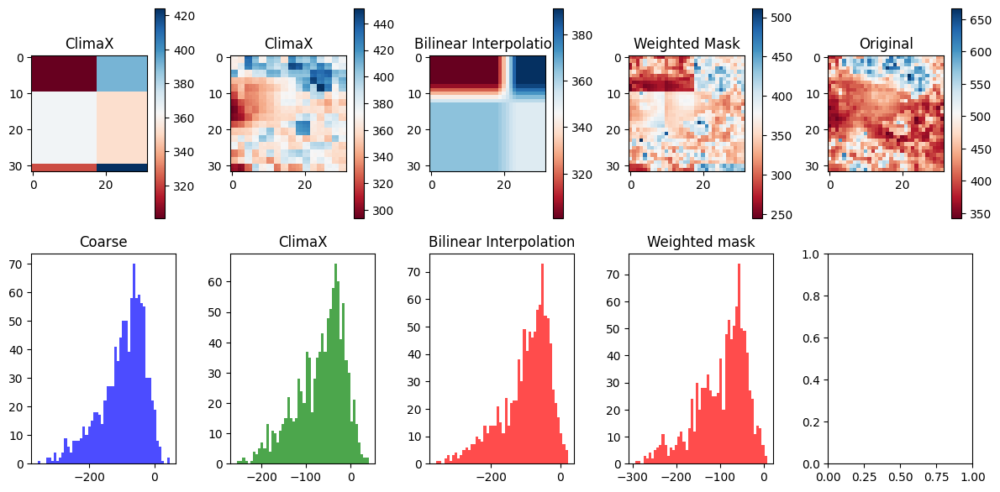

Time step 18
torch.Size([80, 1, 32, 32])


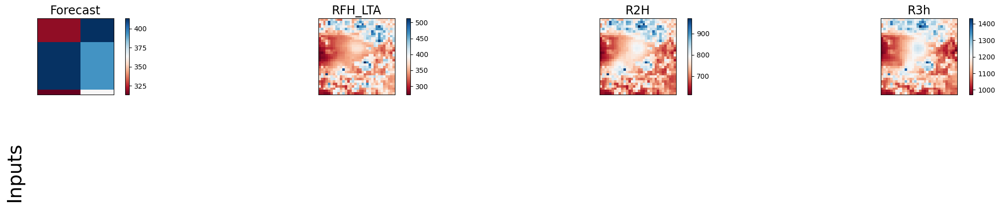

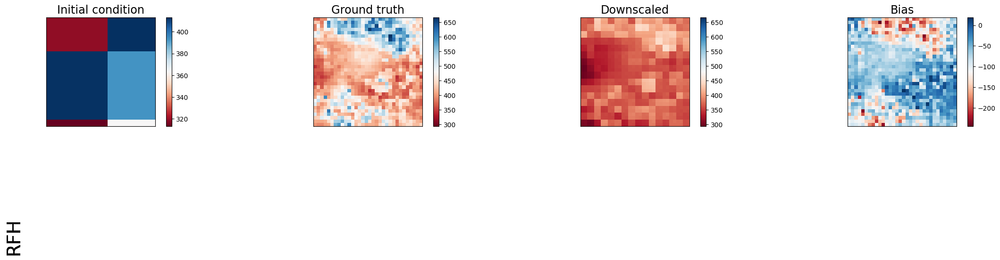

Selected device: cpu
+----------------------+---------------------+--------------------+------------------------+---------------------+
|                      | Coarse              | ClimaX             | Bilinear Interpolation | Weighted Mask       |
+----------------------+---------------------+--------------------+------------------------+---------------------+
| lat_weighted_mse_val | 2735.502197265625   | 8302.35546875      | 10176.96484375         | 8581.03515625       |
| lat_weighted_rmse    | 52.30202865600586   | 91.11726379394531  | 100.88094329833984     | 92.63388061523438   |
| spearman             | 0.22893869416239132 | 0.706889368229028  | -0.08246733867689993   | 0.3294902595454479  |
| mean_bias            | 15.5506591796875    | -78.80606079101562 | -62.71014404296875     | -64.16094970703125  |
| pearson              | 0.10962603296305781 | 0.7299484565722967 | -0.2805778358141471    | 0.31246513826026634 |
+----------------------+---------------------+-------------

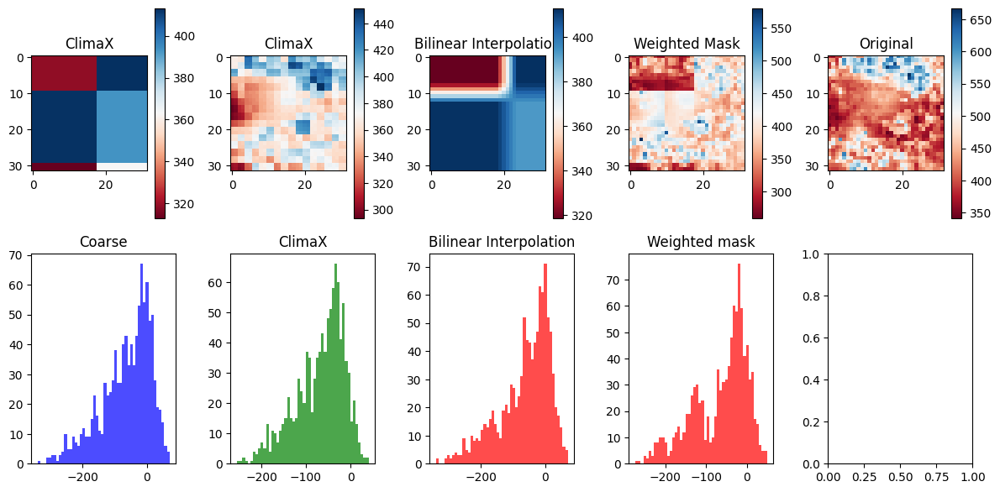

Time step 19
torch.Size([80, 1, 32, 32])


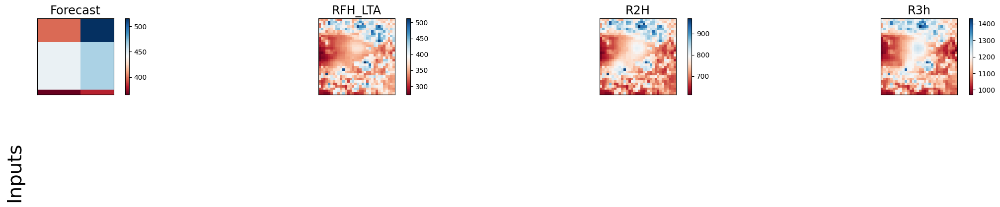

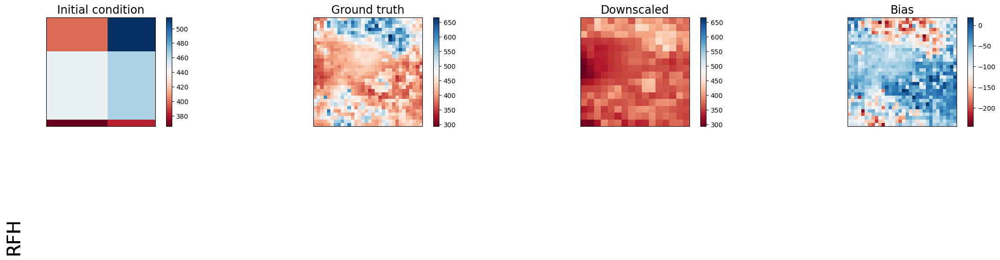

Selected device: cpu
+----------------------+---------------------+--------------------+------------------------+---------------------+
|                      | Coarse              | ClimaX             | Bilinear Interpolation | Weighted Mask       |
+----------------------+---------------------+--------------------+------------------------+---------------------+
| lat_weighted_mse_val | 4674.3251953125     | 8302.0927734375    | 4883.810546875         | 3359.903076171875   |
| lat_weighted_rmse    | 68.36903381347656   | 91.1158218383789   | 69.88426208496094      | 57.96467208862305   |
| spearman             | 0.06444783852219046 | 0.7068824194493747 | -0.1001350840719809    | 0.48196143133418246 |
| mean_bias            | -45.7125244140625   | -78.80462646484375 | -3.43212890625         | -2.810882568359375  |
| pearson              | 0.11745888128776617 | 0.7299508509520205 | -0.016050423154427257  | 0.5290954174546569  |
+----------------------+---------------------+-------------

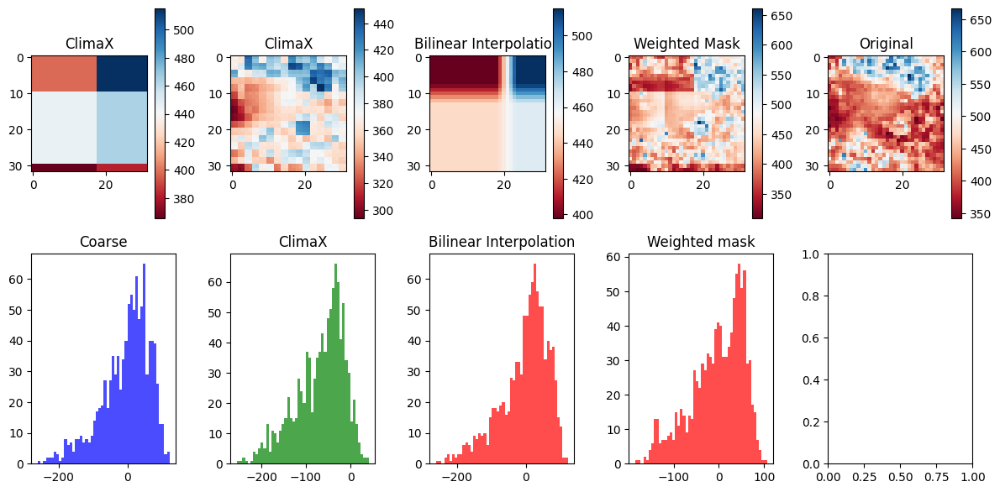

Time step 20
torch.Size([80, 1, 32, 32])


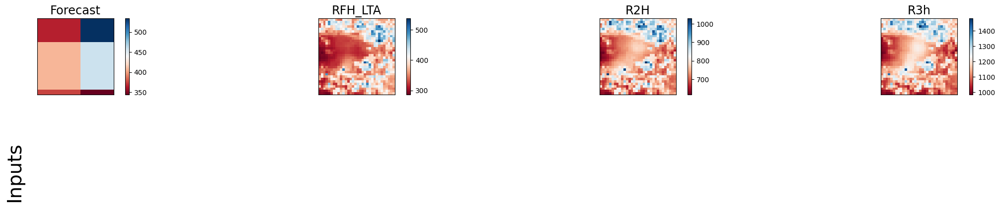

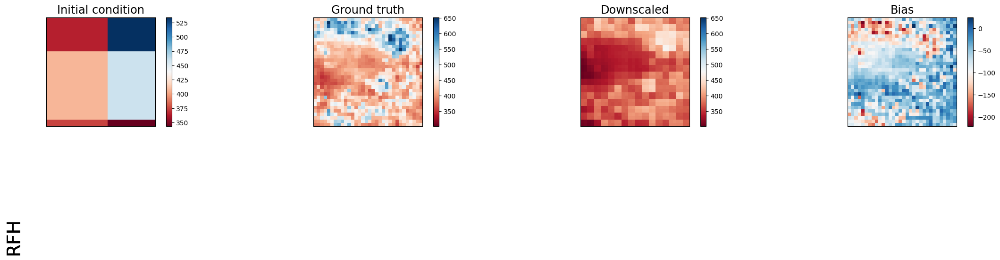

Selected device: cpu
+----------------------+---------------------+--------------------+------------------------+---------------------+
|                      | Coarse              | ClimaX             | Bilinear Interpolation | Weighted Mask       |
+----------------------+---------------------+--------------------+------------------------+---------------------+
| lat_weighted_mse_val | 4802.18798828125    | 6695.32861328125   | 5664.486328125         | 4203.2685546875     |
| lat_weighted_rmse    | 69.29782104492188   | 81.82498931884766  | 75.26277923583984      | 64.8326187133789    |
| spearman             | 0.06474792264097697 | 0.6985936768841131 | -0.05861853224598714   | 0.44205569406940676 |
| mean_bias            | -26.952667236328125 | -71.39920043945312 | -23.83270263671875     | -18.5325927734375   |
| pearson              | 0.0769962643172949  | 0.7175185476896473 | 0.043201332910367464   | 0.5267687681505049  |
+----------------------+---------------------+-------------

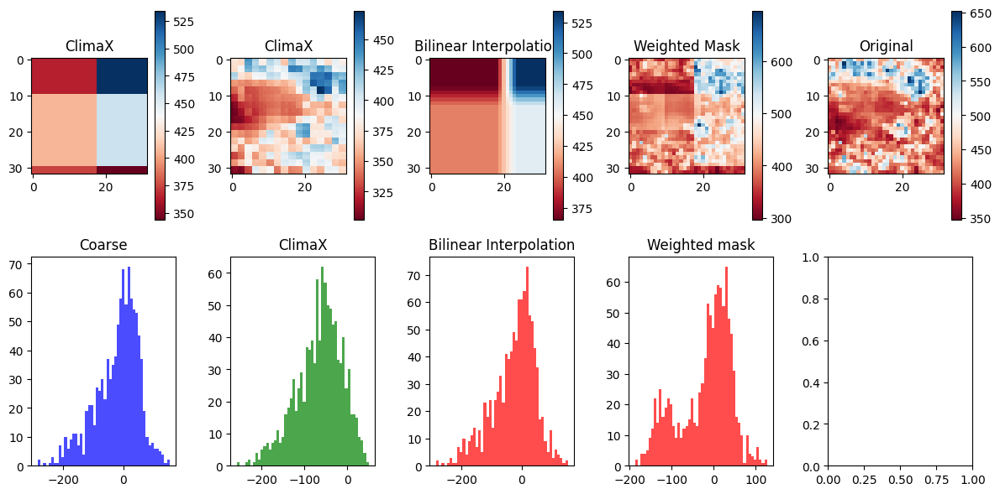

Time step 21
torch.Size([80, 1, 32, 32])


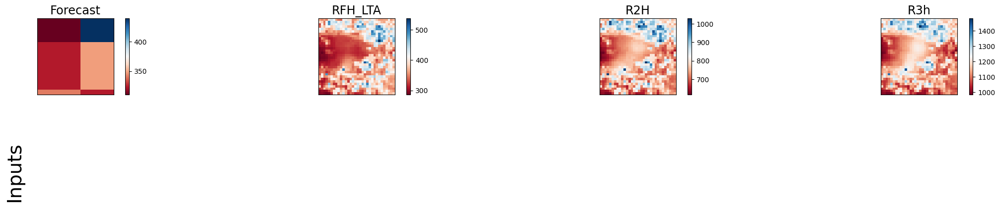

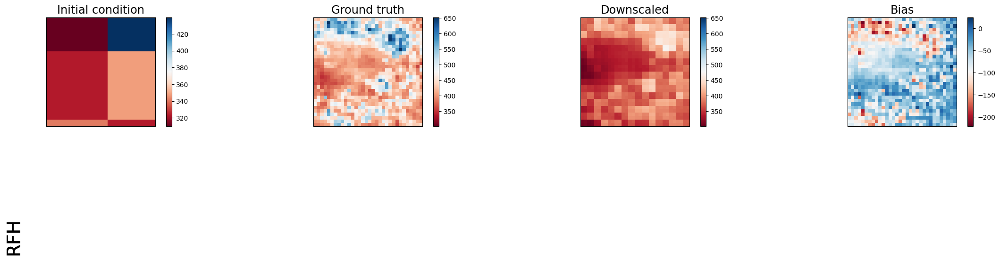

Selected device: cpu
+----------------------+-----------------------+--------------------+------------------------+--------------------+
|                      | Coarse                | ClimaX             | Bilinear Interpolation | Weighted Mask      |
+----------------------+-----------------------+--------------------+------------------------+--------------------+
| lat_weighted_mse_val | 6059.0869140625       | 6695.626953125     | 15377.177734375        | 12678.0166015625   |
| lat_weighted_rmse    | 77.84013366699219     | 81.82681274414062  | 124.00474548339844     | 112.5967025756836  |
| spearman             | -0.030878581573598983 | 0.6986092062368376 | -0.021923808441441137  | 0.5947980032920035 |
| mean_bias            | 57.25469970703125     | -71.40130615234375 | -108.51666259765625    | -102.8359375       |
| pearson              | 0.08873326418166026   | 0.717521342088248  | 0.20008326469473497    | 0.649372169818602  |
+----------------------+-----------------------+---

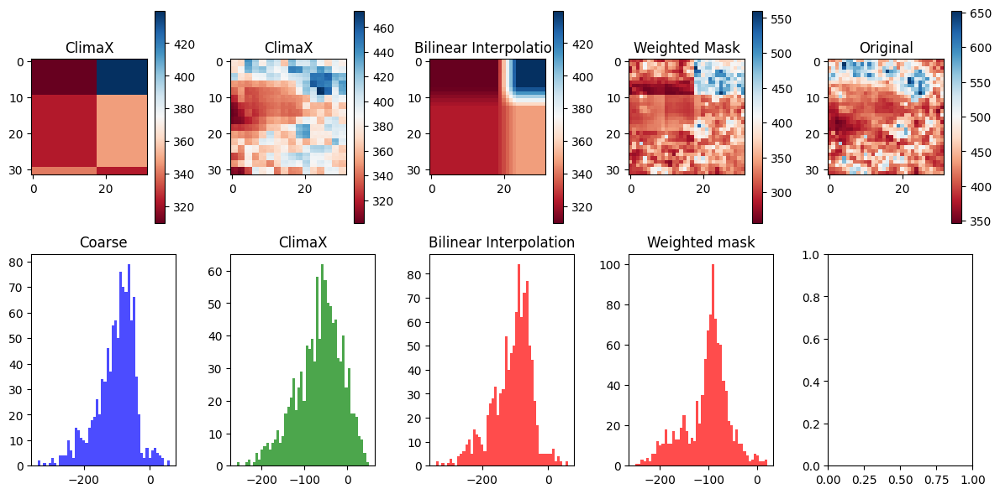

Time step 22
torch.Size([80, 1, 32, 32])


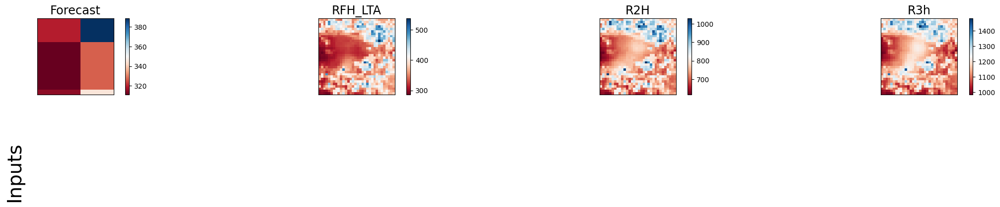

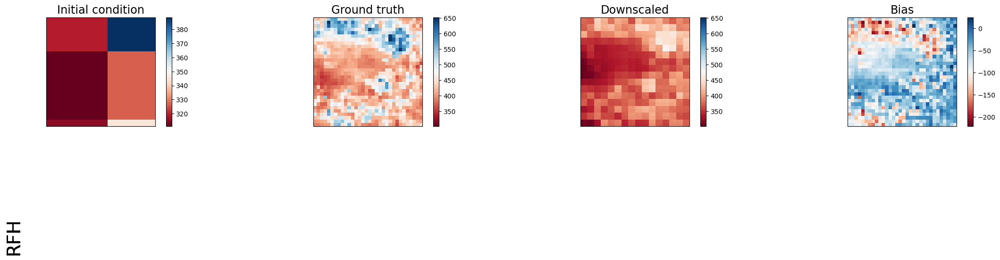

Selected device: cpu
+----------------------+----------------------+--------------------+------------------------+---------------------+
|                      | Coarse               | ClimaX             | Bilinear Interpolation | Weighted Mask       |
+----------------------+----------------------+--------------------+------------------------+---------------------+
| lat_weighted_mse_val | 7308.33984375        | 6695.6845703125    | 17802.603515625        | 15385.4990234375    |
| lat_weighted_rmse    | 85.48883056640625    | 81.82716369628906  | 133.4263916015625      | 124.03829956054688  |
| spearman             | -0.10708918156342029 | 0.6986151463958683 | 0.3650622774185232     | 0.7293947431939835  |
| mean_bias            | 73.129150390625      | -71.40179443359375 | -122.3782958984375     | -118.80010986328125 |
| pearson              | 0.05464966599295239  | 0.7175243636818839 | 0.33970667160605       | 0.777950692160234   |
+----------------------+----------------------+----

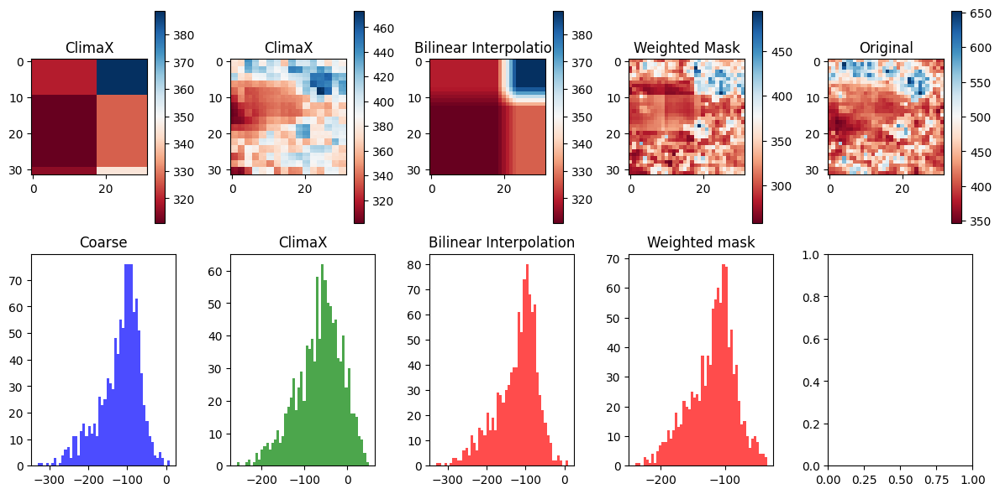

Time step 23
torch.Size([80, 1, 32, 32])


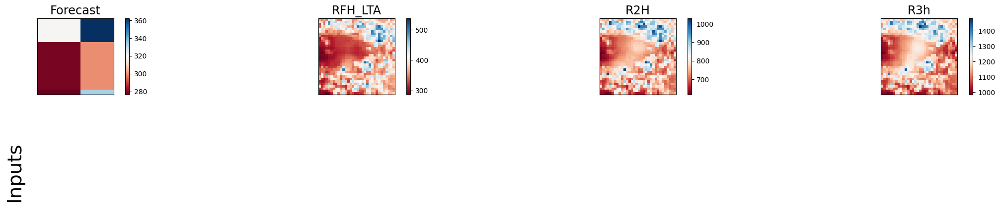

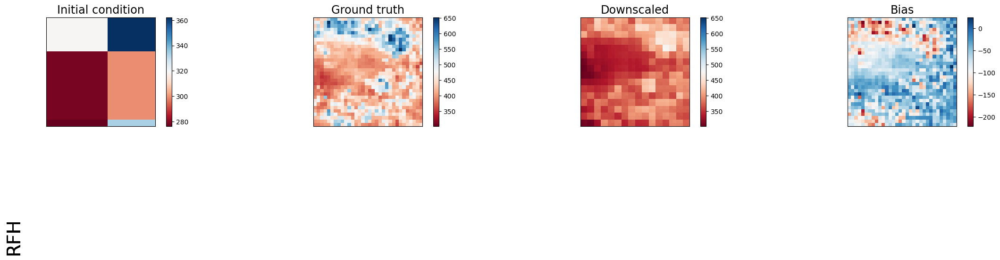

Selected device: cpu
+----------------------+----------------------+--------------------+------------------------+--------------------+
|                      | Coarse               | ClimaX             | Bilinear Interpolation | Weighted Mask      |
+----------------------+----------------------+--------------------+------------------------+--------------------+
| lat_weighted_mse_val | 11664.3525390625     | 6695.78125         | 23727.0078125          | 21451.359375       |
| lat_weighted_rmse    | 108.00163269042969   | 81.82775115966797  | 154.03573608398438     | 146.46282958984375 |
| spearman             | -0.0330805210144649  | 0.6986151463958683 | 0.5039708386336715     | 0.8197251804355695 |
| mean_bias            | 97.43862915039062    | -71.40252685546875 | -145.97711181640625    | -143.1329345703125 |
| pearson              | 0.023342199359431944 | 0.7175269242327917 | 0.4950136503244046     | 0.844893215849814  |
+----------------------+----------------------+------------

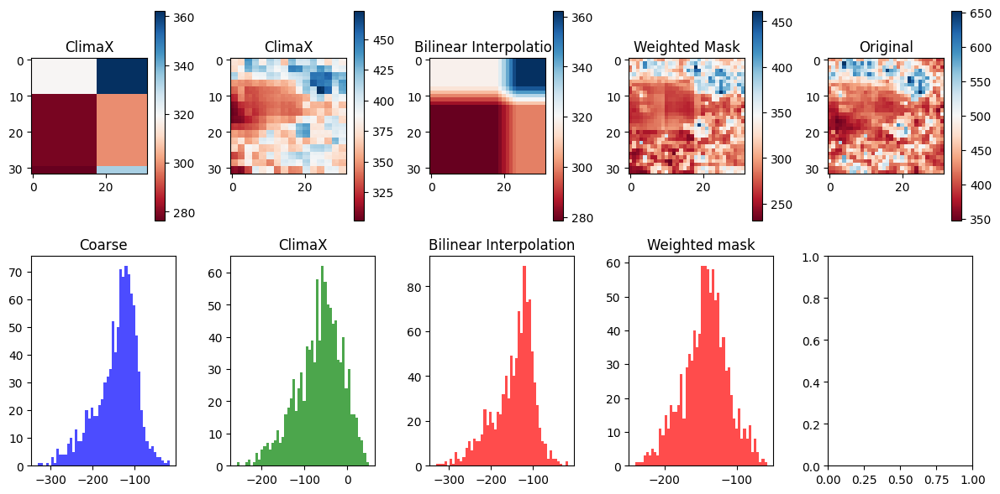

Time step 24
torch.Size([80, 1, 32, 32])


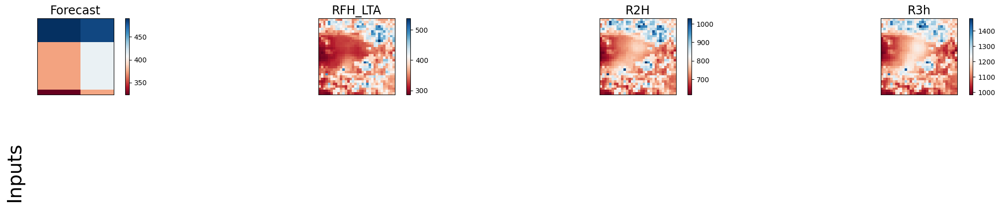

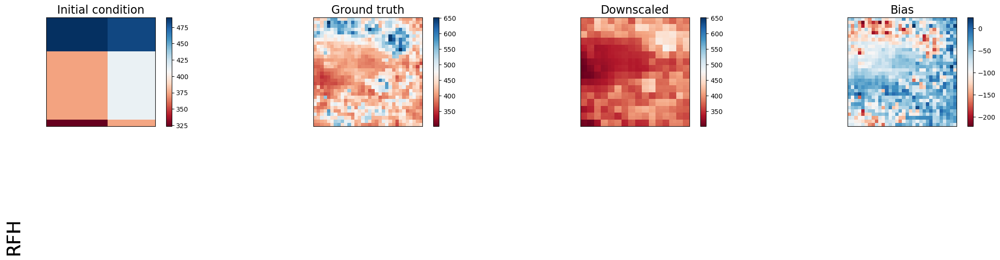

Selected device: cpu
+----------------------+-----------------------+--------------------+------------------------+---------------------+
|                      | Coarse                | ClimaX             | Bilinear Interpolation | Weighted Mask       |
+----------------------+-----------------------+--------------------+------------------------+---------------------+
| lat_weighted_mse_val | 4040.60546875         | 6695.294921875     | 3280.219970703125      | 2061.43017578125    |
| lat_weighted_rmse    | 63.565757751464844    | 81.82478332519531  | 57.2732048034668       | 45.402976989746094  |
| spearman             | -0.018103648183617285 | 0.6986141740650391 | 0.5101511277547955     | 0.8116922410362549  |
| mean_bias            | -16.170074462890625   | -71.39935302734375 | -27.2591552734375      | -29.547088623046875 |
| pearson              | 0.055171458573223794  | 0.7175325256144152 | 0.5367246115752919     | 0.8460003306758053  |
+----------------------+-------------------

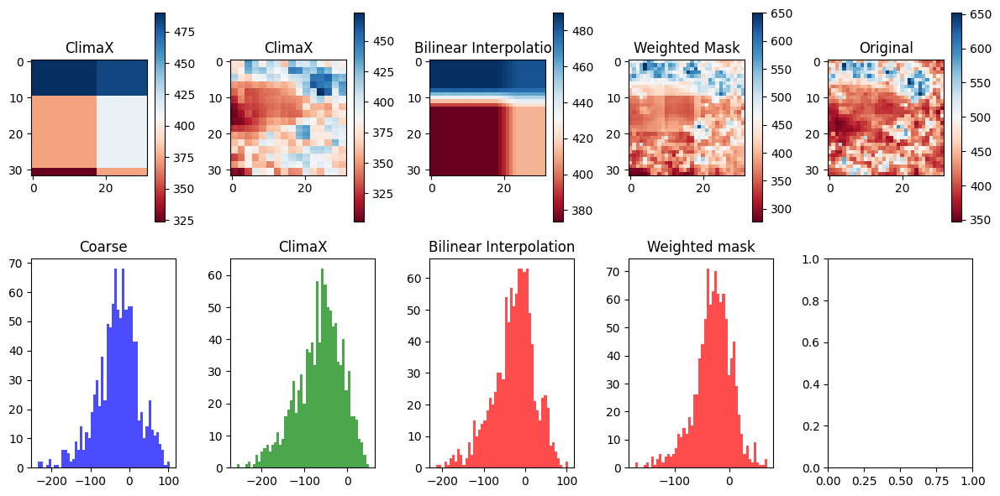

Time step 25
torch.Size([80, 1, 32, 32])


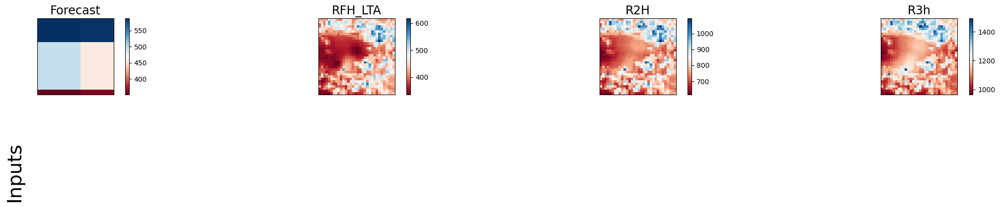

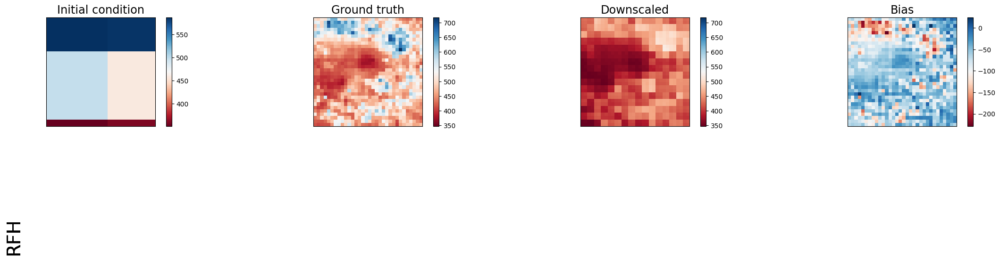

Selected device: cpu
+----------------------+---------------------+--------------------+------------------------+--------------------+
|                      | Coarse              | ClimaX             | Bilinear Interpolation | Weighted Mask      |
+----------------------+---------------------+--------------------+------------------------+--------------------+
| lat_weighted_mse_val | 15251.2529296875    | 6216.80078125      | 4890.919921875         | 3539.314453125     |
| lat_weighted_rmse    | 123.49596405029297  | 78.84669494628906  | 69.93511199951172      | 59.49213790893555  |
| spearman             | 0.22475709981309389 | 0.8334610096940082 | 0.2731564780223144     | 0.6317183384753907 |
| mean_bias            | -103.78970336914062 | -69.220703125      | 33.30242919921875      | 20.34405517578125  |
| pearson              | 0.21958114888607436 | 0.8143818914959386 | 0.3938127626815333     | 0.7082994824432512 |
+----------------------+---------------------+--------------------+

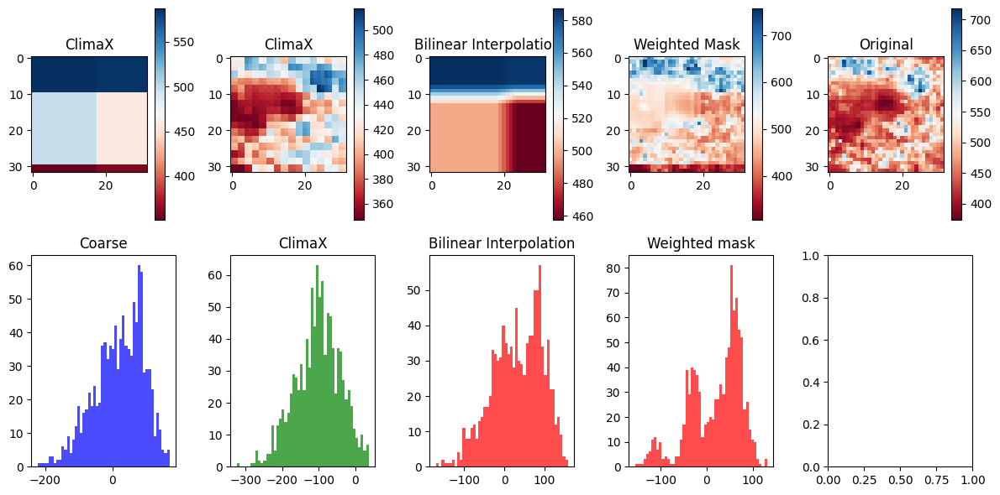

Time step 26
torch.Size([80, 1, 32, 32])


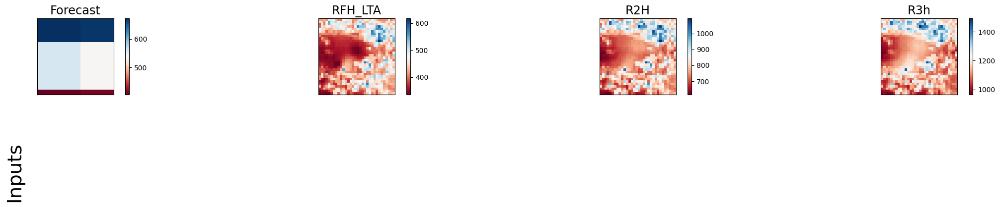

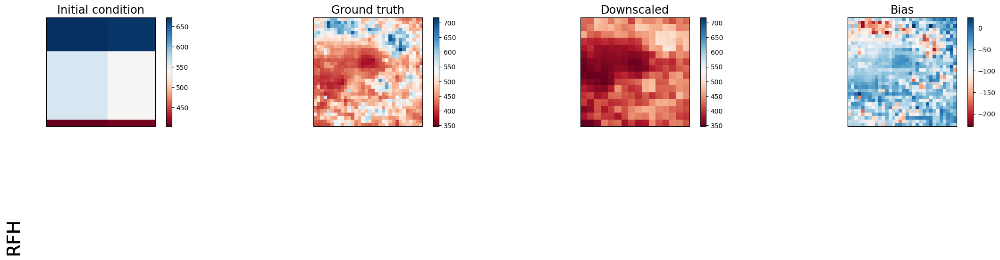

Selected device: cpu
+----------------------+---------------------+--------------------+------------------------+--------------------+
|                      | Coarse              | ClimaX             | Bilinear Interpolation | Weighted Mask      |
+----------------------+---------------------+--------------------+------------------------+--------------------+
| lat_weighted_mse_val | 36837.44921875      | 6216.61767578125   | 15196.673828125        | 12308.59375        |
| lat_weighted_rmse    | 191.93084716796875  | 78.84552764892578  | 123.27478790283203     | 110.94409942626953 |
| spearman             | 0.22475709981309389 | 0.833459495327921  | 0.2760910655566672     | 0.6894243273283351 |
| mean_bias            | -177.06854248046875 | -69.21942138671875 | 106.94940185546875     | 93.65216064453125  |
| pearson              | 0.19990074058947715 | 0.8143811379124021 | 0.4437004446661563     | 0.7449088904546538 |
+----------------------+---------------------+--------------------+

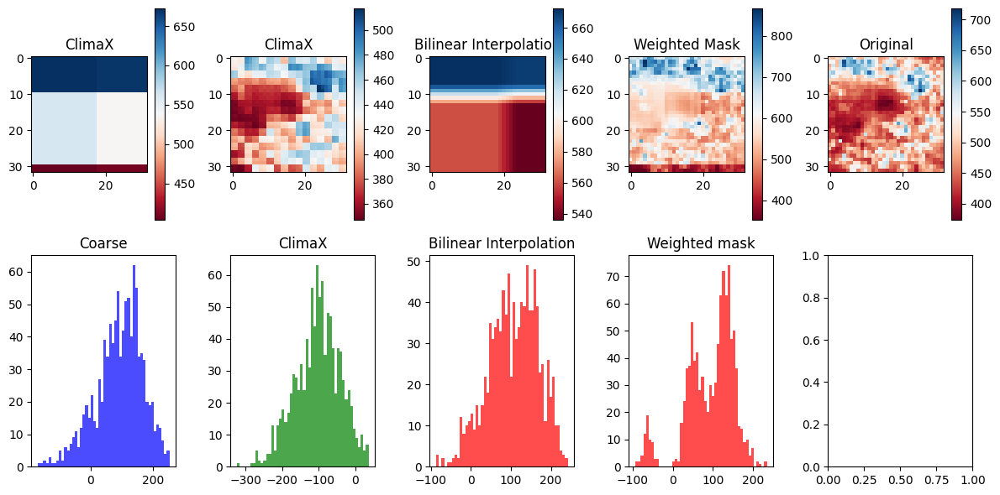

Time step 27
torch.Size([80, 1, 32, 32])


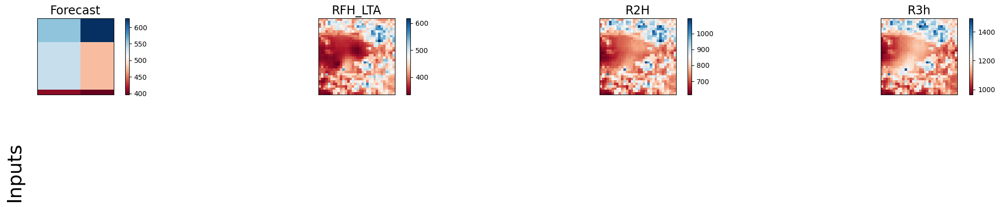

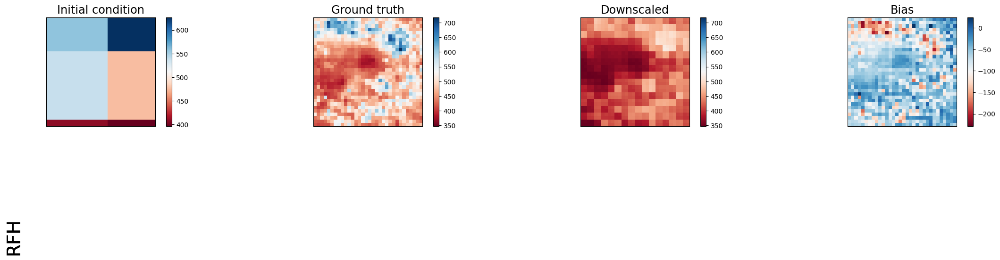

Selected device: cpu
+----------------------+---------------------+--------------------+------------------------+--------------------+
|                      | Coarse              | ClimaX             | Bilinear Interpolation | Weighted Mask      |
+----------------------+---------------------+--------------------+------------------------+--------------------+
| lat_weighted_mse_val | 19495.494140625     | 6216.771484375     | 7049.91650390625       | 5244.15869140625   |
| lat_weighted_rmse    | 139.6262664794922   | 78.84650421142578  | 83.96378326416016      | 72.41656494140625  |
| spearman             | 0.26548614619199423 | 0.833456298953744  | 0.25850392907014413    | 0.5485476795697336 |
| mean_bias            | -126.59710693359375 | -69.22039794921875 | 53.4808349609375       | 43.1861572265625   |
| pearson              | 0.2791142373141451  | 0.8143793051568554 | 0.24206571536629135    | 0.6493647997856897 |
+----------------------+---------------------+--------------------+

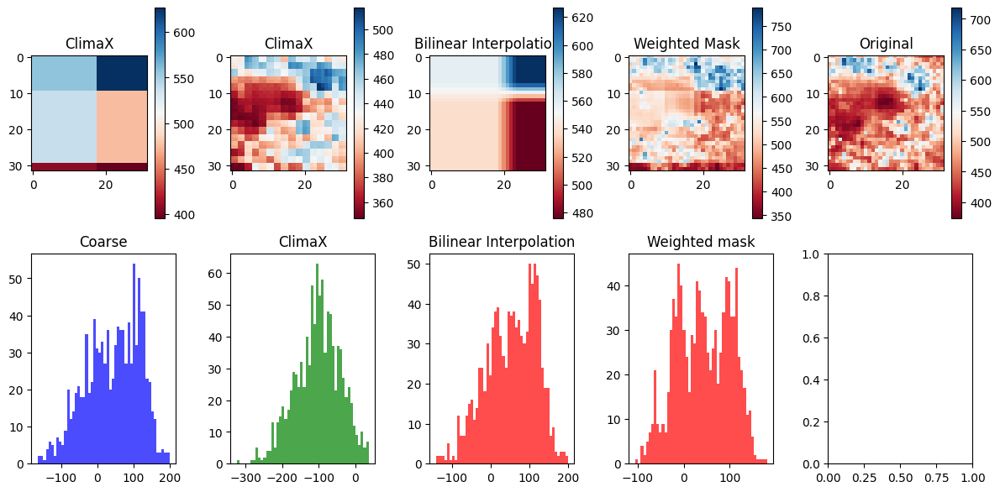

Time step 28
torch.Size([80, 1, 32, 32])


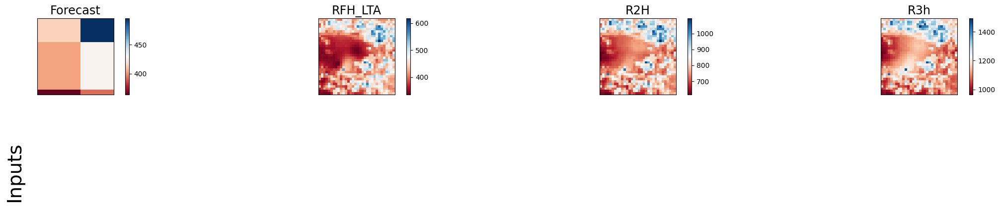

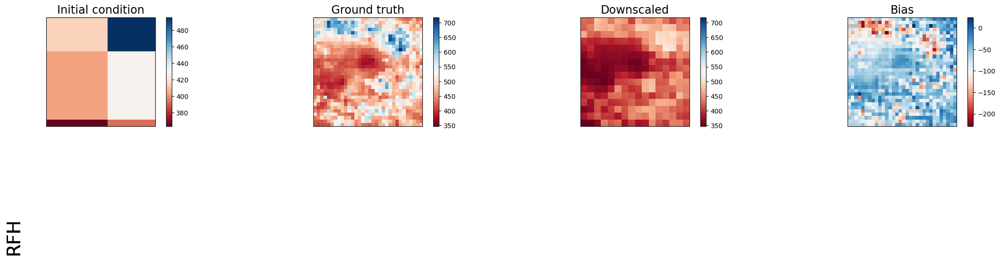

Selected device: cpu
+----------------------+---------------------+--------------------+------------------------+--------------------+
|                      | Coarse              | ClimaX             | Bilinear Interpolation | Weighted Mask      |
+----------------------+---------------------+--------------------+------------------------+--------------------+
| lat_weighted_mse_val | 2661.707275390625   | 6217.11572265625   | 7358.30908203125       | 5293.45361328125   |
| lat_weighted_rmse    | 51.59173583984375   | 78.84868621826172  | 85.78058624267578      | 72.7561264038086   |
| spearman             | 0.01647614487735255 | 0.8334517726196822 | 0.4806843793165573     | 0.7744154107928107 |
| mean_bias            | -21.1395263671875   | -69.22274780273438 | -63.67181396484375     | -62.099609375      |
| pearson              | 0.10093176479184235 | 0.814375743489314  | 0.38143936928497213    | 0.7929137739750096 |
+----------------------+---------------------+--------------------+

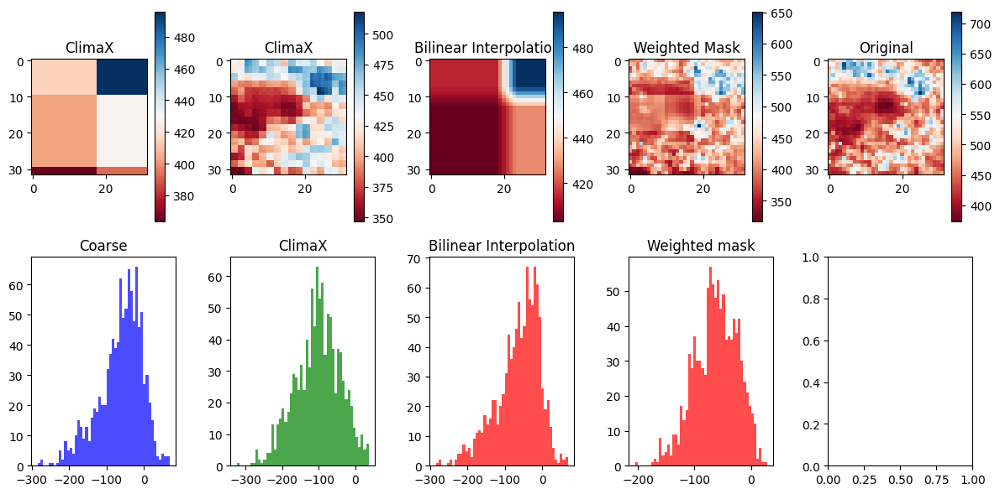

Time step 29
torch.Size([80, 1, 32, 32])


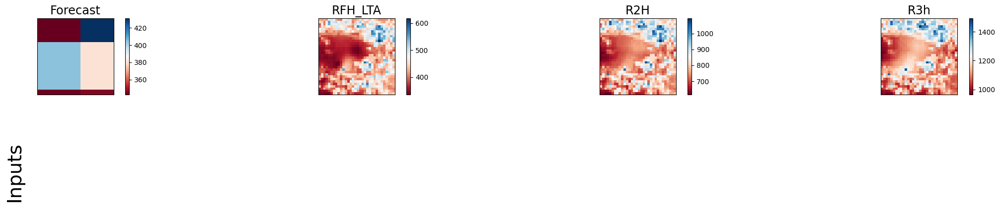

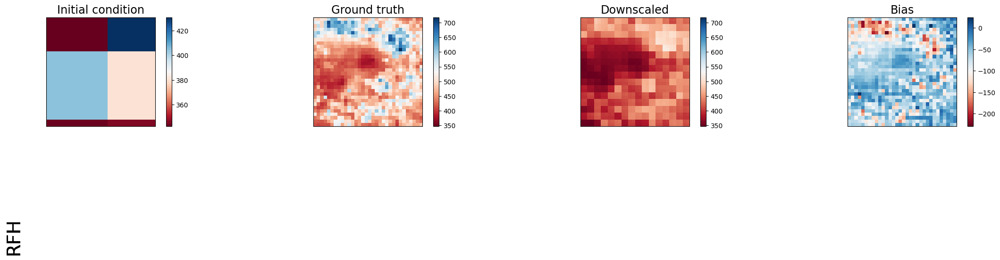

Selected device: cpu
+----------------------+---------------------+--------------------+------------------------+---------------------+
|                      | Coarse              | ClimaX             | Bilinear Interpolation | Weighted Mask       |
+----------------------+---------------------+--------------------+------------------------+---------------------+
| lat_weighted_mse_val | 2055.289306640625   | 6217.30029296875   | 14586.84765625         | 12918.2841796875    |
| lat_weighted_rmse    | 45.33530044555664   | 78.84986114501953  | 120.7760238647461      | 113.65863037109375  |
| spearman             | 0.2251075575978423  | 0.833454862820591  | -0.236258285478957     | 0.38600442555063535 |
| mean_bias            | 14.68817138671875   | -69.22390747070312 | -96.58615112304688     | -98.00967407226562  |
| pearson              | 0.20054884560943134 | 0.8143735746220393 | -0.2452663812681748    | 0.46295344678802847 |
+----------------------+---------------------+-------------

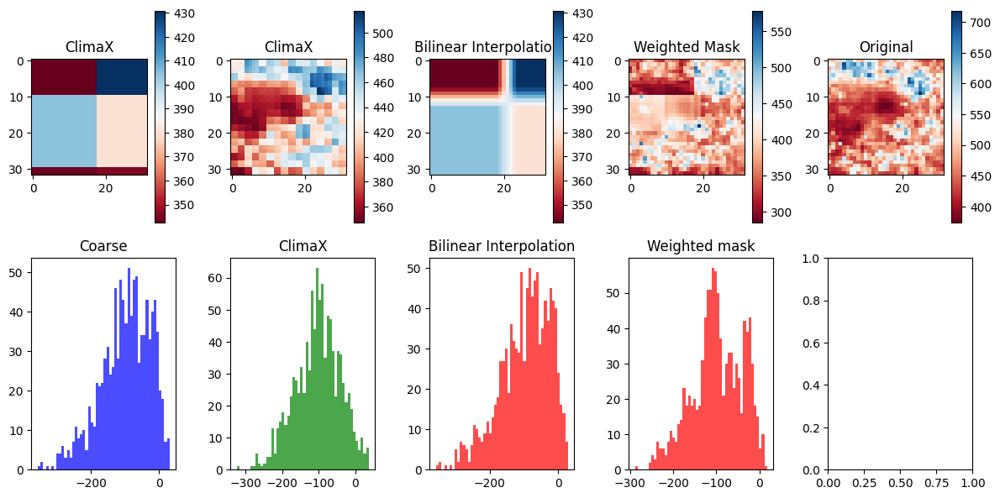

Time step 30
torch.Size([80, 1, 32, 32])


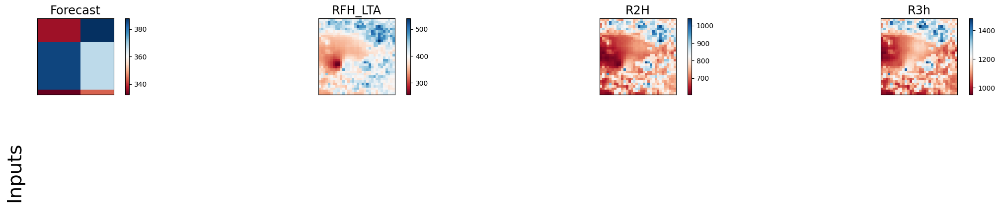

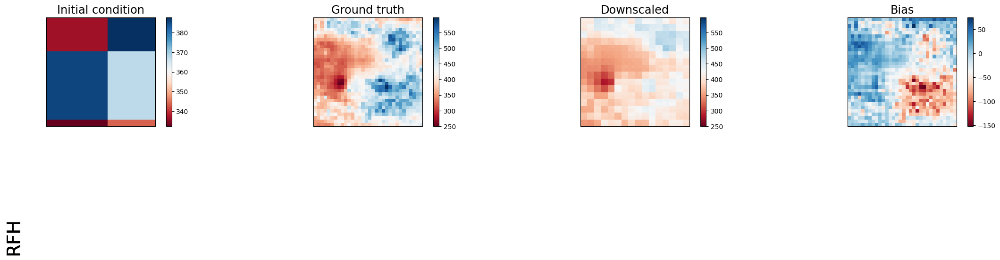

Selected device: cpu
+----------------------+---------------------+---------------------+------------------------+--------------------+
|                      | Coarse              | ClimaX              | Bilinear Interpolation | Weighted Mask      |
+----------------------+---------------------+---------------------+------------------------+--------------------+
| lat_weighted_mse_val | 2615.0751953125     | 1982.88427734375    | 6607.2958984375        | 5811.849609375     |
| lat_weighted_rmse    | 51.1378059387207    | 44.52959060668945   | 81.2852783203125       | 76.23548889160156  |
| spearman             | 0.22893869416239132 | 0.8034132005000331  | -0.13036161410922897   | 0.3303357878052088 |
| mean_bias            | 32.35833740234375   | -21.844207763671875 | -48.46923828125        | -50.068359375      |
| pearson              | 0.17387526831354116 | 0.8109298377501182  | -0.049387866921149534  | 0.3972229468855484 |
+----------------------+---------------------+-------------

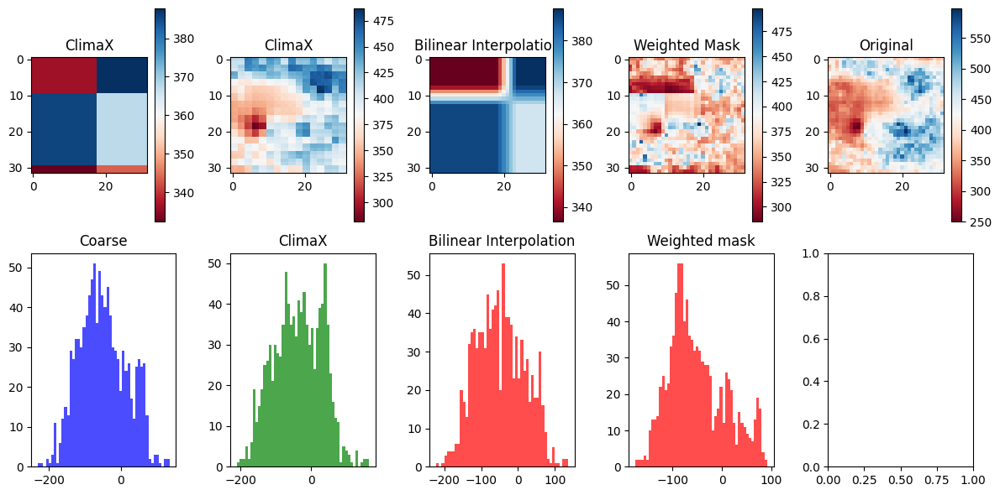

Time step 31
torch.Size([80, 1, 32, 32])


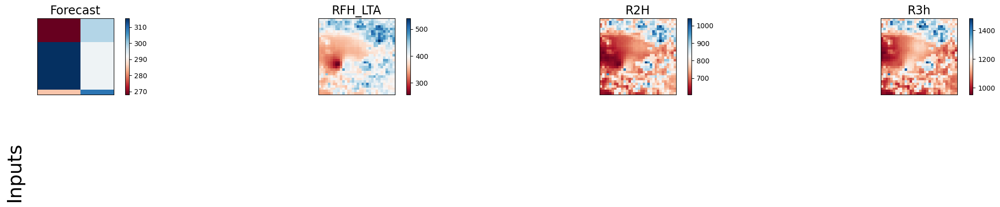

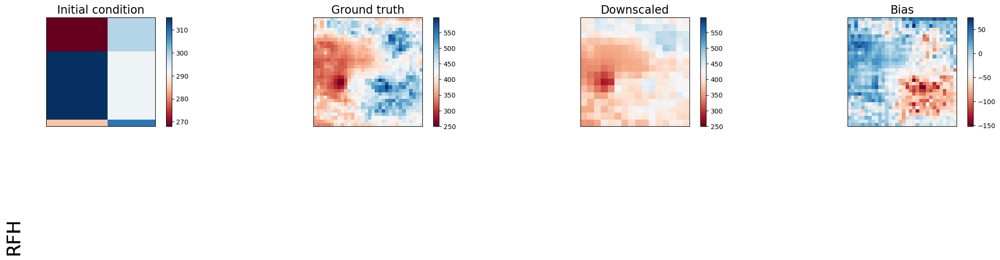

Selected device: cpu
+----------------------+--------------------+---------------------+------------------------+---------------------+
|                      | Coarse             | ClimaX              | Bilinear Interpolation | Weighted Mask       |
+----------------------+--------------------+---------------------+------------------------+---------------------+
| lat_weighted_mse_val | 12458.7080078125   | 1983.0103759765625  | 19199.31640625         | 18502.888671875     |
| lat_weighted_rmse    | 111.61858367919922 | 44.531005859375     | 138.5615997314453      | 136.02532958984375  |
| spearman             | 0.137207946807023  | 0.8034134631376436  | -0.25865945962736975   | 0.20987659004751555 |
| mean_bias            | 104.20010375976562 | -21.846771240234375 | -121.28659057617188    | -121.933837890625   |
| pearson              | 0.089424089073184  | 0.81093105133591    | -0.18059301503260372   | 0.27732501344703797 |
+----------------------+--------------------+--------------

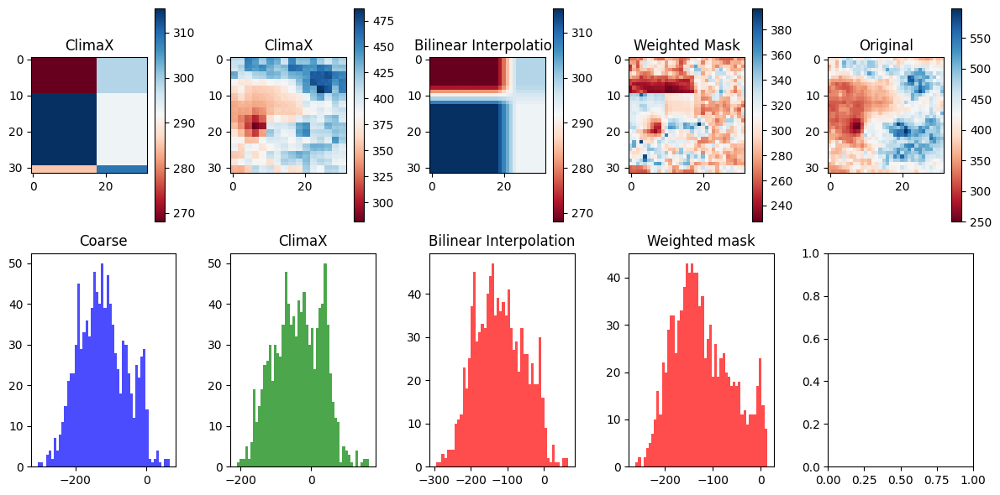

Time step 32
torch.Size([80, 1, 32, 32])


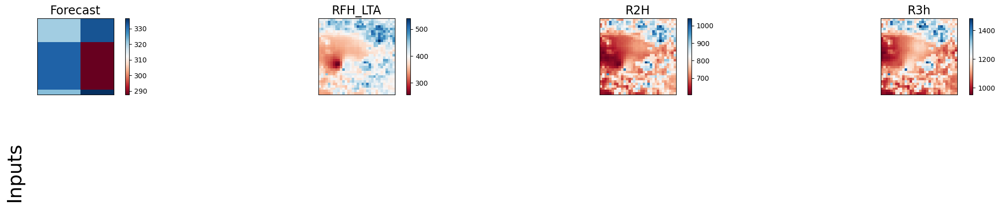

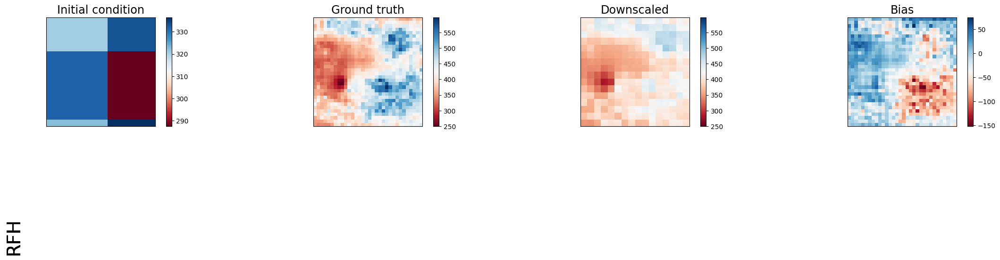

Selected device: cpu
+----------------------+---------------------+---------------------+------------------------+---------------------+
|                      | Coarse              | ClimaX              | Bilinear Interpolation | Weighted Mask       |
+----------------------+---------------------+---------------------+------------------------+---------------------+
| lat_weighted_mse_val | 8540.9716796875     | 1983.0009765625     | 14876.70703125         | 14603.9052734375    |
| lat_weighted_rmse    | 92.4173812866211    | 44.53089904785156   | 121.97010803222656     | 120.84661865234375  |
| spearman             | 0.18050117752453104 | 0.8034014656280724  | -0.38743591442606934   | 0.07237306003204823 |
| mean_bias            | 83.87374877929688   | -21.845916748046875 | -99.67880249023438     | -101.6519775390625  |
| pearson              | 0.20175055890003973 | 0.8109228719994324  | -0.42841657357890184   | 0.11745373808844528 |
+----------------------+---------------------+-----

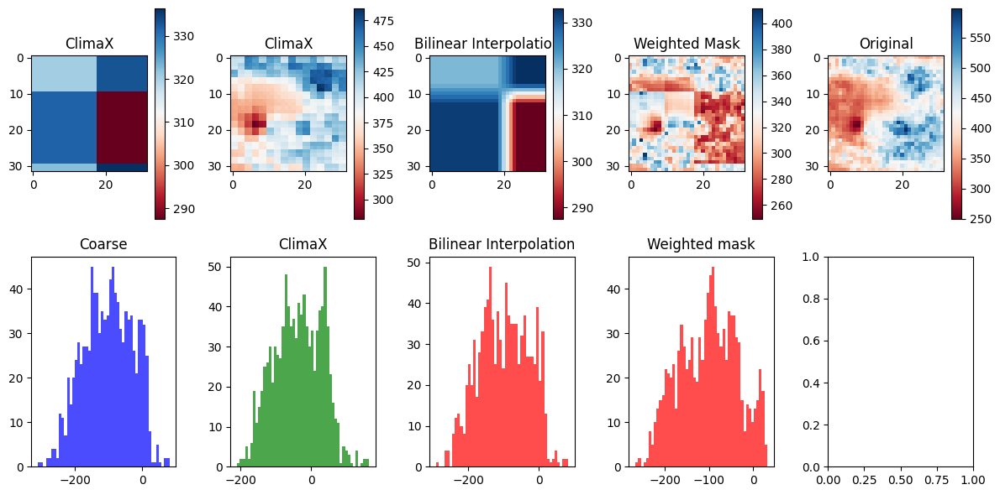

Time step 33
torch.Size([80, 1, 32, 32])


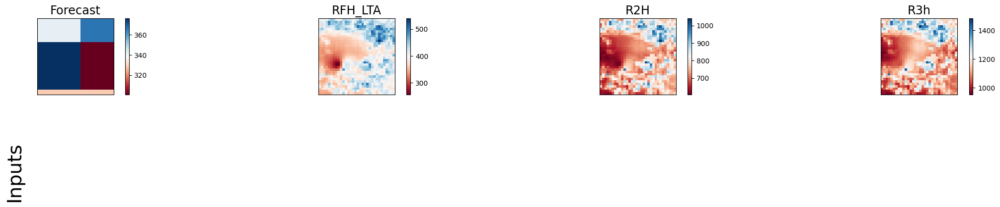

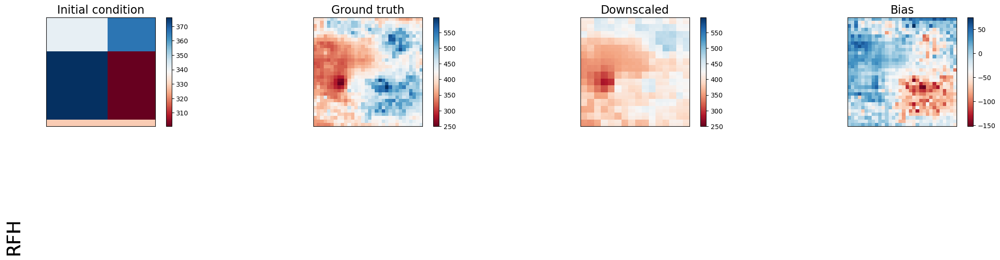

Selected device: cpu
+----------------------+--------------------+--------------------+------------------------+-----------------------+
|                      | Coarse             | ClimaX             | Bilinear Interpolation | Weighted Mask         |
+----------------------+--------------------+--------------------+------------------------+-----------------------+
| lat_weighted_mse_val | 4970.0322265625    | 1982.968505859375  | 10758.2998046875       | 11118.6689453125      |
| lat_weighted_rmse    | 70.49845886230469  | 44.53053283691406  | 103.72222137451172     | 105.44509887695312    |
| spearman             | 0.252984505375451  | 0.8033990963015432 | -0.45986761233723084   | -0.08173323575490811  |
| mean_bias            | 56.4564208984375   | -21.84503173828125 | -68.68484497070312     | -74.26986694335938    |
| pearson              | 0.2598273914356822 | 0.8109209894106397 | -0.44612025994648746   | -0.048778016883887554 |
+----------------------+--------------------+------

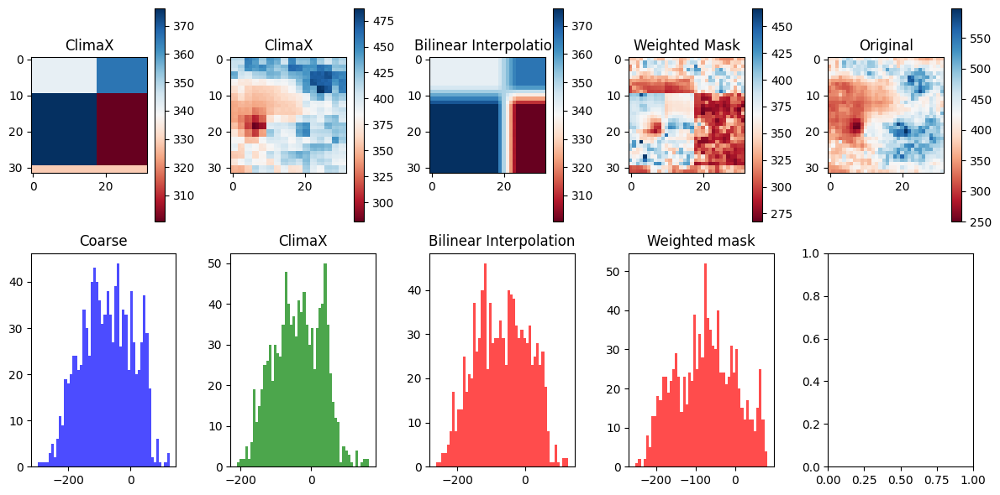

Time step 34
torch.Size([80, 1, 32, 32])


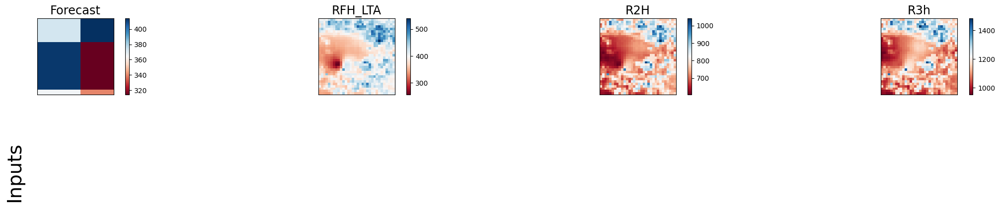

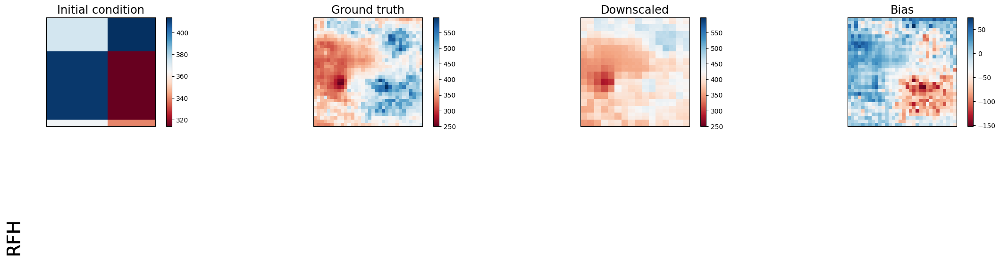

Selected device: cpu
+----------------------+---------------------+--------------------+------------------------+----------------------+
|                      | Coarse              | ClimaX             | Bilinear Interpolation | Weighted Mask        |
+----------------------+---------------------+--------------------+------------------------+----------------------+
| lat_weighted_mse_val | 3014.378173828125   | 1982.9346923828125 | 8321.642578125         | 8800.478515625       |
| lat_weighted_rmse    | 54.90335464477539   | 44.530155181884766 | 91.22303771972656      | 93.81086730957031    |
| spearman             | 0.290909881581737   | 0.8033921783151206 | -0.37765557610971656   | -0.10771856291546884 |
| mean_bias            | 26.477508544921875  | -21.84405517578125 | -37.37347412109375     | -44.30853271484375   |
| pearson              | 0.27487680907049883 | 0.810917768681954  | -0.416009821549403     | -0.09342741644567036 |
+----------------------+---------------------+-----

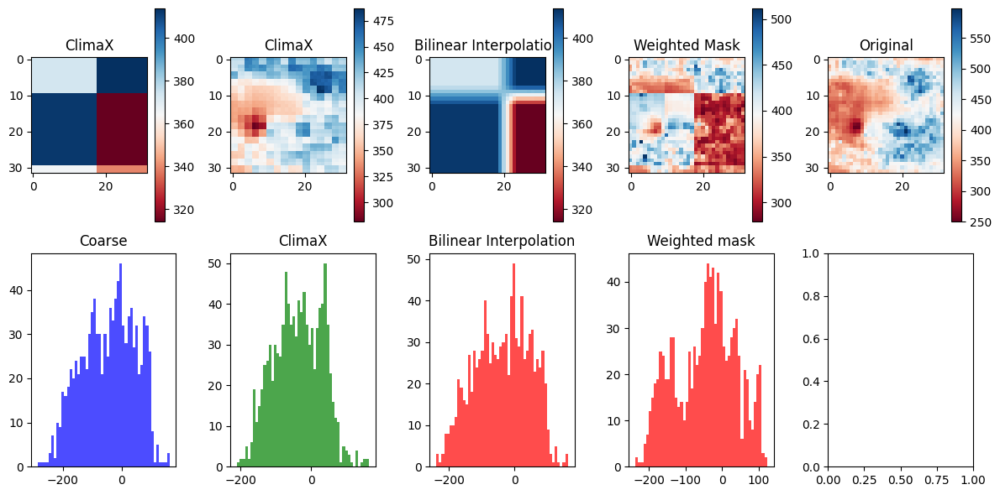

Time step 35
torch.Size([80, 1, 32, 32])


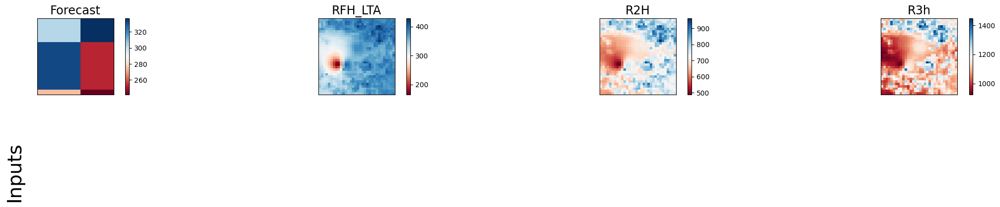

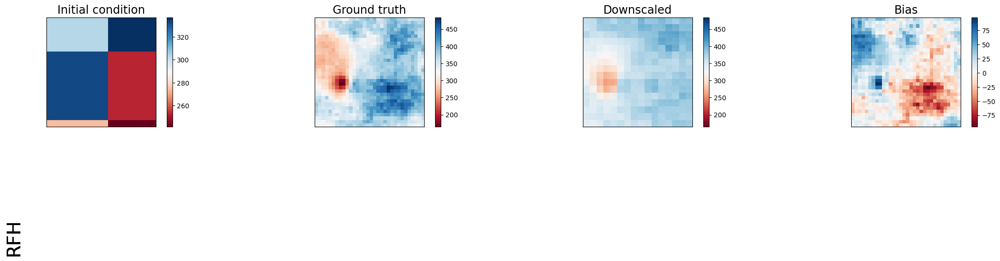

Selected device: cpu
+----------------------+---------------------+--------------------+------------------------+----------------------+
|                      | Coarse              | ClimaX             | Bilinear Interpolation | Weighted Mask        |
+----------------------+---------------------+--------------------+------------------------+----------------------+
| lat_weighted_mse_val | 11924.4404296875    | 968.0286865234375  | 6988.6416015625        | 8317.6455078125      |
| lat_weighted_rmse    | 109.19908905029297  | 31.1131591796875   | 83.59809875488281      | 91.20112609863281    |
| spearman             | 0.3188487038079339  | 0.746149380541474  | -0.22614422144370117   | -0.20277881773347903 |
| mean_bias            | 100.154296875       | 2.708099365234375  | -52.55853271484375     | -59.72528076171875   |
| pearson              | 0.30042055434891035 | 0.8187671529994323 | -0.3302612559502113    | -0.16600538719091523 |
+----------------------+---------------------+-----

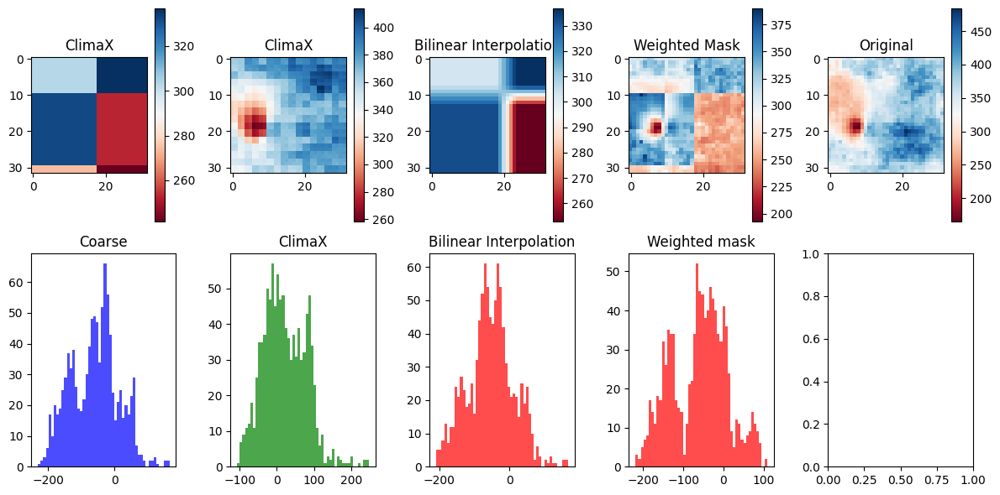

Time step 36
torch.Size([80, 1, 32, 32])


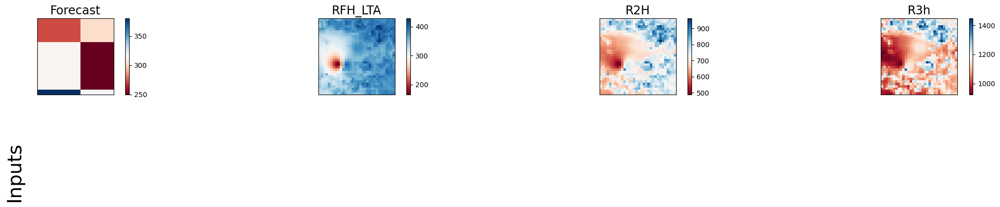

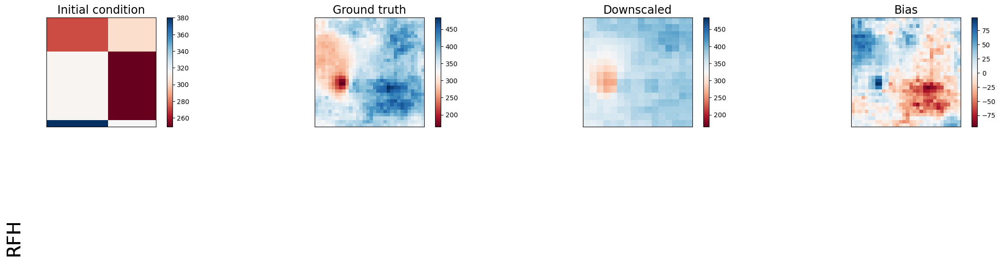

Selected device: cpu
+----------------------+---------------------+--------------------+------------------------+----------------------+
|                      | Coarse              | ClimaX             | Bilinear Interpolation | Weighted Mask        |
+----------------------+---------------------+--------------------+------------------------+----------------------+
| lat_weighted_mse_val | 14657.4794921875    | 968.0202026367188  | 8912.955078125         | 9288.4560546875      |
| lat_weighted_rmse    | 121.06807708740234  | 31.11302375793457  | 94.408447265625        | 96.37663269042969    |
| spearman             | 0.12119211421533857 | 0.7461464174148222 | -0.29601902746357506   | -0.20346375464894892 |
| mean_bias            | 111.9520263671875   | 2.707733154296875  | -72.20220947265625     | -71.50607299804688   |
| pearson              | 0.13837462780811755 | 0.8187713514833921 | -0.29278395572786675   | -0.10144726528678549 |
+----------------------+---------------------+-----

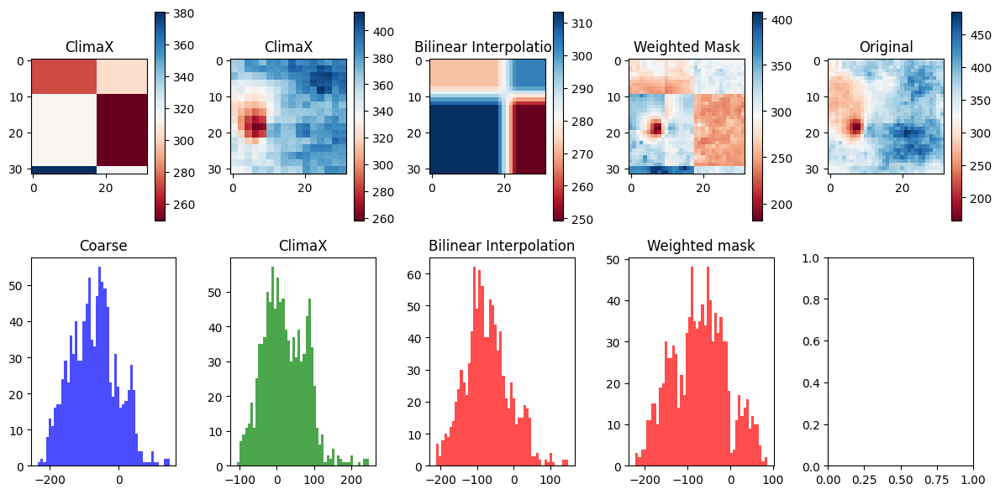

Time step 37
torch.Size([80, 1, 32, 32])


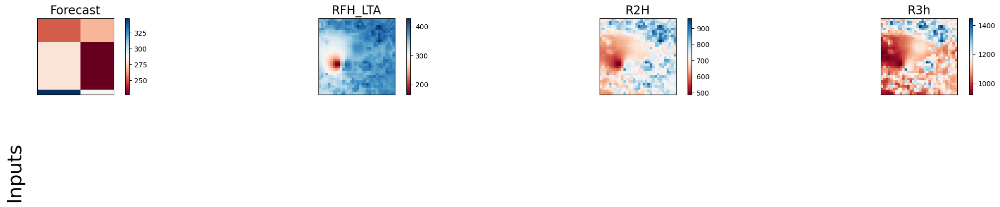

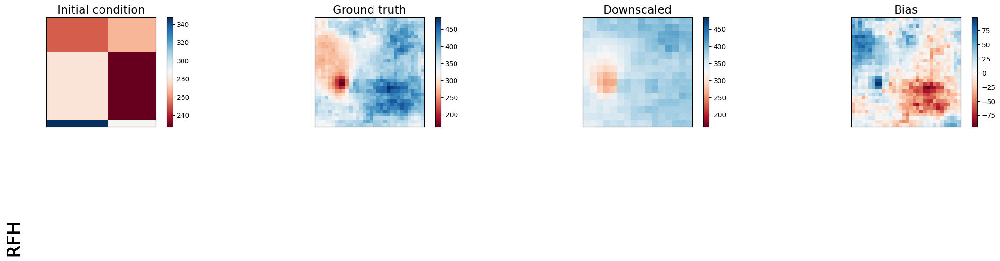

Selected device: cpu
+----------------------+---------------------+--------------------+------------------------+----------------------+
|                      | Coarse              | ClimaX             | Bilinear Interpolation | Weighted Mask        |
+----------------------+---------------------+--------------------+------------------------+----------------------+
| lat_weighted_mse_val | 21634.29296875      | 968.020263671875   | 13596.67578125         | 13757.8193359375     |
| lat_weighted_rmse    | 147.08599853515625  | 31.11302375793457  | 116.60478210449219     | 117.29373168945312   |
| spearman             | 0.12119211421533857 | 0.7461467764737332 | -0.3230370012805742    | -0.22199126747770237 |
| mean_bias            | 140.35641479492188  | 2.706817626953125  | -100.7415771484375     | -99.90432739257812   |
| pearson              | 0.11514421825009272 | 0.818771908226806  | -0.3441717848364576    | -0.10348205333407874 |
+----------------------+---------------------+-----

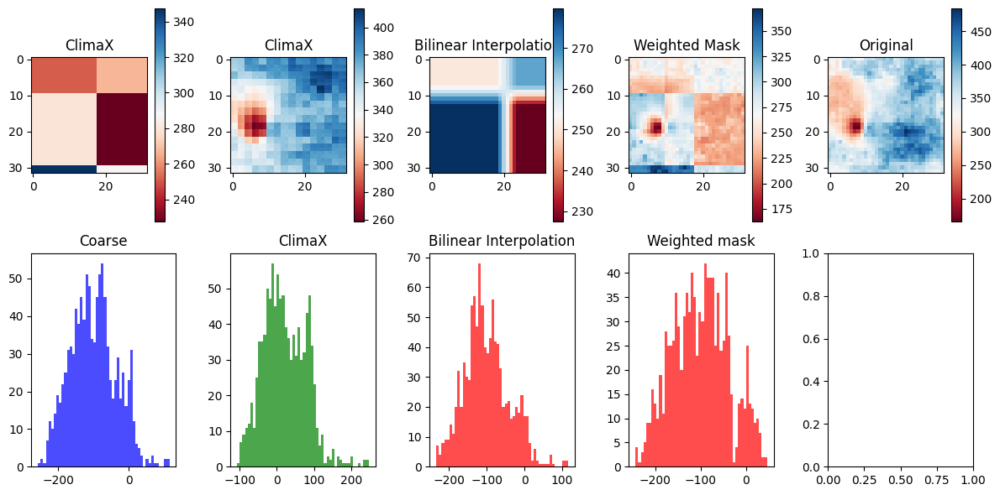

Time step 38
torch.Size([80, 1, 32, 32])


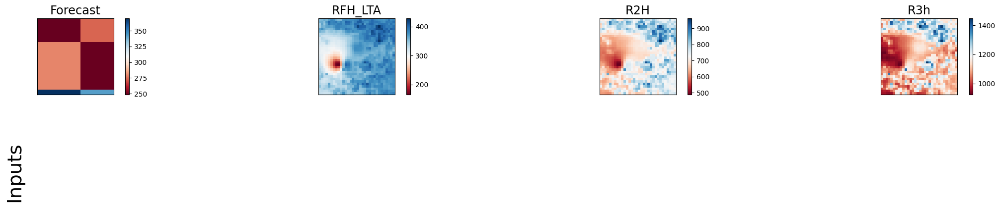

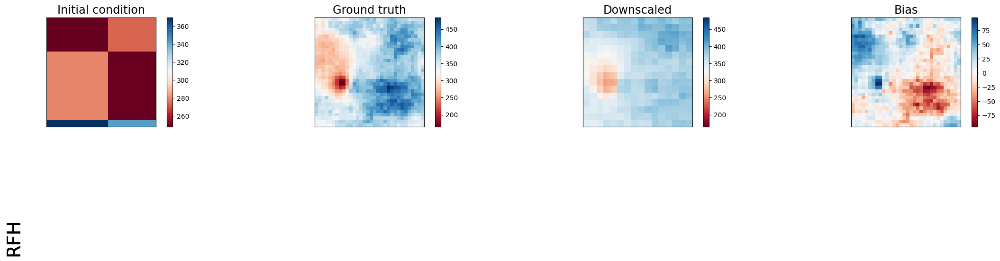

Selected device: cpu
+----------------------+-----------------------+--------------------+------------------------+----------------------+
|                      | Coarse                | ClimaX             | Bilinear Interpolation | Weighted Mask        |
+----------------------+-----------------------+--------------------+------------------------+----------------------+
| lat_weighted_mse_val | 19634.451171875       | 968.0093994140625  | 12090.8486328125       | 11602.3310546875     |
| lat_weighted_rmse    | 140.12298583984375    | 31.112850189208984 | 109.9583969116211      | 107.71411895751953   |
| spearman             | 0.06444006552444877   | 0.7461510569799338 | -0.12095596892023831   | -0.00843765780736609 |
| mean_bias            | 132.00750732421875    | 2.707122802734375  | -96.1064453125         | -91.523193359375     |
| pearson              | -0.021039541476199977 | 0.8187746448592766 | -0.17178097335980205   | 0.07585299470621726  |
+----------------------+-----------

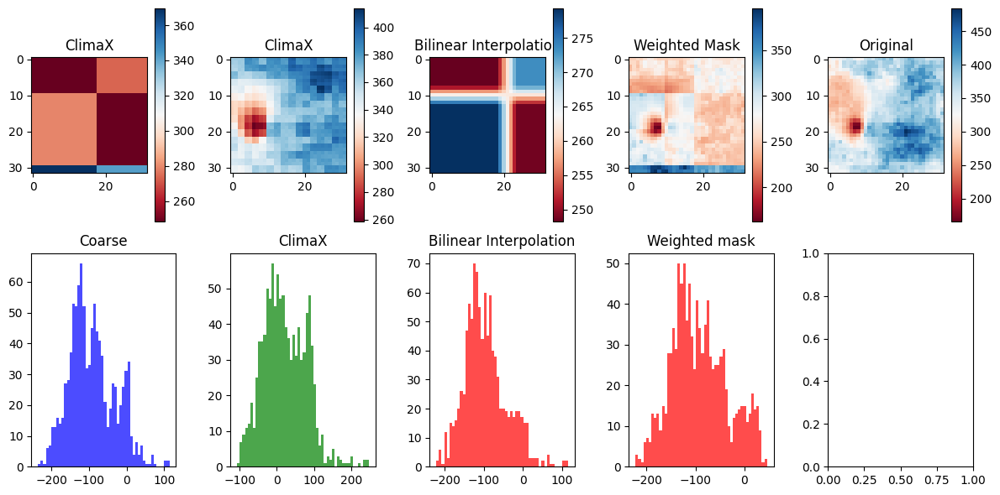

Time step 39
torch.Size([80, 1, 32, 32])


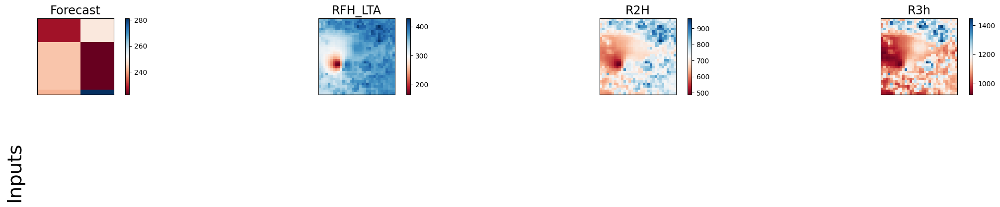

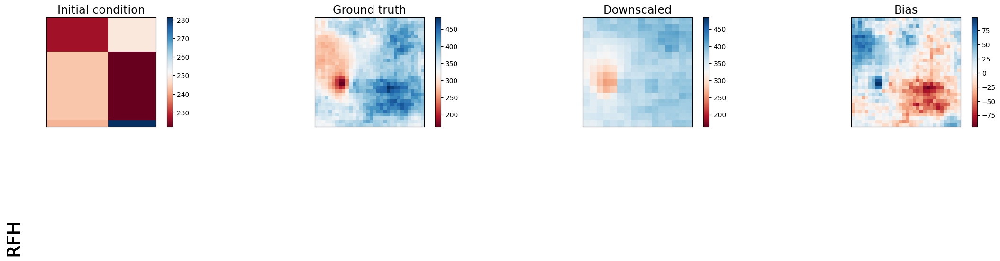

Selected device: cpu
+----------------------+---------------------+--------------------+------------------------+----------------------+
|                      | Coarse              | ClimaX             | Bilinear Interpolation | Weighted Mask        |
+----------------------+---------------------+--------------------+------------------------+----------------------+
| lat_weighted_mse_val | 28743.7578125       | 968.0099487304688  | 18347.091796875        | 18013.48046875       |
| lat_weighted_rmse    | 169.5398406982422   | 31.112857818603516 | 135.45143127441406     | 134.2143096923828    |
| spearman             | 0.18050117752453104 | 0.7461510569799338 | -0.13377045215095143   | 0.031610193495097735 |
| mean_bias            | 164.94407653808594  | 2.7060546875       | -125.19122314453125    | -124.44918823242188  |
| pearson              | 0.06383812588161601 | 0.8187735642104765 | -0.15951314652492238   | 0.16024614202057516  |
+----------------------+---------------------+-----

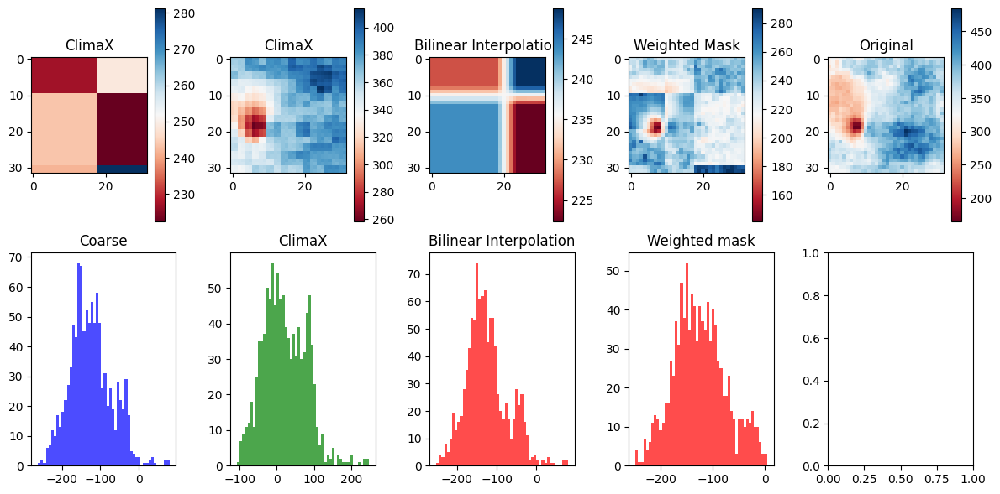

Time step 40
torch.Size([80, 1, 32, 32])


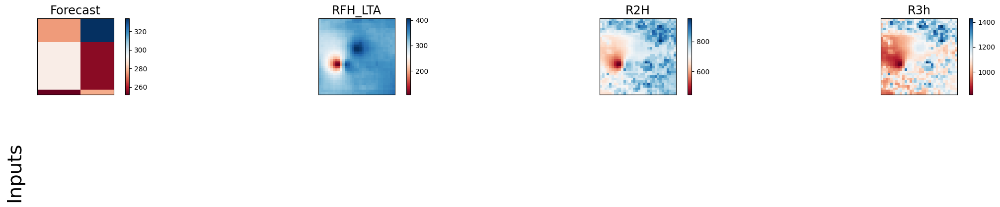

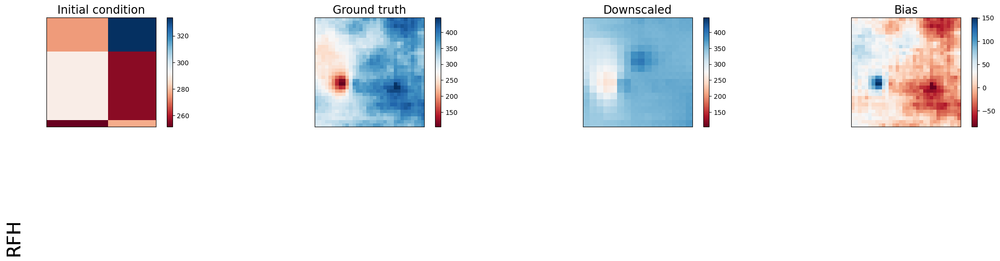

Selected device: cpu
+----------------------+---------------------+--------------------+------------------------+-----------------------+
|                      | Coarse              | ClimaX             | Bilinear Interpolation | Weighted Mask         |
+----------------------+---------------------+--------------------+------------------------+-----------------------+
| lat_weighted_mse_val | 15842.08984375      | 1140.3052978515625 | 6002.13525390625       | 6143.326171875        |
| lat_weighted_rmse    | 125.86536407470703  | 33.76840591430664  | 77.47344970703125      | 78.3793716430664      |
| spearman             | 0.25775192062708424 | 0.8378181727565486 | -0.16212426675233826   | -0.016306119978178324 |
| mean_bias            | 119.31414794921875  | 7.62615966796875   | -52.450897216796875    | -54.1007080078125     |
| pearson              | 0.2383687569756665  | 0.8781186035229169 | -0.048826874103869     | 0.18648686299546427   |
+----------------------+-------------------

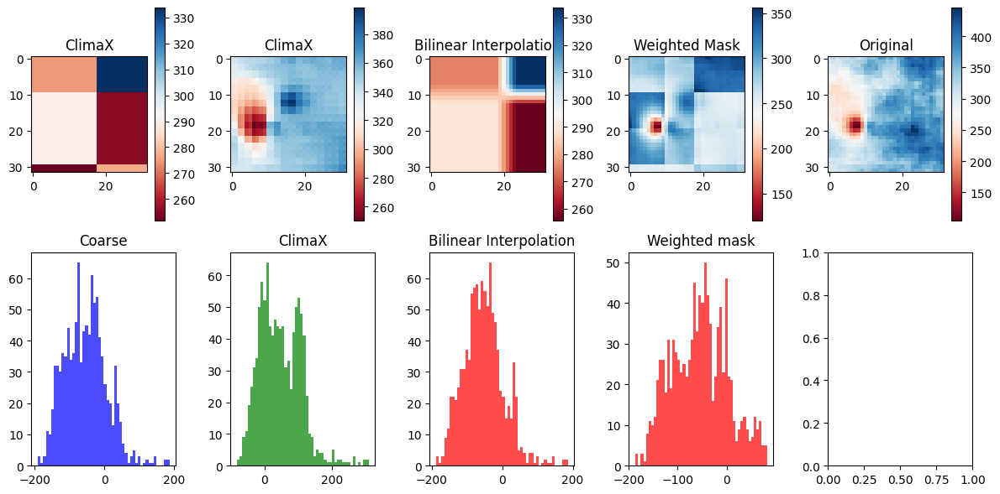

Time step 41
torch.Size([80, 1, 32, 32])


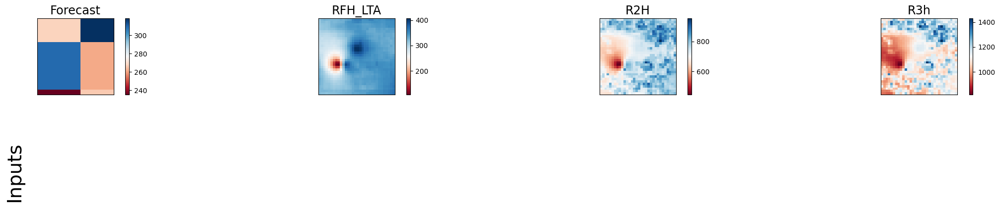

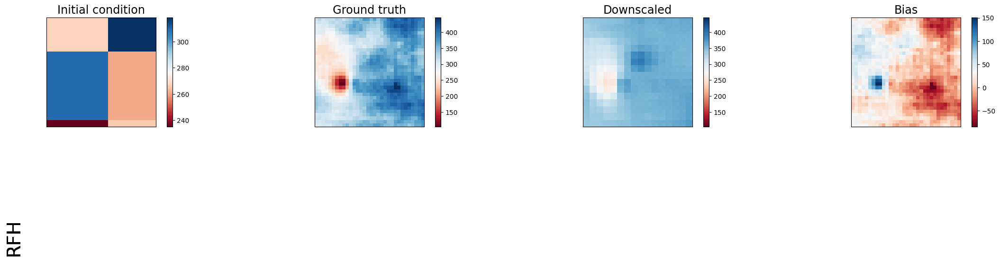

Selected device: cpu
+----------------------+--------------------+--------------------+------------------------+----------------------+
|                      | Coarse             | ClimaX             | Bilinear Interpolation | Weighted Mask        |
+----------------------+--------------------+--------------------+------------------------+----------------------+
| lat_weighted_mse_val | 14926.5556640625   | 1140.3072509765625 | 5756.65234375          | 6227.4267578125      |
| lat_weighted_rmse    | 122.17428588867188 | 33.768436431884766 | 75.87260437011719      | 78.91404724121094    |
| spearman             | 0.2813877969272997 | 0.8378252081867941 | -0.17891795689118947   | -0.05611207409376151 |
| mean_bias            | 115.46817016601562 | 7.626220703125     | -46.145599365234375    | -50.265625           |
| pearson              | 0.2594513377132559 | 0.8781185253111101 | -0.1954917441428114    | 0.0716588520587435   |
+----------------------+--------------------+--------------

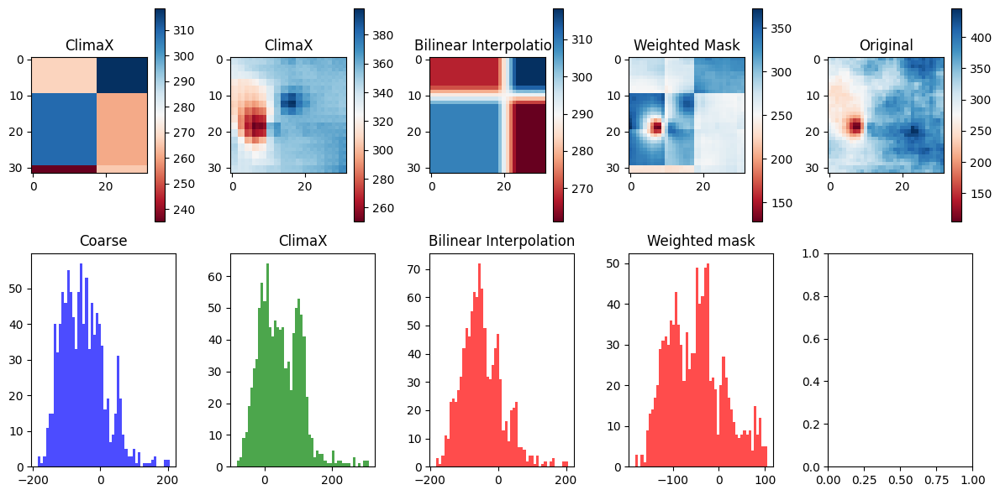

Time step 42
torch.Size([80, 1, 32, 32])


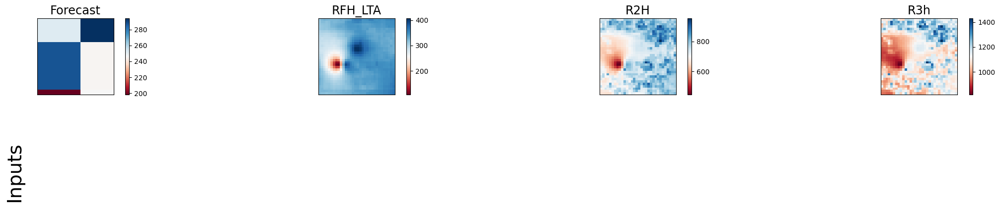

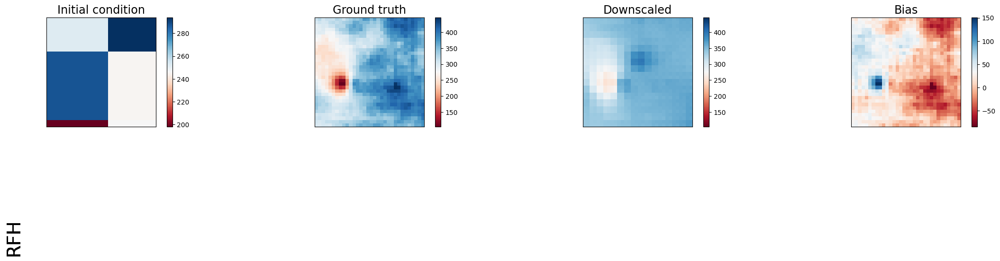

Selected device: cpu
+----------------------+--------------------+--------------------+------------------------+-----------------------+
|                      | Coarse             | ClimaX             | Bilinear Interpolation | Weighted Mask         |
+----------------------+--------------------+--------------------+------------------------+-----------------------+
| lat_weighted_mse_val | 19896.8203125      | 1140.302490234375  | 7784.54052734375       | 8487.568359375        |
| lat_weighted_rmse    | 141.05609130859375 | 33.76836395263672  | 88.23004150390625      | 92.12799835205078     |
| spearman             | 0.2813877969272997 | 0.8378270131462614 | -0.17660899068961106   | -0.059977900894905053 |
| mean_bias            | 135.3887939453125  | 7.625762939453125  | -65.54193115234375     | -70.183349609375      |
| pearson              | 0.2501577380703928 | 0.8781193317736325 | -0.21356957401493798   | 0.07525702139798218   |
+----------------------+--------------------+------

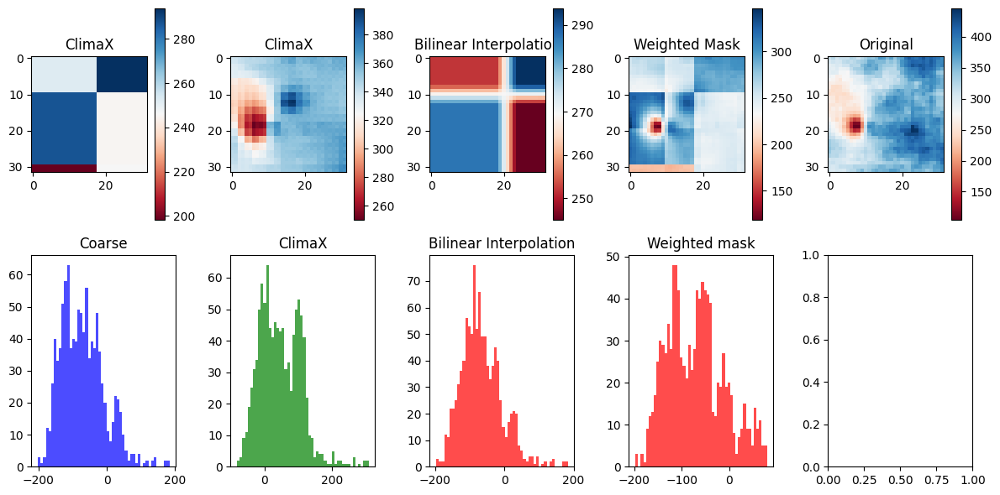

Time step 43
torch.Size([80, 1, 32, 32])


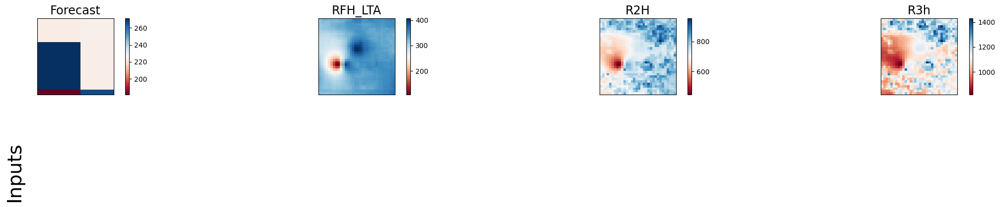

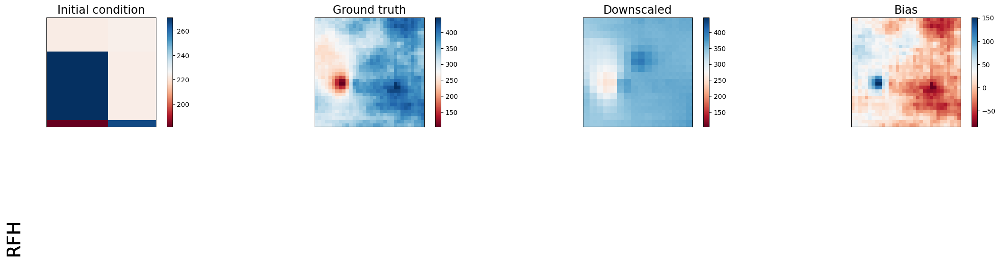

Selected device: cpu
+----------------------+---------------------+--------------------+------------------------+----------------------+
|                      | Coarse              | ClimaX             | Bilinear Interpolation | Weighted Mask        |
+----------------------+---------------------+--------------------+------------------------+----------------------+
| lat_weighted_mse_val | 28037.130859375     | 1140.302734375     | 12562.8466796875       | 13420.7763671875     |
| lat_weighted_rmse    | 167.4429168701172   | 33.768367767333984 | 112.0841064453125      | 115.84807586669922   |
| spearman             | 0.141039083371572   | 0.837827219906324  | -0.24571028000892275   | -0.13465190894195664 |
| mean_bias            | 161.7313995361328   | 7.625091552734375  | -91.807373046875       | -96.537109375        |
| pearson              | 0.10183965896812502 | 0.8781188759512639 | -0.3839072576678039    | -0.08754530416947087 |
+----------------------+---------------------+-----

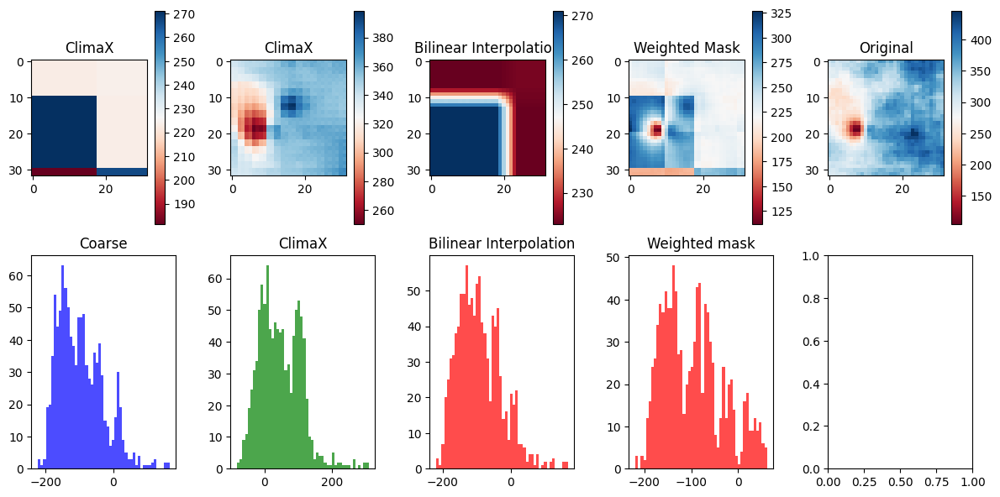

Time step 44
torch.Size([80, 1, 32, 32])


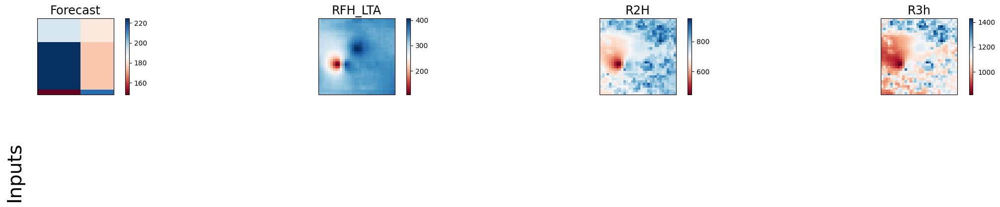

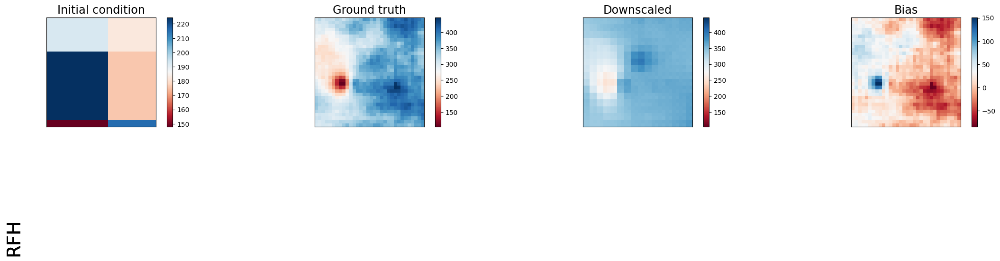

Selected device: cpu
+----------------------+---------------------+--------------------+------------------------+----------------------+
|                      | Coarse              | ClimaX             | Bilinear Interpolation | Weighted Mask        |
+----------------------+---------------------+--------------------+------------------------+----------------------+
| lat_weighted_mse_val | 43605.3828125       | 1140.2989501953125 | 22223.109375           | 23572.671875         |
| lat_weighted_rmse    | 208.8190155029297   | 33.768314361572266 | 149.0741729736328      | 153.53395080566406   |
| spearman             | 0.16119330636689697 | 0.8378157251644537 | -0.5342915178365809    | -0.3744917835370952  |
| mean_bias            | 204.65248107910156  | 7.6240234375       | -134.4058074951172     | -139.46226501464844  |
| pearson              | 0.13116651617500696 | 0.8781191351556166 | -0.4958147280860925    | -0.19433193565389129 |
+----------------------+---------------------+-----

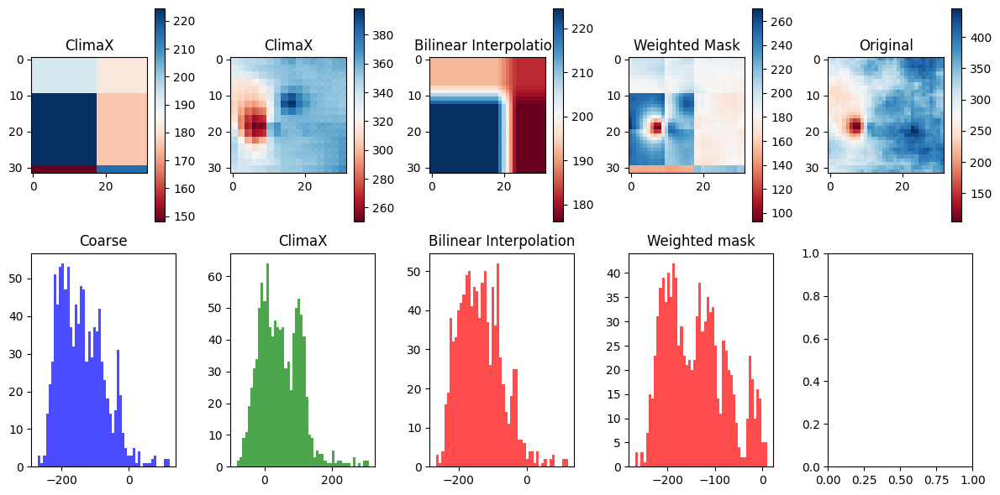

Time step 45
torch.Size([80, 1, 32, 32])


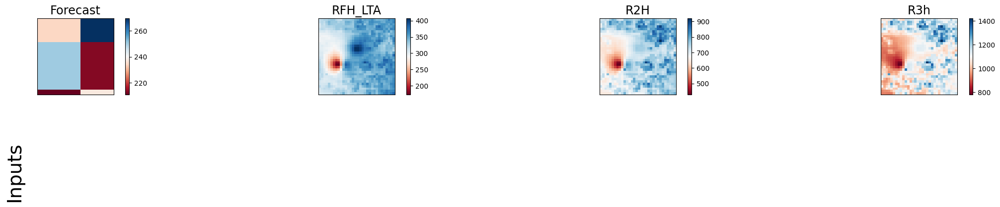

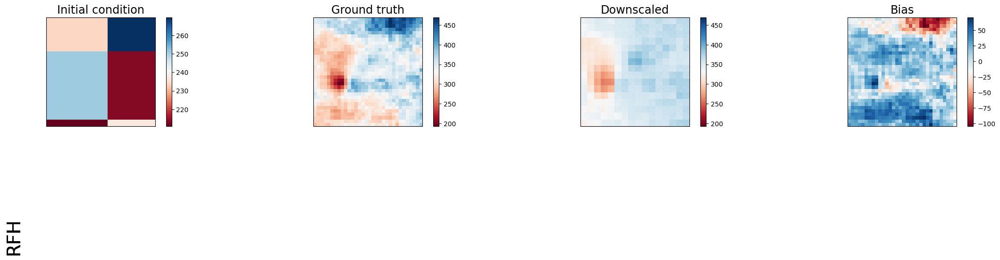

Selected device: cpu
+----------------------+---------------------+--------------------+------------------------+---------------------+
|                      | Coarse              | ClimaX             | Bilinear Interpolation | Weighted Mask       |
+----------------------+---------------------+--------------------+------------------------+---------------------+
| lat_weighted_mse_val | 28096.08203125      | 951.322021484375   | 11514.5458984375       | 11733.962890625     |
| lat_weighted_rmse    | 167.61886596679688  | 30.843507766723633 | 107.30585479736328     | 108.32341766357422  |
| spearman             | 0.25775192062708424 | 0.7517149341059736 | -0.1263634682201891    | 0.17855904173584689 |
| mean_bias            | 163.24485778808594  | 10.084197998046875 | -97.78627014160156     | -100.21897888183594 |
| pearson              | 0.2525236902111371  | 0.718554169949448  | -0.01964611029818013   | 0.2911290811350318  |
+----------------------+---------------------+-------------

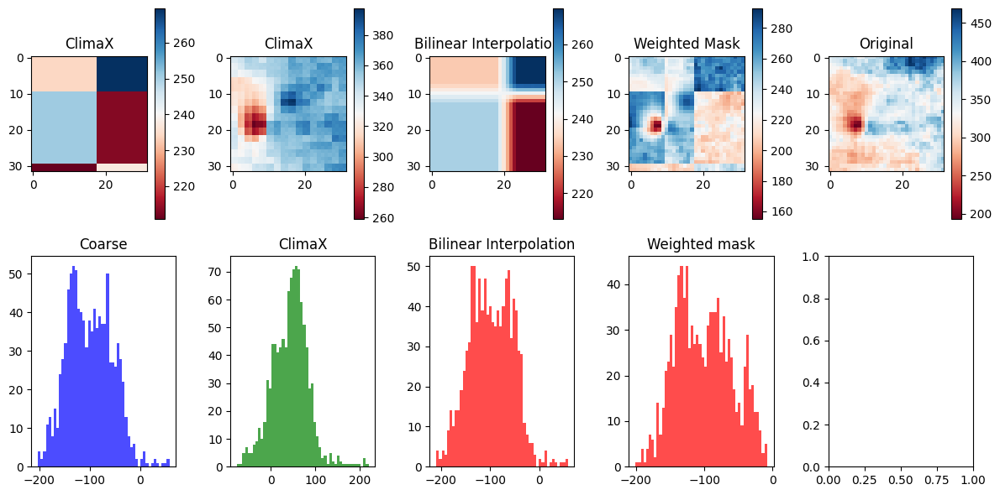

Time step 46
torch.Size([80, 1, 32, 32])


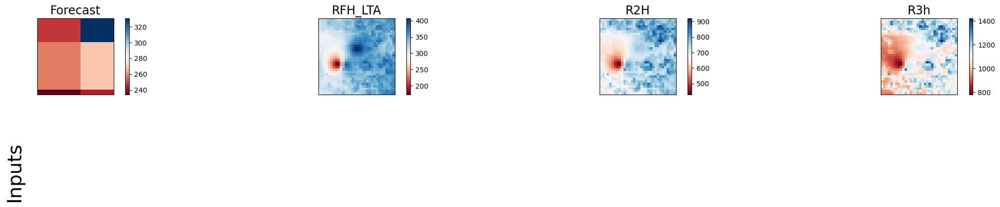

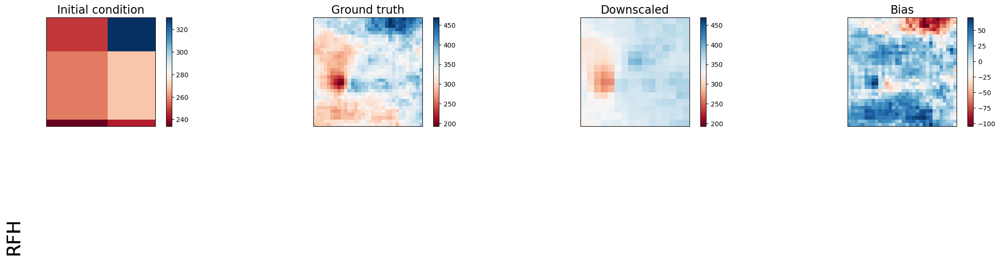

Selected device: cpu
+----------------------+---------------------+--------------------+------------------------+--------------------+
|                      | Coarse              | ClimaX             | Bilinear Interpolation | Weighted Mask      |
+----------------------+---------------------+--------------------+------------------------+--------------------+
| lat_weighted_mse_val | 19805.33203125      | 951.3241577148438  | 6557.77587890625       | 6005.17919921875   |
| lat_weighted_rmse    | 140.73141479492188  | 30.843544006347656 | 80.98009490966797      | 77.49308776855469  |
| spearman             | 0.06444783852219046 | 0.7517098390757809 | 0.3540669655664279     | 0.5300835657520856 |
| mean_bias            | 133.845703125       | 10.085052490234375 | -72.57647705078125     | -70.743408203125   |
| pearson              | 0.12319009953181058 | 0.7185581031299287 | 0.4840937283124241     | 0.6461468843470297 |
+----------------------+---------------------+--------------------+

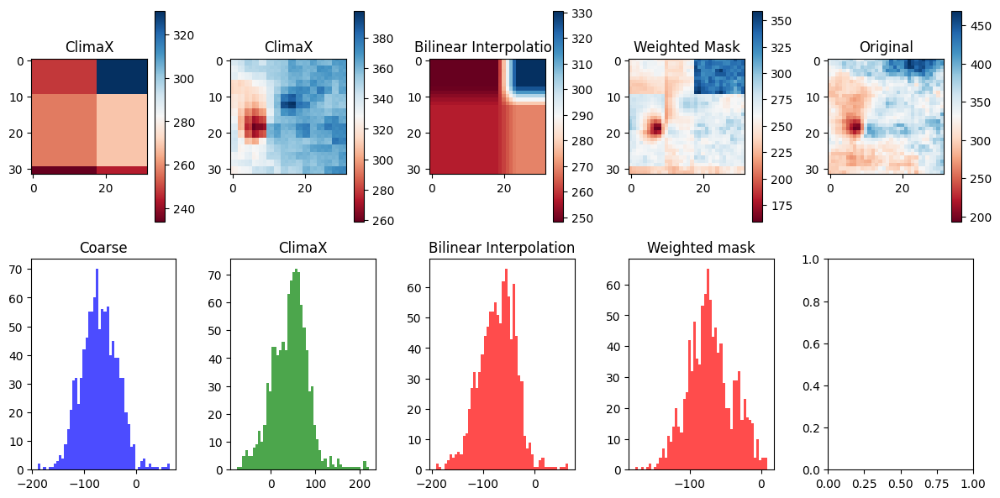

Time step 47
torch.Size([80, 1, 32, 32])


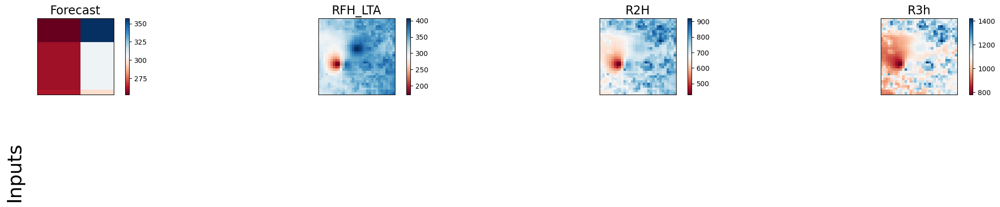

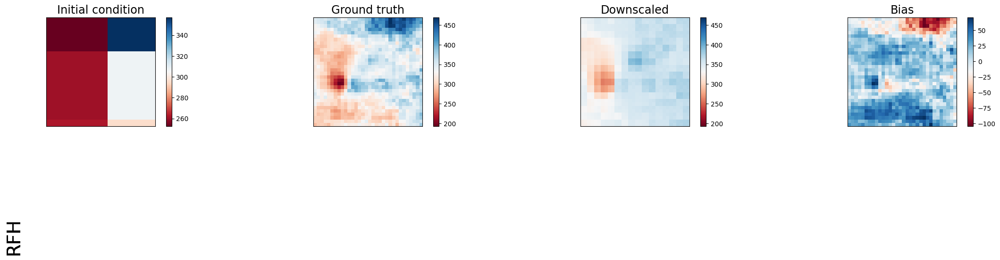

Selected device: cpu
+----------------------+-----------------------+--------------------+------------------------+---------------------+
|                      | Coarse                | ClimaX             | Bilinear Interpolation | Weighted Mask       |
+----------------------+-----------------------+--------------------+------------------------+---------------------+
| lat_weighted_mse_val | 16040.451171875       | 951.33056640625    | 4816.06005859375       | 3860.222900390625   |
| lat_weighted_rmse    | 126.6509017944336     | 30.843647003173828 | 69.39784240722656      | 62.13069152832031   |
| spearman             | -0.03500980225693447  | 0.7517129349260865 | 0.3512488422118073     | 0.5670239428647987  |
| mean_bias            | 115.3966064453125     | 10.085479736328125 | -58.628570556640625    | -52.247528076171875 |
| pearson              | -0.012682671463293216 | 0.7185574966471    | 0.5008905070793637     | 0.6522477766050948  |
+----------------------+-------------------

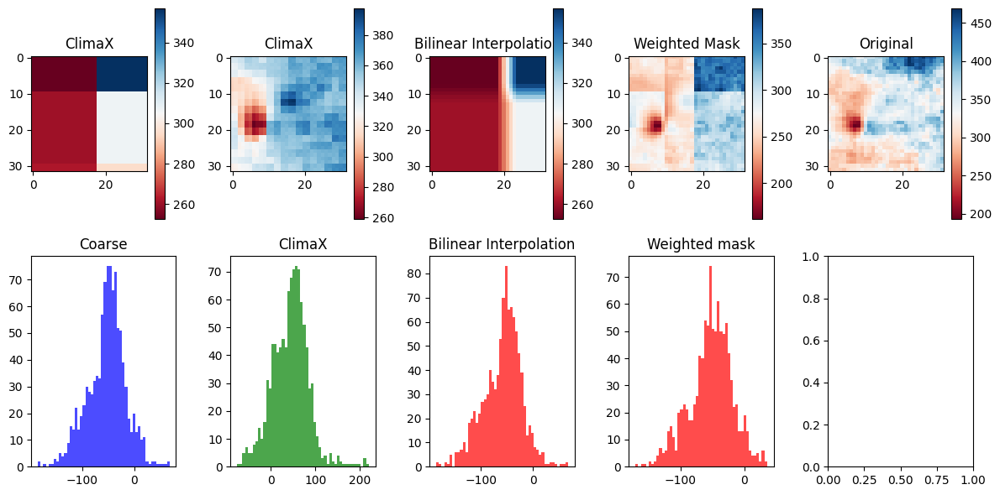

Time step 48
torch.Size([80, 1, 32, 32])


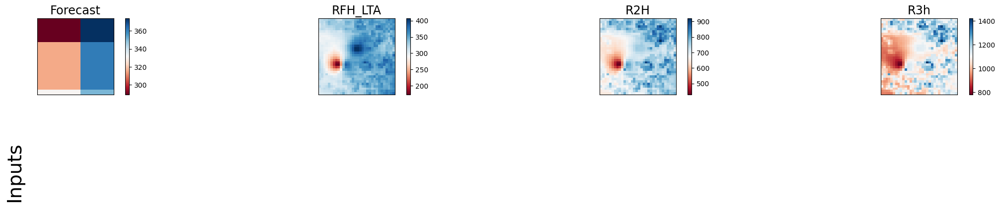

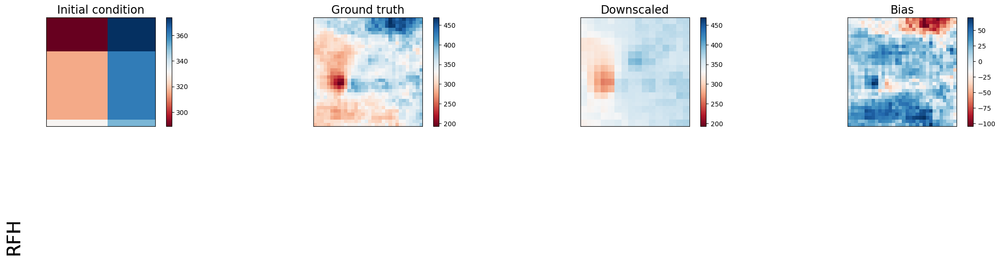

Selected device: cpu
+----------------------+----------------------+--------------------+------------------------+--------------------+
|                      | Coarse               | ClimaX             | Bilinear Interpolation | Weighted Mask      |
+----------------------+----------------------+--------------------+------------------------+--------------------+
| lat_weighted_mse_val | 7268.7021484375      | 951.3593139648438  | 1797.917236328125      | 1407.2738037109375 |
| lat_weighted_rmse    | 85.25668334960938    | 30.844112396240234 | 42.40185546875         | 37.513648986816406 |
| spearman             | -0.03500980225693447 | 0.7517005564191823 | 0.31542086316517026    | 0.518066037996253  |
| mean_bias            | 68.86260986328125    | 10.086517333984375 | -12.428253173828125    | -5.72845458984375  |
| pearson              | -0.08225195456892567 | 0.7185525661069271 | 0.3536142712732441     | 0.5447906558890668 |
+----------------------+----------------------+------------

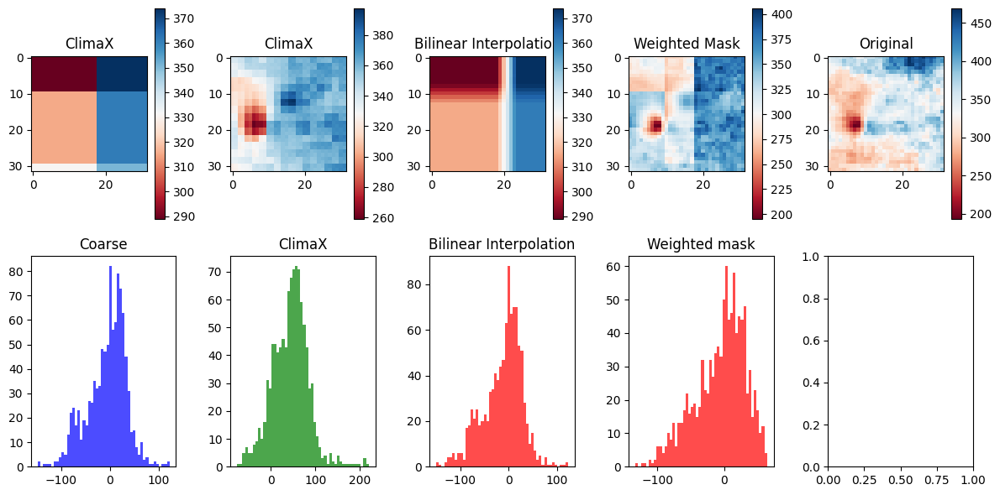

Time step 49
torch.Size([80, 1, 32, 32])


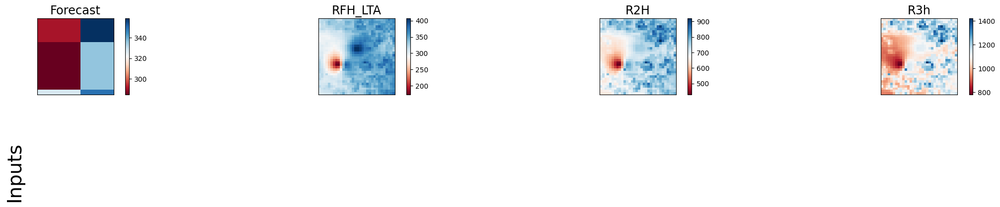

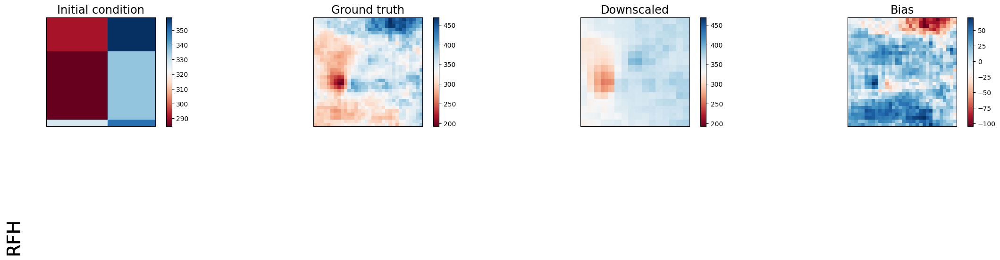

Selected device: cpu
+----------------------+----------------------+--------------------+------------------------+---------------------+
|                      | Coarse               | ClimaX             | Bilinear Interpolation | Weighted Mask       |
+----------------------+----------------------+--------------------+------------------------+---------------------+
| lat_weighted_mse_val | 10318.1083984375     | 951.3493041992188  | 2303.174072265625      | 1708.9842529296875  |
| lat_weighted_rmse    | 101.57808685302734   | 30.843950271606445 | 47.99139404296875      | 41.33986282348633   |
| spearman             | -0.11092031812796928 | 0.7517050381375071 | 0.5656444801449959     | 0.5832756834151438  |
| mean_bias            | 88.23794555664062    | 10.086090087890625 | -32.740203857421875    | -25.111175537109375 |
| pearson              | -0.11538391752192378 | 0.7185543786521378 | 0.5272262178880414     | 0.6337219240978769  |
+----------------------+----------------------+----

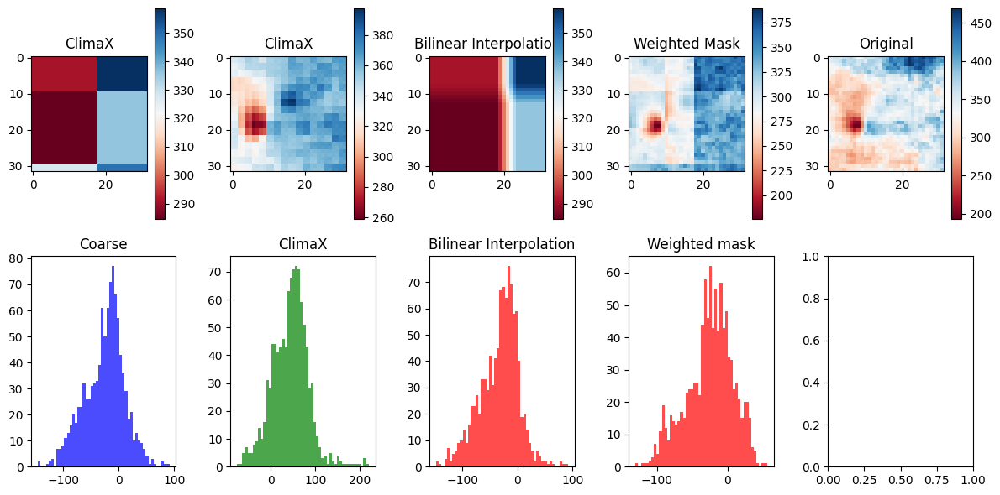

Time step 50
torch.Size([80, 1, 32, 32])


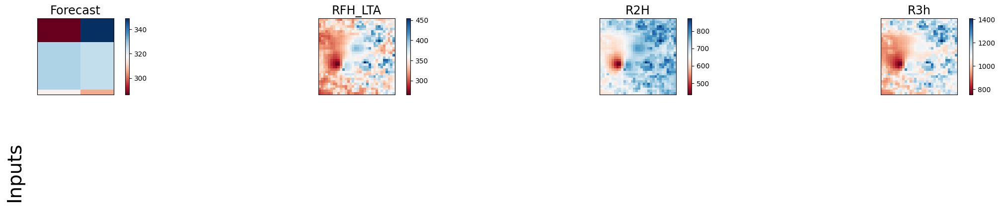

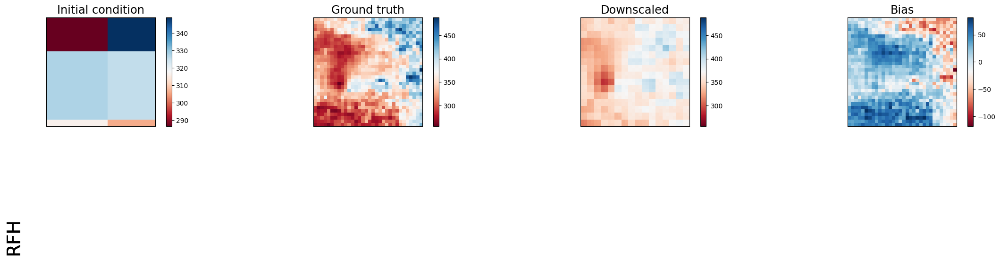

Selected device: cpu
+----------------------+--------------------+--------------------+------------------------+---------------------+
|                      | Coarse             | ClimaX             | Bilinear Interpolation | Weighted Mask       |
+----------------------+--------------------+--------------------+------------------------+---------------------+
| lat_weighted_mse_val | 8019.2412109375    | 1380.41162109375   | 2792.570068359375      | 2214.462646484375   |
| lat_weighted_rmse    | 89.55021667480469  | 37.153892517089844 | 52.84477233886719      | 47.05807876586914   |
| spearman             | 0.2292387782811778 | 0.7342729976121639 | 0.09178558868315934    | 0.47055349750785386 |
| mean_bias            | 79.95501708984375  | 11.36846923828125  | -25.966888427734375    | -24.51416015625     |
| pearson              | 0.1066245681265432 | 0.7097220103392745 | 0.2381877703159507     | 0.5227797560299243  |
+----------------------+--------------------+--------------------+-

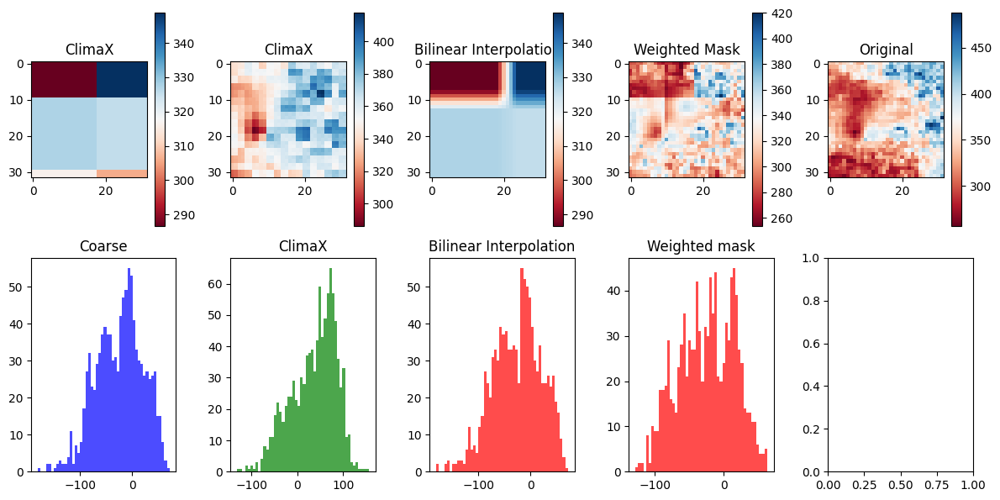

Time step 51
torch.Size([80, 1, 32, 32])


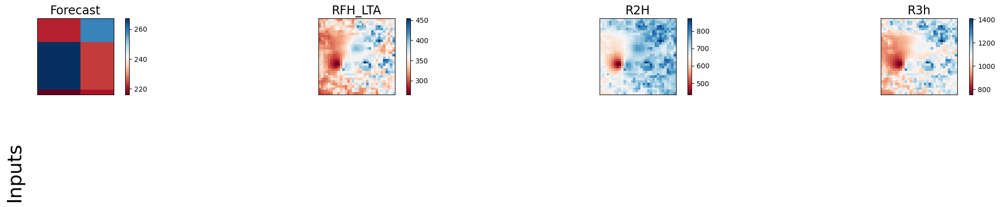

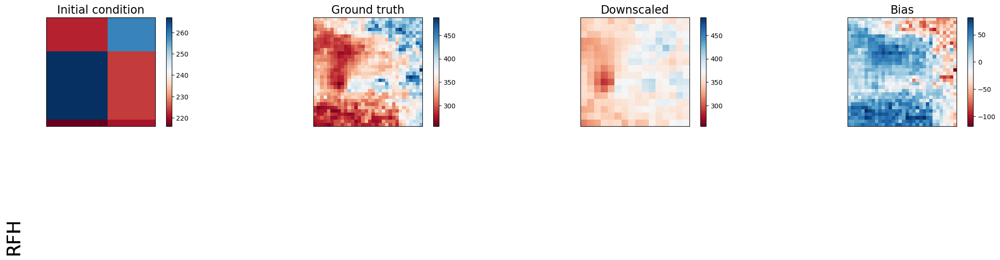

Selected device: cpu
+----------------------+---------------------+--------------------+------------------------+---------------------+
|                      | Coarse              | ClimaX             | Bilinear Interpolation | Weighted Mask       |
+----------------------+---------------------+--------------------+------------------------+---------------------+
| lat_weighted_mse_val | 26615.740234375     | 1380.3865966796875 | 13004.7880859375       | 13137.3525390625    |
| lat_weighted_rmse    | 163.143310546875    | 37.1535530090332   | 114.03853607177734     | 114.61829376220703  |
| spearman             | 0.2166902363507955  | 0.7342645427987912 | -0.3297485350692267    | 0.12238677073138679 |
| mean_bias            | 158.50941467285156  | 11.36627197265625  | -99.7265625            | -103.13394165039062 |
| pearson              | 0.24734755471849132 | 0.709719096083379  | -0.27559174020268074   | 0.155647411678071   |
+----------------------+---------------------+-------------

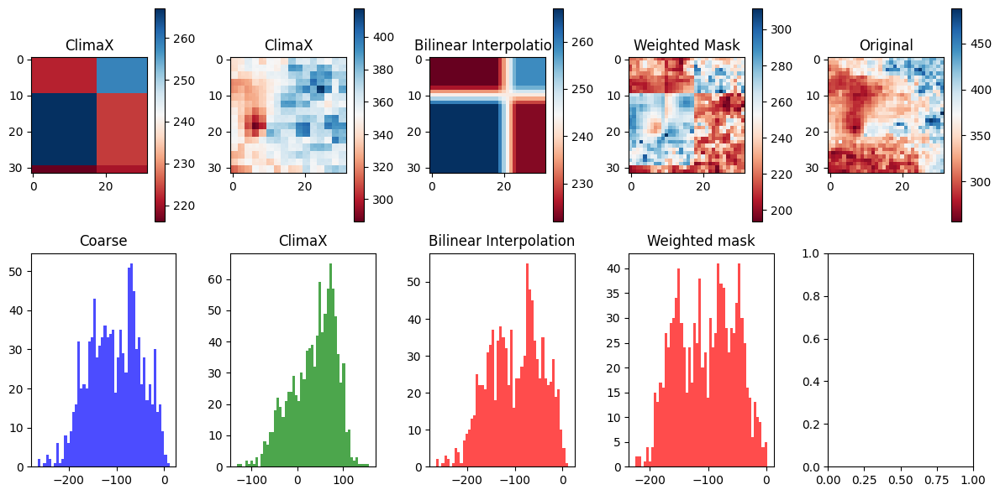

Time step 52
torch.Size([80, 1, 32, 32])


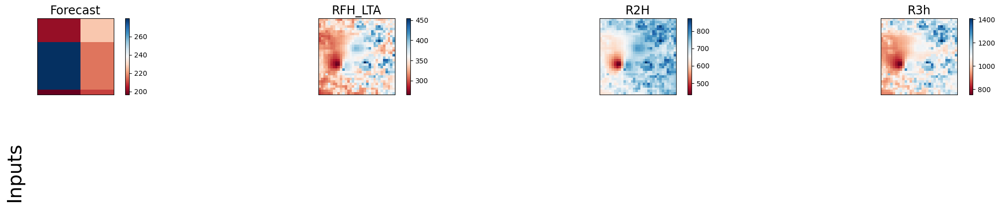

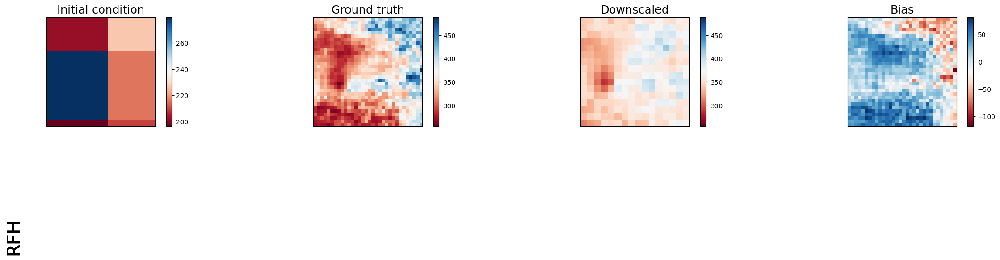

Selected device: cpu
+----------------------+---------------------+--------------------+------------------------+-----------------------+
|                      | Coarse              | ClimaX             | Bilinear Interpolation | Weighted Mask         |
+----------------------+---------------------+--------------------+------------------------+-----------------------+
| lat_weighted_mse_val | 29354.34765625      | 1380.399658203125  | 15243.564453125        | 15855.06640625        |
| lat_weighted_rmse    | 171.3311004638672   | 37.15372848510742  | 123.46482849121094     | 125.91690063476562    |
| spearman             | 0.19305436005058    | 0.7342490581405918 | -0.3803273268959895    | -0.021297737307058077 |
| mean_bias            | 165.19155883789062  | 11.365997314453125 | -103.93614196777344    | -109.84768676757812   |
| pearson              | 0.17822941217025037 | 0.7097135852120515 | -0.427533886879248     | -0.09677475656120674  |
+----------------------+-------------------

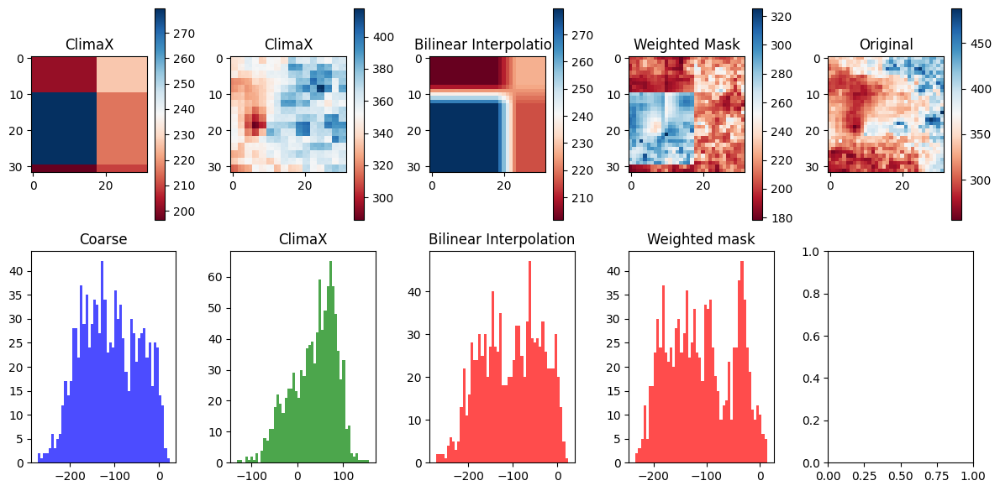

Time step 53
torch.Size([80, 1, 32, 32])


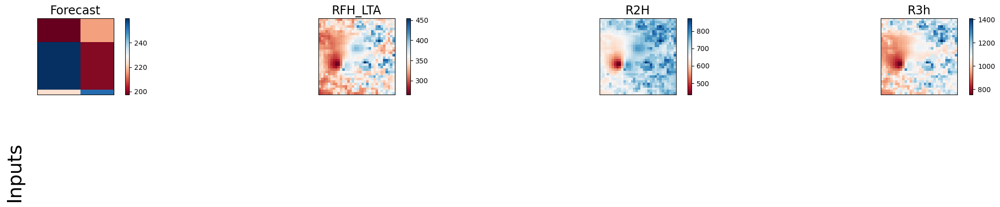

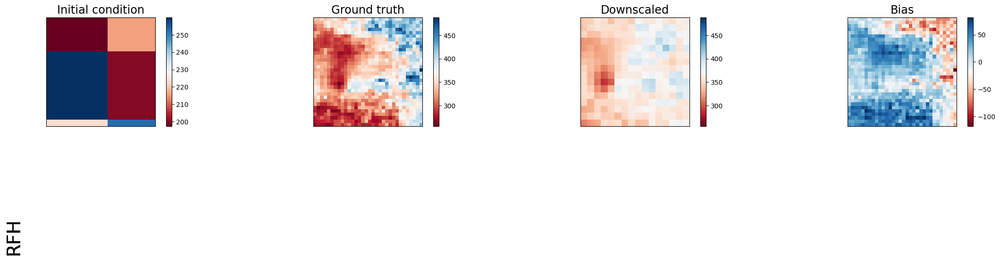

Selected device: cpu
+----------------------+---------------------+--------------------+------------------------+---------------------+
|                      | Coarse              | ClimaX             | Bilinear Interpolation | Weighted Mask       |
+----------------------+---------------------+--------------------+------------------------+---------------------+
| lat_weighted_mse_val | 33082.17578125      | 1380.396484375     | 18040.845703125        | 18253.3515625       |
| lat_weighted_rmse    | 181.8850555419922   | 37.1536865234375   | 134.3162078857422      | 135.10496520996094  |
| spearman             | 0.13229947275547363 | 0.7342519464518896 | -0.3961253218425262    | -0.1360075706815507 |
| mean_bias            | 176.46994018554688  | 11.36566162109375  | -118.30375671386719    | -121.13088989257812 |
| pearson              | 0.12409050927347628 | 0.7097127000403971 | -0.4505961944230647    | -0.1542434316089616 |
+----------------------+---------------------+-------------

KeyboardInterrupt: 

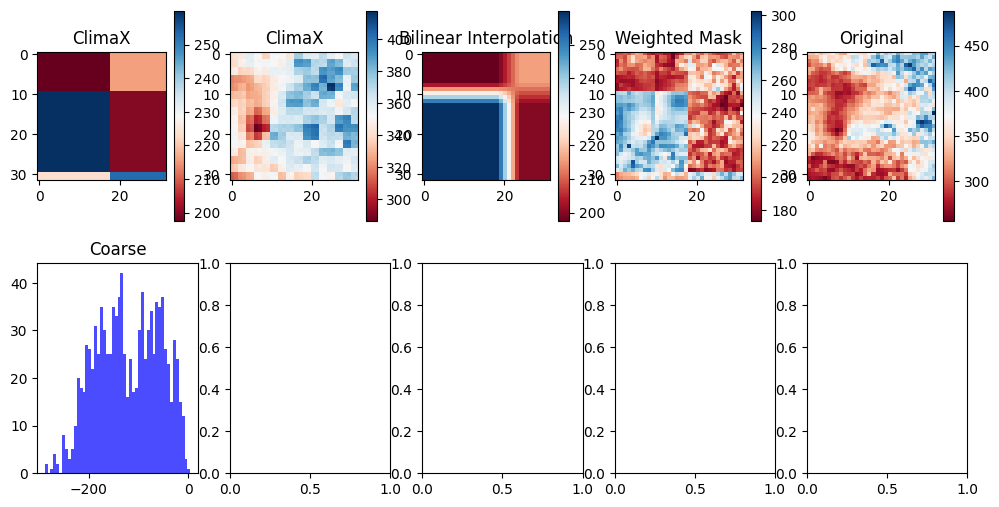

In [11]:
for t in range(timesteps):
    print("Time step",t)
    print(gt.shape)
    plot_inputs(tensors, var_name, pred_task,t)
    plot_pred(tensors_pred, var_name, pred_task,t)


    bilinear_inter = bilinear_interpolate(forecast[t].unsqueeze(dim=0))
    weighted_mask = Downscale_Weight(rfh_lta[t].cpu().numpy(),forecast[t].cpu().numpy(), verbose=False)

    compare_results(gt, forecast, pred , bilinear_inter, weighted_mask, model,t,denormalize_out)
    plot_compare(gt, forecast, pred, bilinear_inter, weighted_mask,t,denormalize_out)


## Member after Member

In [10]:
task = "10 days"
pred_range = TASK_TO_RANGE[task]

net_args = {
    'default_vars': [
        'forecast', 'rfh_lta', 'rfh','r2h','r3h']
    ,"img_size" :  [32, 32],
      "patch_size" :  2,
      "embed_dim":   2048,
      "depth" : 8,
      "decoder_depth" :  2,
      "num_heads": 16,
    "mlp_ratio": 2,
    "drop_path": 0.5,
    "drop_rate": 0.5,
    
}
net = ClimaX(**net_args)
model = ClimateDownscalingModule(net=net, pretrained_path='ClimaX/exps/downscale/checkpoints/epoch_003-v3.ckpt')

datamodule = ClimateDownscalingDataModule(root_dir=f'Data/Downscaling/Rainfall/Indonesia3/data_npz',
    variables=['forecast', 'rfh_lta', 'r2h','r3h'],
    out_variables=['rfh'],
    buffer_size= 2000,
    batch_size= 80
)

normalization = datamodule.transforms
print(normalization)
mean_norm, std_norm = normalization.mean, normalization.std
mean_denorm, std_denorm = -mean_norm / std_norm, 1 / std_norm
model.set_denormalization(mean_denorm, std_denorm)
model.set_lat_lon(*datamodule.get_lat_lon())

denormalize_out = transforms.Normalize(datamodule.output_transforms.mean /datamodule.output_transforms.std , 1/datamodule.output_transforms.std)

datamodule.setup()


gt,pred,tensors,var_name, pred_task,tensors_pred = visualize_downscale(model, datamodule,mean_norm, std_norm, pred_range, var_name = "RFH", var_id = 1,desired_batch_index=1)
forecast, rfh_lta = tensors[0], tensors[1]
timesteps=gt.shape[0]

Loading pre-trained checkpoint from: ClimaX/exps/downscale/checkpoints/epoch_003-v3.ckpt
<All keys matched successfully>
Normalize(mean=[1308.39136668  308.99651812  640.45225054  987.65203332], std=[642.83953892  47.51114476  81.22478987 112.16024587])
Selected device: cuda:0
self.var_map=== {'forecast': 0, 'rfh_lta': 1, 'rfh': 2, 'r2h': 3, 'r3h': 4}
self.var_map=== {'forecast': 0, 'rfh_lta': 1, 'rfh': 2, 'r2h': 3, 'r3h': 4}


In [ ]:
7*16

Time step 0
torch.Size([80, 1, 32, 32])


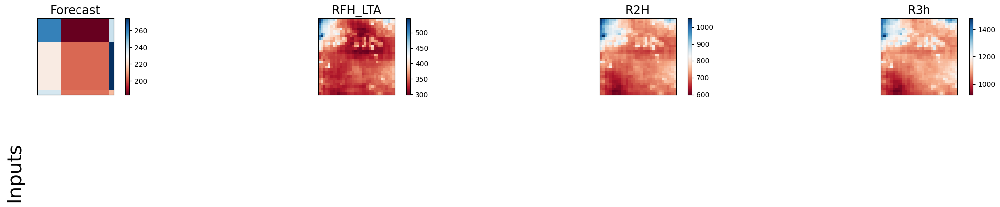

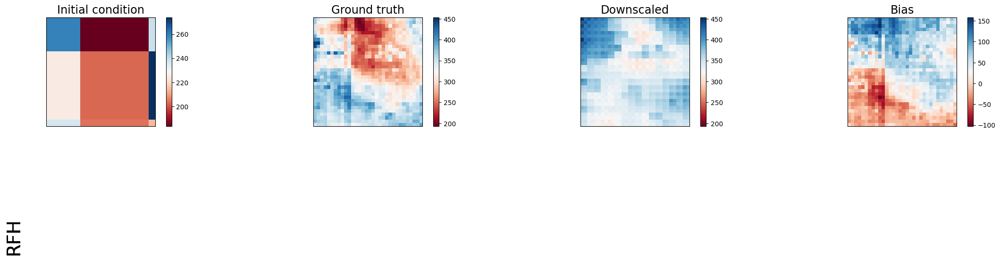

/mnt/shared/users/wessim.omezzine/.local/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3464: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/mnt/shared/users/wessim.omezzine/.local/lib/python3.10/site-packages/numpy/core/_methods.py:192: RuntimeWarning: invalid value encountered in divide
  ret = ret.dtype.type(ret / rcount)


Selected device: cuda:0
+----------------------+---------------------+---------------------+------------------------+---------------------+
|                      | Coarse              | ClimaX              | Bilinear Interpolation | Weighted Mask       |
+----------------------+---------------------+---------------------+------------------------+---------------------+
| lat_weighted_mse_val | 13598.201171875     | 3489.82470703125    | 14265.83984375         | 13366.046875        |
| lat_weighted_rmse    | 116.611328125       | 59.074737548828125  | 119.43968963623047     | 115.61161804199219  |
| spearman             | 0.4647964911595913  | 0.2318690763709475  | 0.44726521302182654    | 0.5166592903482005  |
| mean_bias            | 107.25955200195312  | 33.259521484375     | -110.68275451660156    | -107.25955200195312 |
| pearson              | 0.34101663641312985 | 0.25064328546432507 | 0.35230772624619733    | 0.45457394514913496 |
+----------------------+---------------------+--

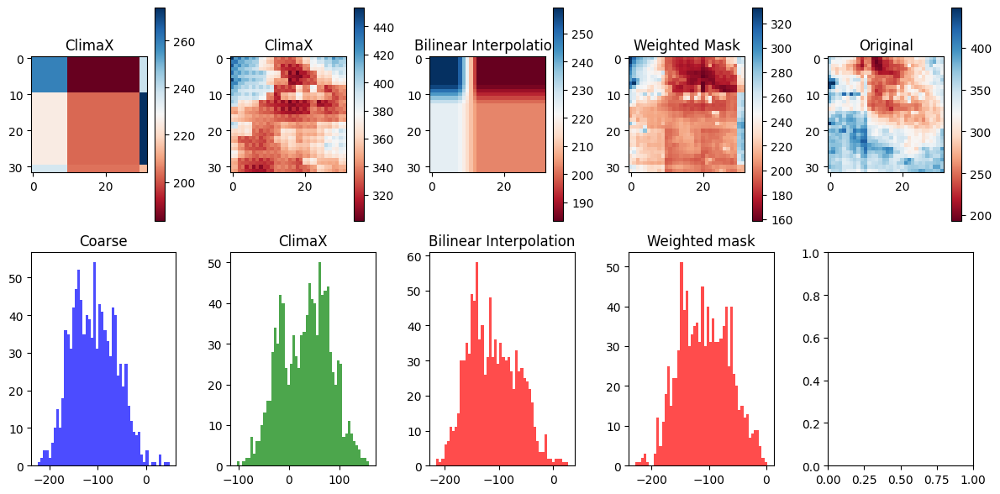

Time step 1
torch.Size([80, 1, 32, 32])


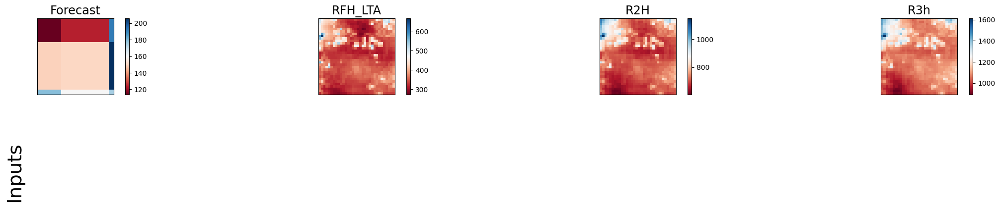

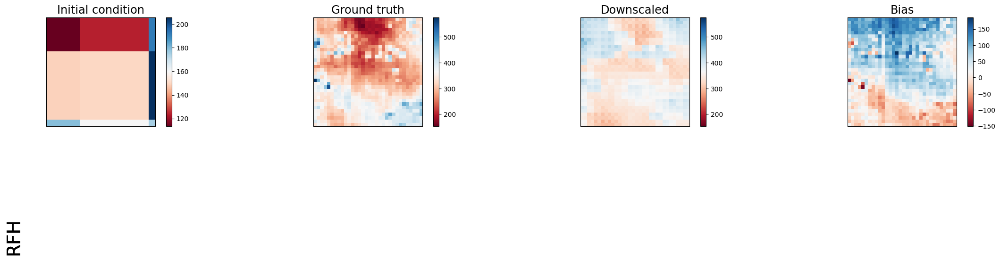

Selected device: cuda:0
+----------------------+---------------------+--------------------+------------------------+--------------------+
|                      | Coarse              | ClimaX             | Bilinear Interpolation | Weighted Mask      |
+----------------------+---------------------+--------------------+------------------------+--------------------+
| lat_weighted_mse_val | 32714.298828125     | 4708.208984375     | 34391.05859375         | 31758.2734375      |
| lat_weighted_rmse    | 180.87094116210938  | 68.61638641357422  | 185.44825744628906     | 178.20851135253906 |
| spearman             | 0.22244492181327394 | 0.4216891397995839 | 0.25651848598166377    | 0.5891124713823628 |
| mean_bias            | 175.1162109375      | 42.73919677734375  | -176.18553161621094    | -170.9267578125    |
| pearson              | 0.3354460945133794  | 0.4605617078453585 | 0.2880290988781943     | 0.5695194419275085 |
+----------------------+---------------------+------------------

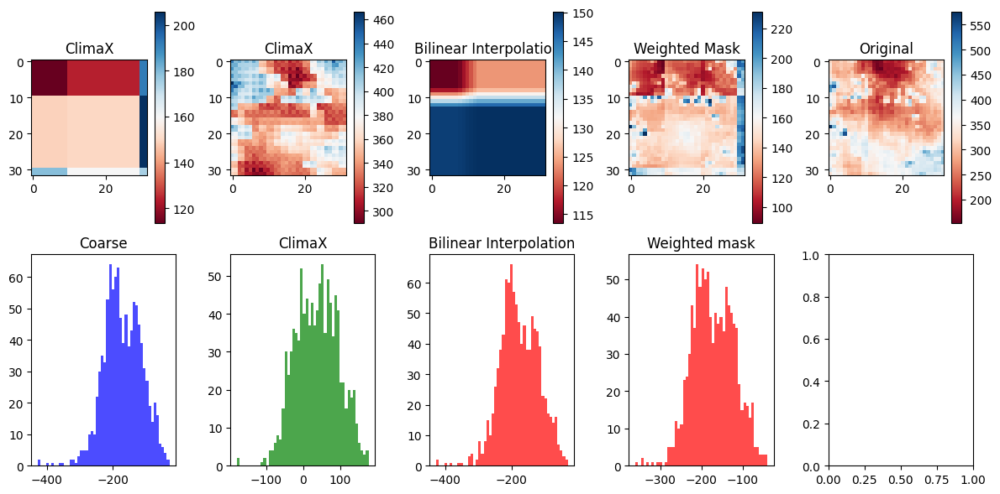

Time step 2
torch.Size([80, 1, 32, 32])


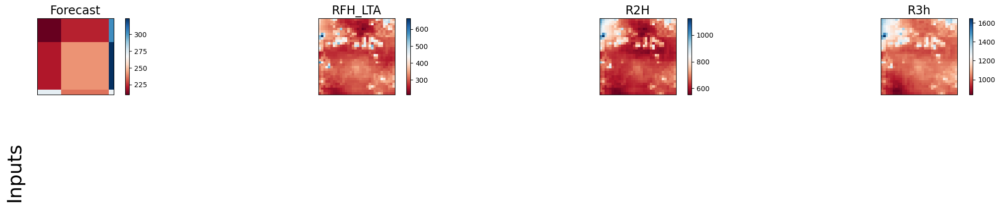

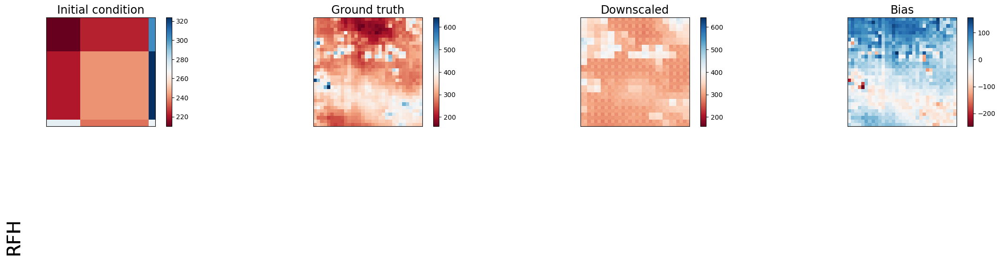

Selected device: cuda:0
+----------------------+----------------------+---------------------+------------------------+--------------------+
|                      | Coarse               | ClimaX              | Bilinear Interpolation | Weighted Mask      |
+----------------------+----------------------+---------------------+------------------------+--------------------+
| lat_weighted_mse_val | 9811.689453125       | 3236.530517578125   | 11015.9951171875       | 8488.7099609375    |
| lat_weighted_rmse    | 99.05397033691406    | 56.8905143737793    | 104.95710754394531     | 92.13419342041016  |
| spearman             | -0.08746945874884729 | 0.47373256441918227 | 0.2718180252227847     | 0.6677532420061858 |
| mean_bias            | 84.59930419921875    | 9.696075439453125   | -85.28326416015625     | -78.92742919921875 |
| pearson              | 0.08693072508395149  | 0.46435123054223154 | 0.2631357416302646     | 0.6579690254189248 |
+----------------------+----------------------+-

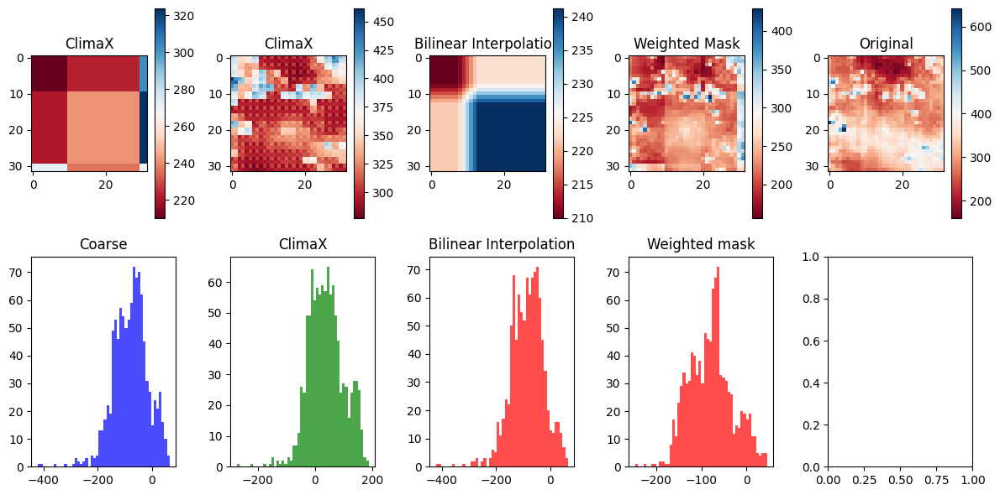

Time step 3
torch.Size([80, 1, 32, 32])


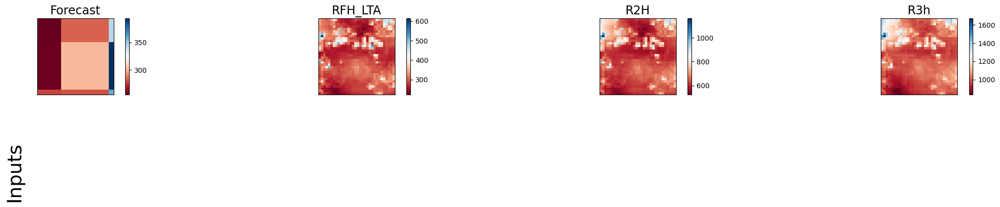

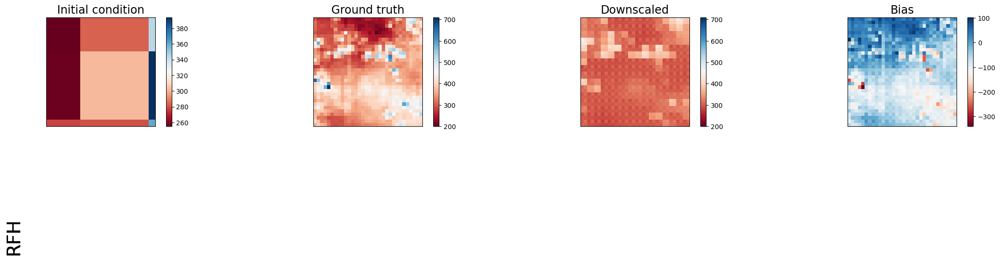

Selected device: cuda:0
+----------------------+---------------------+---------------------+------------------------+--------------------+
|                      | Coarse              | ClimaX              | Bilinear Interpolation | Weighted Mask      |
+----------------------+---------------------+---------------------+------------------------+--------------------+
| lat_weighted_mse_val | 4531.6552734375     | 5660.193359375      | 10420.75               | 7593.8916015625    |
| lat_weighted_rmse    | 67.31757354736328   | 75.2342529296875    | 102.08207702636719     | 87.14293670654297  |
| spearman             | -0.1776372178586745 | 0.42258173618034844 | 0.37646569940099445    | 0.7072978885749666 |
| mean_bias            | 32.172607421875     | -45.070068359375    | -79.13714599609375     | -73.48507690429688 |
| pearson              | -0.1075475821245421 | 0.43219148452648354 | 0.26146504898862205    | 0.7130702197803238 |
+----------------------+---------------------+----------

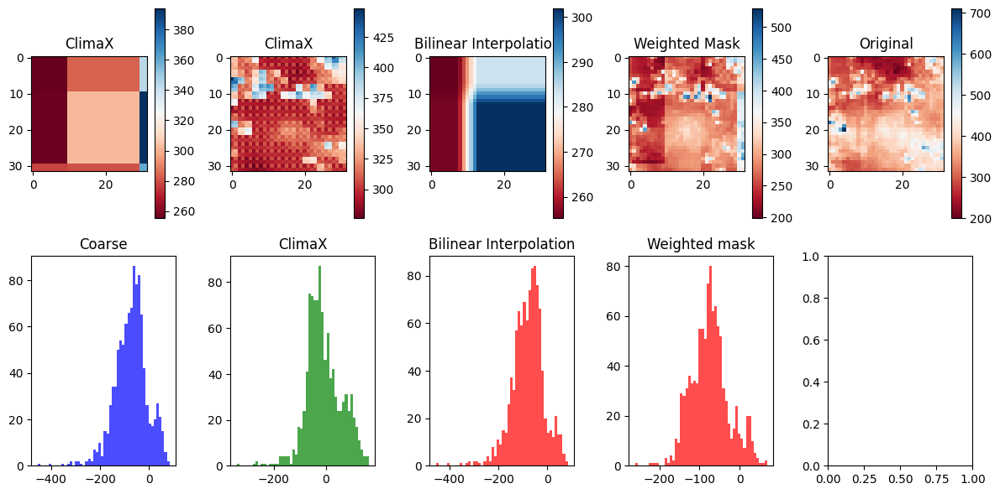

Time step 4
torch.Size([80, 1, 32, 32])


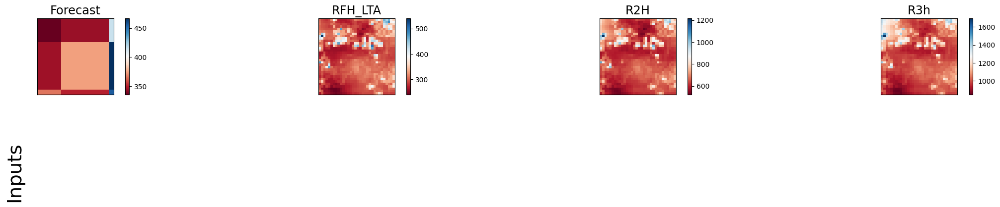

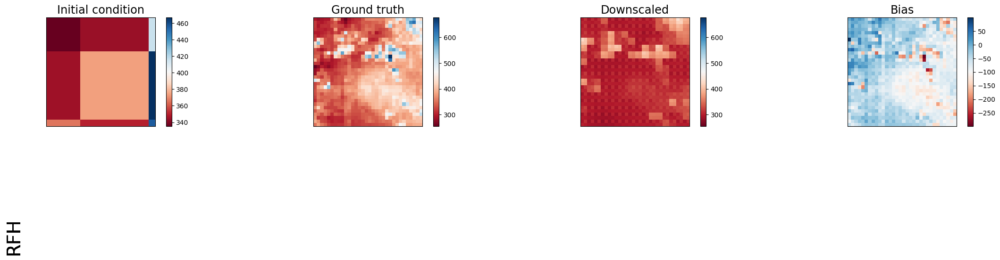

Selected device: cuda:0
+----------------------+---------------------+--------------------+------------------------+---------------------+
|                      | Coarse              | ClimaX             | Bilinear Interpolation | Weighted Mask       |
+----------------------+---------------------+--------------------+------------------------+---------------------+
| lat_weighted_mse_val | 4631.75927734375    | 5610.33740234375   | 3312.1005859375        | 1461.734130859375   |
| lat_weighted_rmse    | 68.0570297241211    | 74.90218353271484  | 57.55085372924805      | 38.23263168334961   |
| spearman             | 0.14703074480651152 | 0.6405379963270413 | 0.3817080885992628     | 0.7595153107367886  |
| mean_bias            | -42.06787109375     | -60.7598876953125  | -20.43597412109375     | -14.705596923828125 |
| pearson              | 0.07118619515579251 | 0.6504372720592542 | 0.30100894315141513    | 0.7841485456977022  |
+----------------------+---------------------+----------

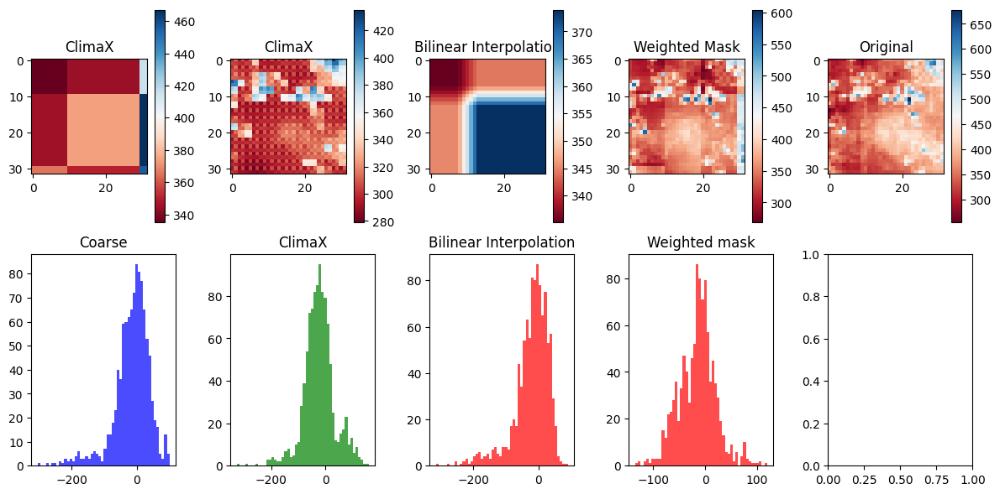

Time step 5
torch.Size([80, 1, 32, 32])


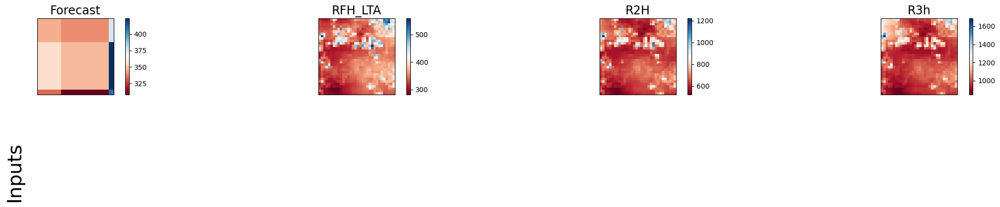

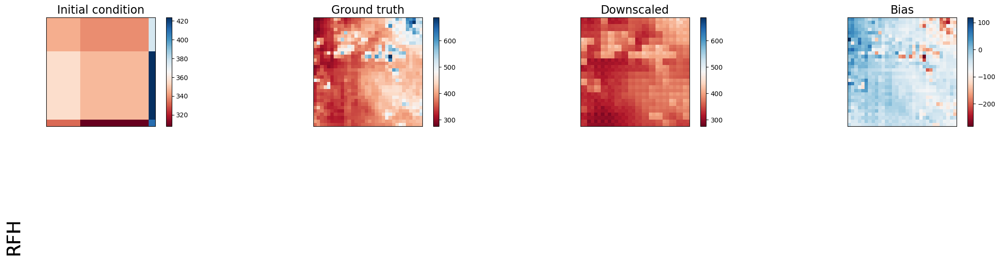

Selected device: cuda:0
+----------------------+---------------------+--------------------+------------------------+--------------------+
|                      | Coarse              | ClimaX             | Bilinear Interpolation | Weighted Mask      |
+----------------------+---------------------+--------------------+------------------------+--------------------+
| lat_weighted_mse_val | 3138.015625         | 3638.1240234375    | 7016.46337890625       | 5182.2939453125    |
| lat_weighted_rmse    | 56.01799392700195   | 60.316864013671875 | 83.76433563232422      | 71.98815155029297  |
| spearman             | 0.41205017135906646 | 0.8257275809257725 | -0.5462793809163015    | 0.4296039499216794 |
| mean_bias            | -28.318511962890625 | -43.3175048828125  | -52.385040283203125    | -50.34942626953125 |
| pearson              | 0.1669496803130352  | 0.8002762150422006 | -0.5564089915750985    | 0.5654414171974371 |
+----------------------+---------------------+------------------

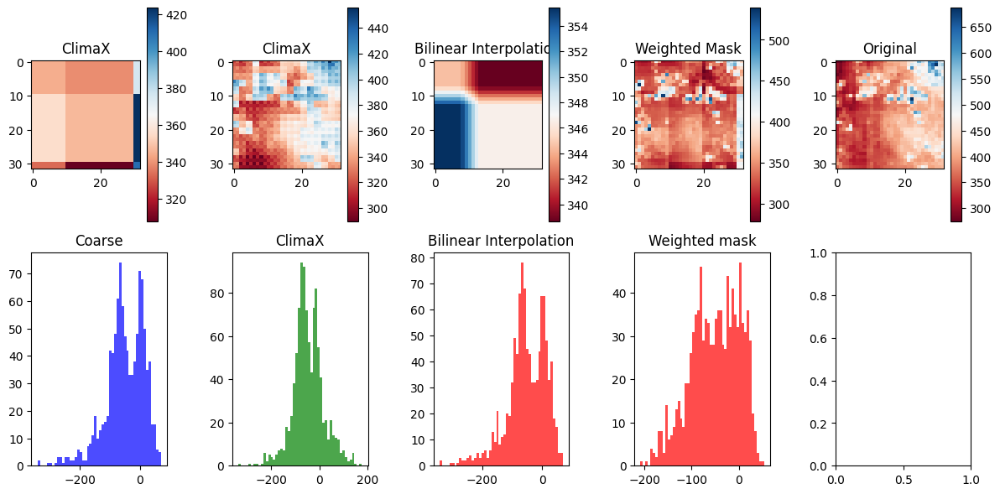

Time step 6
torch.Size([80, 1, 32, 32])


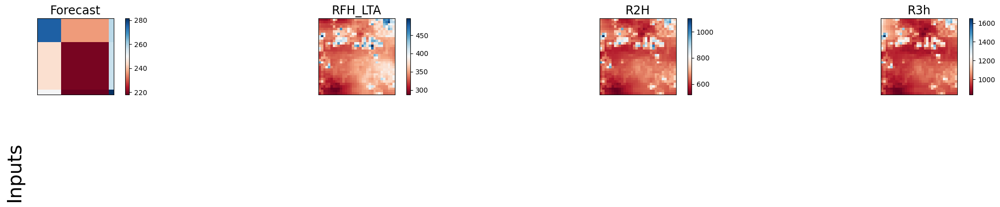

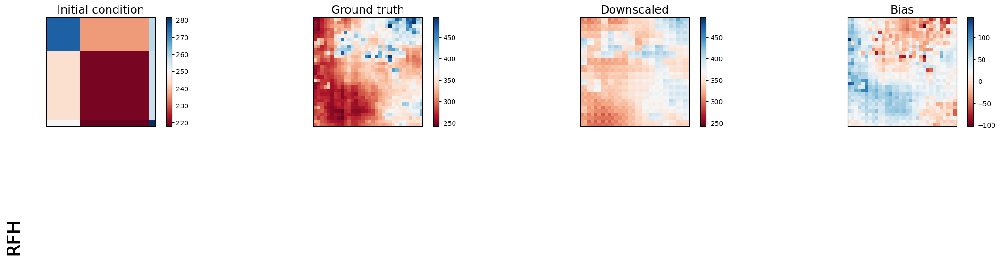

Selected device: cuda:0
+----------------------+---------------------+--------------------+------------------------+---------------------+
|                      | Coarse              | ClimaX             | Bilinear Interpolation | Weighted Mask       |
+----------------------+---------------------+--------------------+------------------------+---------------------+
| lat_weighted_mse_val | 9499.8359375        | 1585.1907958984375 | 11929.94140625         | 11165.767578125     |
| lat_weighted_rmse    | 97.46710205078125   | 39.814453125       | 109.22427368164062     | 105.66819763183594  |
| spearman             | 0.14603523865044    | 0.742459094458644  | -0.2592681803357365    | 0.08502401176634189 |
| mean_bias            | 84.1431884765625    | 22.63494873046875  | -95.26129150390625     | -94.1353759765625   |
| pearson              | 0.11046027969814332 | 0.7489902507460453 | -0.20981502977621316   | 0.24105652703660307 |
+----------------------+---------------------+----------

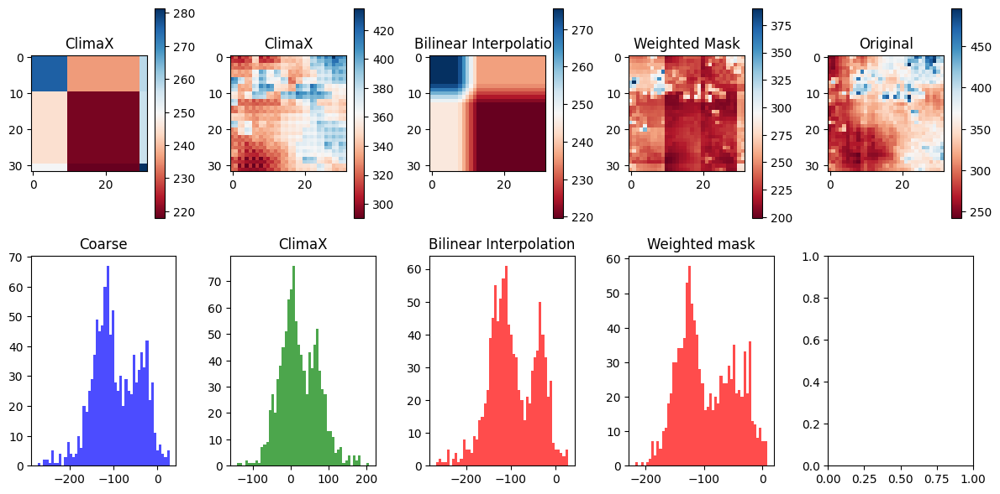

Time step 7
torch.Size([80, 1, 32, 32])


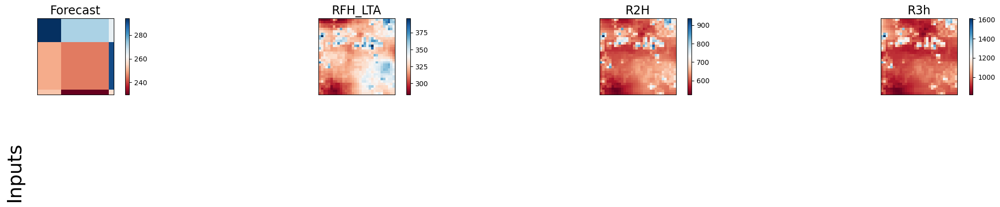

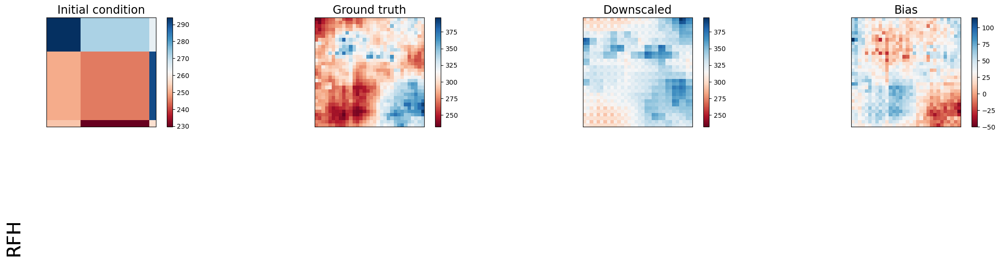

Selected device: cuda:0
+----------------------+---------------------+--------------------+------------------------+---------------------+
|                      | Coarse              | ClimaX             | Bilinear Interpolation | Weighted Mask       |
+----------------------+---------------------+--------------------+------------------------+---------------------+
| lat_weighted_mse_val | 6921.015625         | 1392.4071044921875 | 2984.48193359375       | 2787.484375         |
| lat_weighted_rmse    | 83.19264221191406   | 37.314971923828125 | 54.63041305541992      | 52.796630859375     |
| spearman             | -0.1577795656602548 | 0.7307427922478801 | -0.1062743395275522    | 0.25144096058812493 |
| mean_bias            | 62.42706298828125   | 29.798431396484375 | -41.764617919921875    | -41.52178955078125  |
| pearson              | -0.2468392874858963 | 0.7044318300902259 | -0.03568757953085266   | 0.2633374455095463  |
+----------------------+---------------------+----------

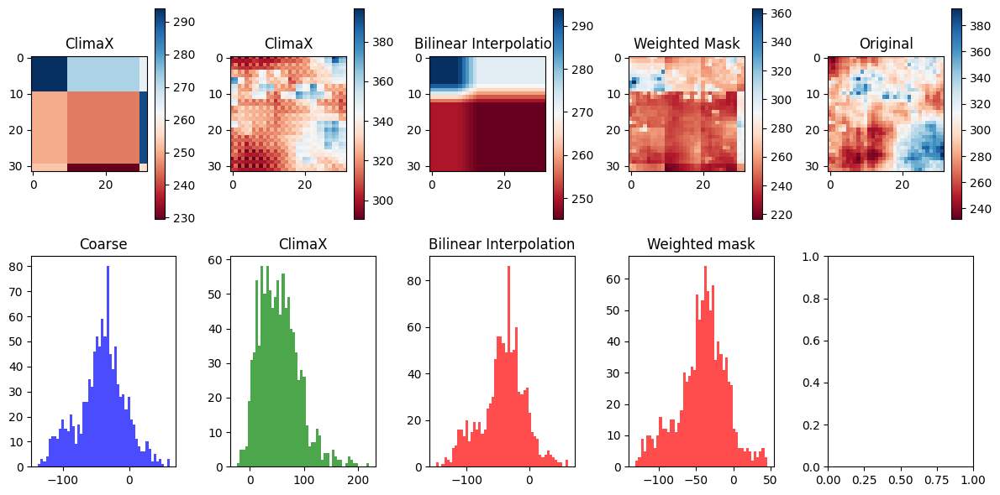

Time step 8
torch.Size([80, 1, 32, 32])


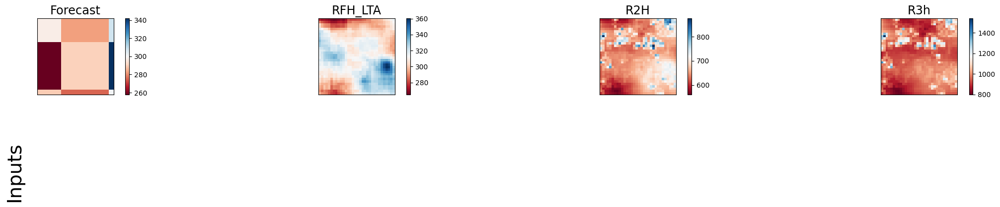

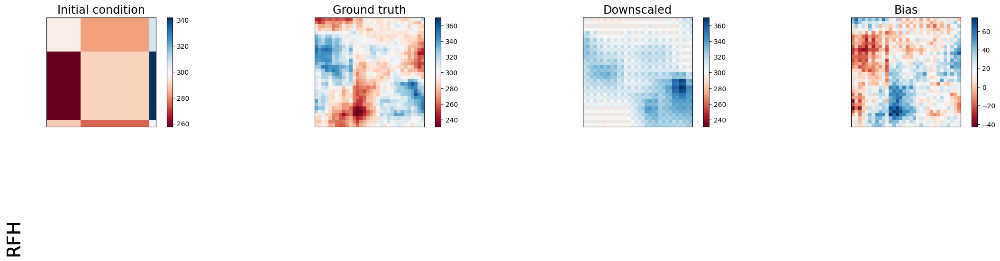

Selected device: cuda:0
+----------------------+----------------------+--------------------+------------------------+---------------------+
|                      | Coarse               | ClimaX             | Bilinear Interpolation | Weighted Mask       |
+----------------------+----------------------+--------------------+------------------------+---------------------+
| lat_weighted_mse_val | 4239.8505859375      | 605.1023559570312  | 1036.896728515625      | 1004.7518310546875  |
| lat_weighted_rmse    | 65.1141357421875     | 24.59882926940918  | 32.20088195800781      | 31.69782066345215   |
| spearman             | -0.20730516580585143 | 0.5946245416899052 | -0.038866871047491806  | 0.14498446758092853 |
| mean_bias            | 35.559906005859375   | 15.718536376953125 | -16.407958984375       | -13.6068115234375   |
| pearson              | -0.22333705596886294 | 0.5996727947257976 | -0.10331288135073559   | 0.15076314947286007 |
+----------------------+----------------------+-

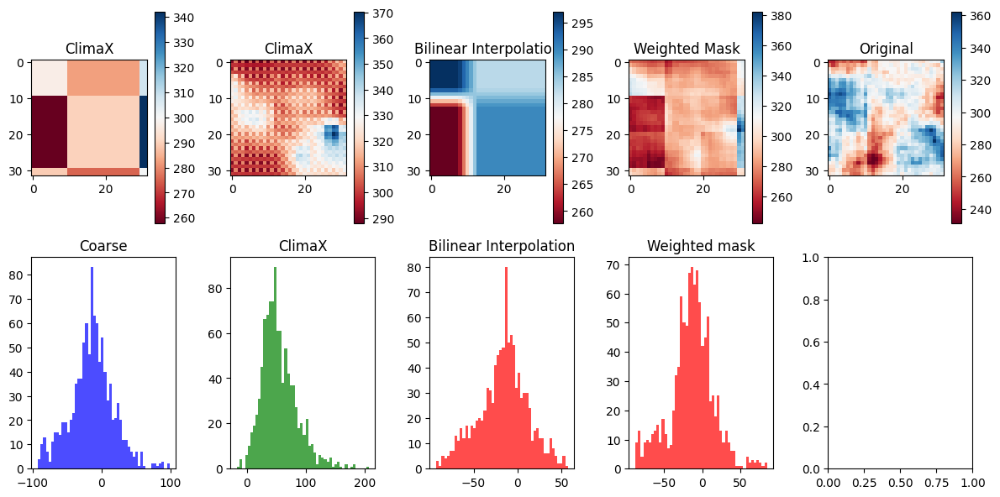

Time step 9
torch.Size([80, 1, 32, 32])


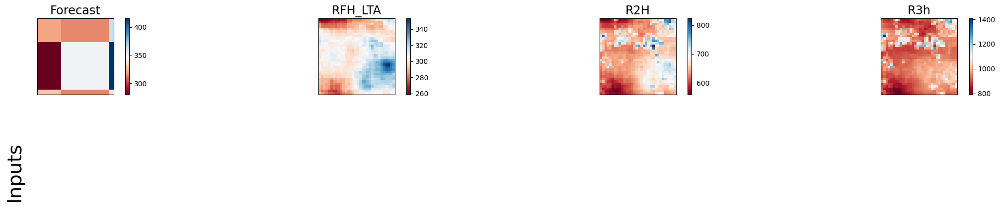

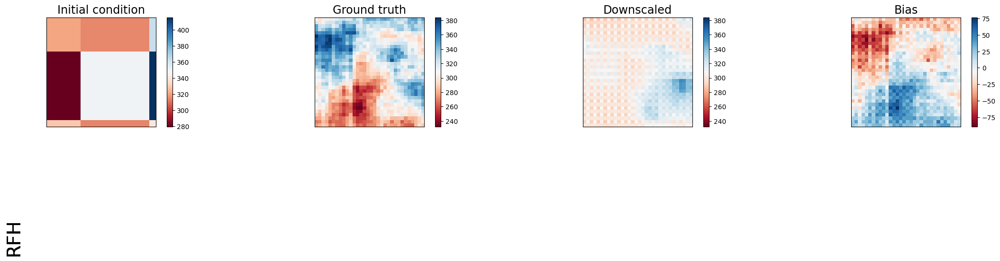

Selected device: cuda:0
+----------------------+----------------------+---------------------+------------------------+-----------------------+
|                      | Coarse               | ClimaX              | Bilinear Interpolation | Weighted Mask         |
+----------------------+----------------------+---------------------+------------------------+-----------------------+
| lat_weighted_mse_val | 3903.955078125       | 953.1279296875      | 1923.7366943359375     | 2277.238037109375     |
| lat_weighted_rmse    | 62.48163604736328    | 30.872770309448242  | 43.86042404174805      | 47.72041702270508     |
| spearman             | -0.20509892274260702 | 0.13823711662196247 | -0.17655792798199038   | -0.038811415037455936 |
| mean_bias            | -7.19403076171875    | -3.54705810546875   | 12.061370849609375     | 16.23992919921875     |
| pearson              | -0.1815098892157803  | 0.1818036826226249  | -0.13789682264720193   | 0.017734773125878782  |
+----------------------+

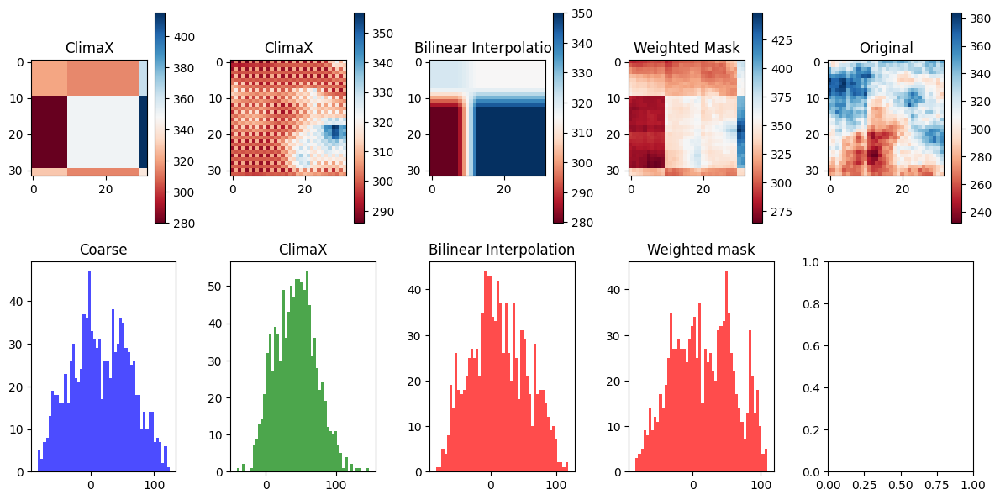

Time step 10
torch.Size([80, 1, 32, 32])


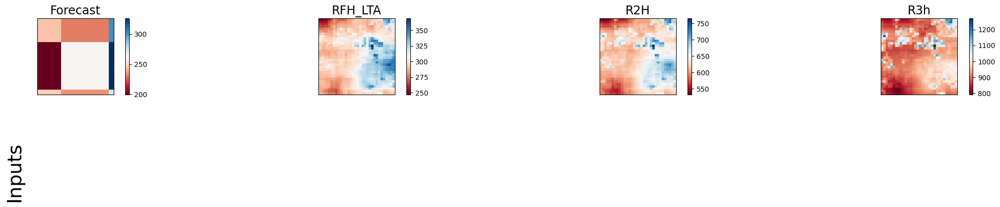

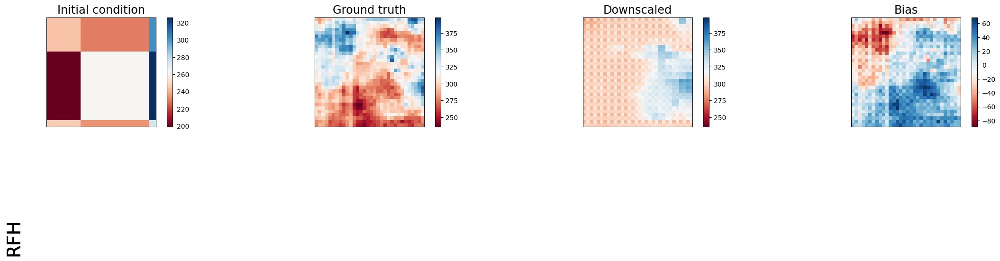

Selected device: cuda:0
+----------------------+----------------------+---------------------+------------------------+----------------------+
|                      | Coarse               | ClimaX              | Bilinear Interpolation | Weighted Mask        |
+----------------------+----------------------+---------------------+------------------------+----------------------+
| lat_weighted_mse_val | 9493.509765625       | 951.890625          | 5873.0830078125        | 5428.85302734375     |
| lat_weighted_rmse    | 97.43464660644531    | 30.852724075317383  | 76.63603973388672      | 73.68074798583984    |
| spearman             | -0.14831443419769344 | 0.08772785149340803 | -0.16227185510730877   | 0.019382232878385048 |
| mean_bias            | 76.62774658203125    | 4.36370849609375    | -66.21406555175781     | -61.52326965332031   |
| pearson              | -0.1571424141569217  | 0.17813159866308675 | -0.104567723671904     | 0.09987538153181925  |
+----------------------+--------

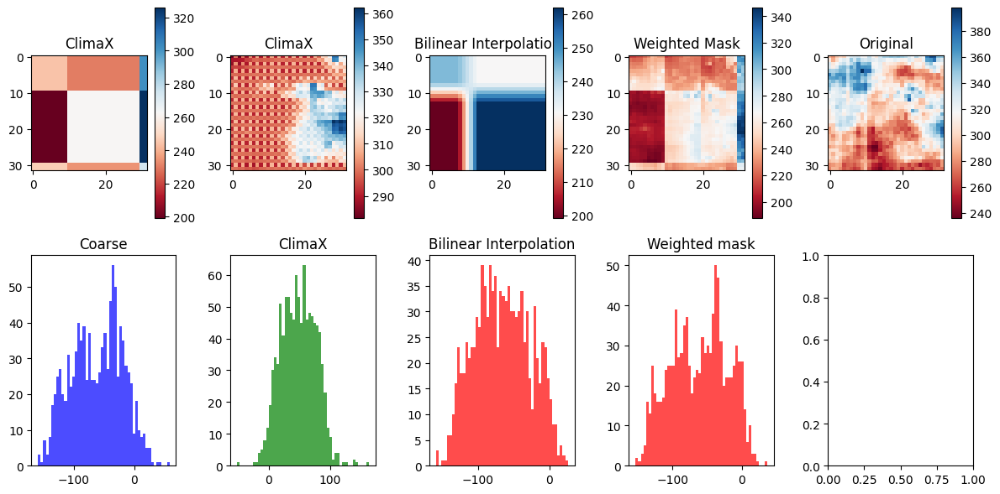

Time step 11
torch.Size([80, 1, 32, 32])


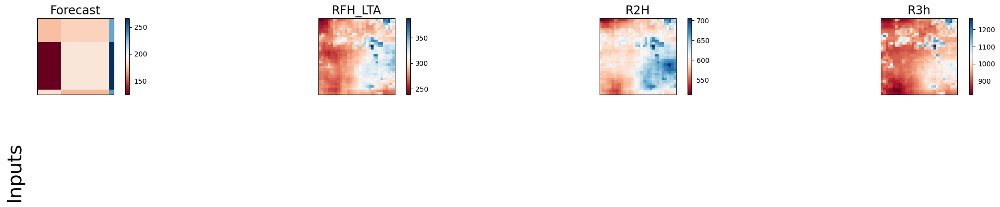

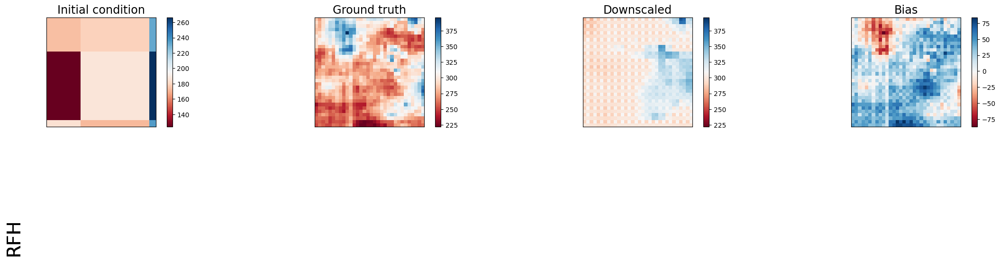

Selected device: cuda:0
+----------------------+----------------------+--------------------+------------------------+---------------------+
|                      | Coarse               | ClimaX             | Bilinear Interpolation | Weighted Mask       |
+----------------------+----------------------+--------------------+------------------------+---------------------+
| lat_weighted_mse_val | 25149.599609375      | 1195.38037109375   | 14797.2998046875       | 13684.810546875     |
| lat_weighted_rmse    | 158.5862579345703    | 34.57427215576172  | 121.64414978027344     | 116.98209381103516  |
| spearman             | -0.24771437897984272 | 0.2567337796022708 | 0.09280326633934026    | 0.30881754451972193 |
| mean_bias            | 145.29779052734375   | 20.436248779296875 | -117.23213195800781    | -111.59368896484375 |
| pearson              | -0.2633522519678676  | 0.3118413166346607 | 0.21669401753527223    | 0.3411663146893893  |
+----------------------+----------------------+-

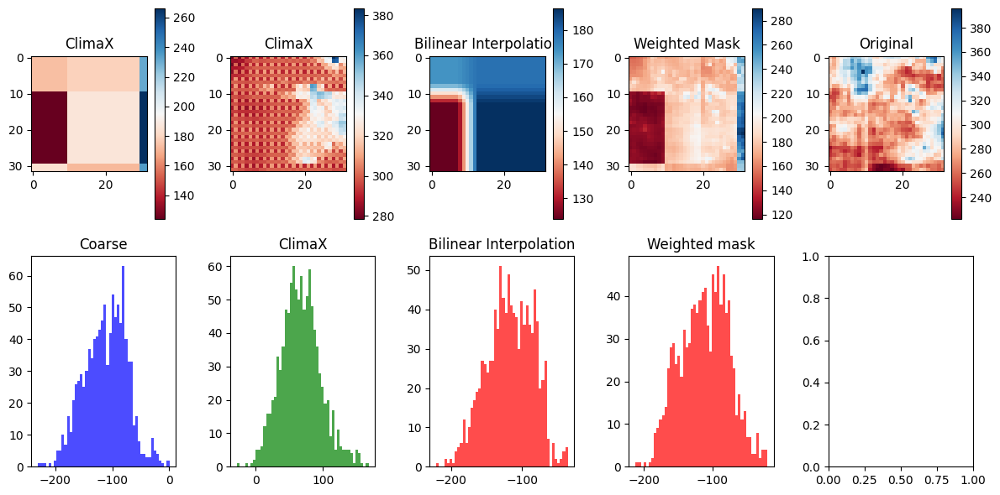

Time step 12
torch.Size([80, 1, 32, 32])


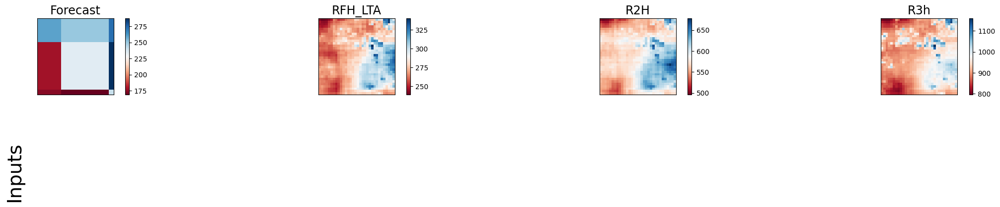

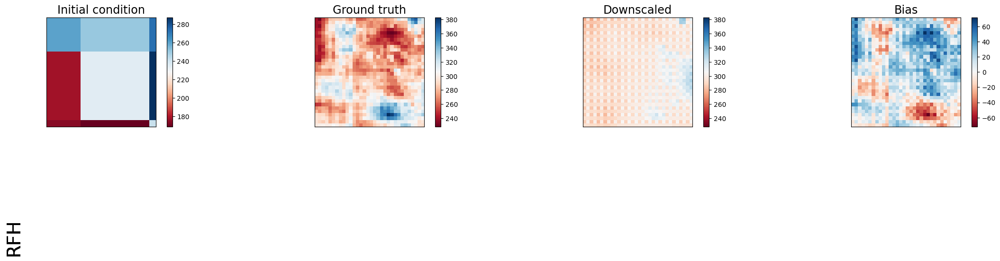

Selected device: cuda:0
+----------------------+---------------------+---------------------+------------------------+----------------------+
|                      | Coarse              | ClimaX              | Bilinear Interpolation | Weighted Mask        |
+----------------------+---------------------+---------------------+------------------------+----------------------+
| lat_weighted_mse_val | 13222.8837890625    | 674.05712890625     | 4930.240234375         | 5197.5986328125      |
| lat_weighted_rmse    | 114.99079895019531  | 25.962610244750977  | 70.21566772460938      | 72.09437561035156    |
| spearman             | -0.4438247908306061 | 0.15303639155054302 | -0.2076630034614612    | 0.044429791886410726 |
| mean_bias            | 91.99259948730469   | 10.40997314453125   | -59.41130065917969     | -59.607818603515625  |
| pearson              | -0.4530392328887519 | 0.23026103220058416 | -0.11872281191155913   | 0.04946456012896088  |
+----------------------+----------------

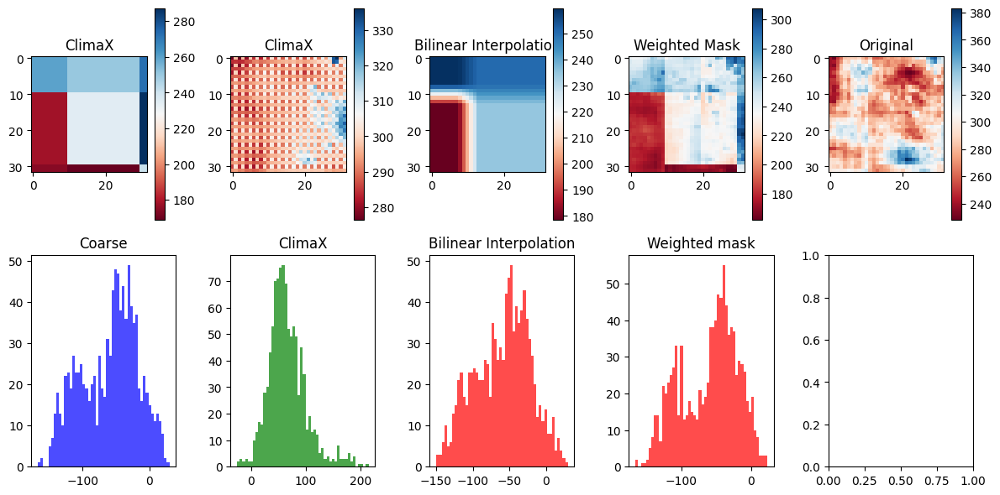

Time step 13
torch.Size([80, 1, 32, 32])


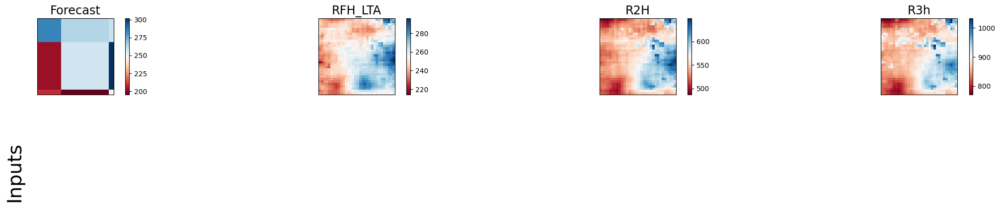

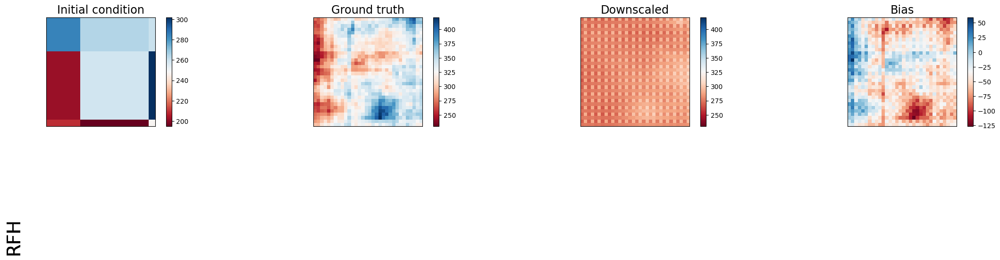

Selected device: cuda:0
+----------------------+----------------------+--------------------+------------------------+---------------------+
|                      | Coarse               | ClimaX             | Bilinear Interpolation | Weighted Mask       |
+----------------------+----------------------+--------------------+------------------------+---------------------+
| lat_weighted_mse_val | 9423.8798828125      | 2396.1845703125    | 6326.5205078125        | 6571.9619140625     |
| lat_weighted_rmse    | 97.07666778564453    | 48.95083999633789  | 79.5394287109375       | 81.06763458251953   |
| spearman             | -0.4778274368190282  | 0.3527772973448323 | 0.19660287321954187    | 0.3690262037492342  |
| mean_bias            | 70.71861267089844    | -39.9345703125     | -72.95664978027344     | -73.7410888671875   |
| pearson              | -0.44074653808623765 | 0.3687877934166549 | 0.34465585524745224    | 0.39109187270416806 |
+----------------------+----------------------+-

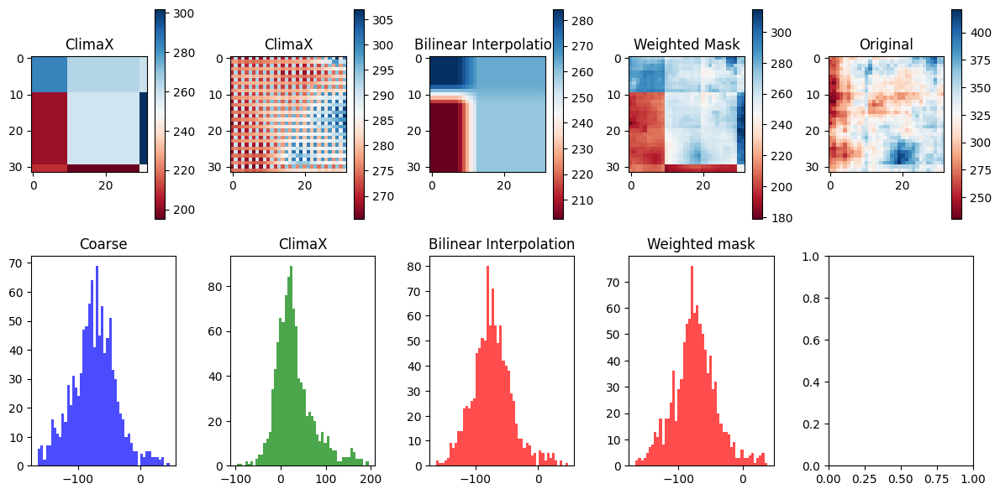

Time step 14
torch.Size([80, 1, 32, 32])


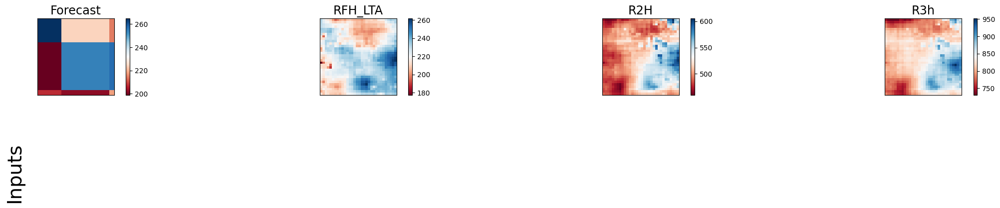

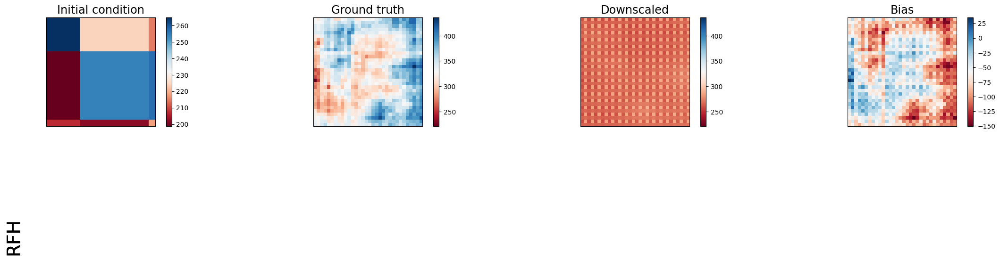

Selected device: cuda:0
+----------------------+----------------------+---------------------+------------------------+---------------------+
|                      | Coarse               | ClimaX              | Bilinear Interpolation | Weighted Mask       |
+----------------------+----------------------+---------------------+------------------------+---------------------+
| lat_weighted_mse_val | 10835.40234375       | 5831.509765625      | 11719.375              | 12111.4482421875    |
| lat_weighted_rmse    | 104.0932388305664    | 76.36431884765625   | 108.25606536865234     | 110.0520248413086   |
| spearman             | -0.287110138477796   | 0.2080618004963599  | 0.3290186206885977     | 0.38916463366411697 |
| mean_bias            | 85.52595520019531    | -69.174560546875    | -103.52587890625       | -105.13043212890625 |
| pearson              | -0.27550767900990286 | 0.15089019952738741 | 0.36295056957420385    | 0.395529745108569   |
+----------------------+----------------

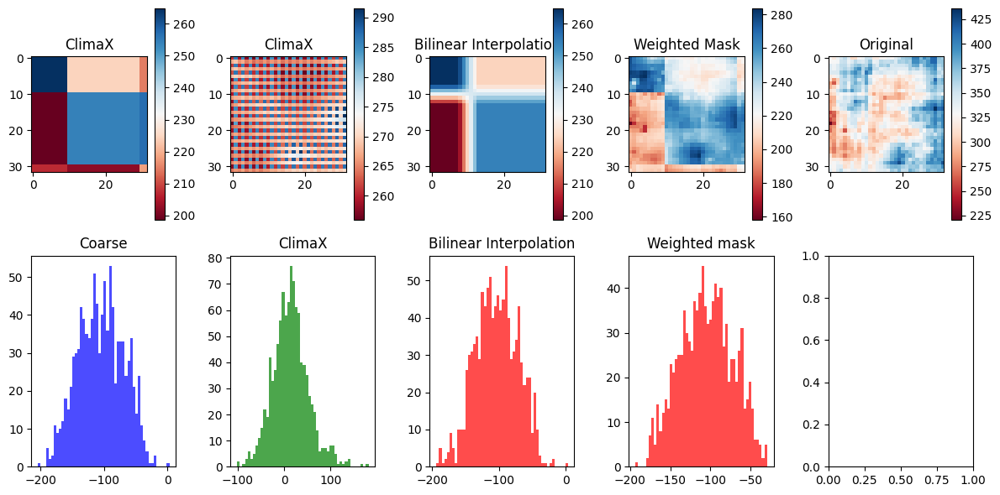

Time step 15
torch.Size([80, 1, 32, 32])


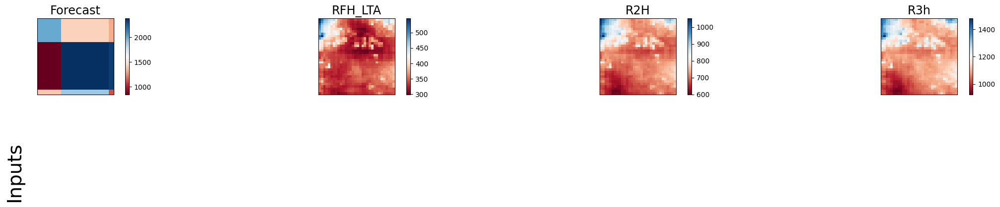

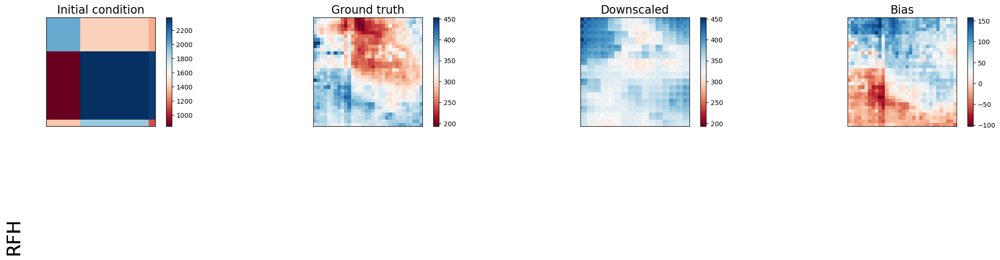

Selected device: cuda:0
+----------------------+---------------------+---------------------+------------------------+---------------------+
|                      | Coarse              | ClimaX              | Bilinear Interpolation | Weighted Mask       |
+----------------------+---------------------+---------------------+------------------------+---------------------+
| lat_weighted_mse_val | 2546482.5           | 3489.82470703125    | 2477921.0              | 2555572.0           |
| lat_weighted_rmse    | 1595.7701416015625  | 59.074737548828125  | 1574.141357421875      | 1598.6156005859375  |
| spearman             | -0.2493876364954797 | 0.2318690763709475  | -0.17071377910793542   | -0.1291282338092044 |
| mean_bias            | -1472.795654296875  | 33.259552001953125  | 1466.0693359375        | 1472.7957763671875  |
| pearson              | -0.2099365846847267 | 0.25064326833457207 | -0.19463263915835105   | -0.1481083296742913 |
+----------------------+---------------------+--

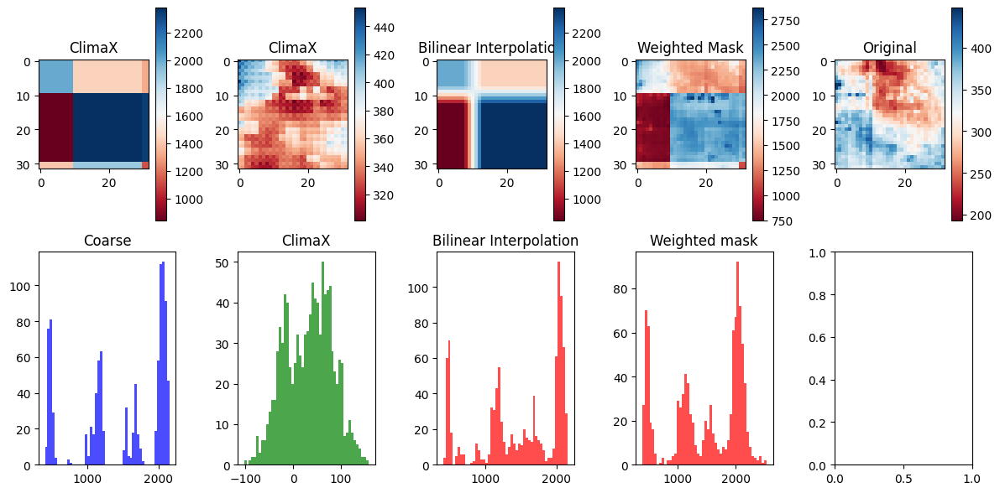

Time step 16
torch.Size([80, 1, 32, 32])


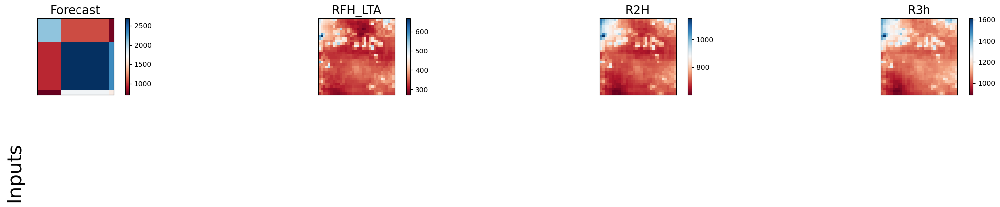

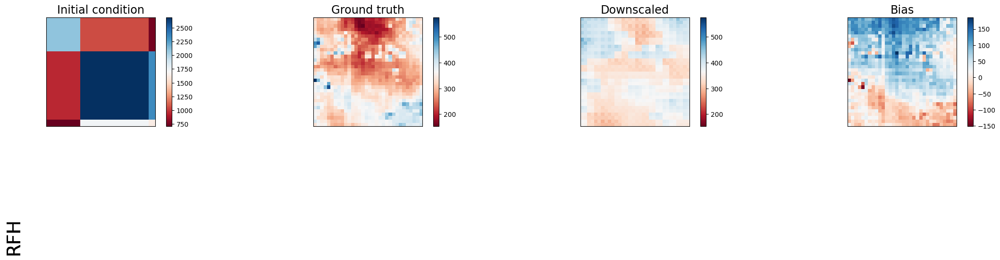

Selected device: cuda:0
+----------------------+----------------------+--------------------+------------------------+---------------------+
|                      | Coarse               | ClimaX             | Bilinear Interpolation | Weighted Mask       |
+----------------------+----------------------+--------------------+------------------------+---------------------+
| lat_weighted_mse_val | 2929911.0            | 4708.208984375     | 2926223.5              | 2952328.25          |
| lat_weighted_rmse    | 1711.6982421875      | 68.61638641357422  | 1710.620849609375      | 1718.2340087890625  |
| spearman             | -0.23116602163204103 | 0.4216891397995839 | 0.11193773671839259    | 0.17604276096638208 |
| mean_bias            | -1517.963134765625   | 42.7391357421875   | 1556.686279296875      | 1522.152587890625   |
| pearson              | -0.08261434871952647 | 0.4605615954065219 | 0.1711656477952038     | 0.19639039779979575 |
+----------------------+----------------------+-

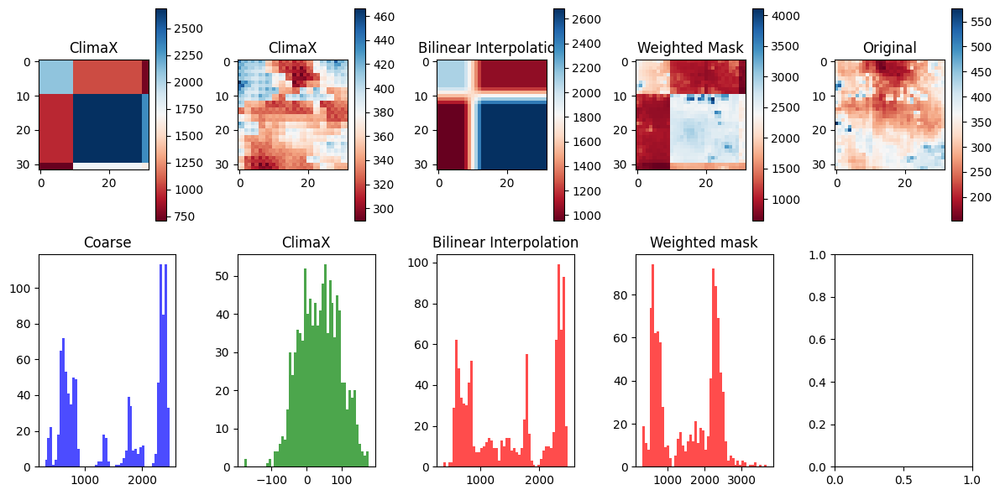

Time step 17
torch.Size([80, 1, 32, 32])


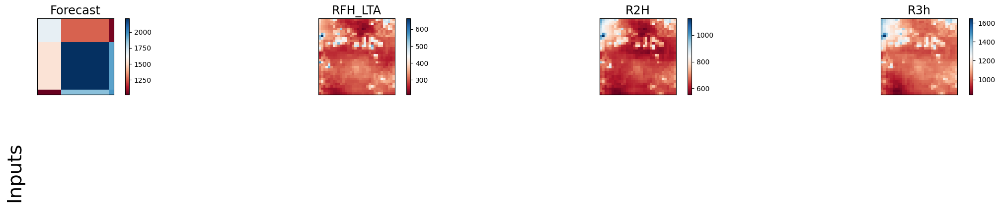

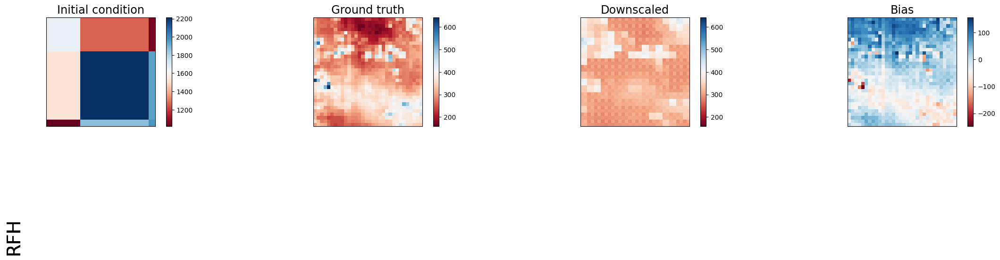

Selected device: cuda:0
+----------------------+----------------------+---------------------+------------------------+--------------------+
|                      | Coarse               | ClimaX              | Bilinear Interpolation | Weighted Mask      |
+----------------------+----------------------+---------------------+------------------------+--------------------+
| lat_weighted_mse_val | 2262261.25           | 3236.530517578125   | 2296308.75             | 2303998.5          |
| lat_weighted_rmse    | 1504.08154296875     | 56.8905143737793    | 1515.357666015625      | 1517.892822265625  |
| spearman             | 0.041188593527771454 | 0.47373256441918227 | 0.3823628552613586     | 0.6257189700938481 |
| mean_bias            | -1449.3399658203125  | 9.696075439453125   | 1475.5679931640625     | 1455.0118408203125 |
| pearson              | 0.0708864906857378   | 0.46435123532498124 | 0.36896371244282977    | 0.6471941774862187 |
+----------------------+----------------------+-

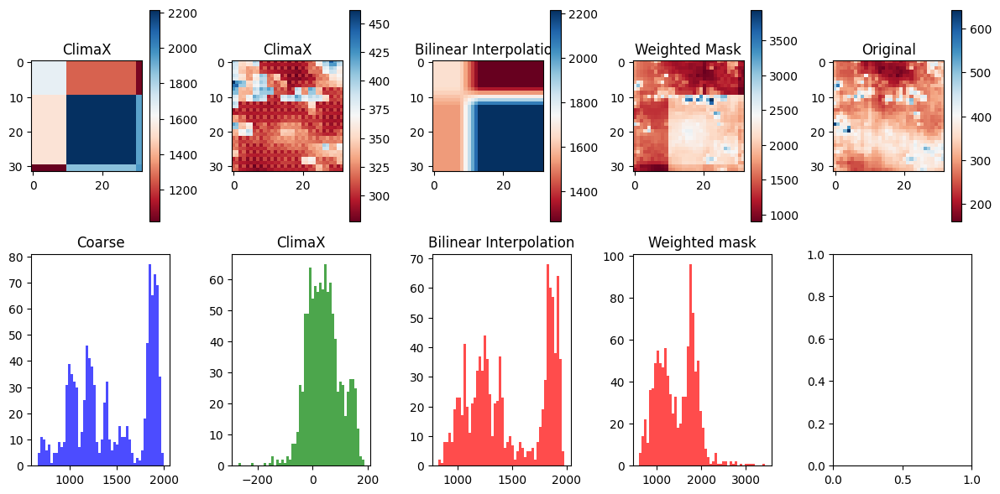

Time step 18
torch.Size([80, 1, 32, 32])


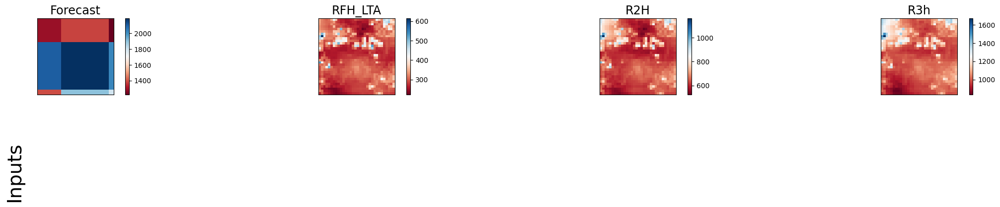

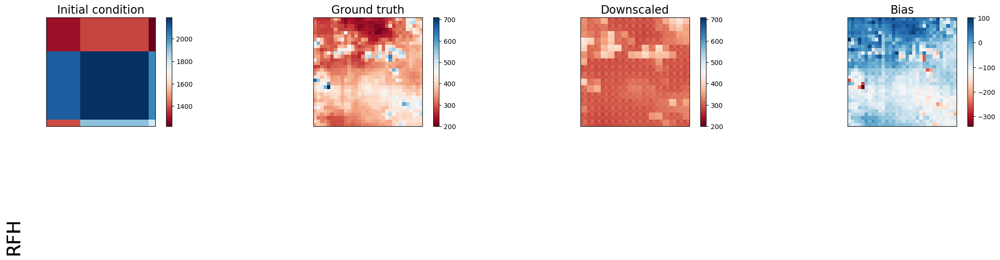

Selected device: cuda:0
+----------------------+---------------------+---------------------+------------------------+--------------------+
|                      | Coarse              | ClimaX              | Bilinear Interpolation | Weighted Mask      |
+----------------------+---------------------+---------------------+------------------------+--------------------+
| lat_weighted_mse_val | 2544485.25          | 5660.19384765625    | 2449629.0              | 2446878.5          |
| lat_weighted_rmse    | 1595.144287109375   | 75.23426055908203   | 1565.1290283203125     | 1564.2501220703125 |
| spearman             | 0.11240353907210347 | 0.42258173618034844 | 0.48651743852503454    | 0.7376659122124866 |
| mean_bias            | -1552.11181640625   | -45.070068359375    | 1528.5771484375        | 1510.79931640625   |
| pearson              | 0.3083448114508842  | 0.4321914750608752  | 0.4356863307612362     | 0.7543680499067245 |
+----------------------+---------------------+----------

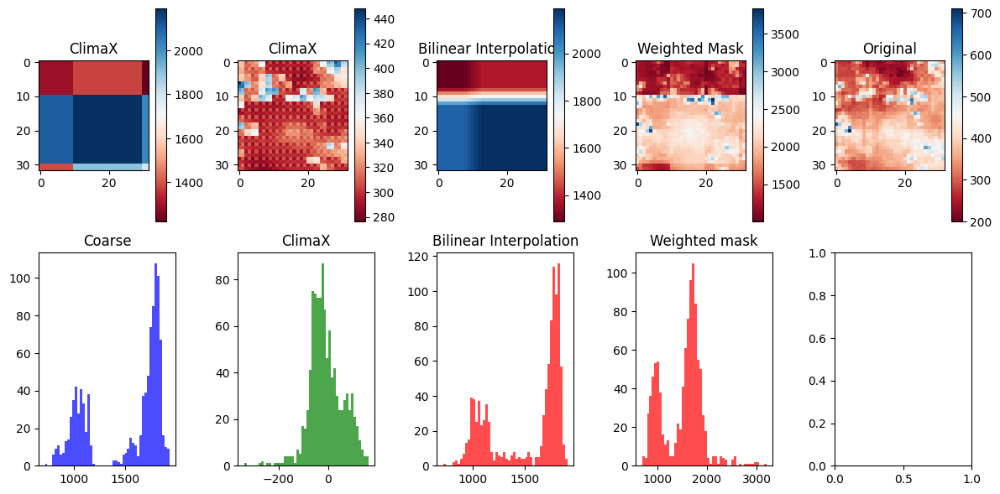

Time step 19
torch.Size([80, 1, 32, 32])


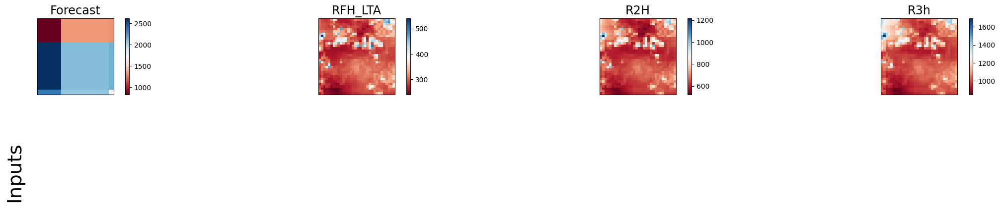

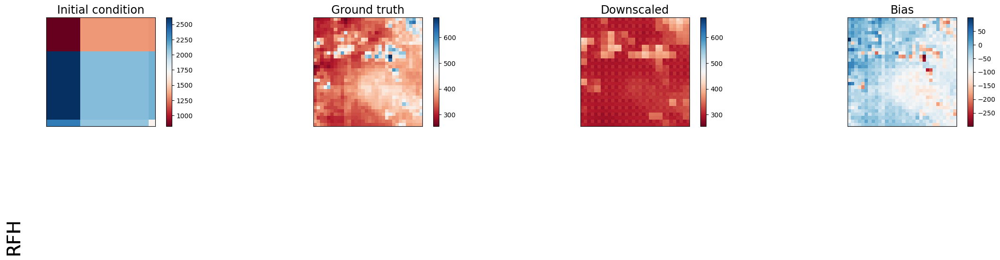

Selected device: cuda:0
+----------------------+---------------------+--------------------+------------------------+---------------------+
|                      | Coarse              | ClimaX             | Bilinear Interpolation | Weighted Mask       |
+----------------------+---------------------+--------------------+------------------------+---------------------+
| lat_weighted_mse_val | 2827709.75          | 5610.33740234375   | 2621398.0              | 2706373.25          |
| lat_weighted_rmse    | 1681.57958984375    | 74.90218353271484  | 1619.0732421875        | 1645.1058349609375  |
| spearman             | 0.4583034876019553  | 0.6405384228120792 | -0.13587567622176677   | 0.10922591462237133 |
| mean_bias            | -1594.7728271484375 | -60.7598876953125  | 1526.2244873046875     | 1537.9993896484375  |
| pearson              | 0.43518703238993667 | 0.6504372589012695 | -0.08288566139914463   | 0.213418610186593   |
+----------------------+---------------------+----------

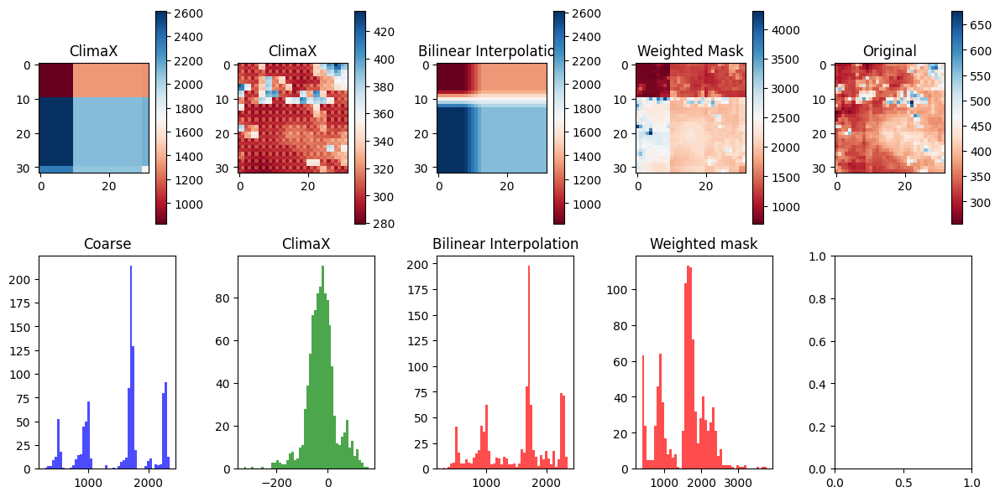

Time step 20
torch.Size([80, 1, 32, 32])


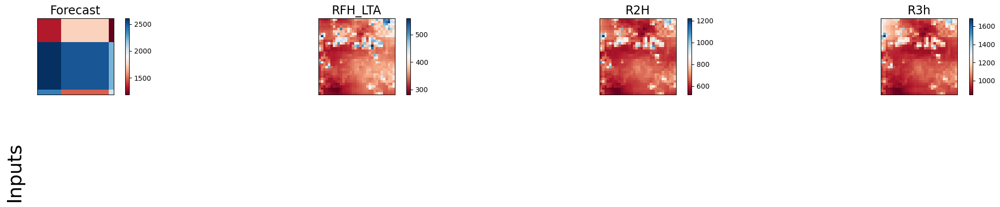

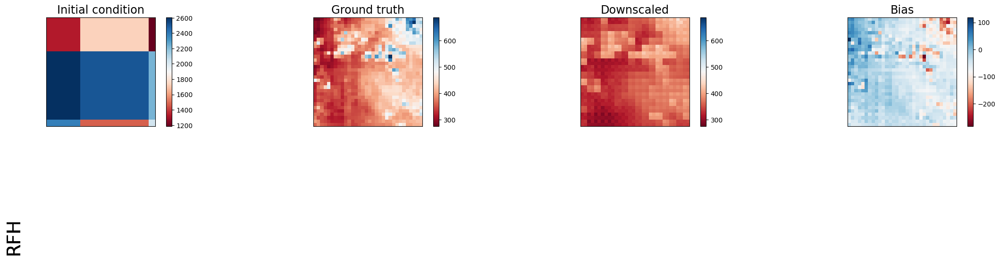

Selected device: cuda:0
+----------------------+---------------------+--------------------+------------------------+---------------------+
|                      | Coarse              | ClimaX             | Bilinear Interpolation | Weighted Mask       |
+----------------------+---------------------+--------------------+------------------------+---------------------+
| lat_weighted_mse_val | 3660956.75          | 3638.1240234375    | 3526232.5              | 3424275.5           |
| lat_weighted_rmse    | 1913.3626708984375  | 60.316864013671875 | 1877.8265380859375     | 1850.4798583984375  |
| spearman             | 0.36120394061862615 | 0.8257288275532084 | -0.3316820235542862    | 0.02886226037646625 |
| mean_bias            | -1856.1923828125    | -43.3175048828125  | 1825.417236328125      | 1777.5244140625     |
| pearson              | 0.2650708147100162  | 0.8002762059251503 | -0.17243566668374183   | 0.09167283509912003 |
+----------------------+---------------------+----------

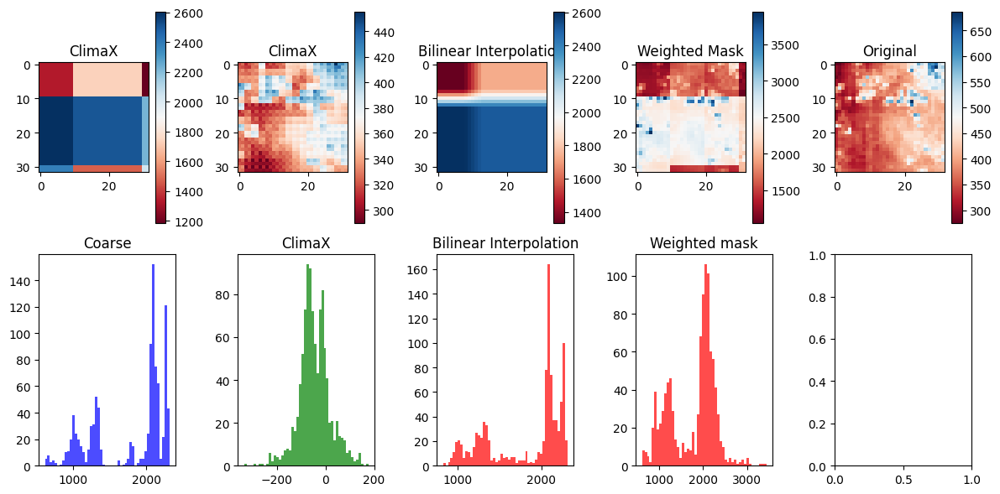

Time step 21
torch.Size([80, 1, 32, 32])


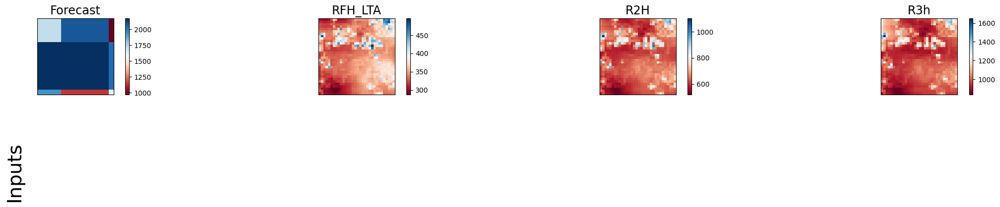

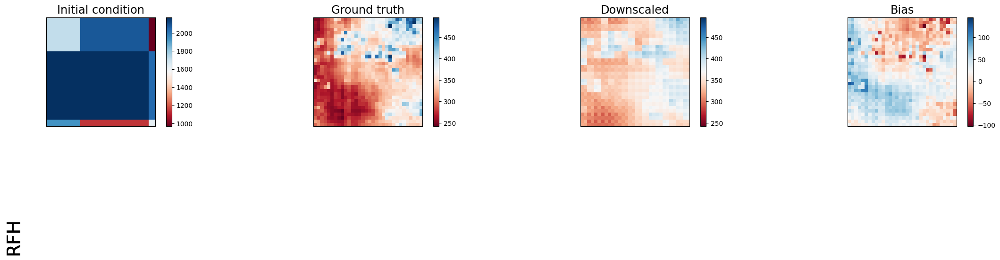

Selected device: cuda:0
+----------------------+-----------------------+--------------------+------------------------+---------------------+
|                      | Coarse                | ClimaX             | Bilinear Interpolation | Weighted Mask       |
+----------------------+-----------------------+--------------------+------------------------+---------------------+
| lat_weighted_mse_val | 3010037.0             | 1585.19091796875   | 3148940.5              | 2988399.5           |
| lat_weighted_rmse    | 1734.94580078125      | 39.814456939697266 | 1774.525390625         | 1728.69873046875    |
| spearman             | -0.013672232401039276 | 0.742459094458644  | -0.11951650328325215   | 0.11672574059664159 |
| mean_bias            | -1711.712158203125    | 22.63494873046875  | 1769.0810546875        | 1701.7197265625     |
| pearson              | -0.0967488035128044   | 0.7489902430712267 | -0.043630510560892975  | 0.18048306483816168 |
+----------------------+----------------

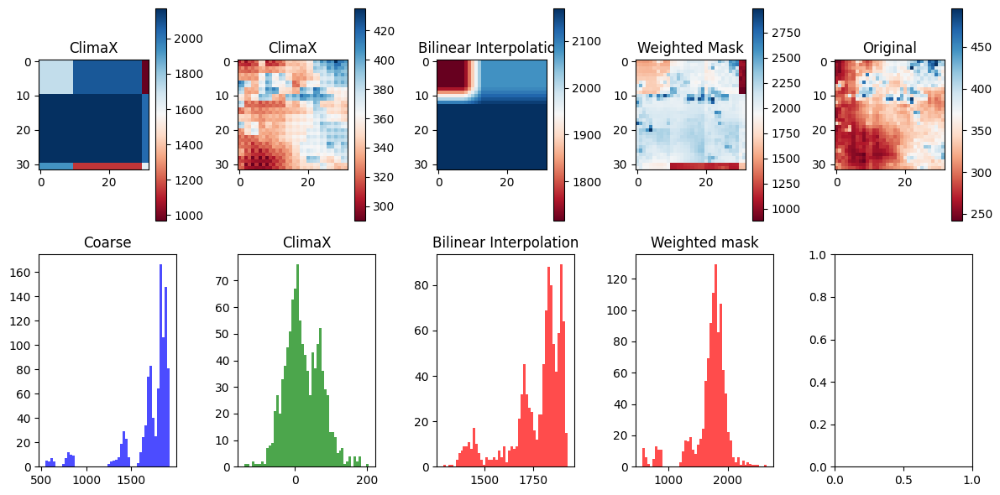

Time step 22
torch.Size([80, 1, 32, 32])


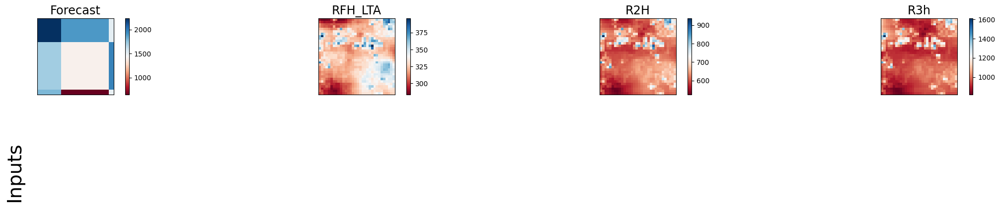

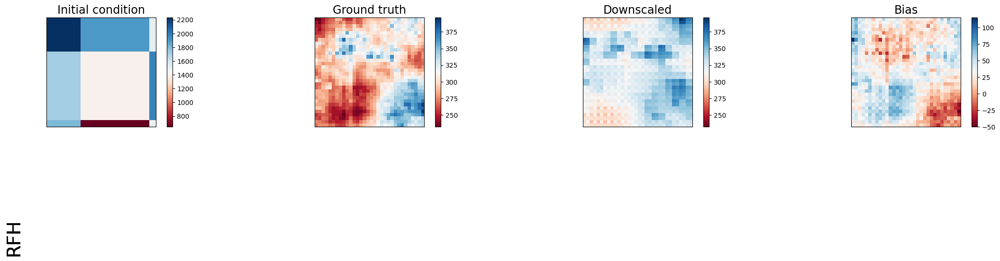

Selected device: cuda:0
+----------------------+----------------------+--------------------+------------------------+-----------------------+
|                      | Coarse               | ClimaX             | Bilinear Interpolation | Weighted Mask         |
+----------------------+----------------------+--------------------+------------------------+-----------------------+
| lat_weighted_mse_val | 1874637.25           | 1392.4071044921875 | 1962149.375            | 1929759.0             |
| lat_weighted_rmse    | 1369.1739501953125   | 37.314971923828125 | 1400.7674560546875     | 1389.15771484375      |
| spearman             | -0.15102495142621536 | 0.7307427922478801 | -0.14197831644390863   | 0.04818240905150177   |
| mean_bias            | -1324.4368896484375  | 29.798431396484375 | 1375.14697265625       | 1345.3421630859375    |
| pearson              | -0.1714379236070538  | 0.704431813919053  | -0.1607820810352969    | -0.017797693682643848 |
+----------------------+--------

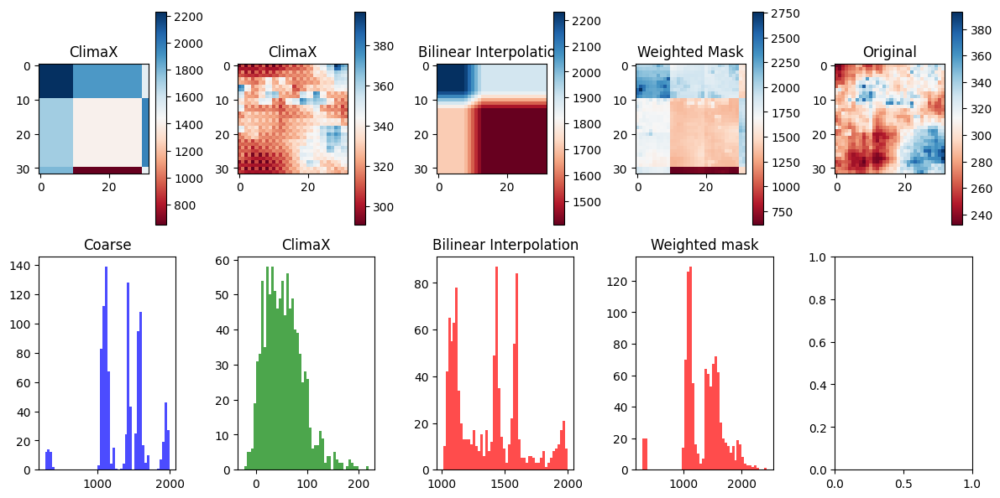

Time step 23
torch.Size([80, 1, 32, 32])


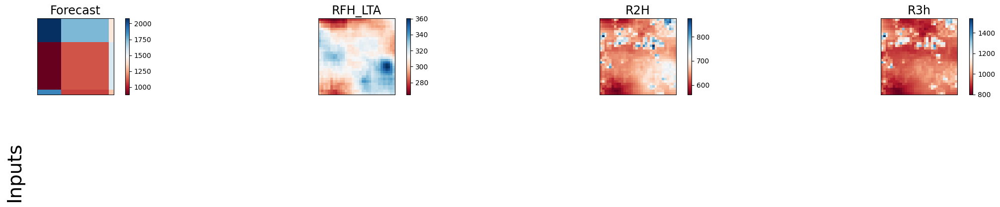

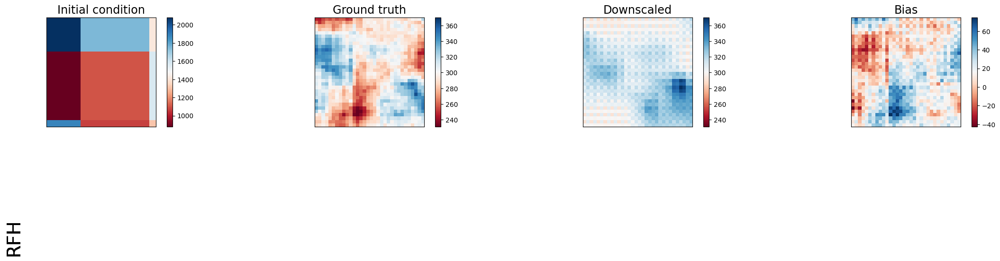

Selected device: cuda:0
+----------------------+----------------------+--------------------+------------------------+----------------------+
|                      | Coarse               | ClimaX             | Bilinear Interpolation | Weighted Mask        |
+----------------------+----------------------+--------------------+------------------------+----------------------+
| lat_weighted_mse_val | 1176168.875          | 605.102294921875   | 1161508.25             | 1207190.0            |
| lat_weighted_rmse    | 1084.51318359375     | 24.598827362060547 | 1077.73291015625       | 1098.721923828125    |
| spearman             | -0.46799073124814394 | 0.5946230730431409 | -0.05449630550948634   | -0.02560237258563916 |
| mean_bias            | -999.578125          | 15.718536376953125 | 1006.9844970703125     | 1021.53125           |
| pearson              | -0.3843363004008765  | 0.5996728004371825 | -0.044068447855890924  | -0.01613993151150624 |
+----------------------+----------------

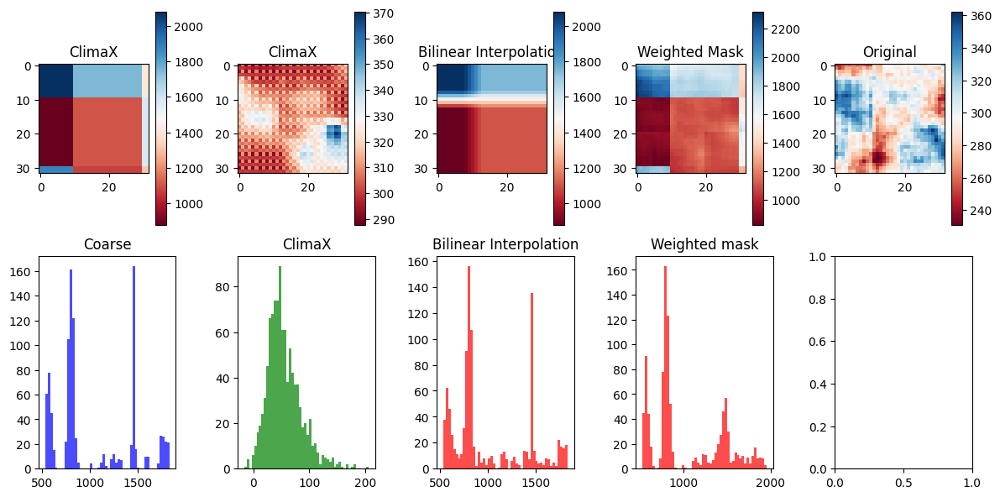

Time step 24
torch.Size([80, 1, 32, 32])


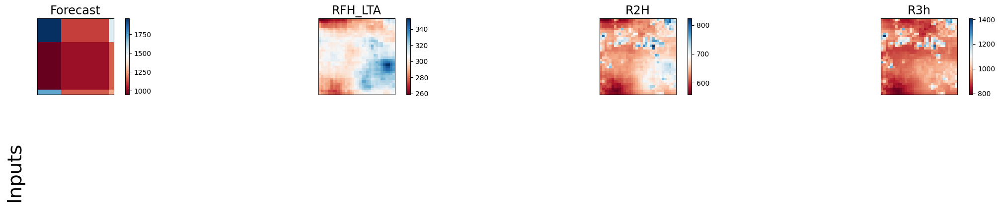

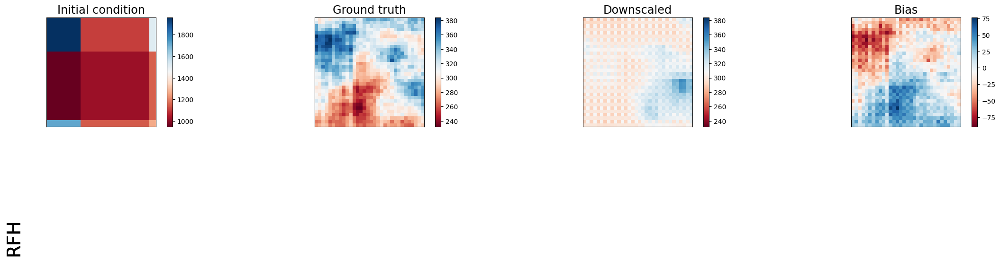

Selected device: cuda:0
+----------------------+----------------------+---------------------+------------------------+---------------------+
|                      | Coarse               | ClimaX              | Bilinear Interpolation | Weighted Mask       |
+----------------------+----------------------+---------------------+------------------------+---------------------+
| lat_weighted_mse_val | 778342.3125          | 953.1279296875      | 731813.75              | 784799.625          |
| lat_weighted_rmse    | 882.2371215820312    | 30.872770309448242  | 855.4611206054688      | 885.88916015625     |
| spearman             | -0.30668781401435413 | 0.13823578979805554 | 0.525164927917115      | 0.3052387580503713  |
| mean_bias            | -828.681884765625    | -3.54705810546875   | 816.3375244140625      | 837.727783203125    |
| pearson              | -0.06639500087264381 | 0.1818036446454011  | 0.5144729577786984     | 0.39116704061256313 |
+----------------------+----------------

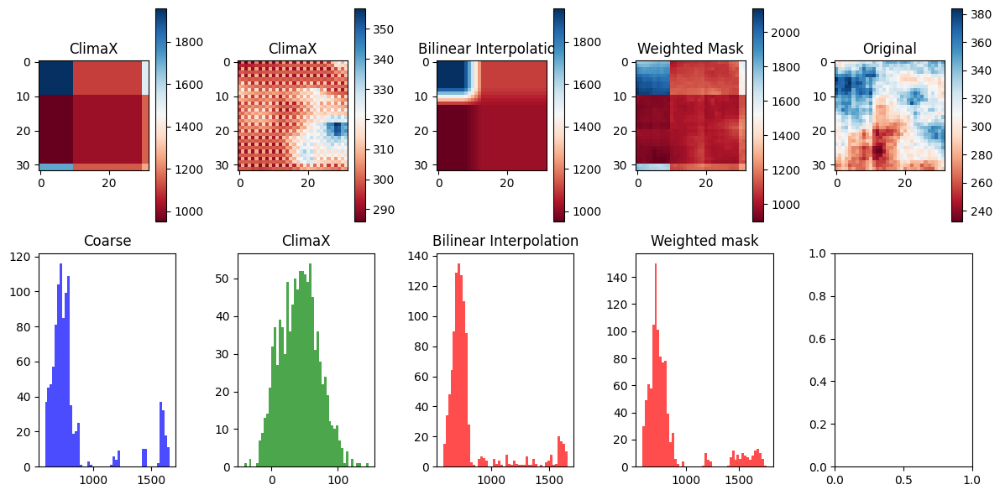

Time step 25
torch.Size([80, 1, 32, 32])


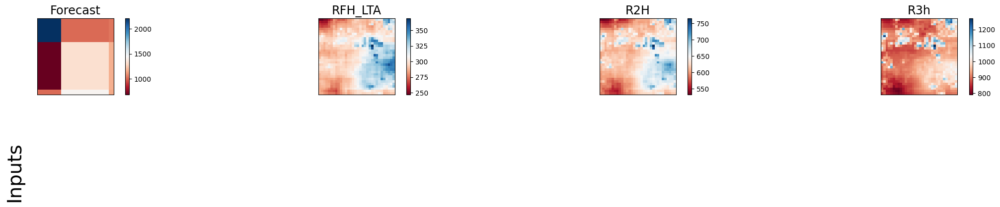

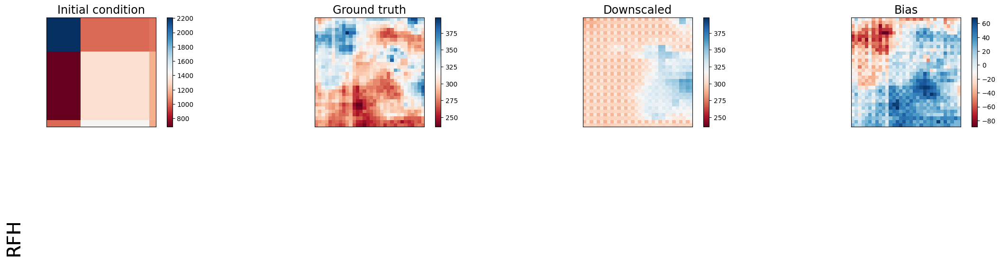

Selected device: cuda:0
+----------------------+----------------------+---------------------+------------------------+----------------------+
|                      | Coarse               | ClimaX              | Bilinear Interpolation | Weighted Mask        |
+----------------------+----------------------+---------------------+------------------------+----------------------+
| lat_weighted_mse_val | 968364.25            | 951.890625          | 958116.6875            | 984036.0             |
| lat_weighted_rmse    | 984.0549926757812    | 30.852724075317383  | 978.8343505859375      | 991.9859008789062    |
| spearman             | -0.1573854409115595  | 0.08773150927502699 | 0.1717927332566905     | 0.058942460210219205 |
| mean_bias            | -890.3619384765625   | 4.36370849609375    | 905.6219482421875      | 905.4664306640625    |
| pearson              | -0.16500060133984018 | 0.17813159258345934 | 0.32978869327895965    | 0.26292176982285514  |
+----------------------+--------

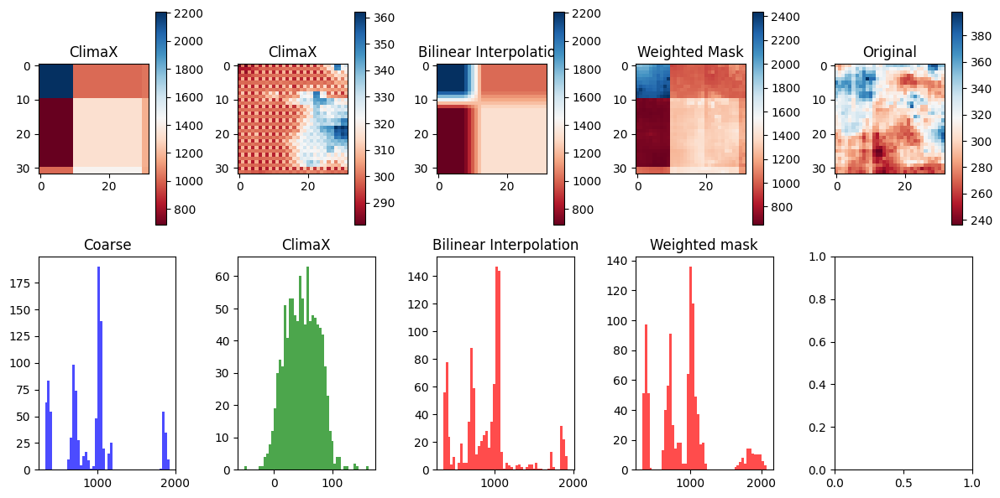

Time step 26
torch.Size([80, 1, 32, 32])


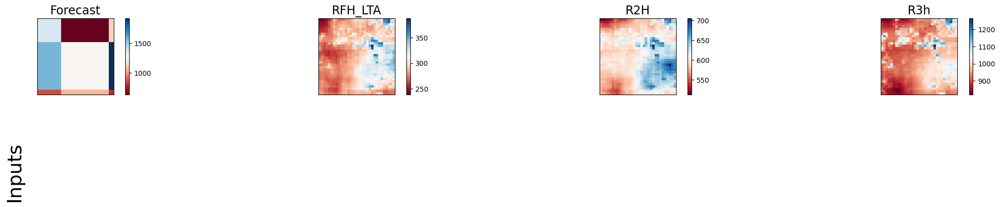

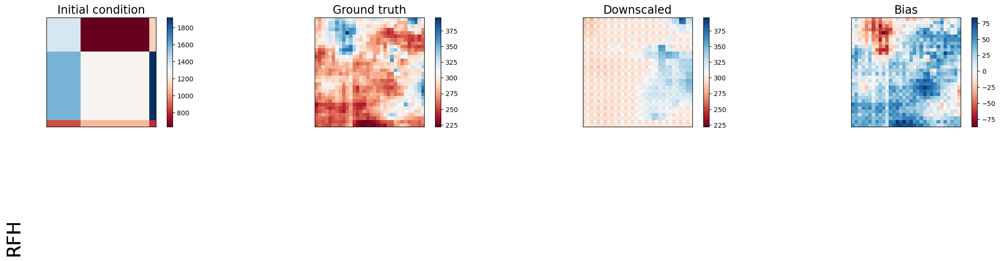

Selected device: cuda:0
+----------------------+---------------------+---------------------+------------------------+---------------------+
|                      | Coarse              | ClimaX              | Bilinear Interpolation | Weighted Mask       |
+----------------------+---------------------+---------------------+------------------------+---------------------+
| lat_weighted_mse_val | 908204.1875         | 1195.38037109375    | 938051.25              | 985314.125          |
| lat_weighted_rmse    | 952.9974975585938   | 34.57427215576172   | 968.5304565429688      | 992.6298828125      |
| spearman             | 0.45538564397050385 | 0.25673331576647207 | -0.1911830851654487    | 0.13712506878849942 |
| mean_bias            | -896.576904296875   | 20.436248779296875  | 917.633544921875       | 930.28076171875     |
| pearson              | 0.4790535146239677  | 0.31184132481202986 | -0.1356765373257684    | 0.09275999541119927 |
+----------------------+---------------------+--

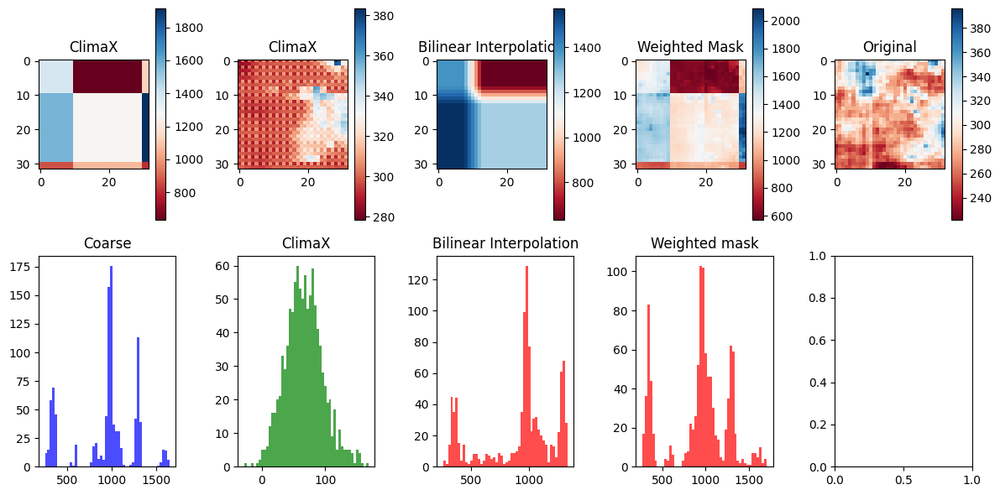

Time step 27
torch.Size([80, 1, 32, 32])


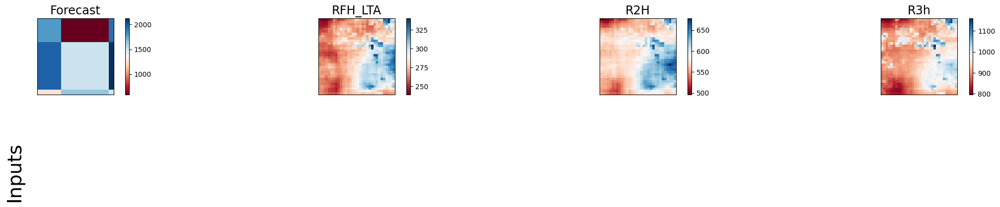

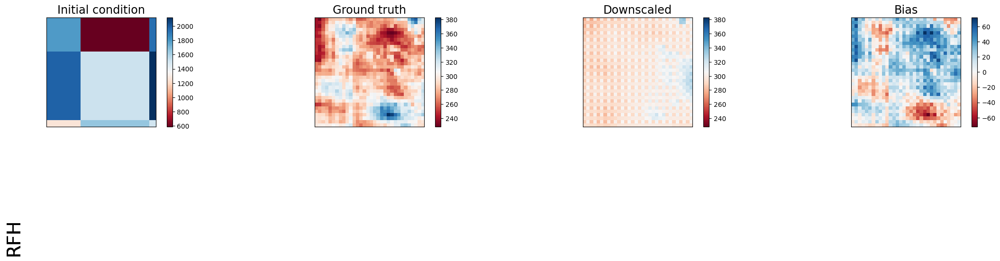

Selected device: cuda:0
+----------------------+--------------------+---------------------+------------------------+---------------------+
|                      | Coarse             | ClimaX              | Bilinear Interpolation | Weighted Mask       |
+----------------------+--------------------+---------------------+------------------------+---------------------+
| lat_weighted_mse_val | 1563975.5          | 674.05712890625     | 1535743.0              | 1660291.0           |
| lat_weighted_rmse    | 1250.590087890625  | 25.962610244750977  | 1239.2509765625        | 1288.5228271484375  |
| spearman             | 0.5283292007157582 | 0.15303639155054302 | 0.1884543697953971     | 0.28990317732341864 |
| mean_bias            | -1162.9990234375   | 10.40997314453125   | 1154.7501220703125     | 1195.3837890625     |
| pearson              | 0.5406293578006077 | 0.23026103529387382 | 0.224708001511558      | 0.2506081814220824  |
+----------------------+--------------------+-----------

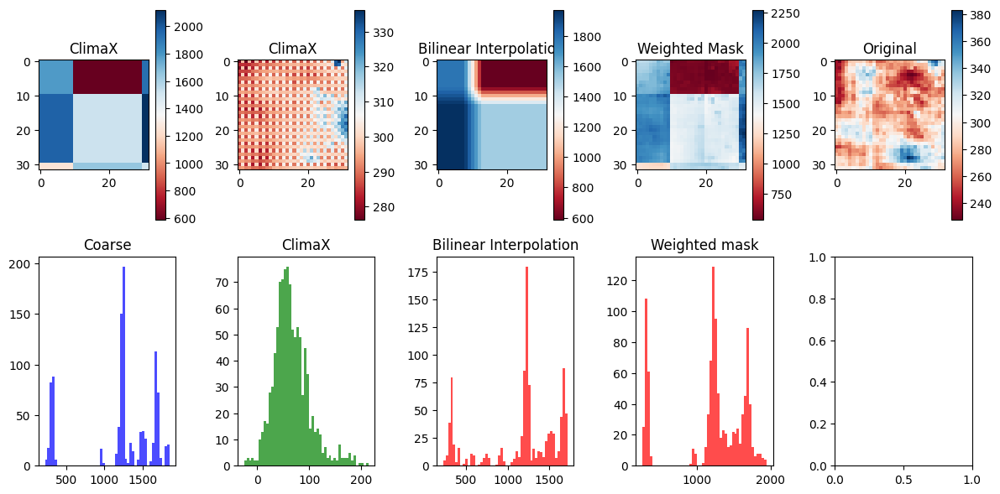

Time step 28
torch.Size([80, 1, 32, 32])


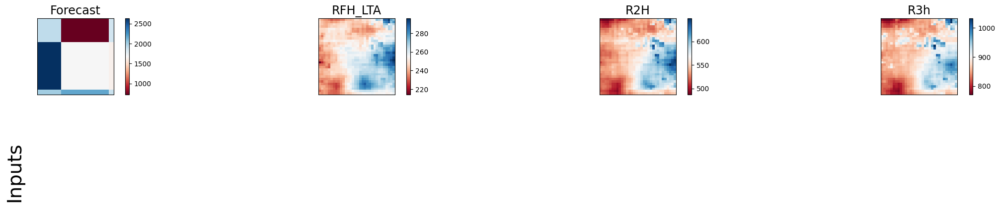

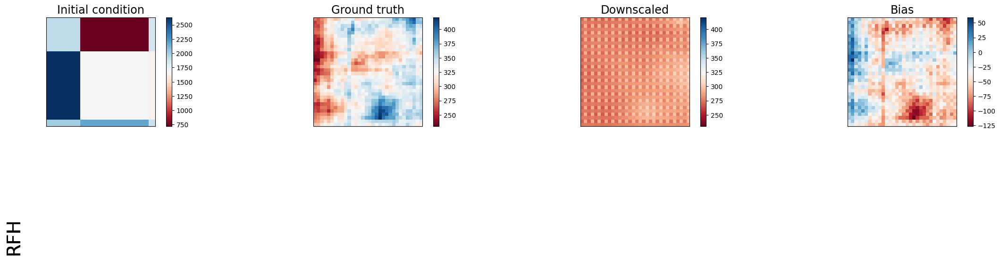

Selected device: cuda:0
+----------------------+--------------------+--------------------+------------------------+----------------------+
|                      | Coarse             | ClimaX             | Bilinear Interpolation | Weighted Mask        |
+----------------------+--------------------+--------------------+------------------------+----------------------+
| lat_weighted_mse_val | 2323480.0          | 2396.1845703125    | 2279716.0              | 2364830.0            |
| lat_weighted_rmse    | 1524.2965087890625 | 48.95083999633789  | 1509.872802734375      | 1537.8004150390625   |
| spearman             | 0.5680443423760176 | 0.3527772973448323 | -0.41125878064953225   | -0.30554321135386253 |
| mean_bias            | -1408.772216796875 | -39.9345703125     | 1380.536865234375      | 1405.749755859375    |
| pearson              | 0.5958309355984768 | 0.3687877253952685 | -0.4022058838891975    | -0.3757769470594164  |
+----------------------+--------------------+-----------

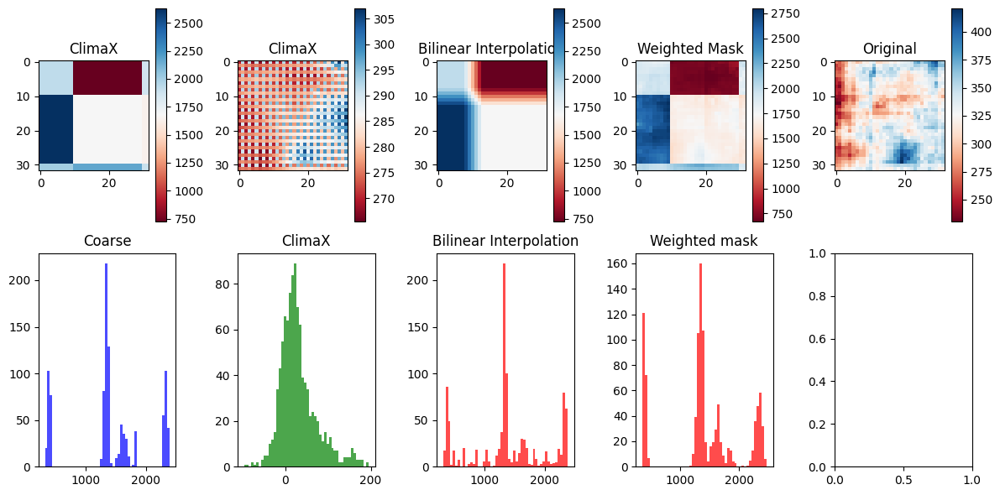

Time step 29
torch.Size([80, 1, 32, 32])


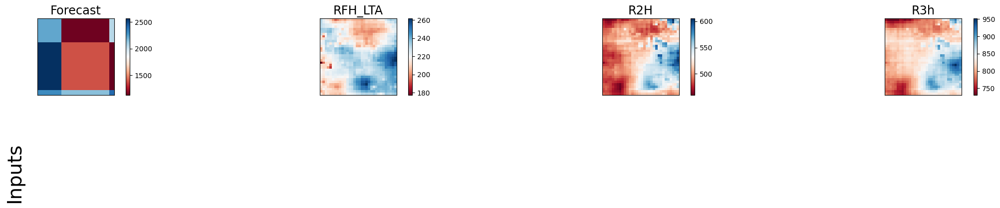

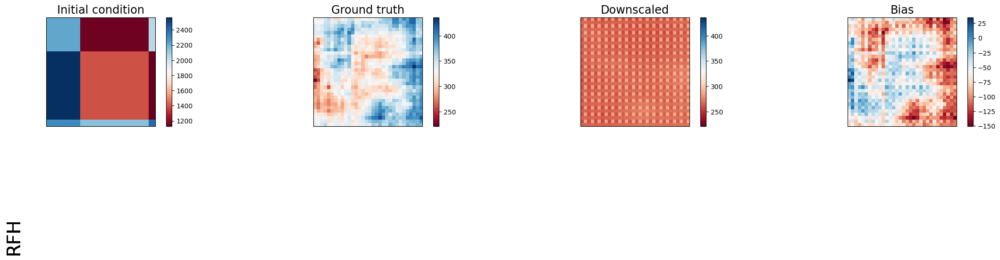

Selected device: cuda:0
+----------------------+--------------------+--------------------+------------------------+----------------------+
|                      | Coarse             | ClimaX             | Bilinear Interpolation | Weighted Mask        |
+----------------------+--------------------+--------------------+------------------------+----------------------+
| lat_weighted_mse_val | 2200654.25         | 5831.509765625     | 2101503.25             | 2184799.0            |
| lat_weighted_rmse    | 1483.460205078125  | 76.36431884765625  | 1449.65625             | 1478.1065673828125   |
| spearman             | 0.5226790796502296 | 0.2080618004963599 | -0.2726454501999324    | -0.13403170364356645 |
| mean_bias            | -1387.482666015625 | -69.174560546875   | 1350.096435546875      | 1367.878173828125    |
| pearson              | 0.5126603080621154 | 0.1508901642280971 | -0.3284549938866798    | -0.2156995741081647  |
+----------------------+--------------------+-----------

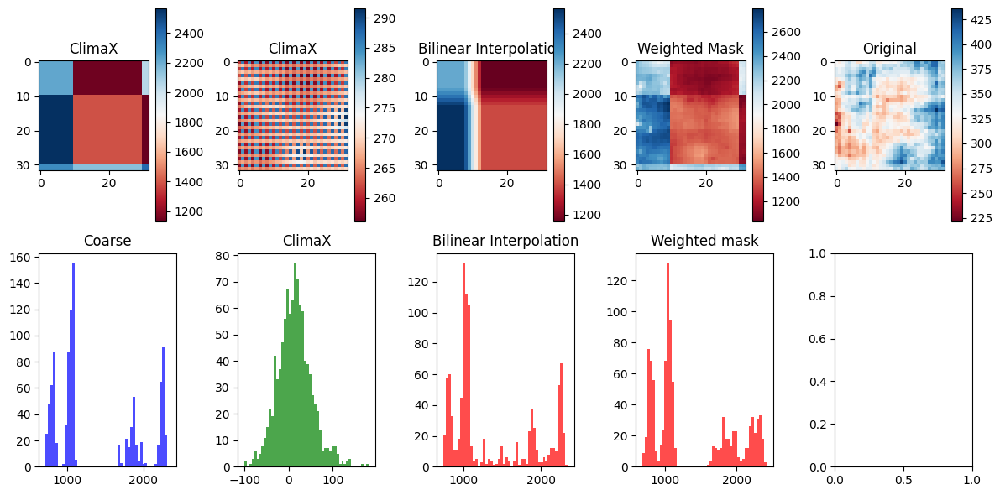

Time step 30
torch.Size([80, 1, 32, 32])


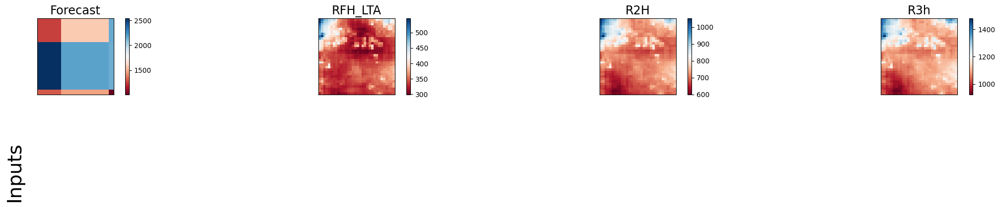

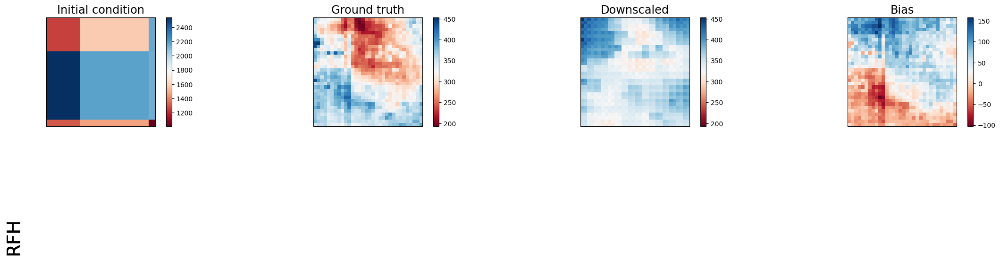

Selected device: cuda:0
+----------------------+---------------------+---------------------+------------------------+---------------------+
|                      | Coarse              | ClimaX              | Bilinear Interpolation | Weighted Mask       |
+----------------------+---------------------+---------------------+------------------------+---------------------+
| lat_weighted_mse_val | 2960092.5           | 3489.82470703125    | 3035933.0              | 2971263.25          |
| lat_weighted_rmse    | 1720.491943359375   | 59.074737548828125  | 1742.3929443359375     | 1723.7352294921875  |
| spearman             | 0.35101318999389425 | 0.23186596444777843 | 0.5324145096250114     | 0.43176242895279326 |
| mean_bias            | -1669.289794921875  | 33.259552001953125  | 1701.6175537109375     | 1669.2899169921875  |
| pearson              | 0.3426442057089474  | 0.25064328228550375 | 0.472001259152596      | 0.4090985674342345  |
+----------------------+---------------------+--

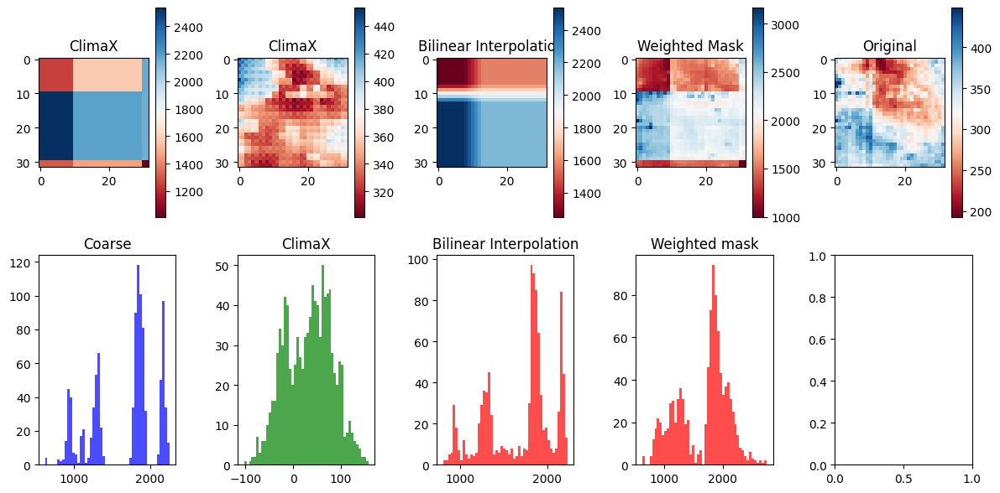

Time step 31
torch.Size([80, 1, 32, 32])


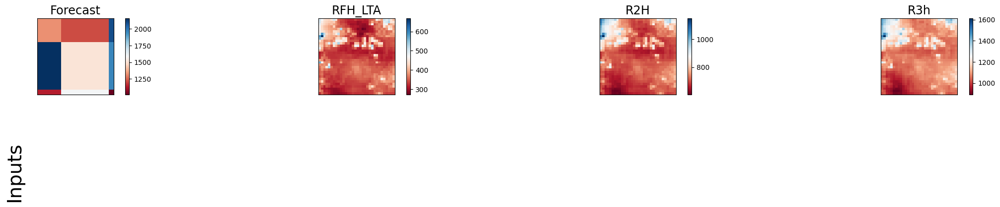

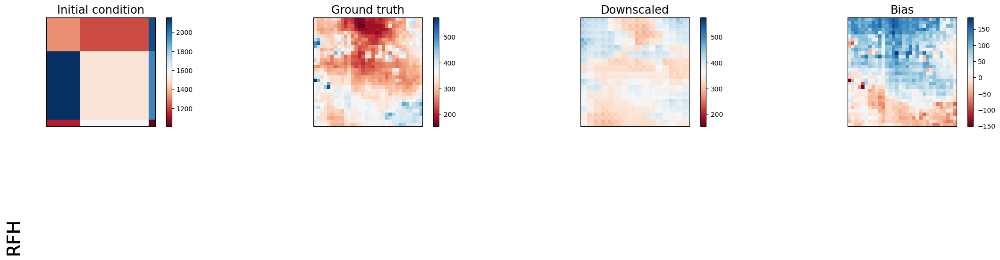

Selected device: cuda:0
+----------------------+--------------------+---------------------+------------------------+--------------------+
|                      | Coarse             | ClimaX              | Bilinear Interpolation | Weighted Mask      |
+----------------------+--------------------+---------------------+------------------------+--------------------+
| lat_weighted_mse_val | 1694066.0          | 4708.20947265625    | 1653251.5              | 1726115.25         |
| lat_weighted_rmse    | 1301.5628662109375 | 68.61639404296875   | 1285.788330078125      | 1313.8170166015625 |
| spearman             | 0.5376793704085857 | 0.4216891397995839  | 0.3297206570935533     | 0.5403793258128391 |
| mean_bias            | -1261.923828125    | 42.73919677734375   | 1250.0509033203125     | 1266.11328125      |
| pearson              | 0.5172123835533295 | 0.46056171342320107 | 0.2924654687789825     | 0.52298179378363   |
+----------------------+--------------------+-------------------

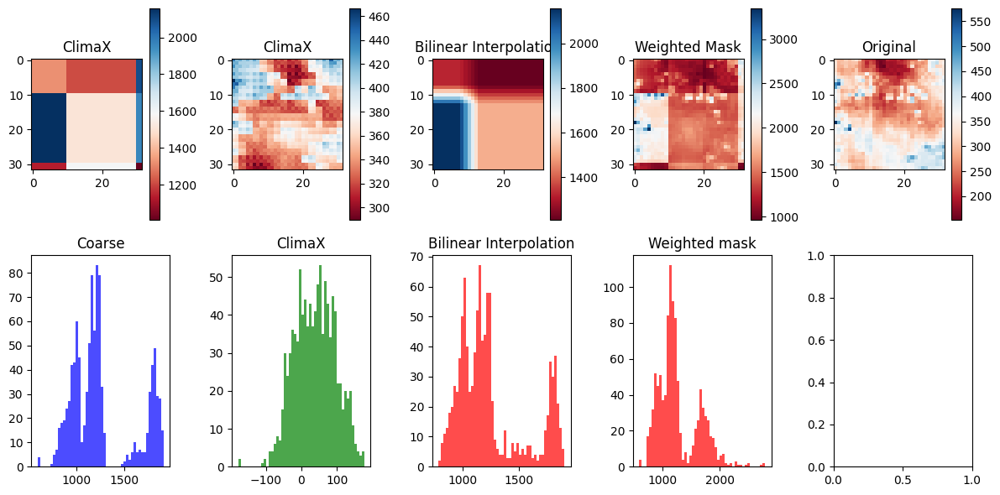

Time step 32
torch.Size([80, 1, 32, 32])


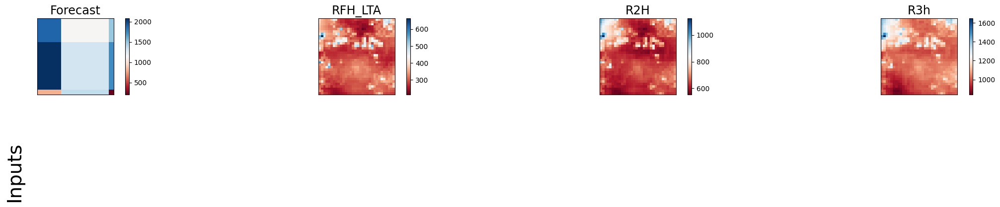

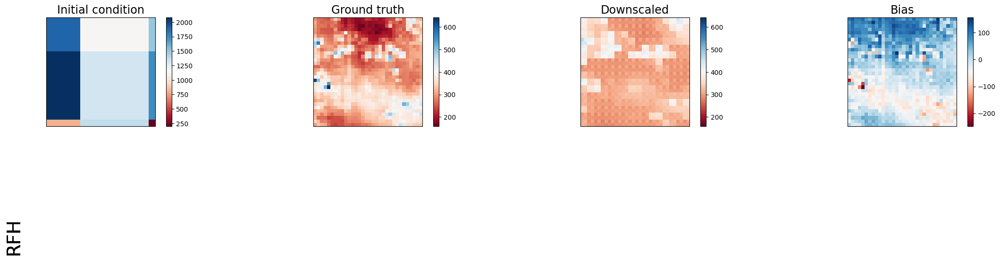

Selected device: cuda:0
+----------------------+--------------------+---------------------+------------------------+--------------------+
|                      | Coarse             | ClimaX              | Bilinear Interpolation | Weighted Mask      |
+----------------------+--------------------+---------------------+------------------------+--------------------+
| lat_weighted_mse_val | 1502646.0          | 3236.530517578125   | 1544105.25             | 1553996.625        |
| lat_weighted_rmse    | 1225.8245849609375 | 56.8905143737793    | 1242.620361328125      | 1246.593994140625  |
| spearman             | 0.5083197152881915 | 0.47373256441918227 | 0.20943000288154645    | 0.5311835115923186 |
| mean_bias            | -1173.083251953125 | 9.696075439453125   | 1194.6273193359375     | 1178.755126953125  |
| pearson              | 0.4234139128129808 | 0.46435123358084074 | 0.15924447316151658    | 0.5426111643346379 |
+----------------------+--------------------+-------------------

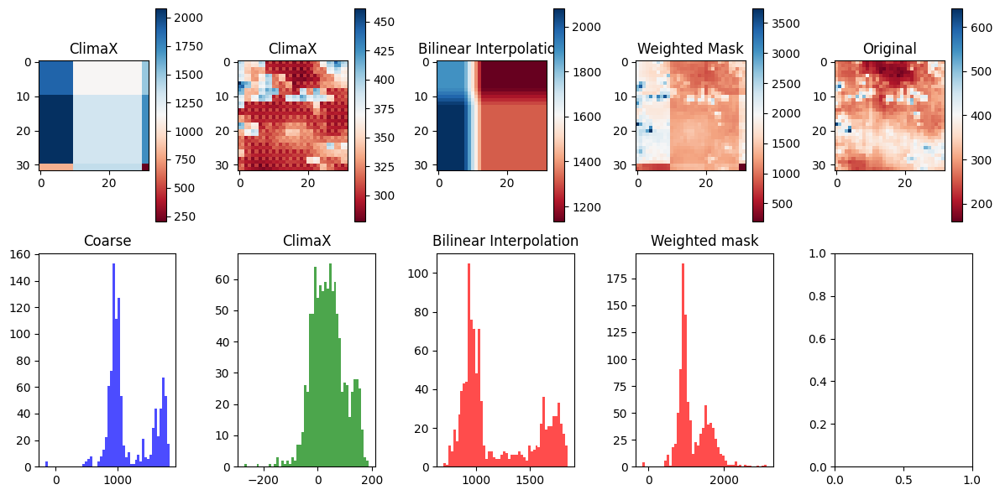

Time step 33
torch.Size([80, 1, 32, 32])


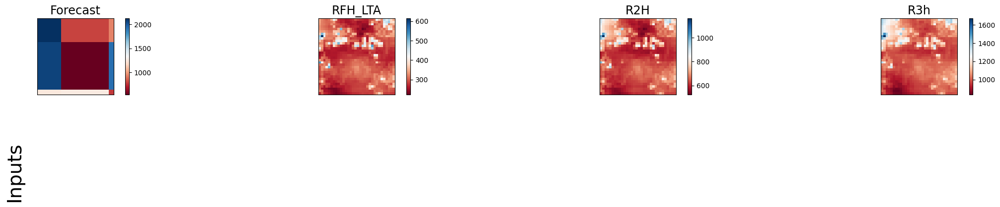

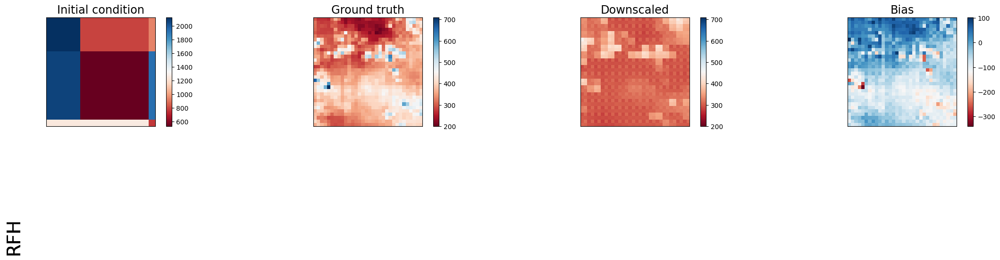

Selected device: cuda:0
+----------------------+---------------------+---------------------+------------------------+-----------------------+
|                      | Coarse              | ClimaX              | Bilinear Interpolation | Weighted Mask         |
+----------------------+---------------------+---------------------+------------------------+-----------------------+
| lat_weighted_mse_val | 1111381.25          | 5660.1943359375     | 1002461.125            | 1102551.75            |
| lat_weighted_rmse    | 1054.220703125      | 75.23426055908203   | 1001.2297973632812     | 1050.024658203125     |
| spearman             | 0.2704478887720719  | 0.42258173618034844 | -0.3738271534513362    | -0.011381282948491138 |
| mean_bias            | -824.0362548828125  | -45.070068359375    | 746.5283203125         | 782.7237548828125     |
| pearson              | 0.37269915196070896 | 0.4321914933003267  | -0.18789519942105448   | 0.0724038794559226    |
+----------------------+--------

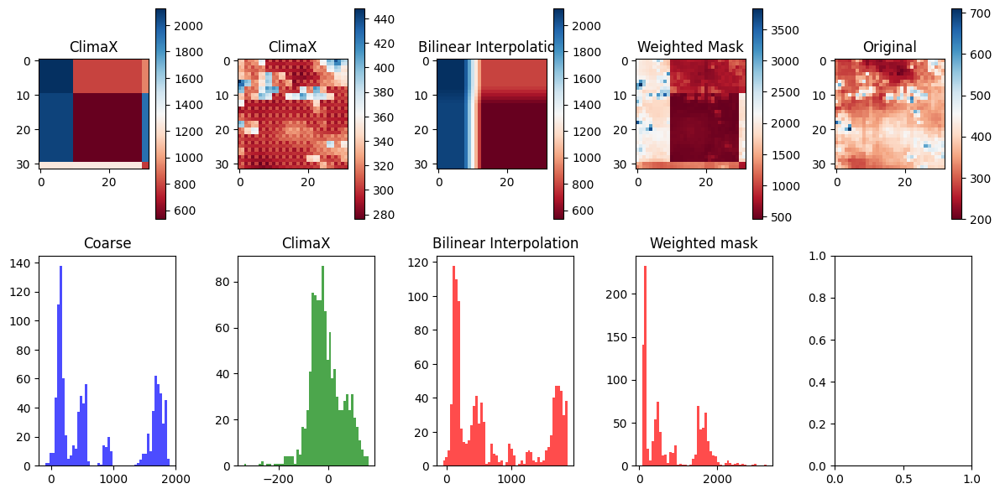

Time step 34
torch.Size([80, 1, 32, 32])


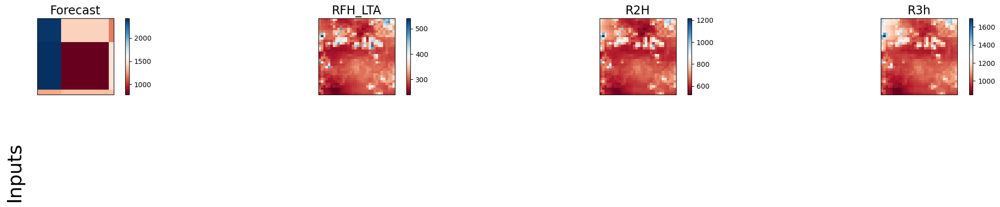

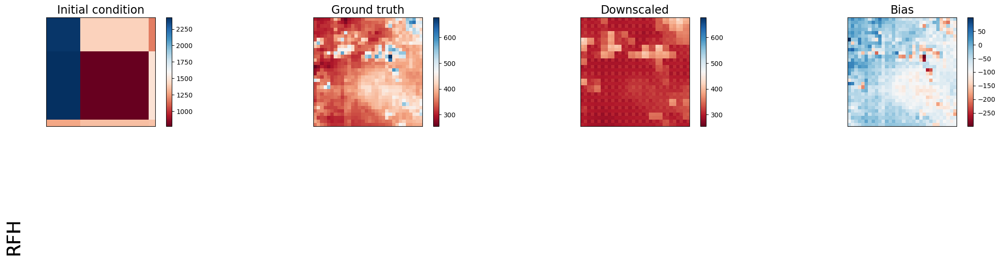

Selected device: cuda:0
+----------------------+---------------------+--------------------+------------------------+----------------------+
|                      | Coarse              | ClimaX             | Bilinear Interpolation | Weighted Mask        |
+----------------------+---------------------+--------------------+------------------------+----------------------+
| lat_weighted_mse_val | 1714179.375         | 5610.33740234375   | 1661173.5              | 1664502.75           |
| lat_weighted_rmse    | 1309.2667236328125  | 74.90218353271484  | 1288.865234375         | 1290.1561279296875   |
| spearman             | 0.2600136377274831  | 0.6405384228120792 | -0.5198465091744039    | -0.2583218766004258  |
| mean_bias            | -1128.497802734375  | -60.7598876953125  | 1084.5341796875        | 1071.724365234375    |
| pearson              | 0.27865190252196237 | 0.6504372819093338 | -0.43510386737502793   | -0.19673847598514577 |
+----------------------+---------------------+--

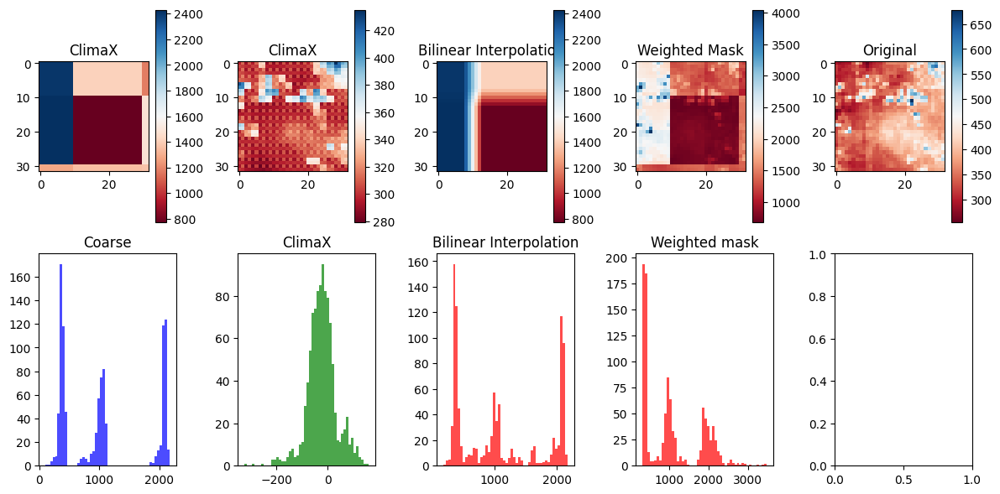

Time step 35
torch.Size([80, 1, 32, 32])


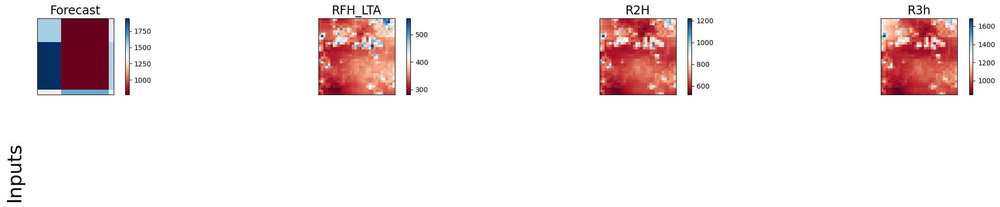

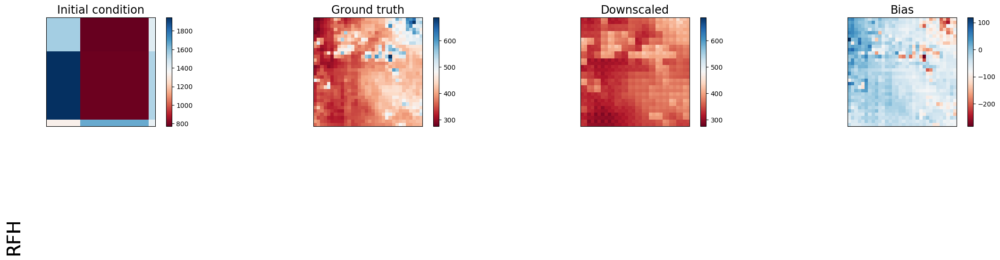

Selected device: cuda:0
+----------------------+--------------------+--------------------+------------------------+----------------------+
|                      | Coarse             | ClimaX             | Bilinear Interpolation | Weighted Mask        |
+----------------------+--------------------+--------------------+------------------------+----------------------+
| lat_weighted_mse_val | 941239.75          | 3638.124267578125  | 780987.875             | 873496.75            |
| lat_weighted_rmse    | 970.1751098632812  | 60.316864013671875 | 883.7351684570312      | 934.6104736328125    |
| spearman             | 0.5839286182369744 | 0.8257288275532084 | -0.7027255986399926    | -0.27659783660088394 |
| mean_bias            | -851.063232421875  | -43.3175048828125  | 724.377197265625       | 772.395263671875     |
| pearson              | 0.5029787981932601 | 0.8002762207984101 | -0.5918312566168883    | -0.3124582698427668  |
+----------------------+--------------------+-----------

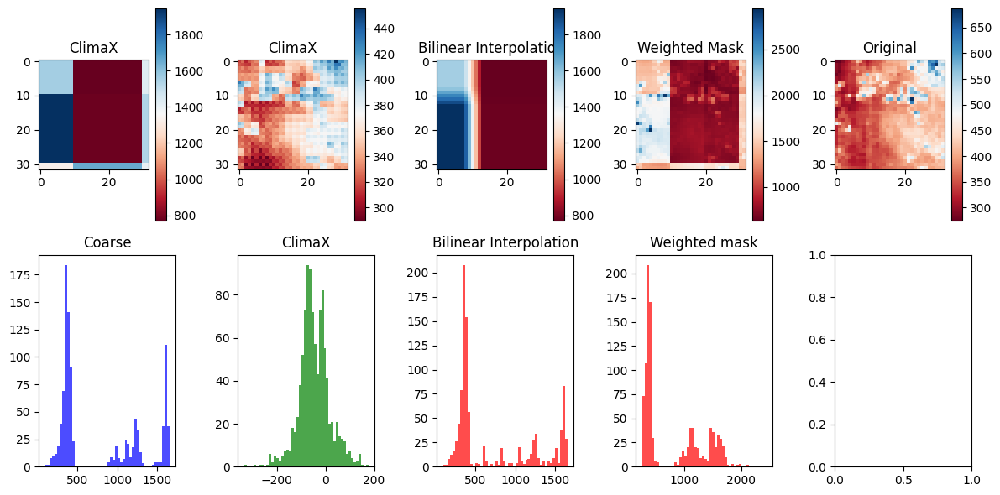

Time step 36
torch.Size([80, 1, 32, 32])


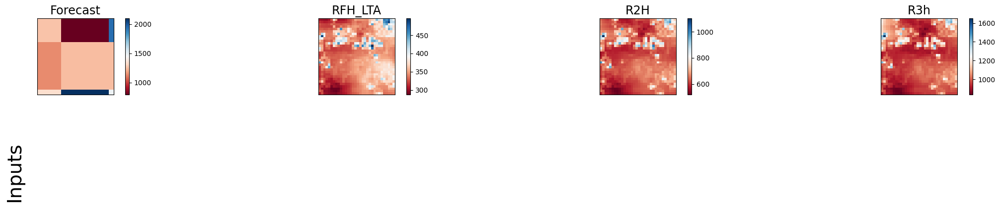

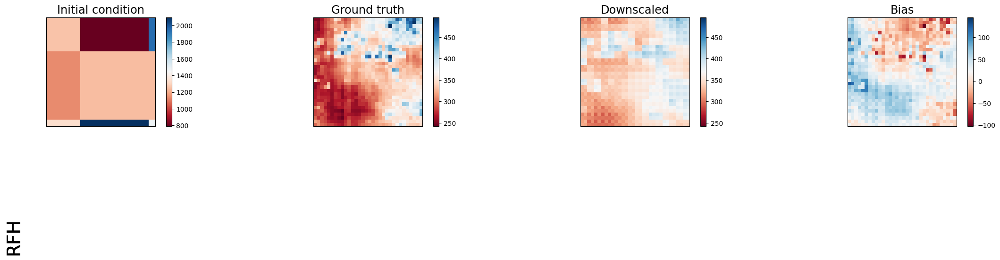

Selected device: cuda:0
+----------------------+---------------------+--------------------+------------------------+----------------------+
|                      | Coarse              | ClimaX             | Bilinear Interpolation | Weighted Mask        |
+----------------------+---------------------+--------------------+------------------------+----------------------+
| lat_weighted_mse_val | 817947.375          | 1585.19091796875   | 661643.1875            | 818988.5625          |
| lat_weighted_rmse    | 904.4044189453125   | 39.814456939697266 | 813.41455078125        | 904.9798583984375    |
| spearman             | 0.19233712013841964 | 0.742459094458644  | -0.2687406733932324    | 0.01568057778469189  |
| mean_bias            | -864.918212890625   | 22.63494873046875  | 790.584228515625       | 854.926025390625     |
| pearson              | 0.35977340806409847 | 0.7489902368067273 | -0.463969322566605     | -0.07914283995257053 |
+----------------------+---------------------+--

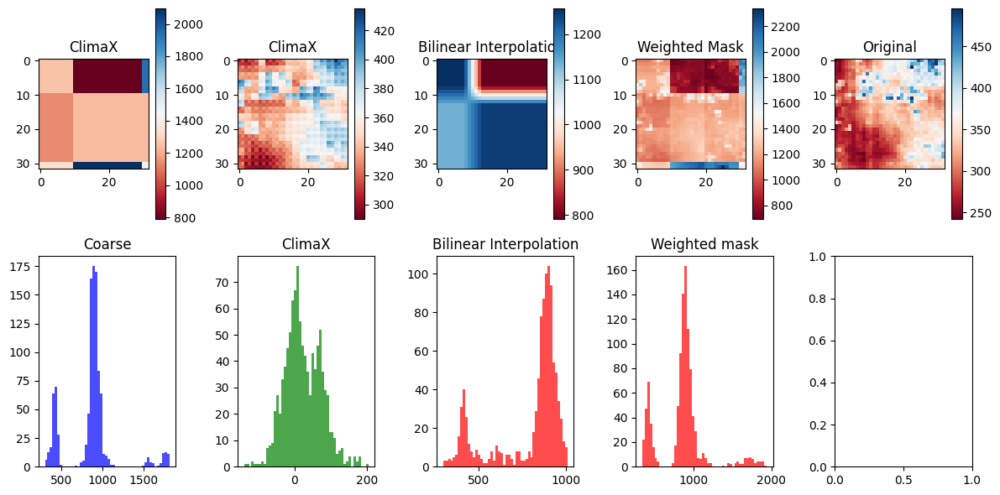

Time step 37
torch.Size([80, 1, 32, 32])


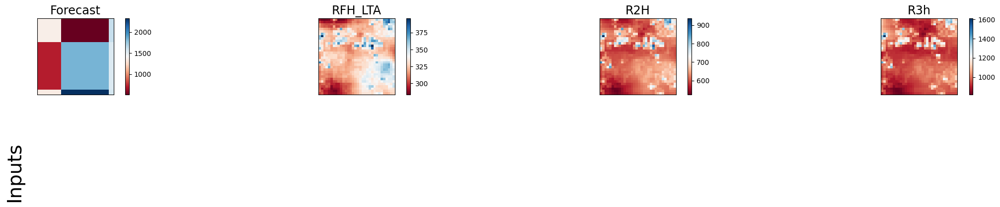

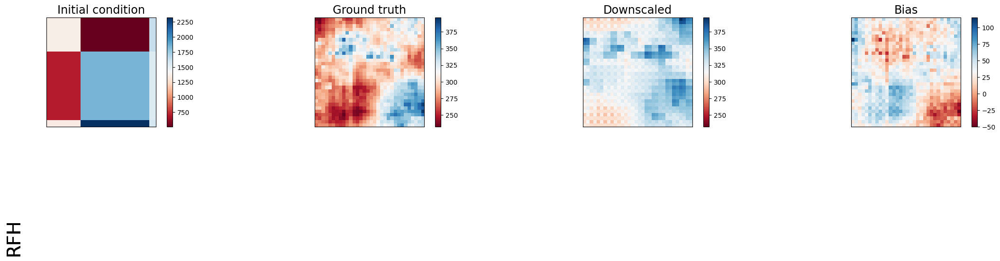

Selected device: cuda:0
+----------------------+---------------------+--------------------+------------------------+--------------------+
|                      | Coarse              | ClimaX             | Bilinear Interpolation | Weighted Mask      |
+----------------------+---------------------+--------------------+------------------------+--------------------+
| lat_weighted_mse_val | 1310867.75          | 1392.4071044921875 | 1153223.75             | 1353437.75         |
| lat_weighted_rmse    | 1144.9312744140625  | 37.314971923828125 | 1073.882568359375      | 1163.3734130859375 |
| spearman             | 0.12966935550499245 | 0.7307427922478801 | 0.1524823815267433     | 0.1815255865764821 |
| mean_bias            | -982.5081787109375  | 29.798431396484375 | 938.884033203125       | 1003.4134521484375 |
| pearson              | 0.10233533144125204 | 0.7044318171432581 | 0.20275511741440663    | 0.1800724098312192 |
+----------------------+---------------------+------------------

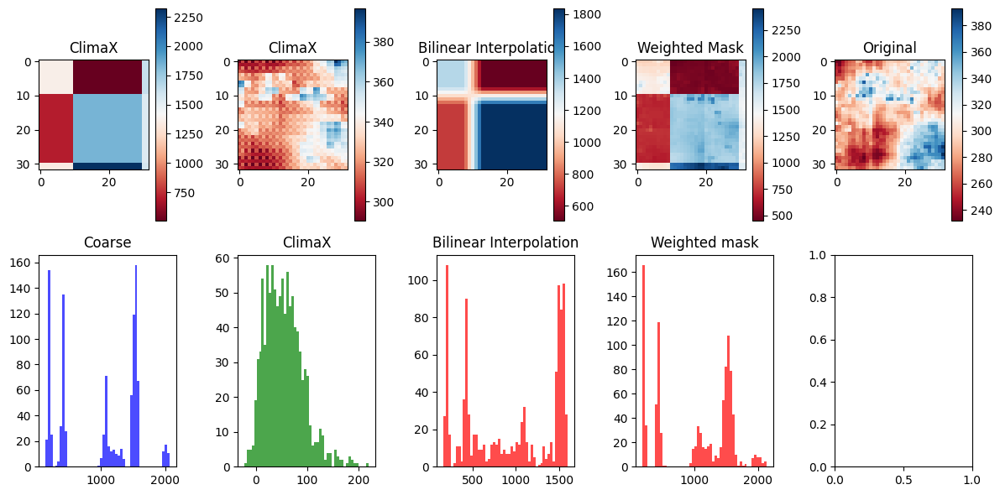

Time step 38
torch.Size([80, 1, 32, 32])


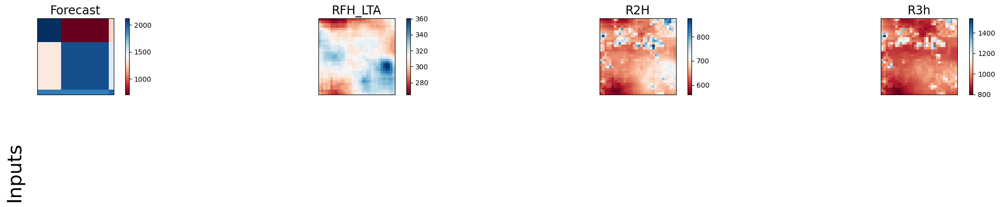

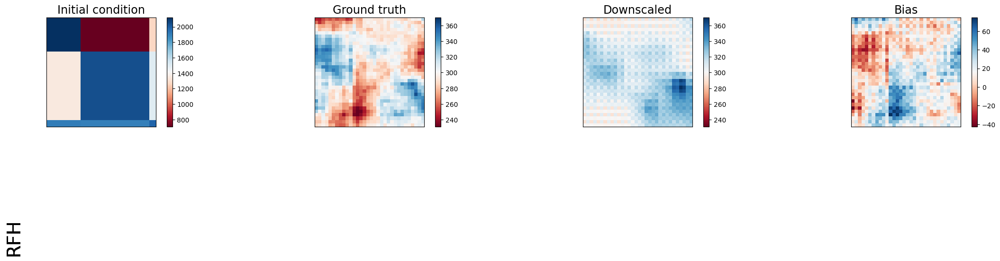

Selected device: cuda:0
+----------------------+----------------------+--------------------+------------------------+---------------------+
|                      | Coarse               | ClimaX             | Bilinear Interpolation | Weighted Mask       |
+----------------------+----------------------+--------------------+------------------------+---------------------+
| lat_weighted_mse_val | 1920980.25           | 605.102294921875   | 1928851.625            | 1989778.25          |
| lat_weighted_rmse    | 1385.9942626953125   | 24.598827362060547 | 1388.8310546875        | 1410.594970703125   |
| spearman             | 0.052528822361344825 | 0.5946245416899052 | 0.051647611875382395   | 0.1439935620958095  |
| mean_bias            | -1285.1585693359375  | 15.718536376953125 | 1298.28662109375       | 1307.1116943359375  |
| pearson              | 0.2096502868586604   | 0.599672783119807  | 0.043757441891113344   | 0.02307494950882523 |
+----------------------+----------------------+-

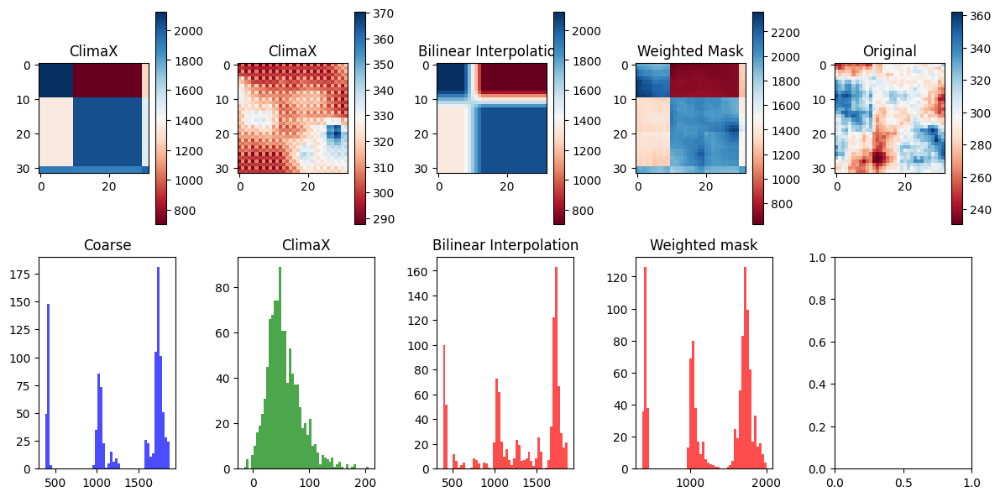

Time step 39
torch.Size([80, 1, 32, 32])


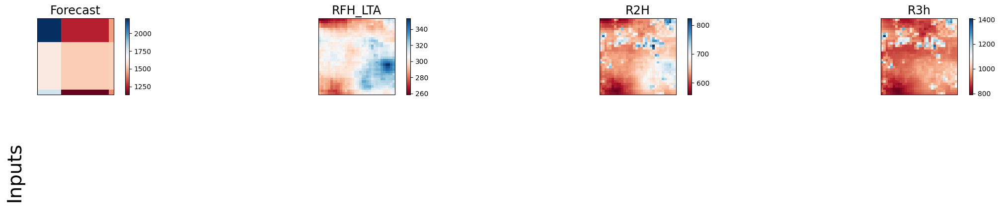

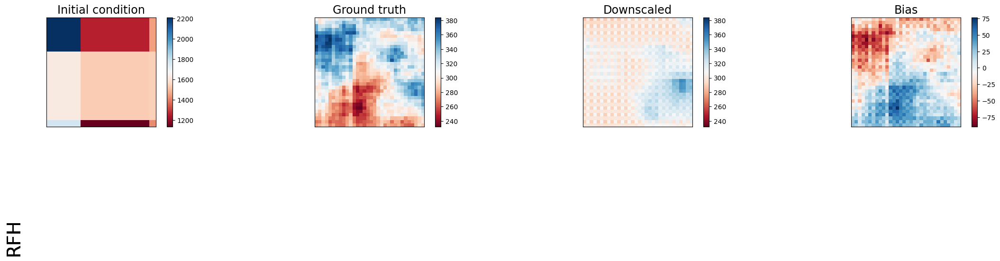

Selected device: cuda:0
+----------------------+---------------------+---------------------+------------------------+--------------------+
|                      | Coarse              | ClimaX              | Bilinear Interpolation | Weighted Mask      |
+----------------------+---------------------+---------------------+------------------------+--------------------+
| lat_weighted_mse_val | 1580148.5           | 953.1279296875      | 1630580.0              | 1603003.875        |
| lat_weighted_rmse    | 1257.03955078125    | 30.872770309448242  | 1276.941650390625      | 1266.097900390625  |
| spearman             | 0.3595727621329625  | 0.13823711662196247 | 0.10275169676519312    | 0.2272799900699206 |
| mean_bias            | -1230.5460205078125 | -3.54705810546875   | 1256.18505859375       | 1239.5919189453125 |
| pearson              | 0.19130354949399028 | 0.18180363065455052 | 0.2790532802492516     | 0.3426155930371928 |
+----------------------+---------------------+----------

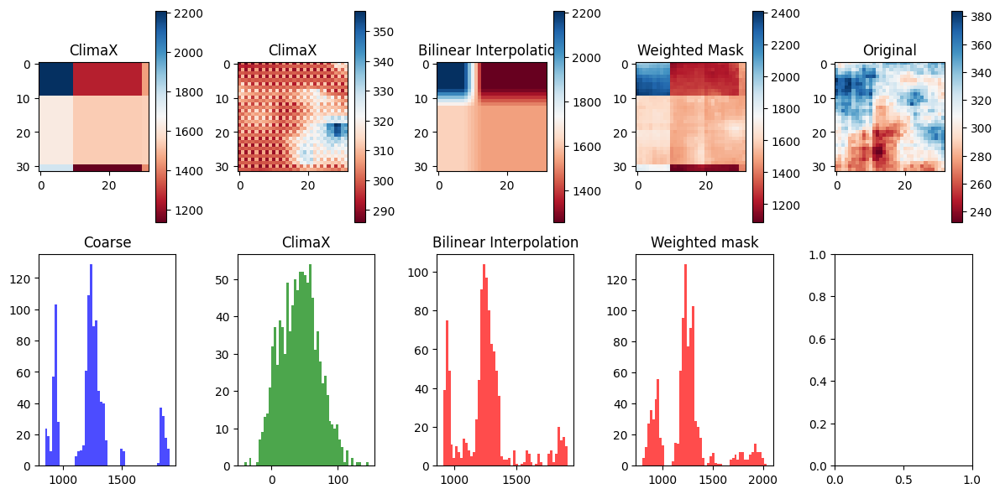

Time step 40
torch.Size([80, 1, 32, 32])


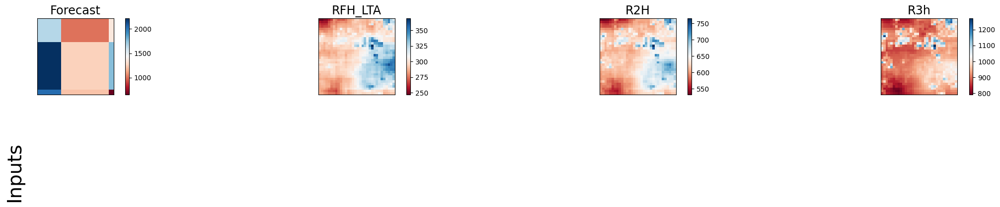

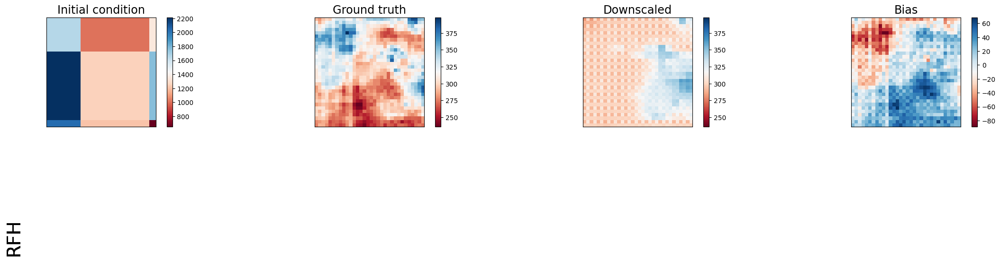

Selected device: cuda:0
+----------------------+--------------------+---------------------+------------------------+---------------------+
|                      | Coarse             | ClimaX              | Bilinear Interpolation | Weighted Mask       |
+----------------------+--------------------+---------------------+------------------------+---------------------+
| lat_weighted_mse_val | 1475148.25         | 951.890625          | 1491403.375            | 1528157.0           |
| lat_weighted_rmse    | 1214.5567626953125 | 30.852724075317383  | 1221.230224609375      | 1236.1865234375     |
| spearman             | 0.5089012660808897 | 0.08773150927502699 | 0.02327036414752447    | 0.1915735191351994  |
| mean_bias            | -1143.07568359375  | 4.36370849609375    | 1149.3343505859375     | 1158.18017578125    |
| pearson              | 0.5105218078689454 | 0.17813159394384007 | 0.046319898956427664   | 0.15945334444224324 |
+----------------------+--------------------+-----------

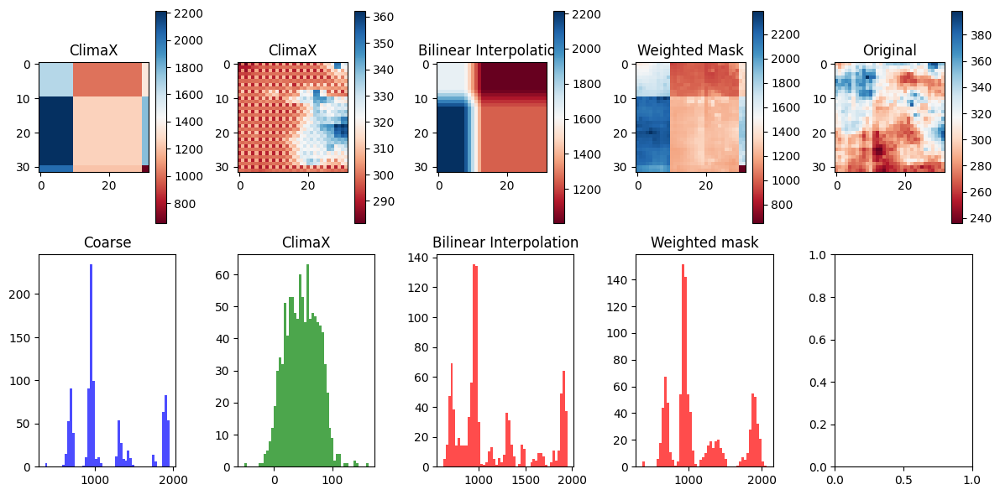

Time step 41
torch.Size([80, 1, 32, 32])


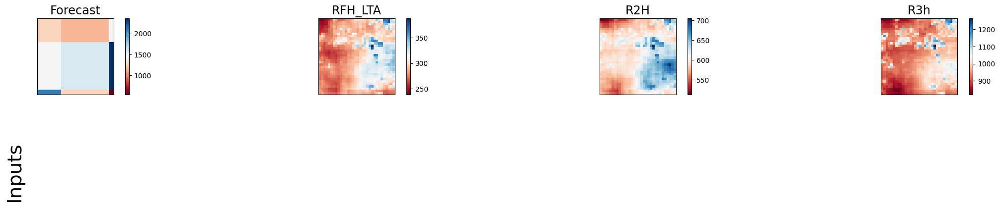

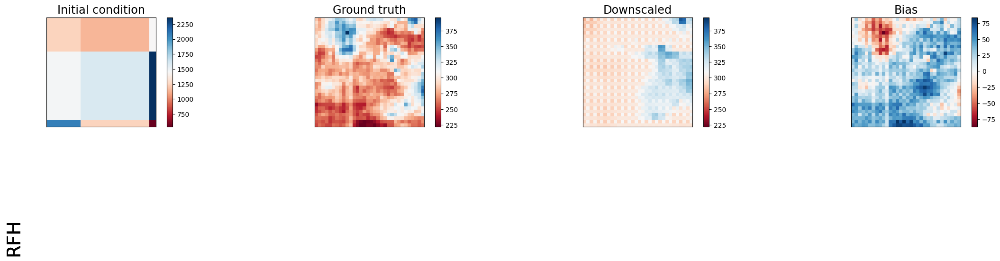

Selected device: cuda:0
+----------------------+---------------------+---------------------+------------------------+---------------------+
|                      | Coarse              | ClimaX              | Bilinear Interpolation | Weighted Mask       |
+----------------------+---------------------+---------------------+------------------------+---------------------+
| lat_weighted_mse_val | 1380104.25          | 1195.38037109375    | 1329498.5              | 1465958.0           |
| lat_weighted_rmse    | 1174.7784423828125  | 34.57427215576172   | 1153.038818359375      | 1210.767578125      |
| spearman             | 0.19719782930241478 | 0.2567337796022708  | -0.16595907243740193   | 0.0551125914176872  |
| mean_bias            | -1144.5447998046875 | 20.436248779296875  | 1139.2396240234375     | 1178.2489013671875  |
| pearson              | 0.23154903112718345 | 0.31184130532491705 | -0.25237475365135403   | 0.09880952105020638 |
+----------------------+---------------------+--

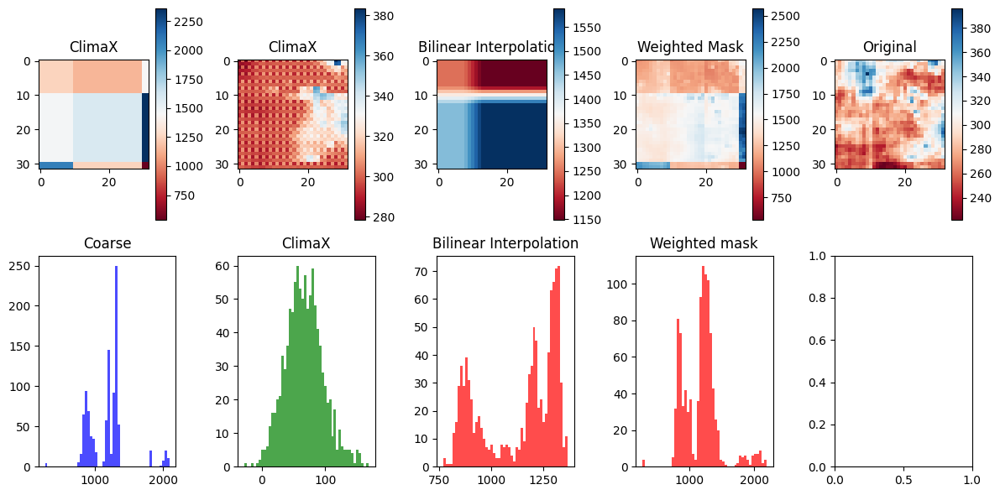

Time step 42
torch.Size([80, 1, 32, 32])


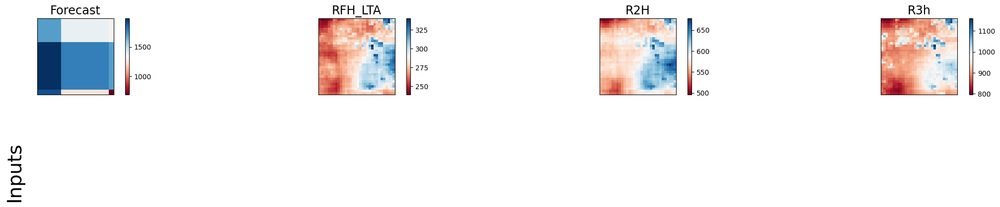

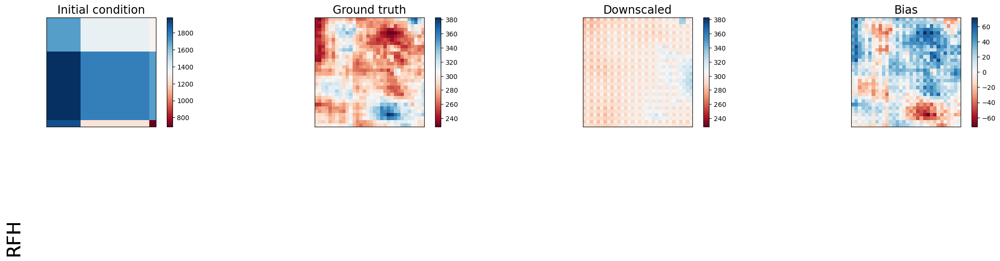

Selected device: cuda:0
+----------------------+--------------------+---------------------+------------------------+---------------------+
|                      | Coarse             | ClimaX              | Bilinear Interpolation | Weighted Mask       |
+----------------------+--------------------+---------------------+------------------------+---------------------+
| lat_weighted_mse_val | 1943502.875        | 674.05712890625     | 2103062.25             | 2040932.0           |
| lat_weighted_rmse    | 1394.095703125     | 25.962610244750977  | 1450.19384765625       | 1428.6119384765625  |
| spearman             | 0.4028475804962228 | 0.15303639155054302 | 0.2539325001144928     | 0.2662591017529199  |
| mean_bias            | -1377.148193359375 | 10.40997314453125   | 1438.146484375         | 1409.532958984375   |
| pearson              | 0.3727685153910193 | 0.23026100484967132 | 0.2477278246717593     | 0.24434587055734164 |
+----------------------+--------------------+-----------

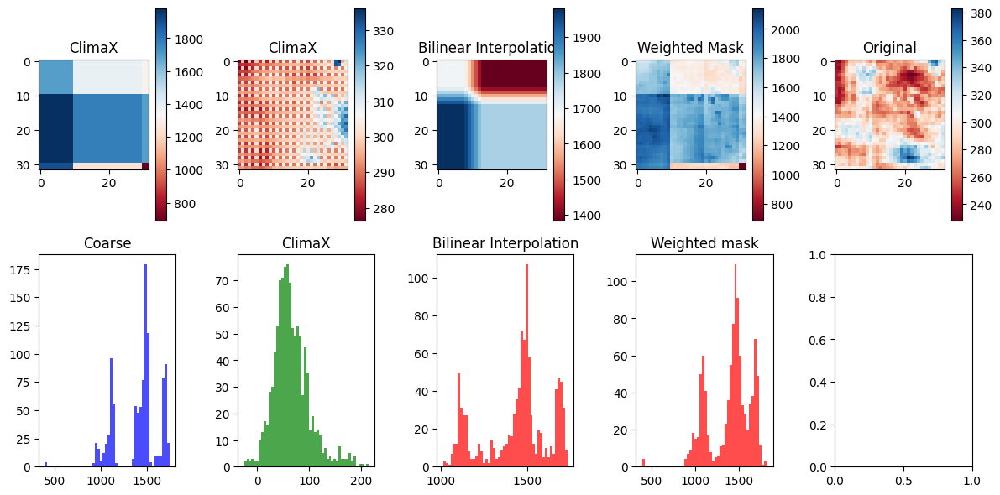

Time step 43
torch.Size([80, 1, 32, 32])


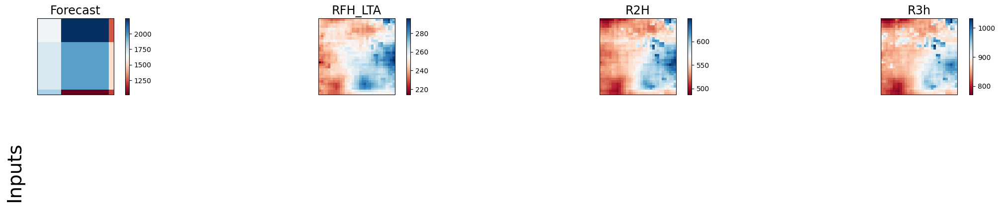

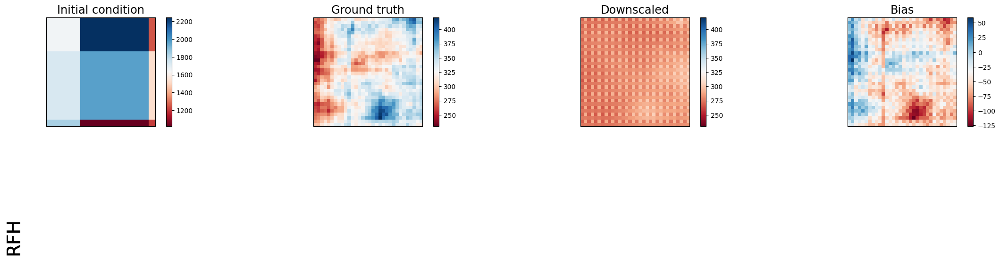

Selected device: cuda:0
+----------------------+----------------------+--------------------+------------------------+--------------------+
|                      | Coarse               | ClimaX             | Bilinear Interpolation | Weighted Mask      |
+----------------------+----------------------+--------------------+------------------------+--------------------+
| lat_weighted_mse_val | 2495310.0            | 2396.1845703125    | 2642427.5              | 2470443.75         |
| lat_weighted_rmse    | 1579.655029296875    | 48.95083999633789  | 1625.5545654296875     | 1571.7645263671875 |
| spearman             | -0.49375713943388994 | 0.3527772973448323 | 0.4136868269711914     | 0.3631613095979004 |
| mean_bias            | -1548.8046875        | -39.9345703125     | 1616.20263671875       | 1545.7822265625    |
| pearson              | -0.47116647458227534 | 0.3687877803874453 | 0.4349569155291222     | 0.2650198502042722 |
+----------------------+----------------------+---------

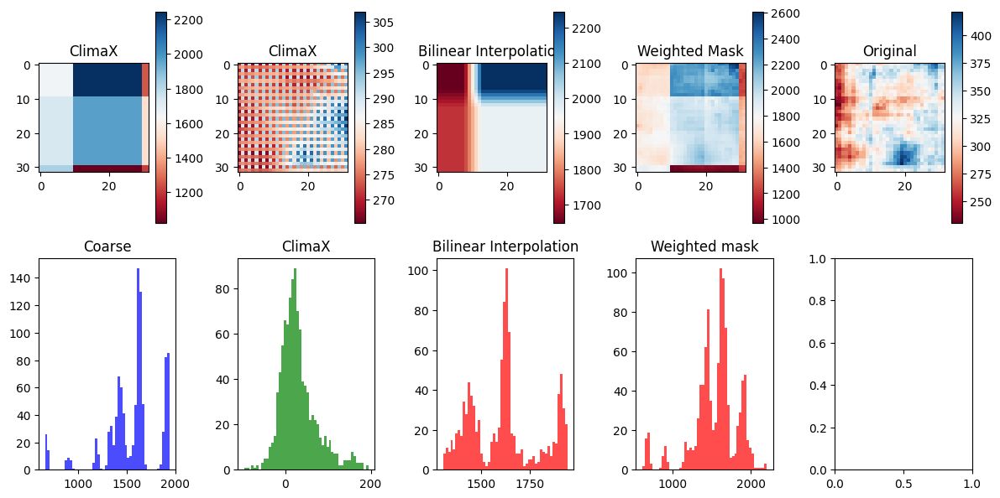

Time step 44
torch.Size([80, 1, 32, 32])


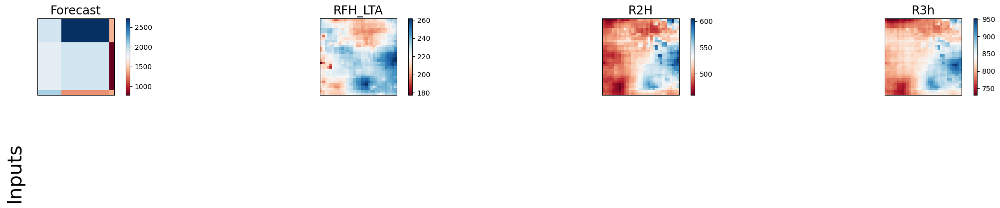

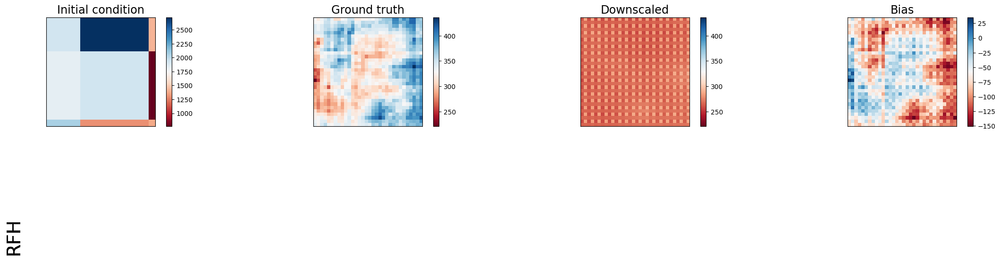

Selected device: cuda:0
+----------------------+---------------------+---------------------+------------------------+-----------------------+
|                      | Coarse              | ClimaX              | Bilinear Interpolation | Weighted Mask         |
+----------------------+---------------------+---------------------+------------------------+-----------------------+
| lat_weighted_mse_val | 3011160.25          | 5831.509765625      | 3162522.75             | 2931715.75            |
| lat_weighted_rmse    | 1735.26953125       | 76.36431884765625   | 1778.3482666015625     | 1712.225341796875     |
| spearman             | -0.5452221411476843 | 0.2080618004963599  | 0.30993438273669144    | 0.22140144286705765   |
| mean_bias            | -1671.4757080078125 | -69.174560546875    | 1751.02099609375       | 1651.8714599609375    |
| pearson              | -0.4606853041292029 | 0.15089021412274803 | 0.14871780517808697    | -0.013934234425075891 |
+----------------------+--------

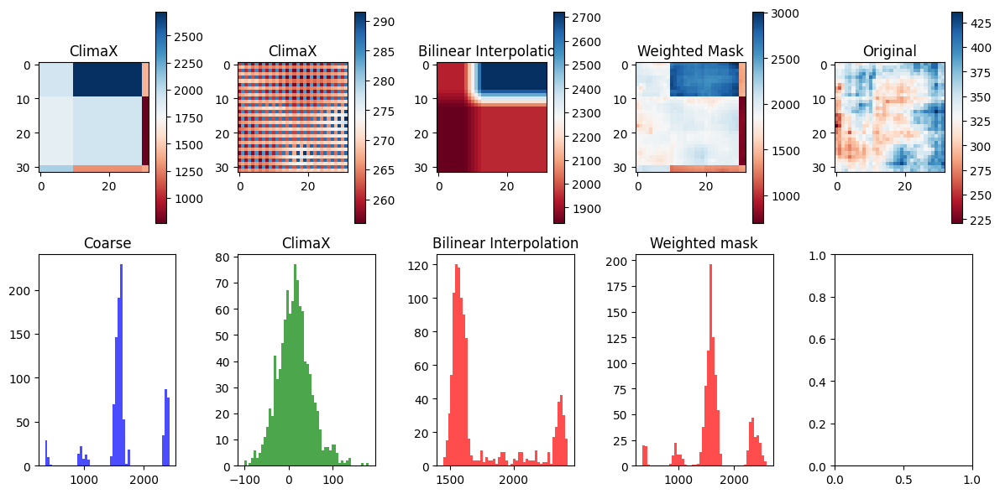

Time step 45
torch.Size([80, 1, 32, 32])


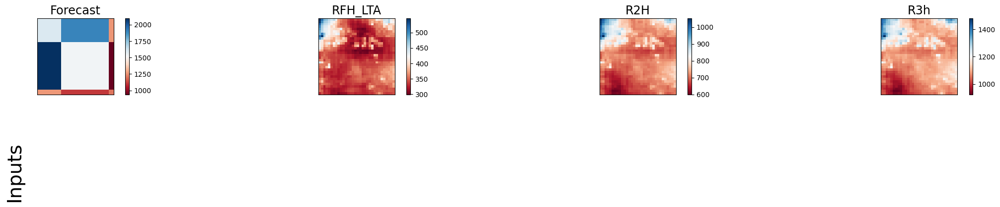

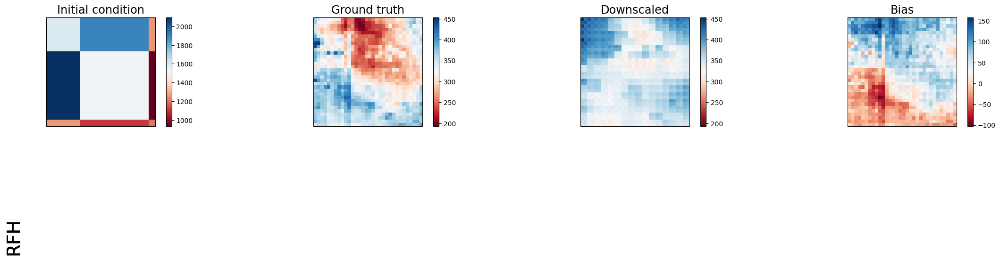

Selected device: cuda:0
+----------------------+----------------------+--------------------+------------------------+---------------------+
|                      | Coarse               | ClimaX             | Bilinear Interpolation | Weighted Mask       |
+----------------------+----------------------+--------------------+------------------------+---------------------+
| lat_weighted_mse_val | 1912163.0            | 3489.82470703125   | 2073689.625            | 1921707.75          |
| lat_weighted_rmse    | 1382.809814453125    | 59.074737548828125 | 1440.0311279296875     | 1386.2567138671875  |
| spearman             | 0.056413600255035064 | 0.2318690763709475 | 0.16585618177273265    | 0.14398905710612736 |
| mean_bias            | -1347.439208984375   | 33.259552001953125 | 1425.0751953125        | 1347.439208984375   |
| pearson              | 0.004866925963344475 | 0.2506432980170986 | 0.17611651521310057    | 0.11595752259224221 |
+----------------------+----------------------+-

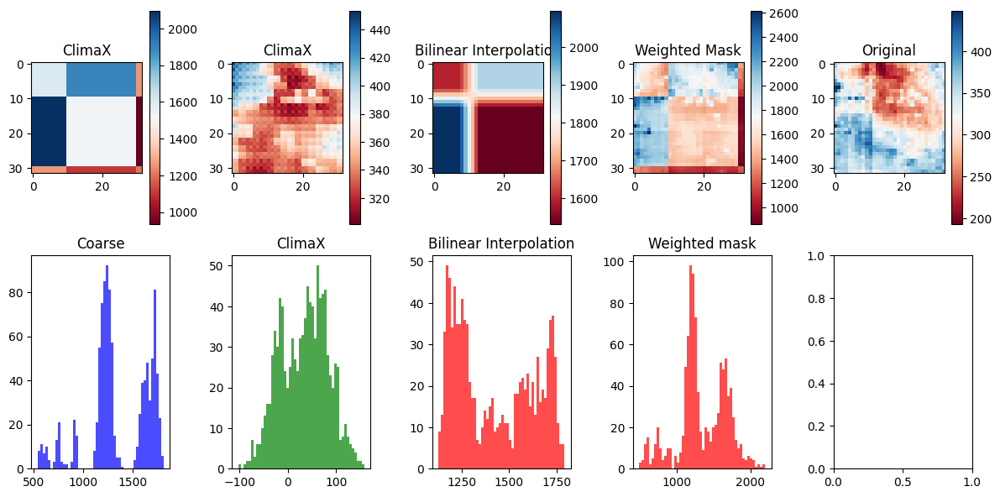

Time step 46
torch.Size([80, 1, 32, 32])


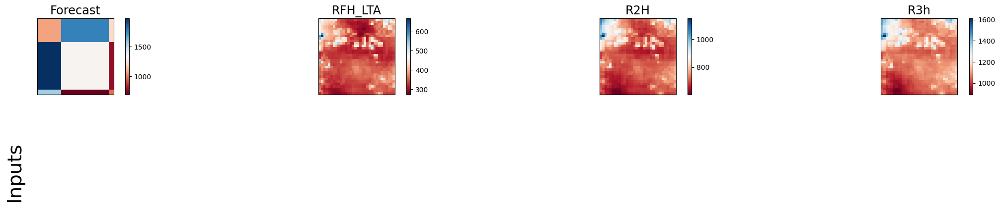

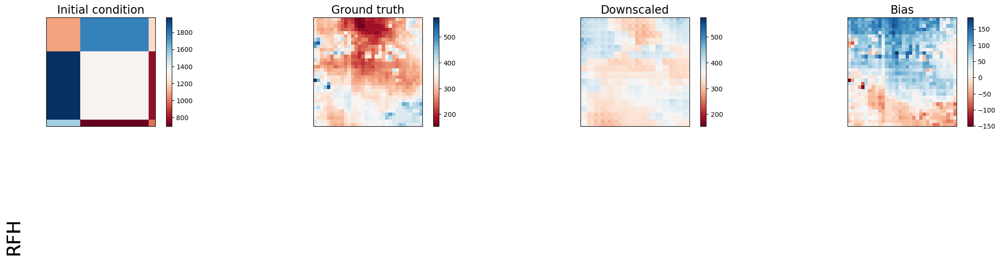

Selected device: cuda:0
+----------------------+---------------------+---------------------+------------------------+----------------------+
|                      | Coarse              | ClimaX              | Bilinear Interpolation | Weighted Mask        |
+----------------------+---------------------+---------------------+------------------------+----------------------+
| lat_weighted_mse_val | 1448535.5           | 4708.20947265625    | 1571760.5              | 1485384.5            |
| lat_weighted_rmse    | 1203.5511474609375  | 68.61639404296875   | 1253.69873046875       | 1218.7635498046875   |
| spearman             | 0.08872320460930784 | 0.4216891397995839  | -0.055744148894111195  | 0.028585101820489296 |
| mean_bias            | -1144.9189453125    | 42.739166259765625  | 1219.999755859375      | 1149.1083984375      |
| pearson              | 0.02013614159889738 | 0.46056168741771897 | -0.08004365669454211   | 0.048582528158643556 |
+----------------------+----------------

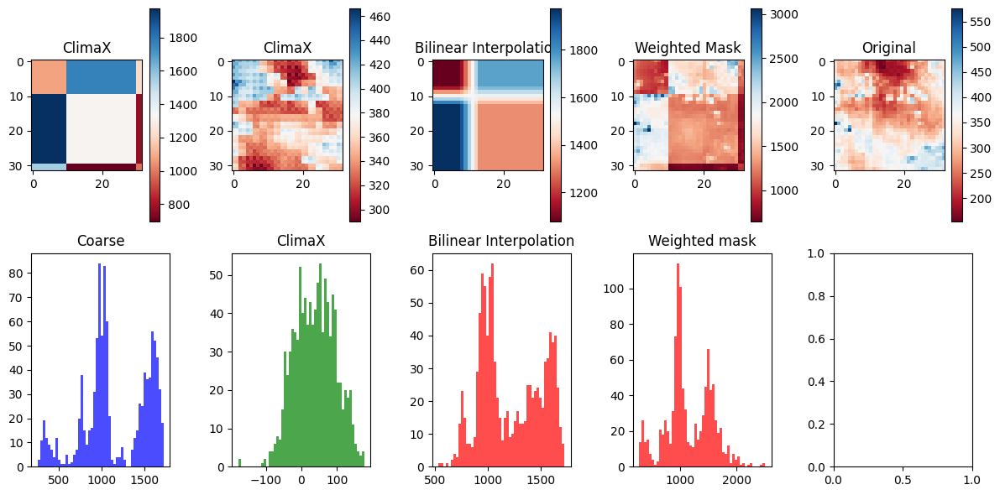

Time step 47
torch.Size([80, 1, 32, 32])


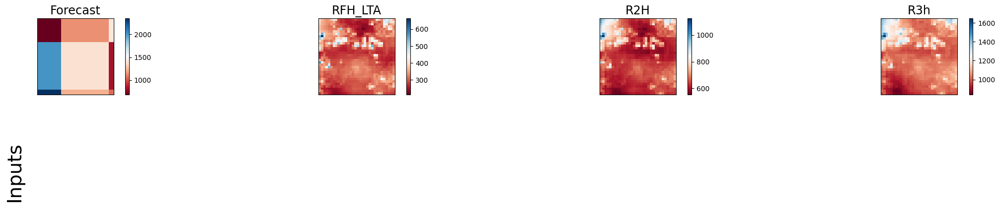

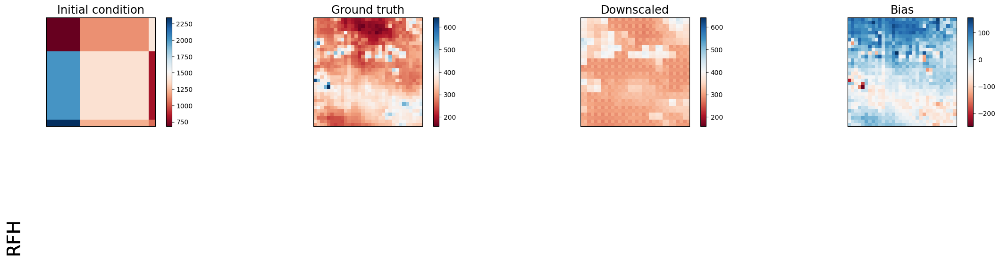

Selected device: cuda:0
+----------------------+---------------------+---------------------+------------------------+---------------------+
|                      | Coarse              | ClimaX              | Bilinear Interpolation | Weighted Mask       |
+----------------------+---------------------+---------------------+------------------------+---------------------+
| lat_weighted_mse_val | 1274880.75          | 3236.53076171875    | 1276554.25             | 1318100.0           |
| lat_weighted_rmse    | 1129.106201171875   | 56.8905143737793    | 1129.8470458984375     | 1148.0853271484375  |
| spearman             | 0.42561121980383626 | 0.47373256441918227 | 0.34117015013813135    | 0.5171316133981947  |
| mean_bias            | -1058.419189453125  | 9.696075439453125   | 1075.104248046875      | 1064.091064453125   |
| pearson              | 0.39174326719170544 | 0.46435122221520914 | 0.2653027065163246     | 0.48465248096854174 |
+----------------------+---------------------+--

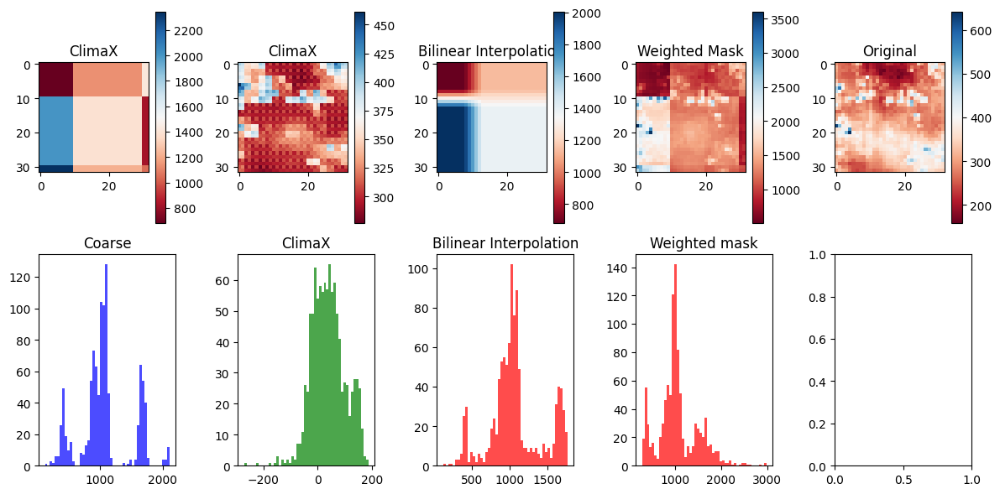

Time step 48
torch.Size([80, 1, 32, 32])


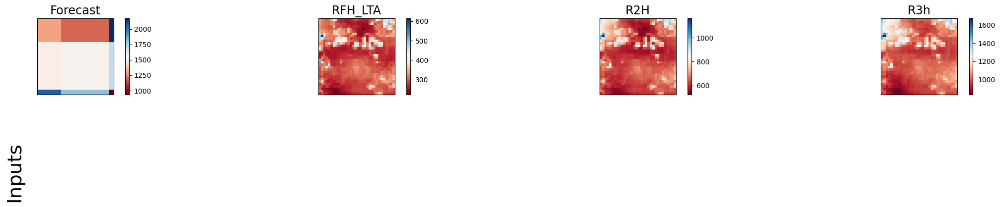

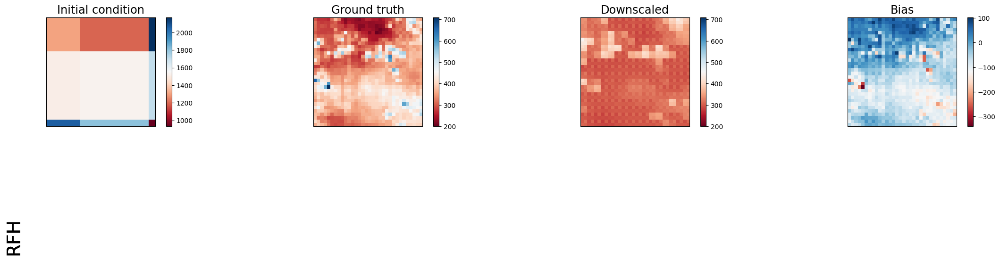

Selected device: cuda:0
+----------------------+---------------------+---------------------+------------------------+--------------------+
|                      | Coarse              | ClimaX              | Bilinear Interpolation | Weighted Mask      |
+----------------------+---------------------+---------------------+------------------------+--------------------+
| lat_weighted_mse_val | 1372216.5           | 5660.1943359375     | 1143888.875            | 1298303.75         |
| lat_weighted_rmse    | 1171.41650390625    | 75.23426055908203   | 1069.5274658203125     | 1139.4312744140625 |
| spearman             | 0.2599841591584188  | 0.42258173618034844 | 0.4664588768077865     | 0.7452149138931276 |
| mean_bias            | -1154.939208984375  | -45.070068359375    | 1062.65966796875       | 1113.626708984375  |
| pearson              | 0.38895475793200907 | 0.4321914670513948  | 0.42007979154350356    | 0.7182751562687182 |
+----------------------+---------------------+----------

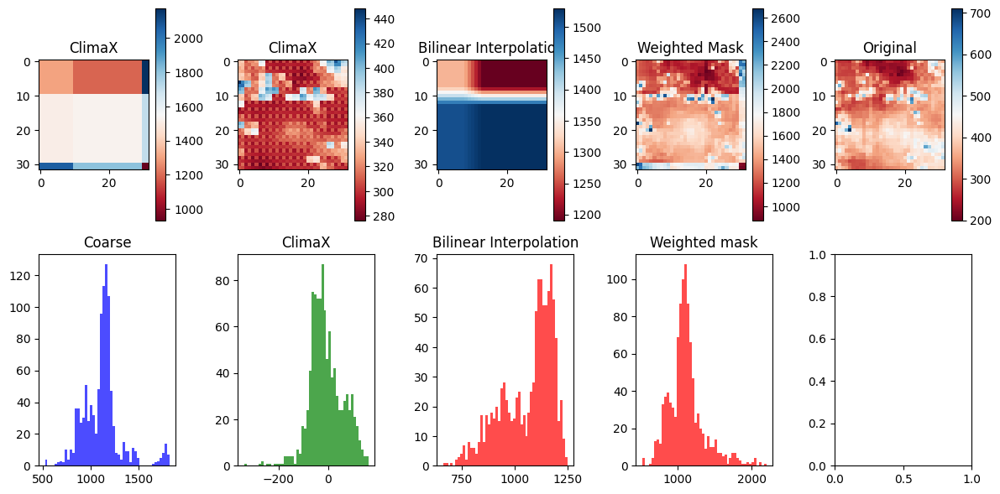

Time step 49
torch.Size([80, 1, 32, 32])


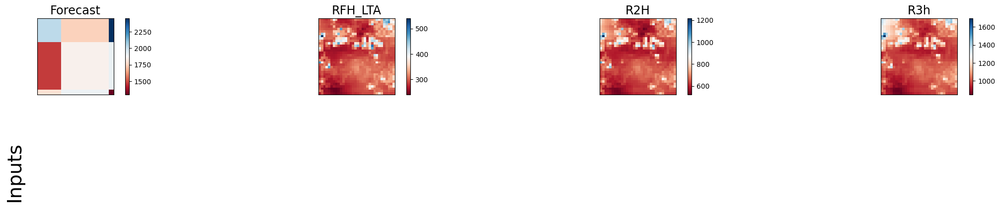

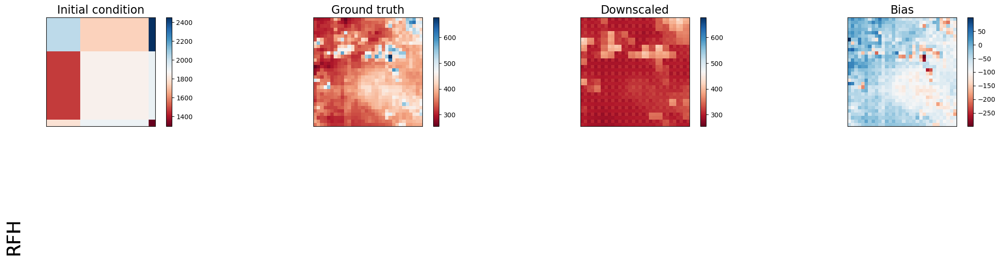

Selected device: cuda:0
+----------------------+----------------------+--------------------+------------------------+--------------------+
|                      | Coarse               | ClimaX             | Bilinear Interpolation | Weighted Mask      |
+----------------------+----------------------+--------------------+------------------------+--------------------+
| lat_weighted_mse_val | 2189320.25           | 5610.33740234375   | 1939509.5              | 2041831.25         |
| lat_weighted_rmse    | 1479.6351318359375   | 74.90218353271484  | 1392.6627197265625     | 1428.9266357421875 |
| spearman             | -0.12751163119067313 | 0.6405384228120792 | 0.2333309707052174     | 0.5976293957252592 |
| mean_bias            | -1464.66455078125    | -60.7598876953125  | 1384.31396484375       | 1407.8909912109375 |
| pearson              | -0.22482040341712245 | 0.6504372788165858 | 0.22230074841229985    | 0.7029370455015225 |
+----------------------+----------------------+---------

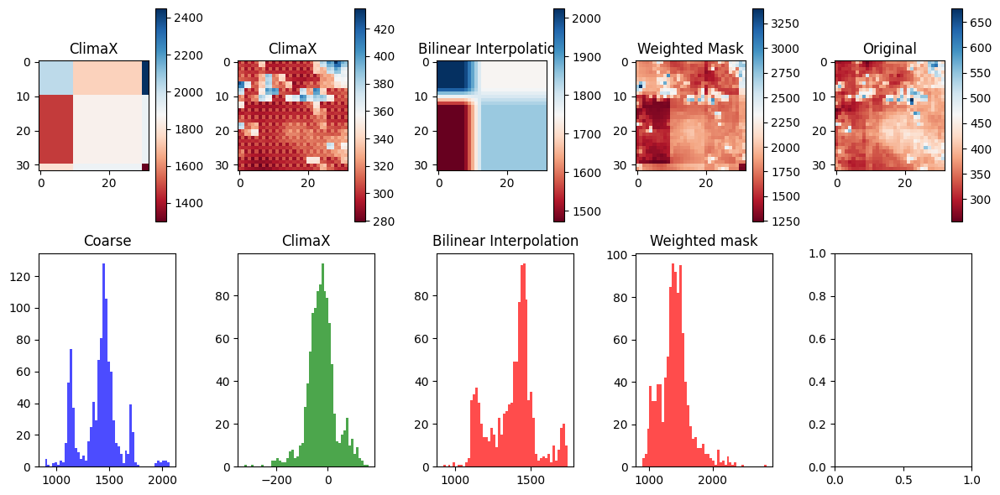

Time step 50
torch.Size([80, 1, 32, 32])


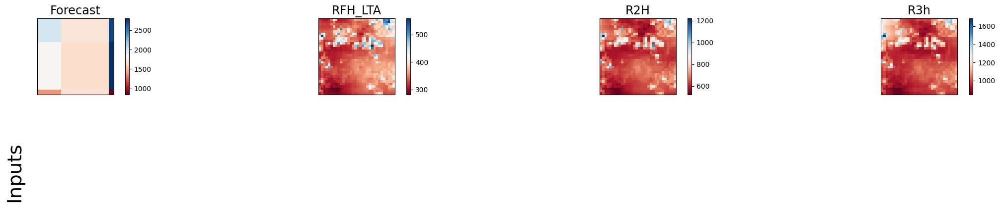

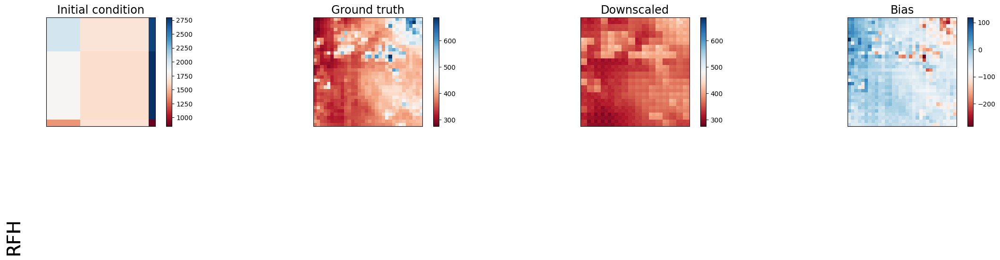

Selected device: cuda:0
+----------------------+---------------------+--------------------+------------------------+---------------------+
|                      | Coarse              | ClimaX             | Bilinear Interpolation | Weighted Mask       |
+----------------------+---------------------+--------------------+------------------------+---------------------+
| lat_weighted_mse_val | 2205313.75          | 3638.124267578125  | 1792257.25             | 2000454.0           |
| lat_weighted_rmse    | 1485.0299072265625  | 60.316864013671875 | 1338.7520751953125     | 1414.3740234375     |
| spearman             | 0.1540689159071726  | 0.8257288275532084 | -0.5097854936212525    | 0.14490881788464152 |
| mean_bias            | -1458.7545166015625 | -43.3175048828125  | 1330.933349609375      | 1380.08642578125    |
| pearson              | 0.1145759917417763  | 0.8002762190738364 | -0.4517377822391753    | 0.3724769990043496  |
+----------------------+---------------------+----------

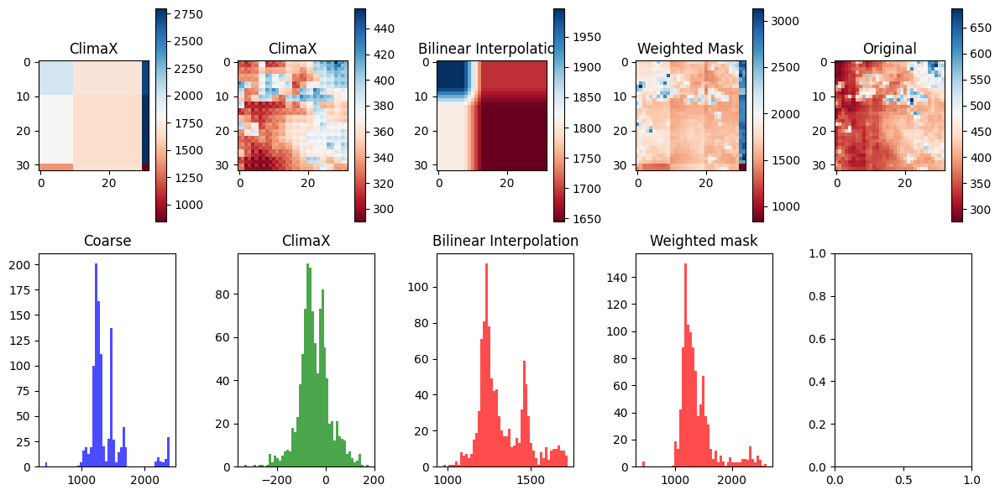

Time step 51
torch.Size([80, 1, 32, 32])


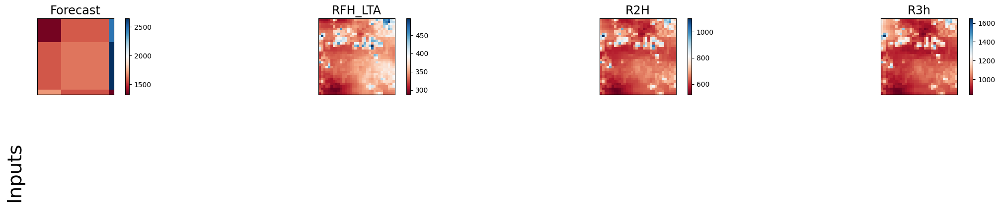

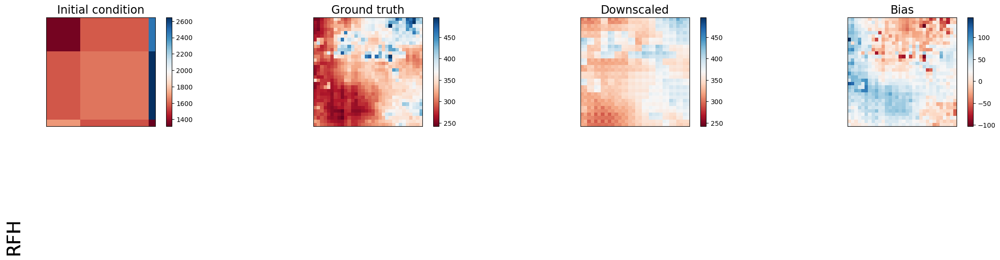

Selected device: cuda:0
+----------------------+----------------------+--------------------+------------------------+---------------------+
|                      | Coarse               | ClimaX             | Bilinear Interpolation | Weighted Mask       |
+----------------------+----------------------+--------------------+------------------------+---------------------+
| lat_weighted_mse_val | 1778307.75           | 1585.1907958984375 | 1541808.75             | 1756897.25          |
| lat_weighted_rmse    | 1333.5321044921875   | 39.814453125       | 1241.6959228515625     | 1325.47998046875    |
| spearman             | -0.15148761152317664 | 0.742459094458644  | 0.19790680720881704    | 0.3288856828479776  |
| mean_bias            | -1309.1907958984375  | 22.63494873046875  | 1238.76611328125       | 1299.198486328125   |
| pearson              | 0.07425791703628724  | 0.7489902387212728 | 0.118964803249746      | 0.35196057479927734 |
+----------------------+----------------------+-

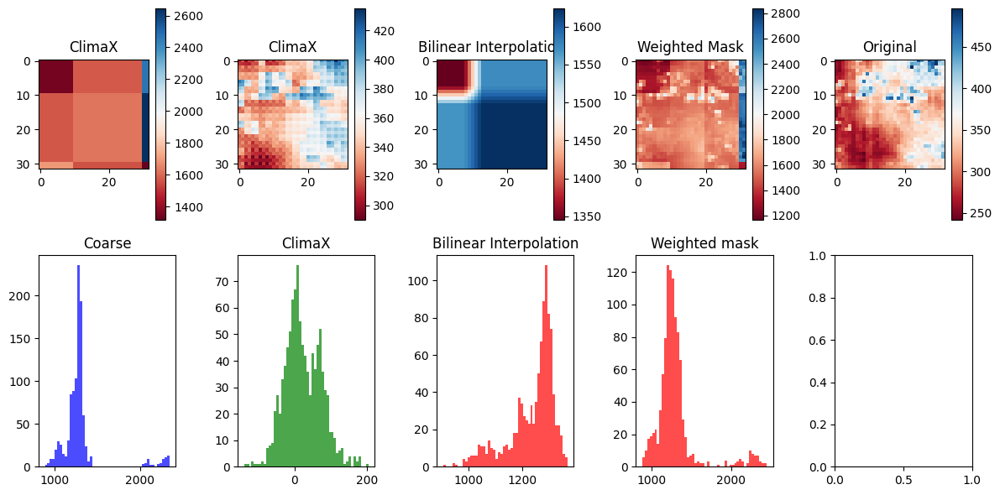

Time step 52
torch.Size([80, 1, 32, 32])


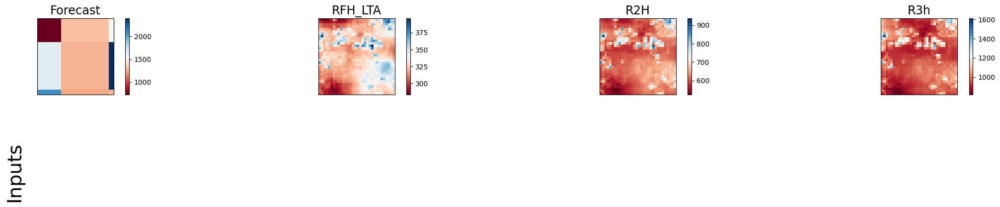

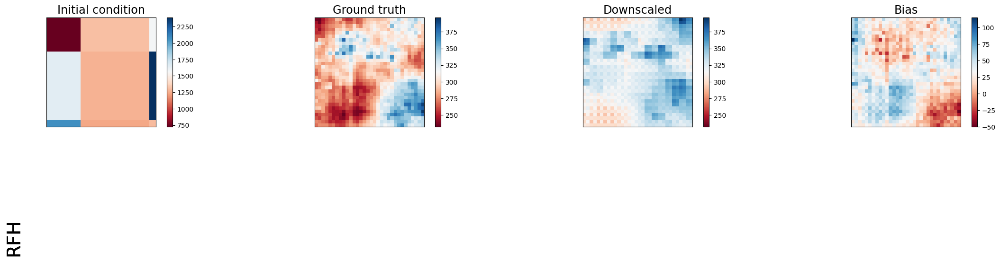

Selected device: cuda:0
+----------------------+--------------------+--------------------+------------------------+---------------------+
|                      | Coarse             | ClimaX             | Bilinear Interpolation | Weighted Mask       |
+----------------------+--------------------+--------------------+------------------------+---------------------+
| lat_weighted_mse_val | 1188476.375        | 1392.4072265625    | 1056841.125            | 1241267.625         |
| lat_weighted_rmse    | 1090.172607421875  | 37.314971923828125 | 1028.02783203125       | 1114.1219482421875  |
| spearman             | 0.2058140105232428 | 0.7307427922478801 | -0.2911174393352152    | 0.05578509883638822 |
| mean_bias            | -1040.658203125    | 29.798431396484375 | 1001.41064453125       | 1061.5635986328125  |
| pearson              | 0.2642198663833506 | 0.704431799644639  | -0.17315788744917804   | 0.05142801876526768 |
+----------------------+--------------------+-------------------

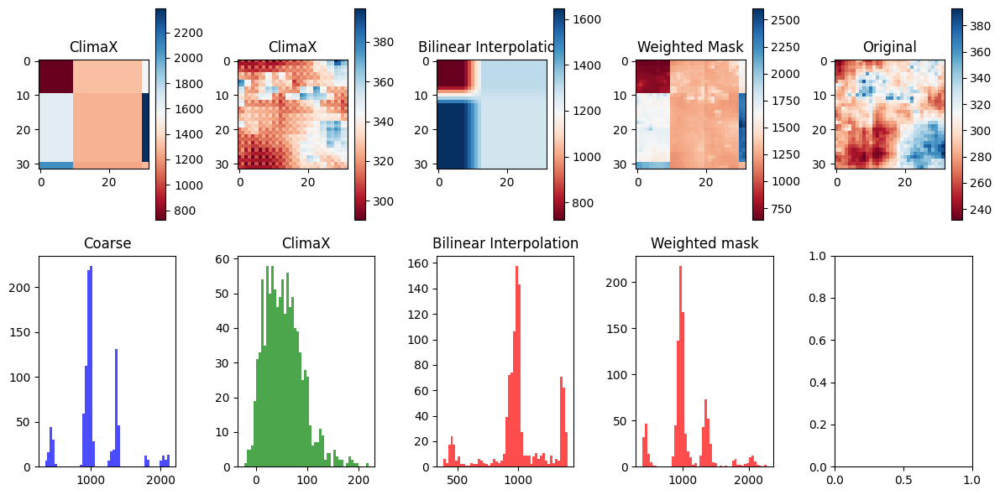

Time step 53
torch.Size([80, 1, 32, 32])


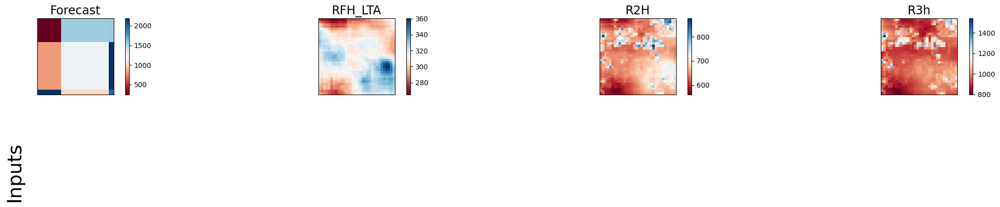

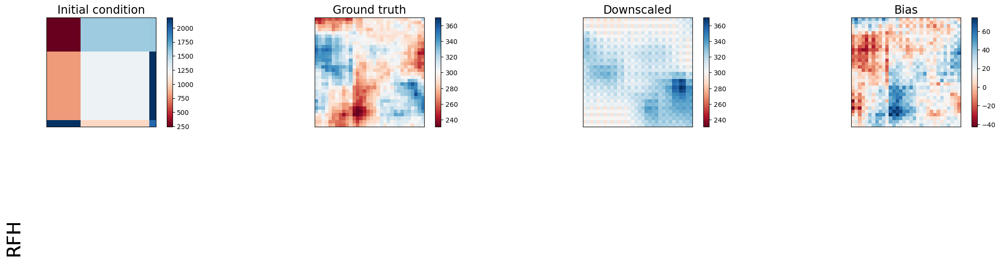

Selected device: cuda:0
+----------------------+---------------------+--------------------+------------------------+----------------------+
|                      | Coarse              | ClimaX             | Bilinear Interpolation | Weighted Mask        |
+----------------------+---------------------+--------------------+------------------------+----------------------+
| lat_weighted_mse_val | 962735.625          | 605.102294921875   | 797839.0               | 993409.9375          |
| lat_weighted_rmse    | 981.19091796875     | 24.598827362060547 | 893.2183227539062      | 996.6995239257812    |
| spearman             | -0.3490788332596767 | 0.5946245416899052 | -0.1678143555885082    | -0.07014261599054993 |
| mean_bias            | -861.165283203125   | 15.718536376953125 | 812.238525390625       | 883.1182861328125    |
| pearson              | -0.229262962705151  | 0.5996727969755016 | -0.16749622621214721   | -0.12476040880883071 |
+----------------------+---------------------+--

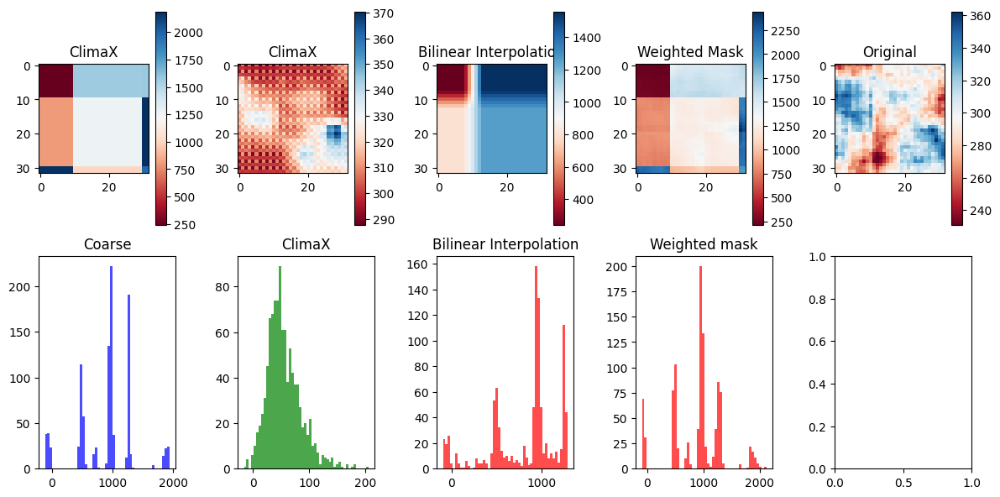

Time step 54
torch.Size([80, 1, 32, 32])


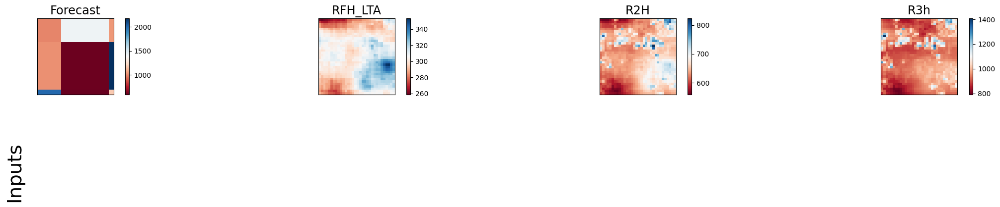

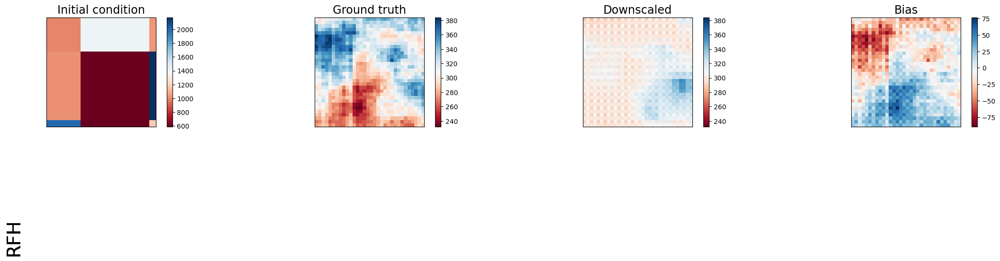

Selected device: cuda:0
+----------------------+----------------------+---------------------+------------------------+--------------------+
|                      | Coarse               | ClimaX              | Bilinear Interpolation | Weighted Mask      |
+----------------------+----------------------+---------------------+------------------------+--------------------+
| lat_weighted_mse_val | 614741.25            | 953.1278686523438   | 447549.78125           | 615201.9375        |
| lat_weighted_rmse    | 784.0543823242188    | 30.87276840209961   | 668.9916381835938      | 784.3480834960938  |
| spearman             | -0.09257176198990498 | 0.13823711662196247 | 0.32714377638046854    | 0.403036834580867  |
| mean_bias            | -657.3489990234375   | -3.54705810546875   | 605.464111328125       | 666.3948974609375  |
| pearson              | -0.10348539483340088 | 0.18180367559916205 | 0.3380225393293424     | 0.2750808575977993 |
+----------------------+----------------------+-

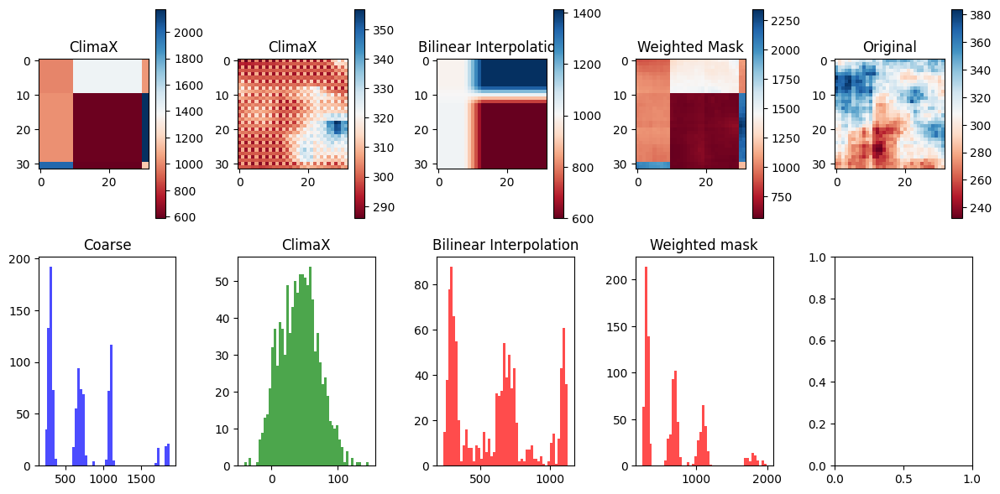

Time step 55
torch.Size([80, 1, 32, 32])


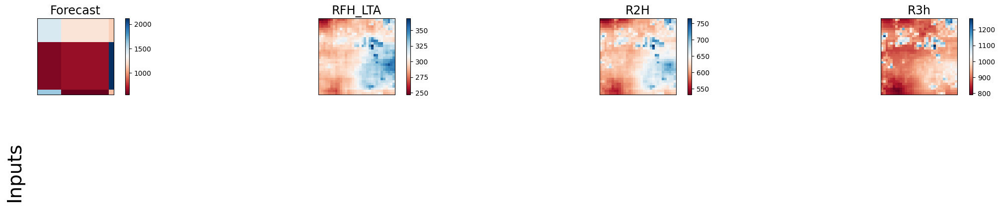

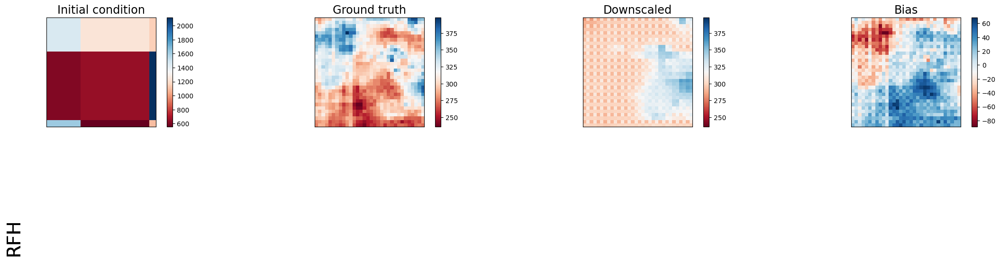

Selected device: cuda:0
+----------------------+----------------------+---------------------+------------------------+---------------------+
|                      | Coarse               | ClimaX              | Bilinear Interpolation | Weighted Mask       |
+----------------------+----------------------+---------------------+------------------------+---------------------+
| lat_weighted_mse_val | 539326.75            | 951.890625          | 395430.21875           | 538734.3125         |
| lat_weighted_rmse    | 734.388671875        | 30.852724075317383  | 628.8323974609375      | 733.9852294921875   |
| spearman             | -0.42142947089971516 | 0.08773369199294327 | 0.4049073794139854     | 0.40248536394014833 |
| mean_bias            | -603.21826171875     | 4.36370849609375    | 560.1815185546875      | 618.32275390625     |
| pearson              | -0.23064893184254387 | 0.17813160633592257 | 0.4694313896996888     | 0.4386913006740969  |
+----------------------+----------------

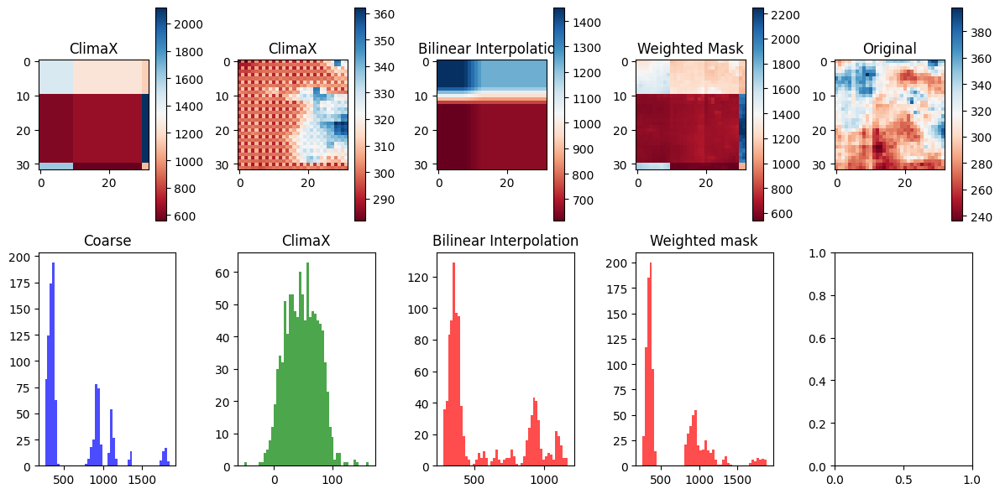

Time step 56
torch.Size([80, 1, 32, 32])


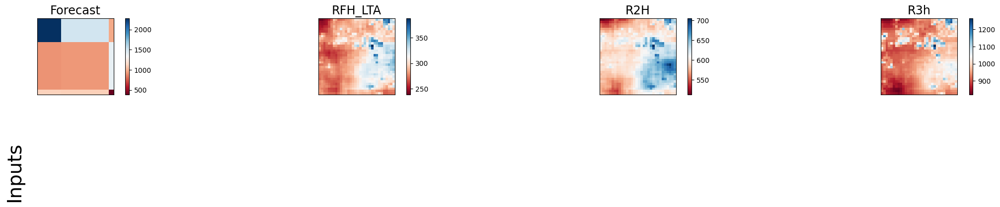

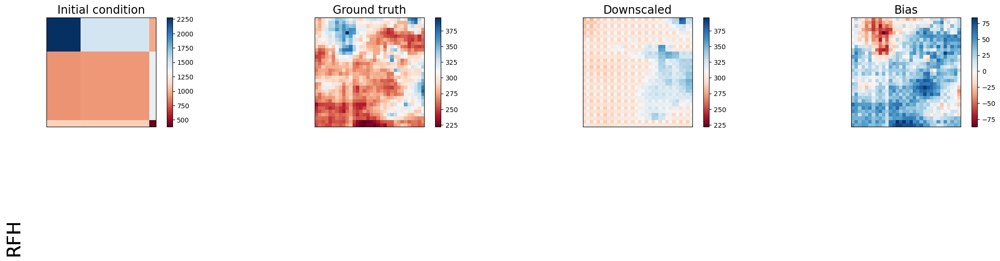

Selected device: cuda:0
+----------------------+---------------------+---------------------+------------------------+---------------------+
|                      | Coarse              | ClimaX              | Bilinear Interpolation | Weighted Mask       |
+----------------------+---------------------+---------------------+------------------------+---------------------+
| lat_weighted_mse_val | 960586.875          | 1195.38037109375    | 996248.375             | 1000031.3125        |
| lat_weighted_rmse    | 980.0953369140625   | 34.57427215576172   | 998.1224365234375      | 1000.0156860351562  |
| spearman             | -0.4438143524414027 | 0.25673170000645046 | 0.41923936383120924    | 0.40926707412849156 |
| mean_bias            | -872.10205078125    | 20.436248779296875  | 910.783935546875       | 905.80615234375     |
| pearson              | -0.2720124046685872 | 0.3118413302491896  | 0.43368527159530507    | 0.4927082467047962  |
+----------------------+---------------------+--

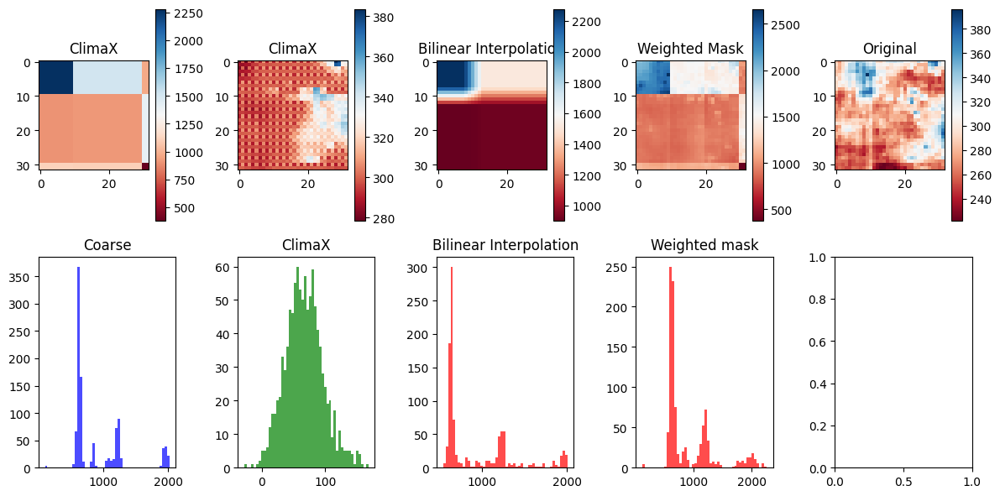

Time step 57
torch.Size([80, 1, 32, 32])


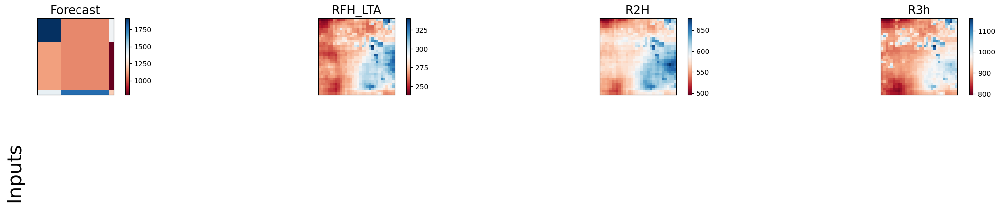

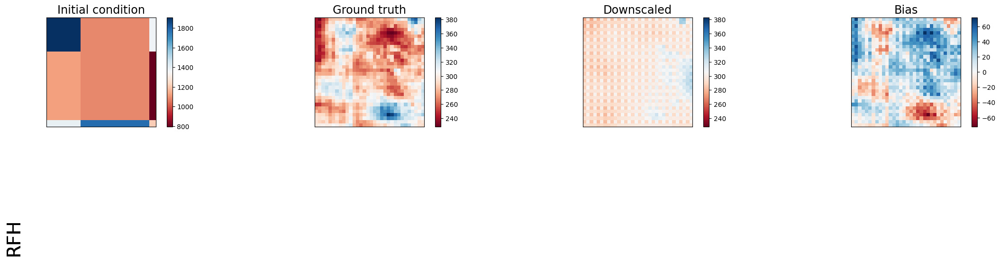

Selected device: cuda:0
+----------------------+---------------------+---------------------+------------------------+----------------------+
|                      | Coarse              | ClimaX              | Bilinear Interpolation | Weighted Mask        |
+----------------------+---------------------+---------------------+------------------------+----------------------+
| lat_weighted_mse_val | 851108.0            | 674.05712890625     | 856335.125             | 910805.125           |
| lat_weighted_rmse    | 922.55517578125     | 25.962610244750977  | 925.3837890625         | 954.361083984375     |
| spearman             | 0.42505533489461356 | 0.15303639155054302 | 0.1893101736296086     | 0.25085308524999805  |
| mean_bias            | -878.6519775390625  | 10.40997314453125   | 894.886962890625       | 911.0367431640625    |
| pearson              | 0.08124243923154244 | 0.23026105903318136 | -0.06455561765444597   | 0.051110859766592076 |
+----------------------+----------------

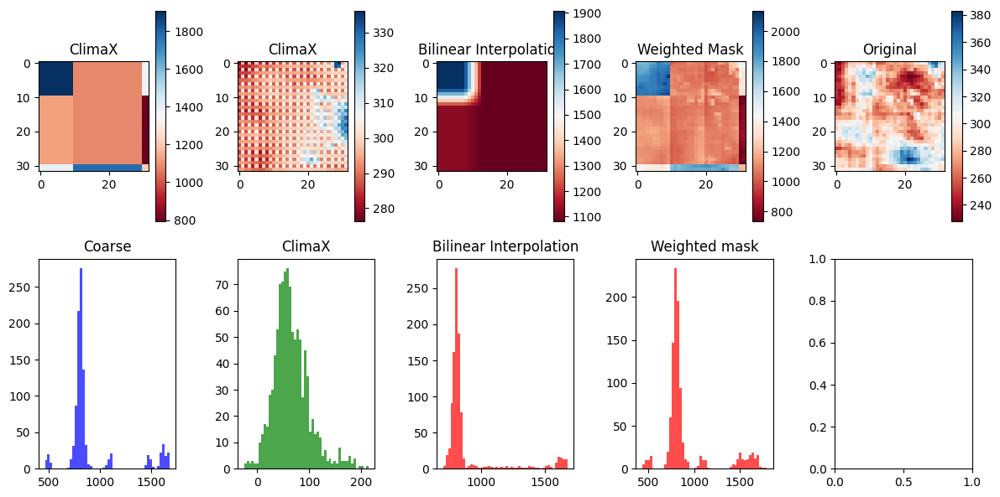

Time step 58
torch.Size([80, 1, 32, 32])


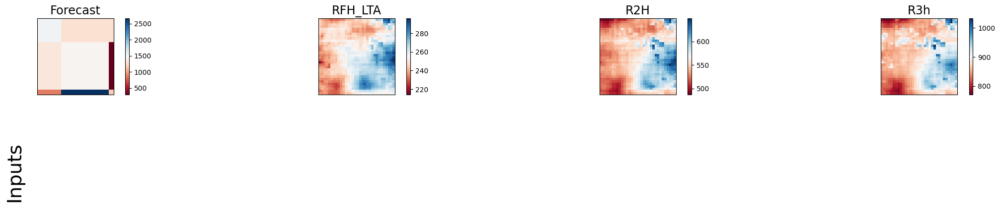

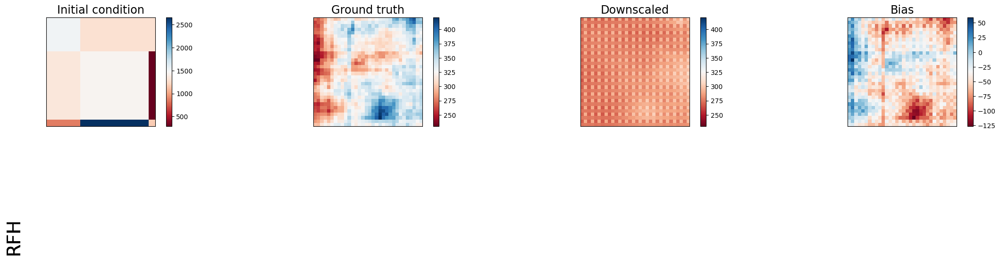

Selected device: cuda:0
+----------------------+---------------------+---------------------+------------------------+---------------------+
|                      | Coarse              | ClimaX              | Bilinear Interpolation | Weighted Mask       |
+----------------------+---------------------+---------------------+------------------------+---------------------+
| lat_weighted_mse_val | 1254782.375         | 2396.1845703125     | 1146827.75             | 1249499.125         |
| lat_weighted_rmse    | 1120.170654296875   | 48.95083999633789   | 1070.900390625         | 1117.8099365234375  |
| spearman             | 0.08159882961740851 | 0.35277470810402073 | 0.12294919052059777    | 0.18150582043168986 |
| mean_bias            | -1064.848388671875  | -39.9345703125      | 1068.49609375          | 1061.826171875      |
| pearson              | 0.06921485689714094 | 0.36878780266684275 | 0.049894230286516406   | 0.07186861149084786 |
+----------------------+---------------------+--

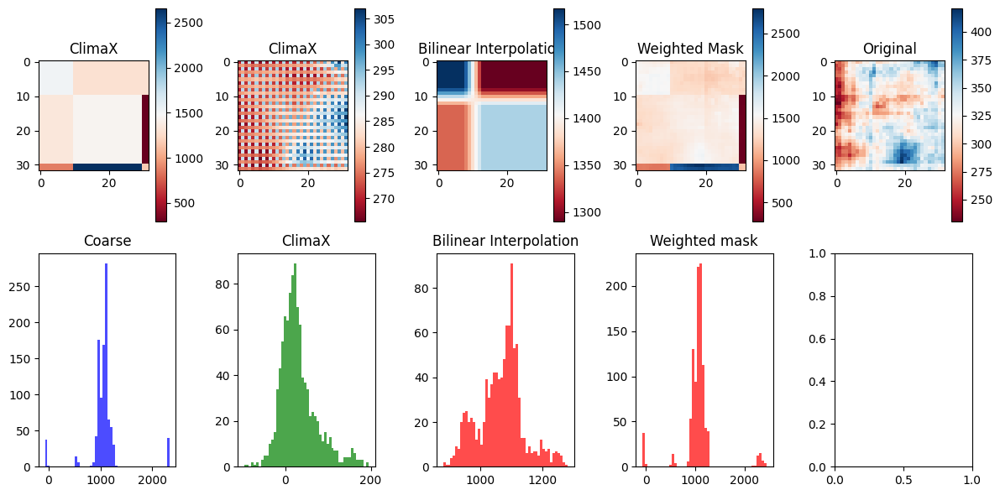

Time step 59
torch.Size([80, 1, 32, 32])


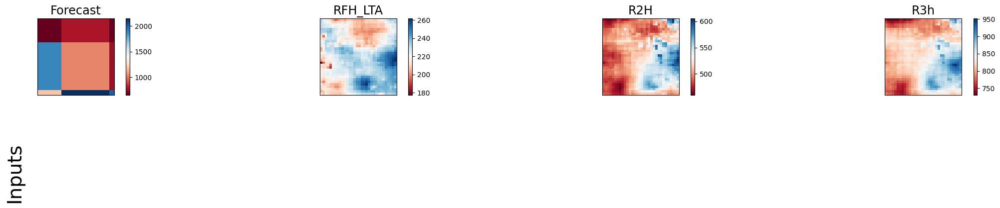

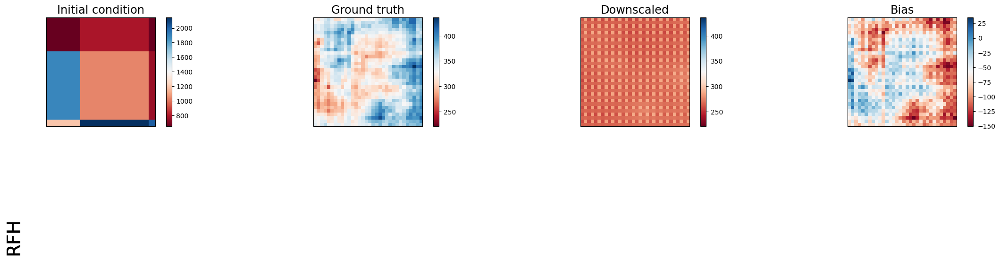

Selected device: cuda:0
+----------------------+---------------------+---------------------+------------------------+----------------------+
|                      | Coarse              | ClimaX              | Bilinear Interpolation | Weighted Mask        |
+----------------------+---------------------+---------------------+------------------------+----------------------+
| lat_weighted_mse_val | 875285.25           | 5831.509765625      | 781514.25              | 873972.75            |
| lat_weighted_rmse    | 935.5668334960938   | 76.36431884765625   | 884.032958984375       | 934.8651123046875    |
| spearman             | 0.46740741360114857 | 0.20806384916284817 | -0.3225453999117537    | -0.17428352376780962 |
| mean_bias            | -826.06640625       | -69.174560546875    | 785.675048828125       | 806.4619140625       |
| pearson              | 0.5018381108817844  | 0.1508902489053889  | -0.38732550203235416   | -0.25025810856160274 |
+----------------------+----------------

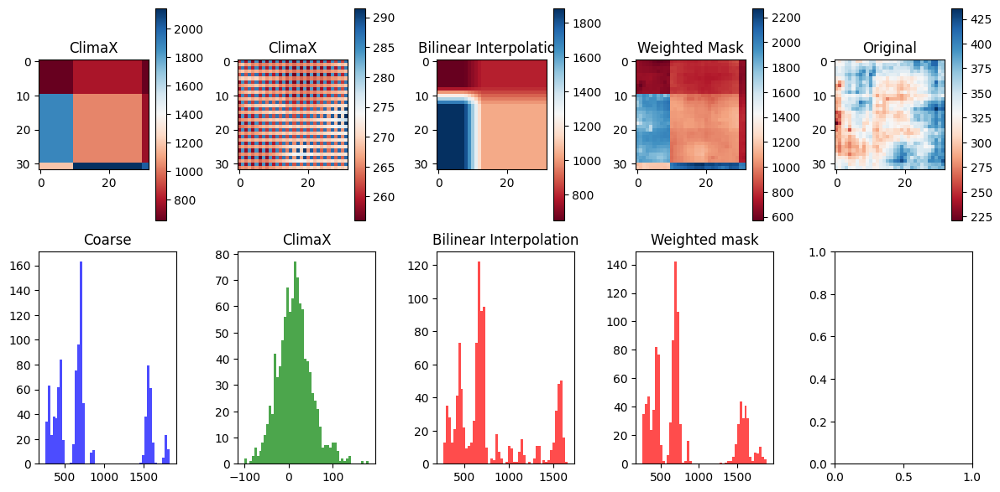

Time step 60
torch.Size([80, 1, 32, 32])


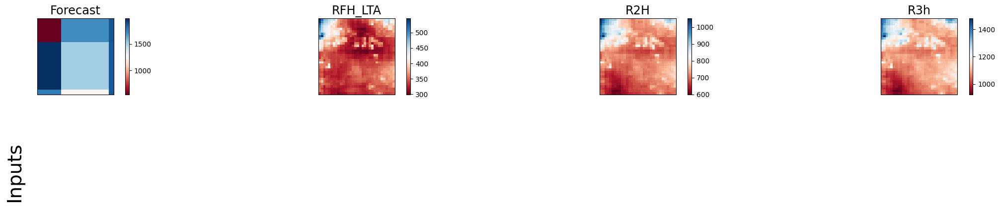

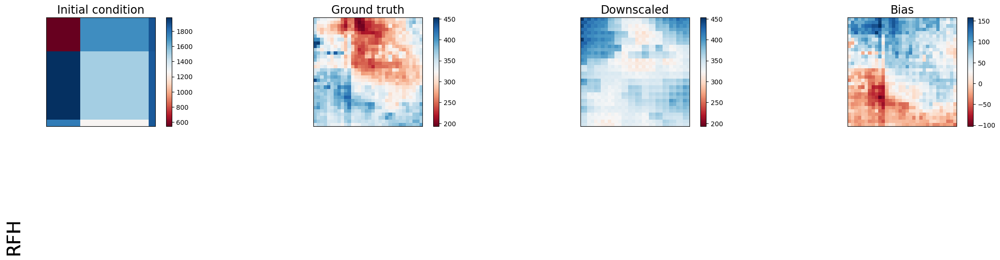

Selected device: cuda:0
+----------------------+---------------------+--------------------+------------------------+---------------------+
|                      | Coarse              | ClimaX             | Bilinear Interpolation | Weighted Mask       |
+----------------------+---------------------+--------------------+------------------------+---------------------+
| lat_weighted_mse_val | 1691815.875         | 3489.82470703125   | 1634899.75             | 1698814.75          |
| lat_weighted_rmse    | 1300.6982421875     | 59.074737548828125 | 1278.6319580078125     | 1303.3858642578125  |
| spearman             | 0.23479909253262546 | 0.2318690763709475 | 0.20802415533605795    | 0.28847508901812985 |
| mean_bias            | -1242.4658203125    | 33.259521484375    | 1230.1182861328125     | 1242.4658203125     |
| pearson              | 0.14880840664592476 | 0.250643301538743  | 0.1659024949376014     | 0.21345559640762812 |
+----------------------+---------------------+----------

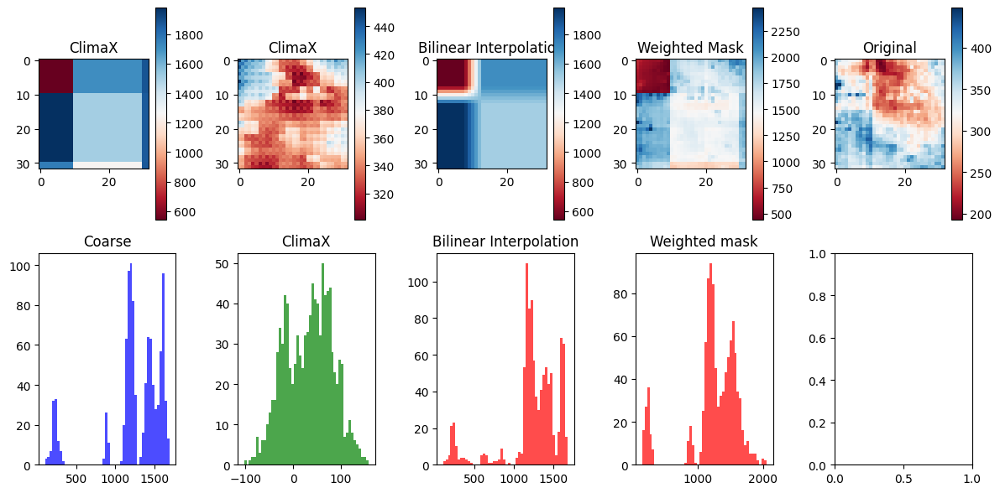

Time step 61
torch.Size([80, 1, 32, 32])


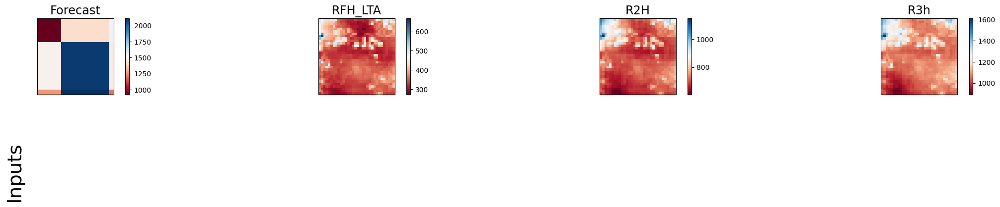

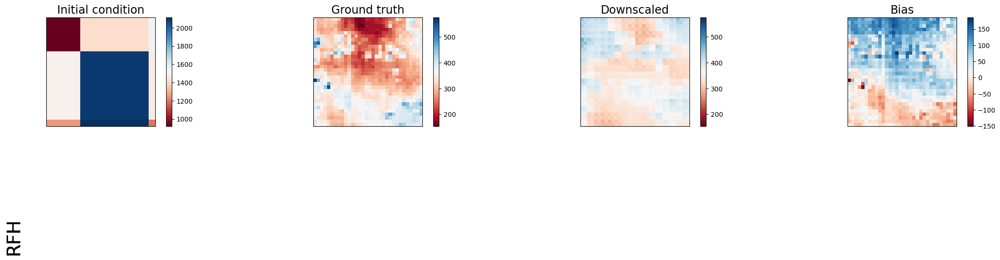

Selected device: cuda:0
+----------------------+----------------------+--------------------+------------------------+---------------------+
|                      | Coarse               | ClimaX             | Bilinear Interpolation | Weighted Mask       |
+----------------------+----------------------+--------------------+------------------------+---------------------+
| lat_weighted_mse_val | 1984069.875          | 4708.20947265625   | 1987600.875            | 2009942.25          |
| lat_weighted_rmse    | 1408.5701904296875   | 68.61639404296875  | 1409.822998046875      | 1417.724365234375   |
| spearman             | 0.15362029765225765  | 0.4216891397995839 | 0.19876334241118143    | 0.31390199171189853 |
| mean_bias            | -1351.4066162109375  | 42.73919677734375  | 1359.7469482421875     | 1355.595947265625   |
| pearson              | 0.028008182174462236 | 0.4605616982914137 | 0.1495391430760111     | 0.2812701287879356  |
+----------------------+----------------------+-

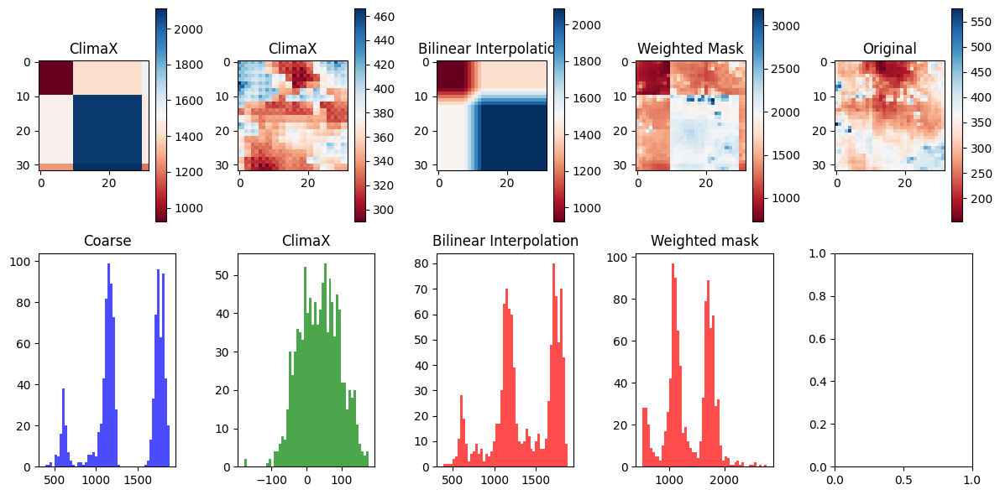

Time step 62
torch.Size([80, 1, 32, 32])


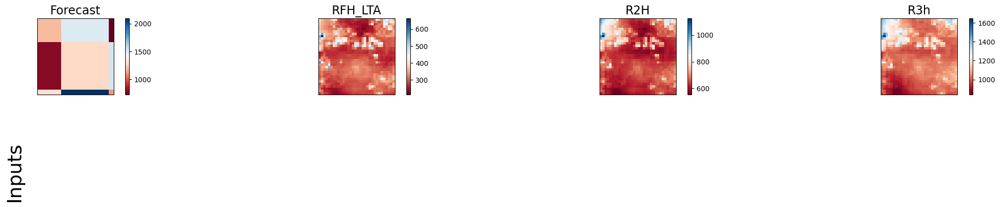

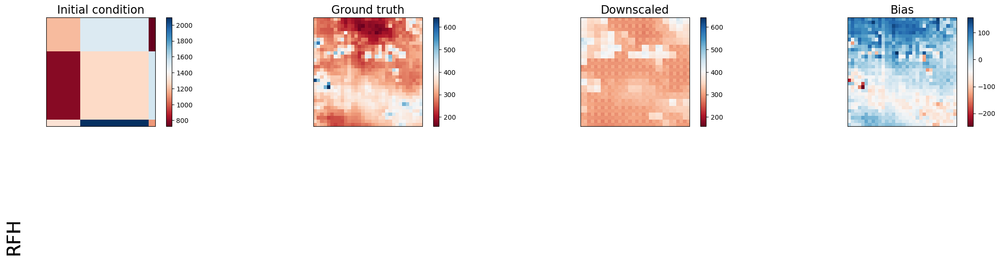

Selected device: cuda:0
+----------------------+---------------------+---------------------+------------------------+---------------------+
|                      | Coarse              | ClimaX              | Bilinear Interpolation | Weighted Mask       |
+----------------------+---------------------+---------------------+------------------------+---------------------+
| lat_weighted_mse_val | 963458.5            | 3236.530517578125   | 862700.75              | 990513.125          |
| lat_weighted_rmse    | 981.5592041015625   | 56.8905143737793    | 928.8168334960938      | 995.2452392578125   |
| spearman             | -0.3837129436746936 | 0.47373256441918227 | -0.27275837954531296   | 0.13936025013418227 |
| mean_bias            | -927.611328125      | 9.696075439453125   | 893.7086181640625      | 933.283203125       |
| pearson              | -0.3403690604641102 | 0.4643512306738782  | -0.26532611572618164   | 0.16528815903140331 |
+----------------------+---------------------+--

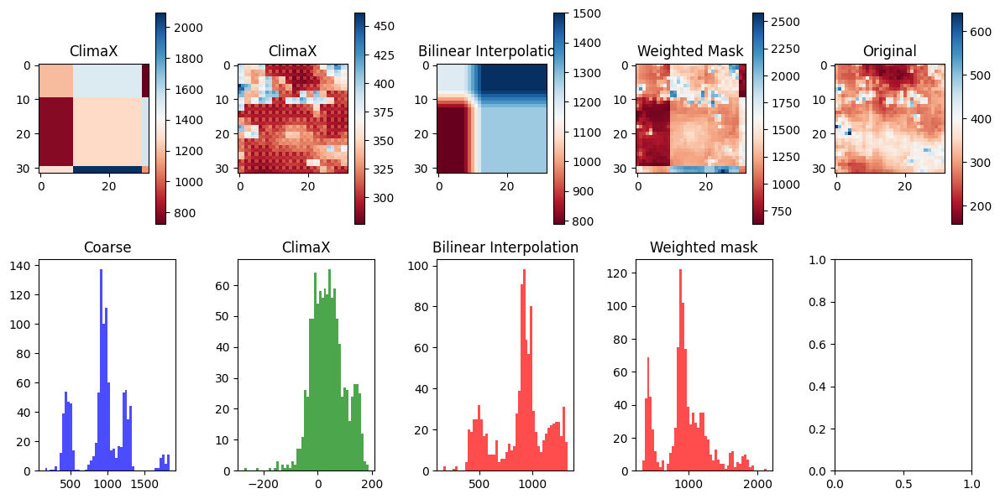

Time step 63
torch.Size([80, 1, 32, 32])


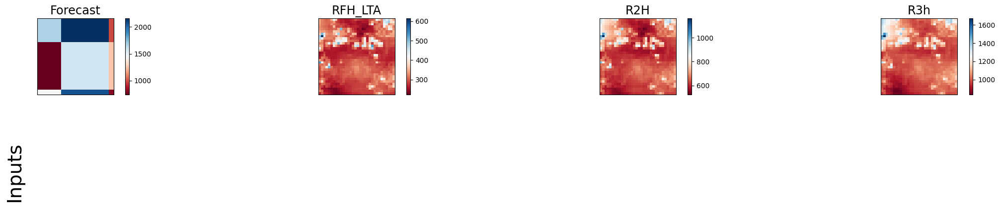

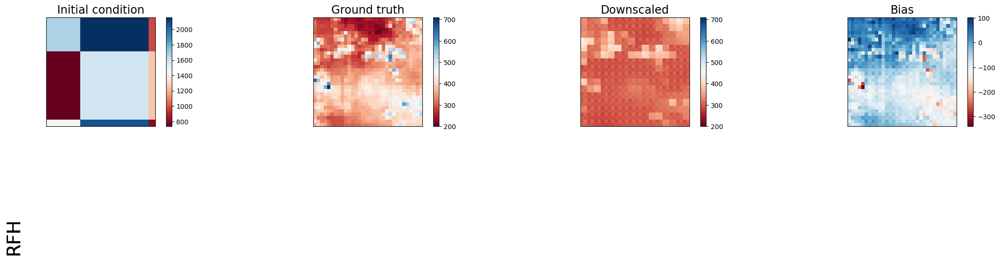

Selected device: cuda:0
+----------------------+---------------------+---------------------+------------------------+----------------------+
|                      | Coarse              | ClimaX              | Bilinear Interpolation | Weighted Mask        |
+----------------------+---------------------+---------------------+------------------------+----------------------+
| lat_weighted_mse_val | 1709833.625         | 5660.1943359375     | 1589897.875            | 1633787.75           |
| lat_weighted_rmse    | 1307.6060791015625  | 75.23426055908203   | 1260.9114990234375     | 1278.197021484375    |
| spearman             | -0.5341527059832434 | 0.42258173618034844 | -0.230598411345812     | 0.036487370458411654 |
| mean_bias            | -1207.573974609375  | -45.070068359375    | 1172.1224365234375     | 1166.261474609375    |
| pearson              | -0.5375089911558286 | 0.43219146708783746 | -0.18283670751085918   | 0.06890990741625987  |
+----------------------+----------------

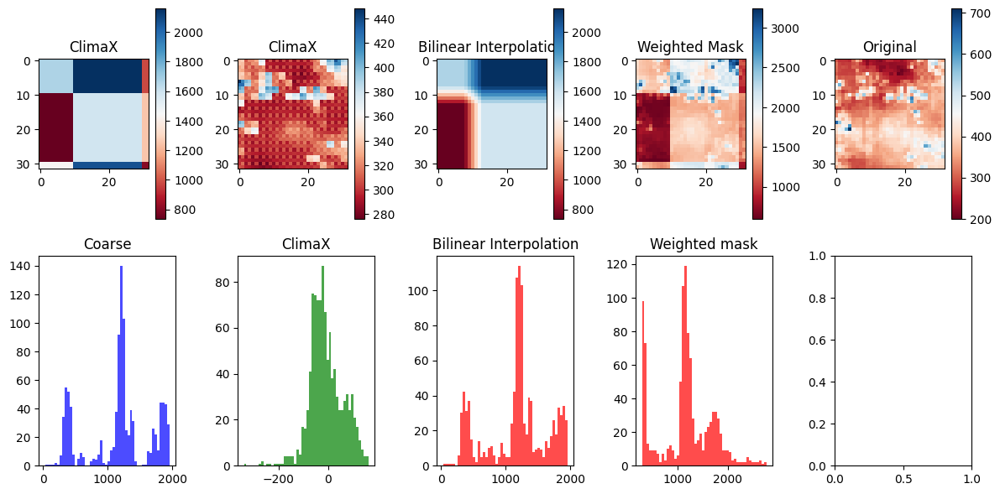

Time step 64
torch.Size([80, 1, 32, 32])


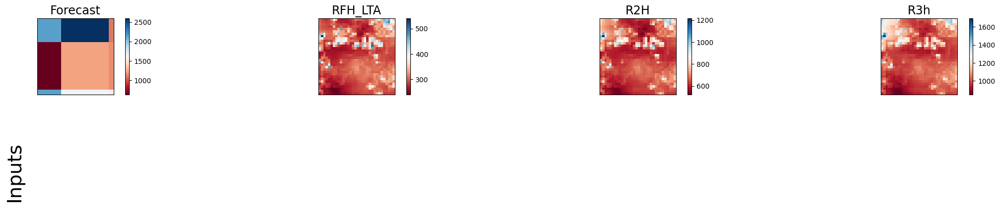

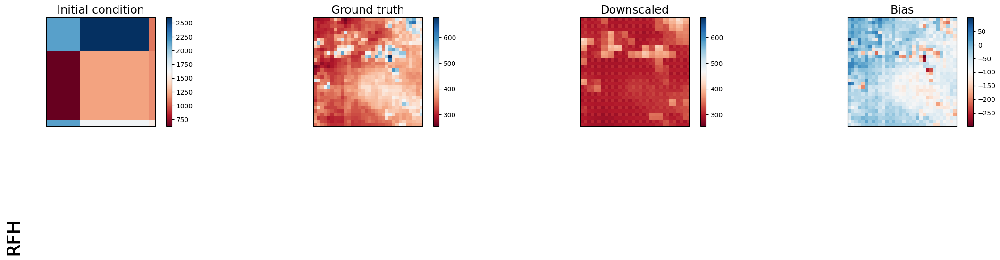

Selected device: cuda:0
+----------------------+---------------------+--------------------+------------------------+---------------------+
|                      | Coarse              | ClimaX             | Bilinear Interpolation | Weighted Mask       |
+----------------------+---------------------+--------------------+------------------------+---------------------+
| lat_weighted_mse_val | 1882058.0           | 5610.33740234375   | 1691534.0              | 1742991.0           |
| lat_weighted_rmse    | 1371.8812255859375  | 74.90218353271484  | 1300.58984375          | 1320.223876953125   |
| spearman             | -0.5131117961115893 | 0.6405379963270413 | 0.23023155455996194    | 0.2243265737798281  |
| mean_bias            | -1171.50830078125   | -60.7598876953125  | 1116.93896484375       | 1114.73486328125    |
| pearson              | -0.504776564156089  | 0.6504372668881118 | 0.17983543160265933    | 0.23157210874739353 |
+----------------------+---------------------+----------

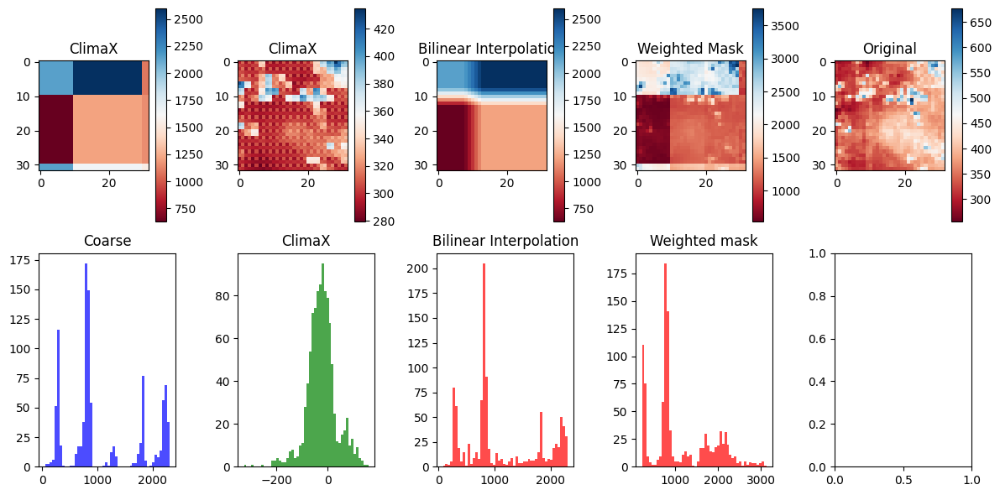

Time step 65
torch.Size([80, 1, 32, 32])


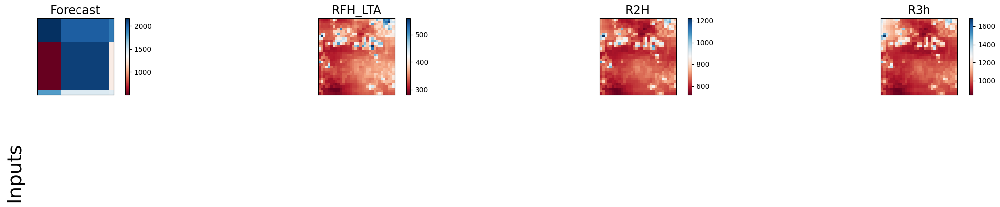

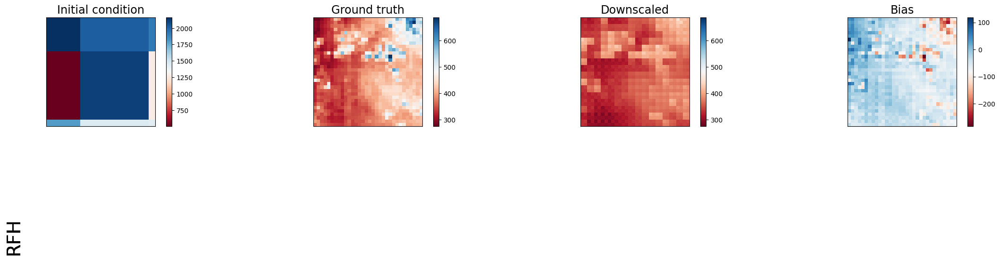

Selected device: cuda:0
+----------------------+----------------------+--------------------+------------------------+--------------------+
|                      | Coarse               | ClimaX             | Bilinear Interpolation | Weighted Mask      |
+----------------------+----------------------+--------------------+------------------------+--------------------+
| lat_weighted_mse_val | 2366367.25           | 3638.1240234375    | 2130690.25             | 2115048.0          |
| lat_weighted_rmse    | 1538.3001708984375   | 60.316864013671875 | 1459.6883544921875     | 1454.3204345703125 |
| spearman             | -0.33975749118959336 | 0.8257288275532084 | 0.31073980897256875    | 0.534802317655888  |
| mean_bias            | -1392.38037109375    | -43.3175048828125  | 1340.291748046875      | 1313.71240234375   |
| pearson              | -0.4775041387888452  | 0.8002762049153784 | 0.46574819323864447    | 0.5208542551548277 |
+----------------------+----------------------+---------

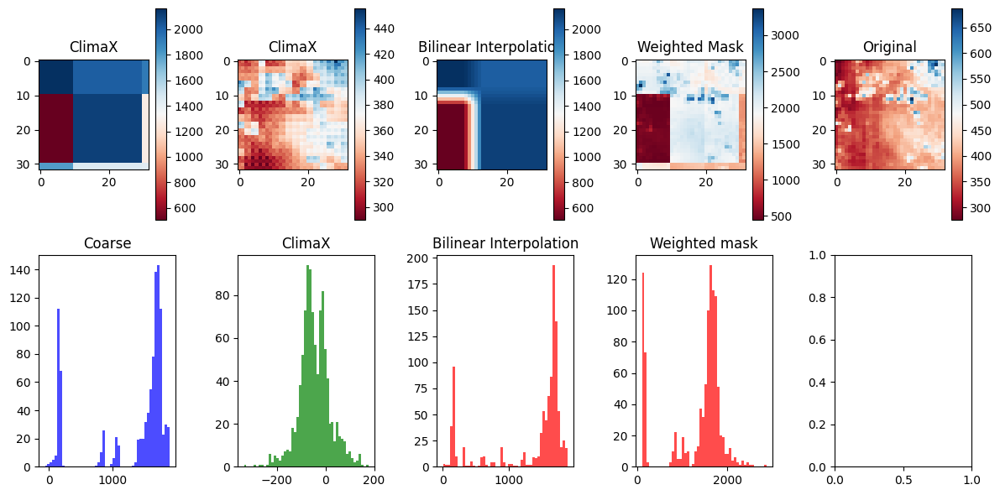

Time step 66
torch.Size([80, 1, 32, 32])


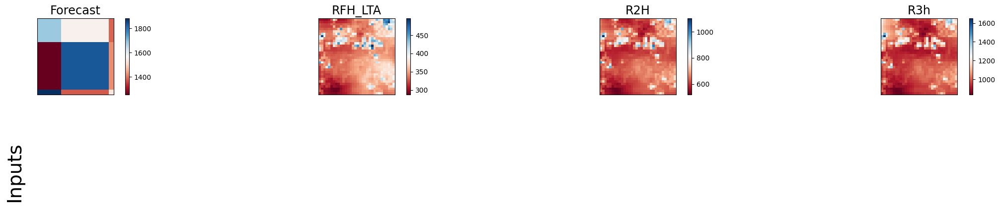

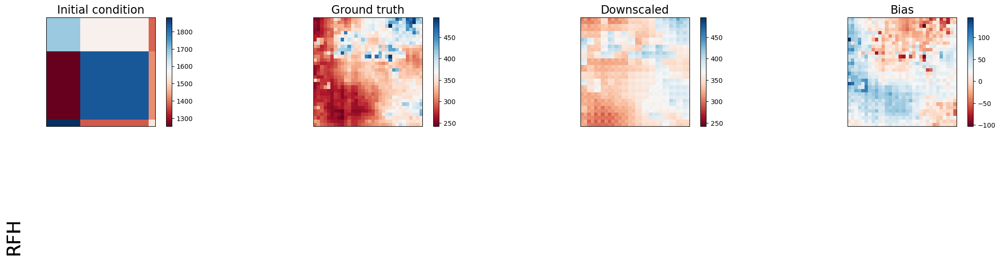

Selected device: cuda:0
+----------------------+---------------------+--------------------+------------------------+--------------------+
|                      | Coarse              | ClimaX             | Bilinear Interpolation | Weighted Mask      |
+----------------------+---------------------+--------------------+------------------------+--------------------+
| lat_weighted_mse_val | 1718483.75          | 1585.1907958984375 | 1716707.0              | 1689323.5          |
| lat_weighted_rmse    | 1310.9095458984375  | 39.814453125       | 1310.231689453125      | 1299.73974609375   |
| spearman             | -0.2893335153781068 | 0.742459094458644  | 0.2621555376659651     | 0.3390477977063359 |
| mean_bias            | -1287.76220703125   | 22.63494873046875  | 1295.71728515625       | 1277.77001953125   |
| pearson              | -0.3085581597034267 | 0.7489902613757113 | 0.33303130510978485    | 0.4018741253331506 |
+----------------------+---------------------+------------------

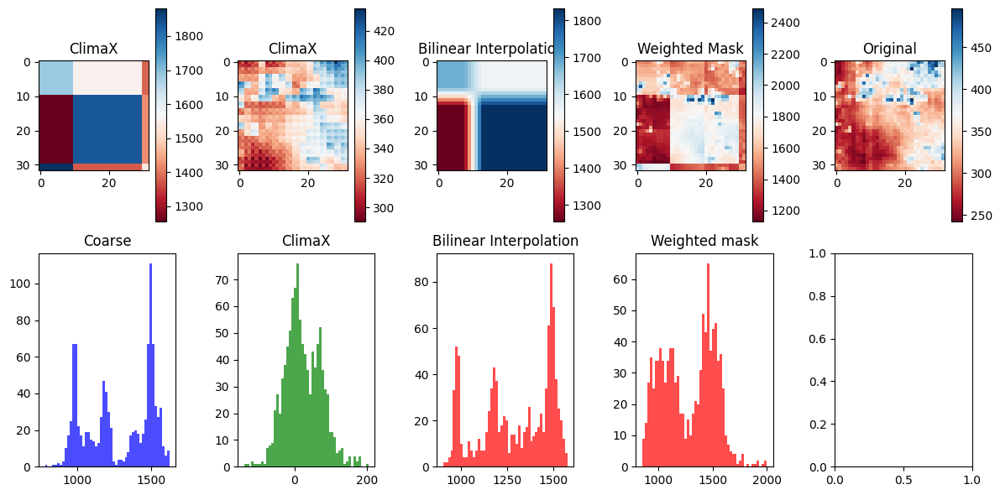

Time step 67
torch.Size([80, 1, 32, 32])


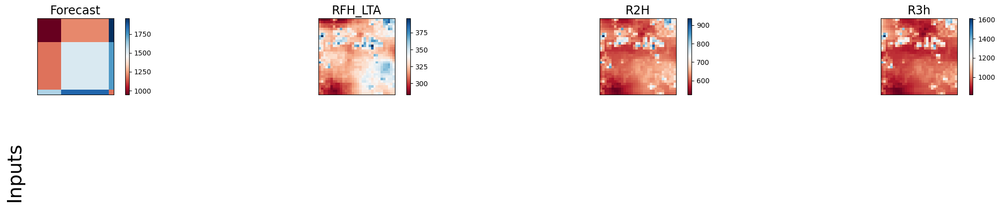

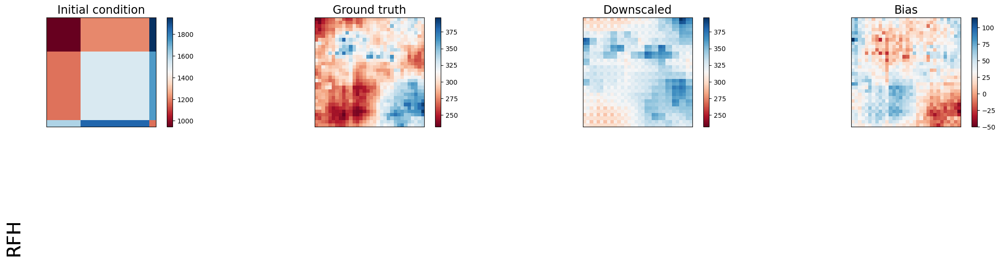

Selected device: cuda:0
+----------------------+----------------------+--------------------+------------------------+--------------------+
|                      | Coarse               | ClimaX             | Bilinear Interpolation | Weighted Mask      |
+----------------------+----------------------+--------------------+------------------------+--------------------+
| lat_weighted_mse_val | 1161485.5            | 1392.4071044921875 | 1063155.25             | 1204523.0          |
| lat_weighted_rmse    | 1077.722412109375    | 37.314971923828125 | 1031.09423828125       | 1097.5076904296875 |
| spearman             | -0.04458251139999338 | 0.7307427922478801 | 0.28309740172793674    | 0.3154596969638576 |
| mean_bias            | -1048.5169677734375  | 29.79840087890625  | 1014.3662109375        | 1069.4222412109375 |
| pearson              | 0.08073210294023409  | 0.7044318088176605 | 0.2679680846440172     | 0.3015014092168593 |
+----------------------+----------------------+---------

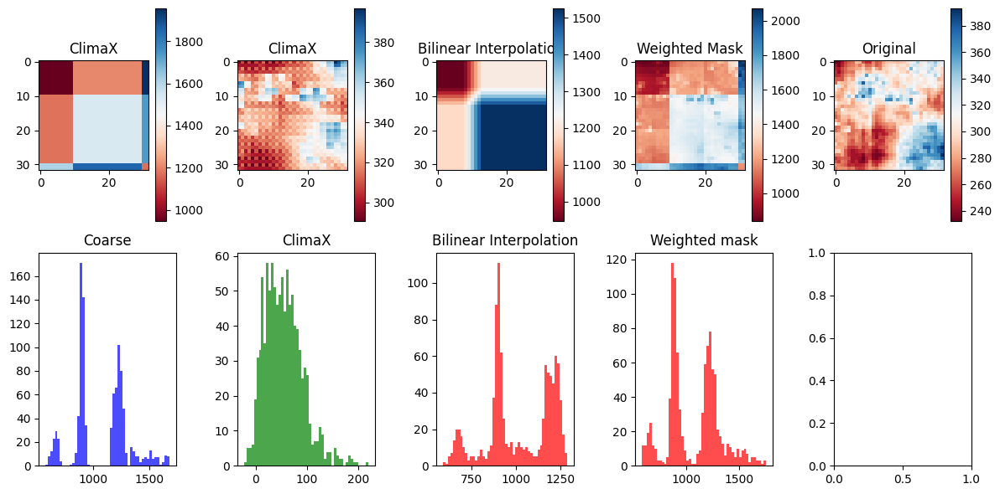

Time step 68
torch.Size([80, 1, 32, 32])


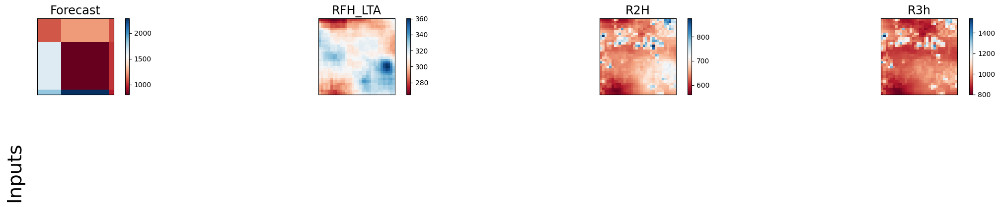

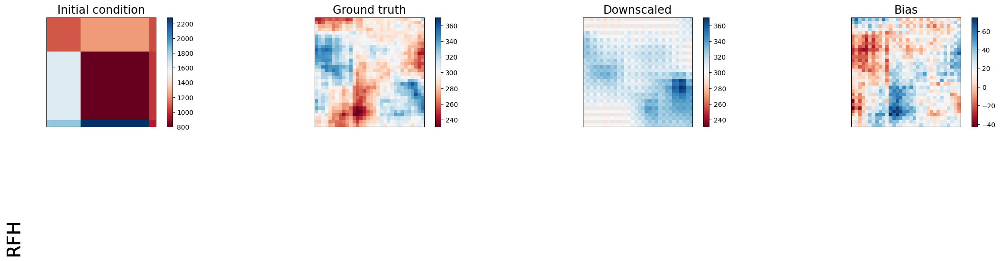

Selected device: cuda:0
+----------------------+---------------------+--------------------+------------------------+---------------------+
|                      | Coarse              | ClimaX             | Bilinear Interpolation | Weighted Mask       |
+----------------------+---------------------+--------------------+------------------------+---------------------+
| lat_weighted_mse_val | 860060.25           | 605.102294921875   | 747792.625             | 906649.4375         |
| lat_weighted_rmse    | 927.3943481445312   | 24.598827362060547 | 864.7500610351562      | 952.181396484375    |
| spearman             | 0.26244554993103214 | 0.5946230730431409 | 0.08012835938176618    | 0.2138769072367005  |
| mean_bias            | -845.072021484375   | 15.718536376953125 | 812.564208984375       | 867.02490234375     |
| pearson              | 0.31752280828433327 | 0.5996727703413889 | 0.1133196658210624     | 0.14265104069344078 |
+----------------------+---------------------+----------

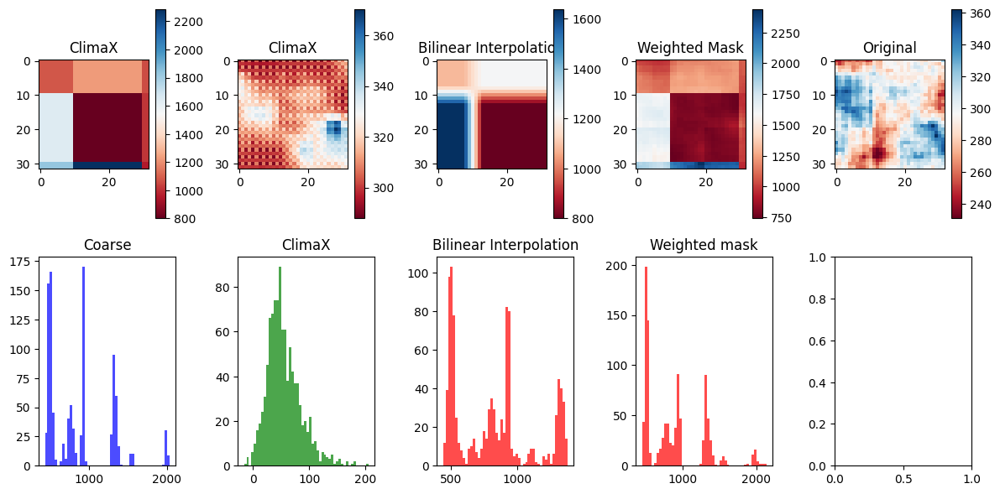

Time step 69
torch.Size([80, 1, 32, 32])


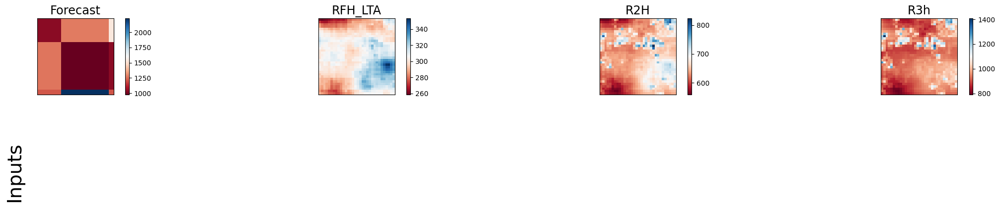

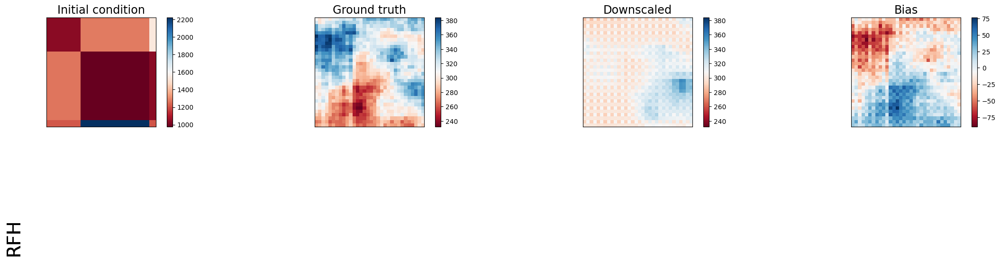

Selected device: cuda:0
+----------------------+----------------------+---------------------+------------------------+----------------------+
|                      | Coarse               | ClimaX              | Bilinear Interpolation | Weighted Mask        |
+----------------------+----------------------+---------------------+------------------------+----------------------+
| lat_weighted_mse_val | 779495.75            | 953.1279296875      | 660945.25              | 800120.0             |
| lat_weighted_rmse    | 882.8905639648438    | 30.872770309448242  | 812.9854125976562      | 894.4942626953125    |
| spearman             | 0.006329023205195585 | 0.13823711662196247 | 0.20418076004922522    | 0.18136893827529618  |
| mean_bias            | -844.952880859375    | -3.54705810546875   | 803.137451171875       | 853.998779296875     |
| pearson              | 0.15783826728930217  | 0.1818036307976958  | 0.14580255659369556    | -0.09440790743676347 |
+----------------------+--------

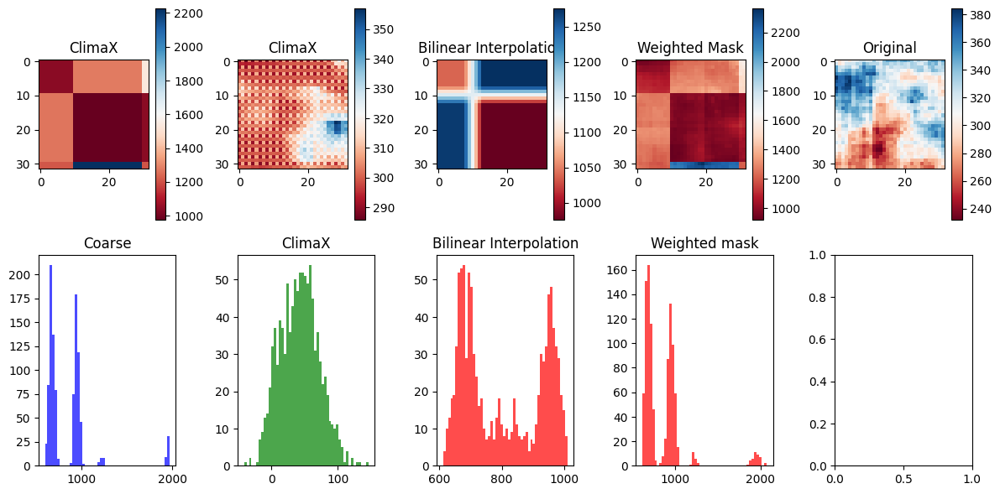

Time step 70
torch.Size([80, 1, 32, 32])


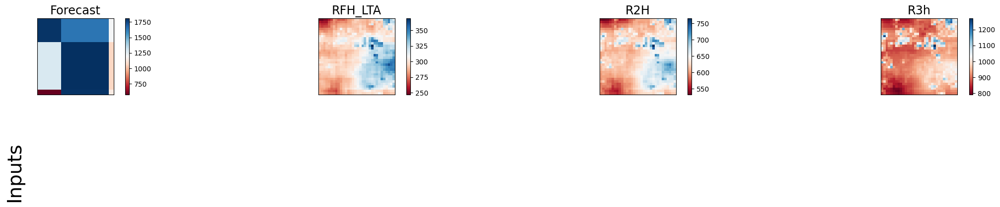

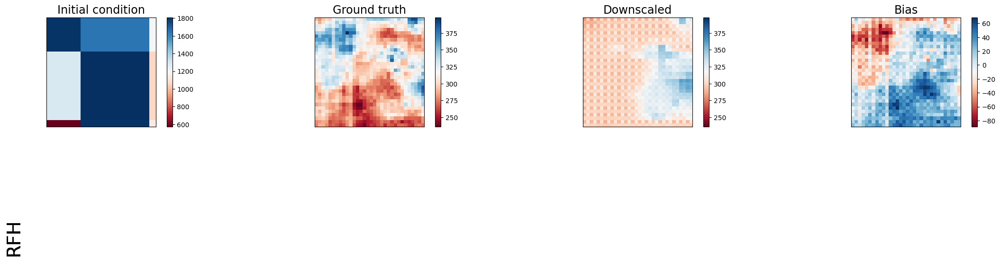

Selected device: cuda:0
+----------------------+----------------------+---------------------+------------------------+----------------------+
|                      | Coarse               | ClimaX              | Bilinear Interpolation | Weighted Mask        |
+----------------------+----------------------+---------------------+------------------------+----------------------+
| lat_weighted_mse_val | 1734046.875          | 951.890625          | 1851380.75             | 1765889.25           |
| lat_weighted_rmse    | 1316.8321533203125   | 30.852724075317383  | 1360.654541015625      | 1328.86767578125     |
| spearman             | -0.25645282186842205 | 0.08773369199294327 | -0.10717803105236222   | 0.031642509190465934 |
| mean_bias            | -1282.677490234375   | 4.36370849609375    | 1347.4169921875        | 1297.7818603515625   |
| pearson              | -0.32674314392856585 | 0.17813158285041    | 0.02283272089959324    | 0.04758668002590409  |
+----------------------+--------

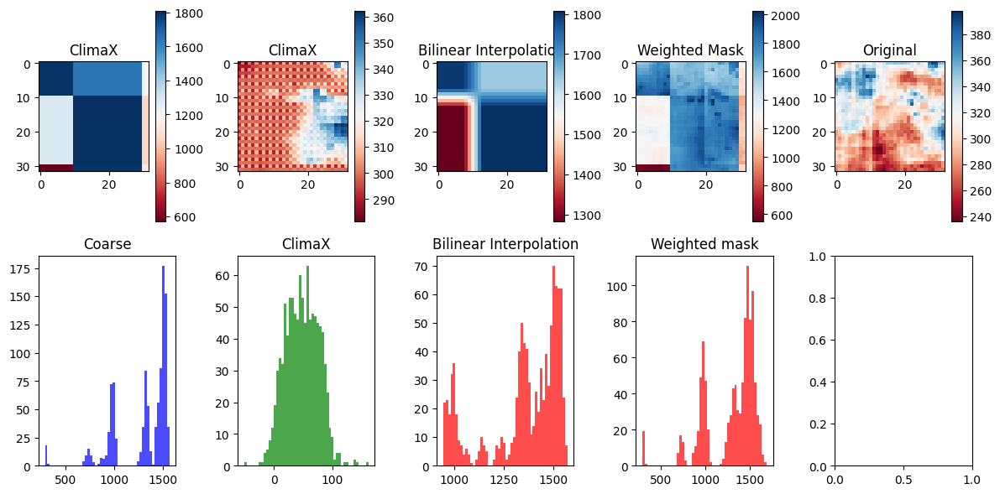

Time step 71
torch.Size([80, 1, 32, 32])


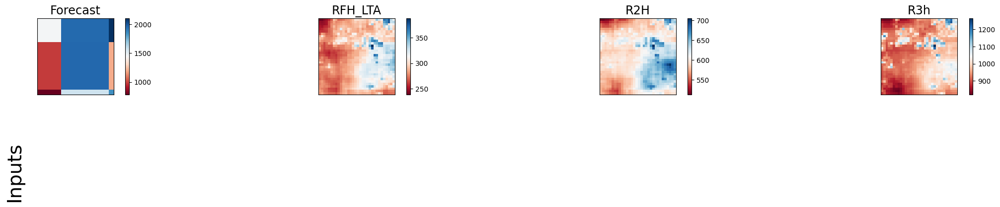

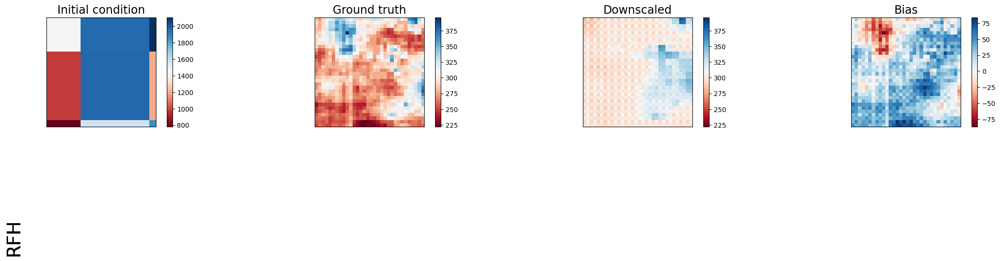

Selected device: cuda:0
+----------------------+---------------------+---------------------+------------------------+---------------------+
|                      | Coarse              | ClimaX              | Bilinear Interpolation | Weighted Mask       |
+----------------------+---------------------+---------------------+------------------------+---------------------+
| lat_weighted_mse_val | 1970185.625         | 1195.3802490234375  | 2097363.25             | 2044008.875         |
| lat_weighted_rmse    | 1403.633056640625   | 34.57427215576172   | 1448.2276611328125     | 1429.6883544921875  |
| spearman             | -0.3294552195113906 | 0.25673170000645046 | 0.07792680825265846    | 0.2236270459953607  |
| mean_bias            | -1332.059326171875  | 20.436248779296875  | 1398.126953125         | 1365.76318359375    |
| pearson              | -0.4735117877281919 | 0.31184133019645977 | 0.11852771947690194    | 0.16028394252465195 |
+----------------------+---------------------+--

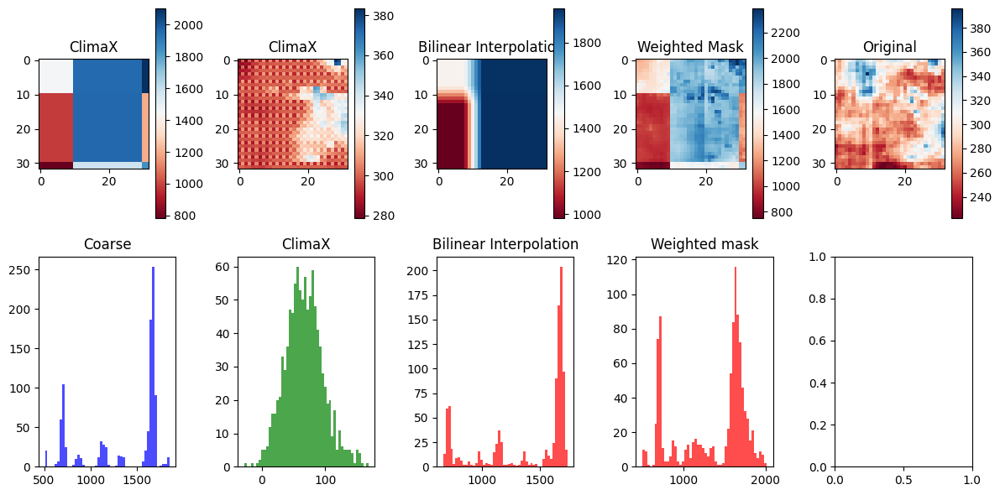

Time step 72
torch.Size([80, 1, 32, 32])


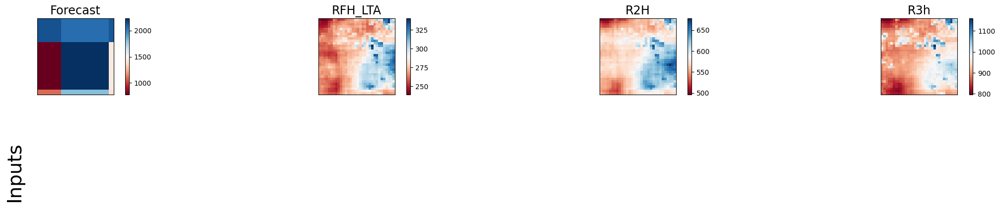

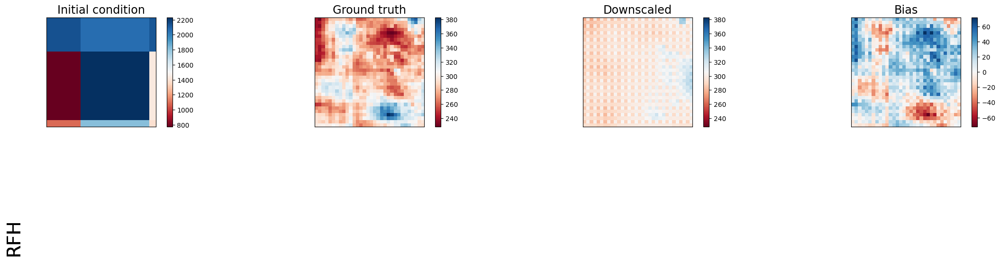

Selected device: cuda:0
+----------------------+---------------------+---------------------+------------------------+---------------------+
|                      | Coarse              | ClimaX              | Bilinear Interpolation | Weighted Mask       |
+----------------------+---------------------+---------------------+------------------------+---------------------+
| lat_weighted_mse_val | 2616775.25          | 674.05712890625     | 2747831.0              | 2693438.75          |
| lat_weighted_rmse    | 1617.64501953125    | 25.962610244750977  | 1657.6583251953125     | 1641.169921875      |
| spearman             | -0.3178663524316486 | 0.15303639155054302 | 0.12814859703307024    | 0.1808908305974856  |
| mean_bias            | -1507.0595703125    | 10.40997314453125   | 1569.41748046875       | 1539.4443359375     |
| pearson              | -0.4586276250197592 | 0.23026102141089574 | -0.004704472763874805  | 0.03516880109557746 |
+----------------------+---------------------+--

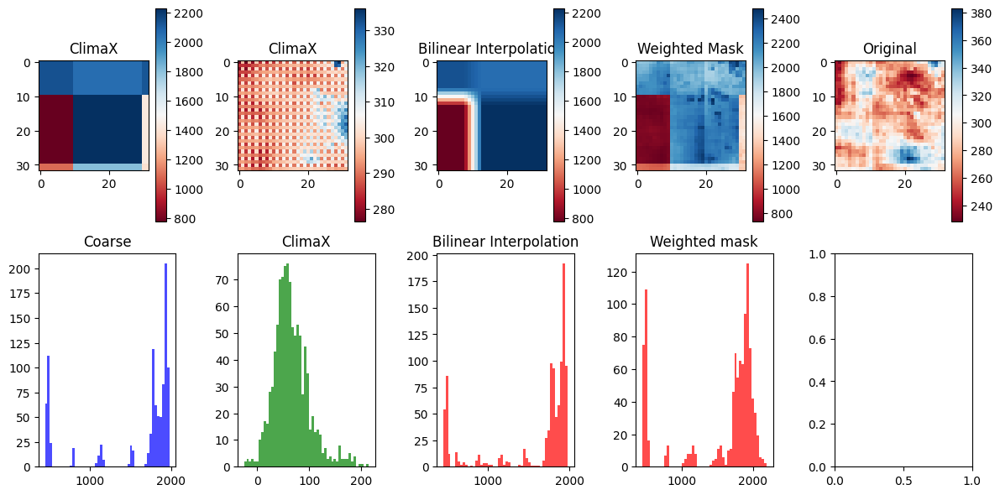

Time step 73
torch.Size([80, 1, 32, 32])


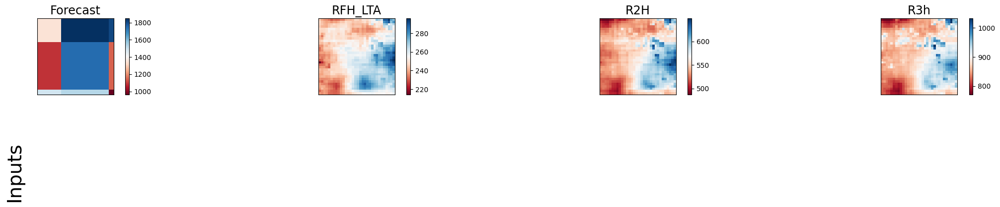

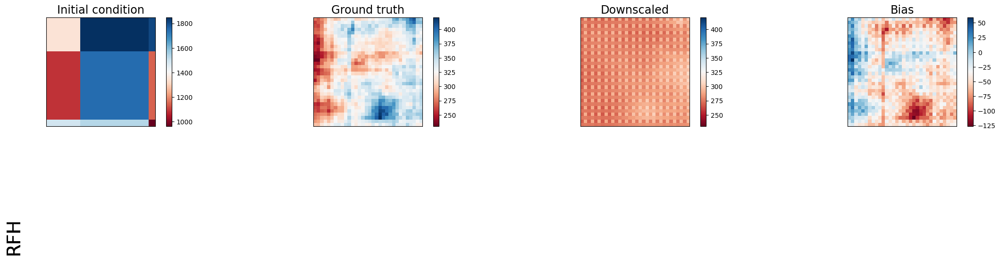

Selected device: cuda:0
+----------------------+---------------------+--------------------+------------------------+--------------------+
|                      | Coarse              | ClimaX             | Bilinear Interpolation | Weighted Mask      |
+----------------------+---------------------+--------------------+------------------------+--------------------+
| lat_weighted_mse_val | 1640520.0           | 2396.1845703125    | 1644024.0              | 1609833.125        |
| lat_weighted_rmse    | 1280.827880859375   | 48.95083999633789  | 1282.1949462890625     | 1268.7919921875    |
| spearman             | -0.5627809531688354 | 0.3527772973448323 | 0.4174047239693841     | 0.5445180201358377 |
| mean_bias            | -1239.3416748046875 | -39.9345703125     | 1254.858154296875      | 1236.3192138671875 |
| pearson              | -0.50433013029112   | 0.3687878029047364 | 0.5420334270779785     | 0.543852255386277  |
+----------------------+---------------------+------------------

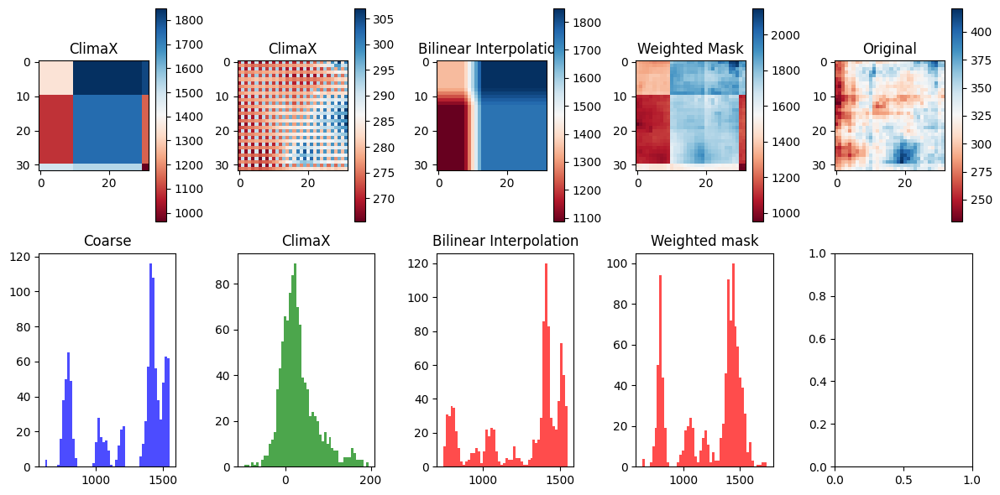

Time step 74
torch.Size([80, 1, 32, 32])


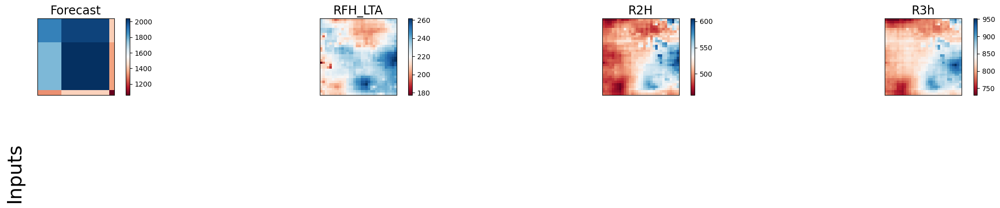

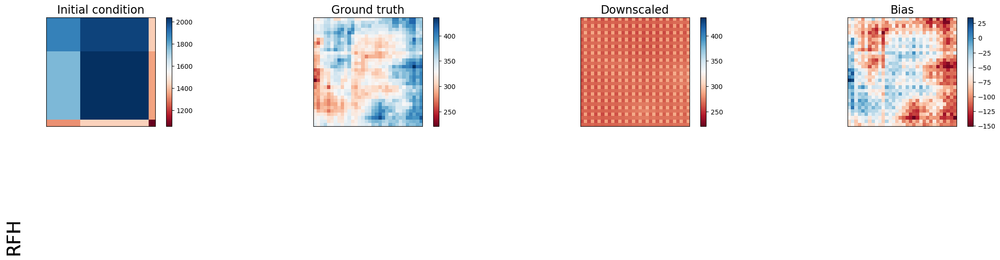

Selected device: cuda:0
+----------------------+----------------------+---------------------+------------------------+---------------------+
|                      | Coarse               | ClimaX              | Bilinear Interpolation | Weighted Mask       |
+----------------------+----------------------+---------------------+------------------------+---------------------+
| lat_weighted_mse_val | 2498082.0            | 5831.509765625      | 2609988.25             | 2432894.0           |
| lat_weighted_rmse    | 1580.5322265625      | 76.36431884765625   | 1615.5457763671875     | 1559.773681640625   |
| spearman             | -0.35448591886700553 | 0.20805913153669733 | 0.3338575860772092     | 0.2041177361775464  |
| mean_bias            | -1562.4775390625     | -69.174560546875    | 1612.7373046875        | 1542.873046875      |
| pearson              | -0.38405307197177563 | 0.15089020308191142 | 0.35683540754750775    | 0.04120156452165337 |
+----------------------+----------------

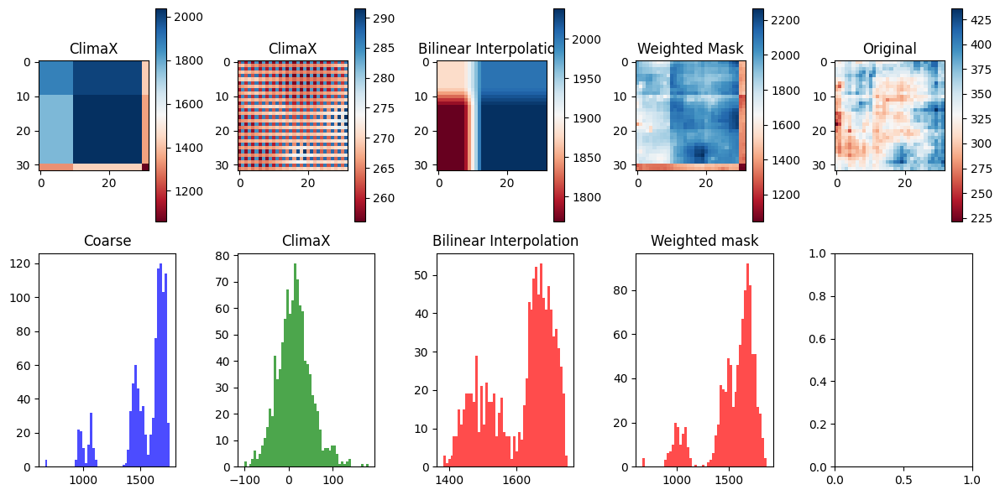

Time step 75
torch.Size([80, 1, 32, 32])


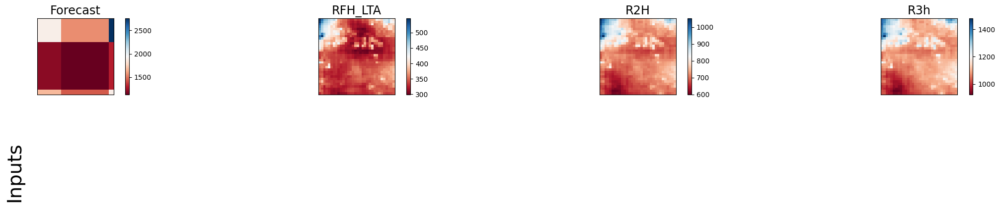

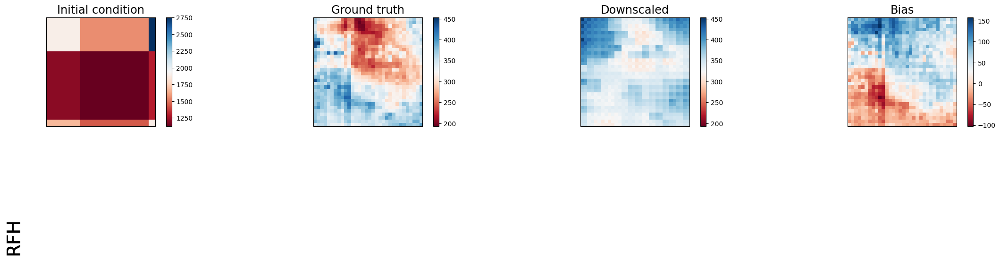

Selected device: cuda:0
+----------------------+----------------------+--------------------+------------------------+-----------------------+
|                      | Coarse               | ClimaX             | Bilinear Interpolation | Weighted Mask         |
+----------------------+----------------------+--------------------+------------------------+-----------------------+
| lat_weighted_mse_val | 1204211.75           | 3489.82470703125   | 1081287.875            | 1211359.875           |
| lat_weighted_rmse    | 1097.3658447265625   | 59.074737548828125 | 1039.8499755859375     | 1100.617919921875     |
| spearman             | -0.08470498272001148 | 0.2318690763709475 | -0.21378972288371056   | -0.03147806160316667  |
| mean_bias            | -1046.476806640625   | 33.259552001953125 | 1006.0670166015625     | 1046.476806640625     |
| pearson              | -0.1298529575807306  | 0.2506432810973477 | -0.29383107092087946   | -0.027419767828816444 |
+----------------------+--------

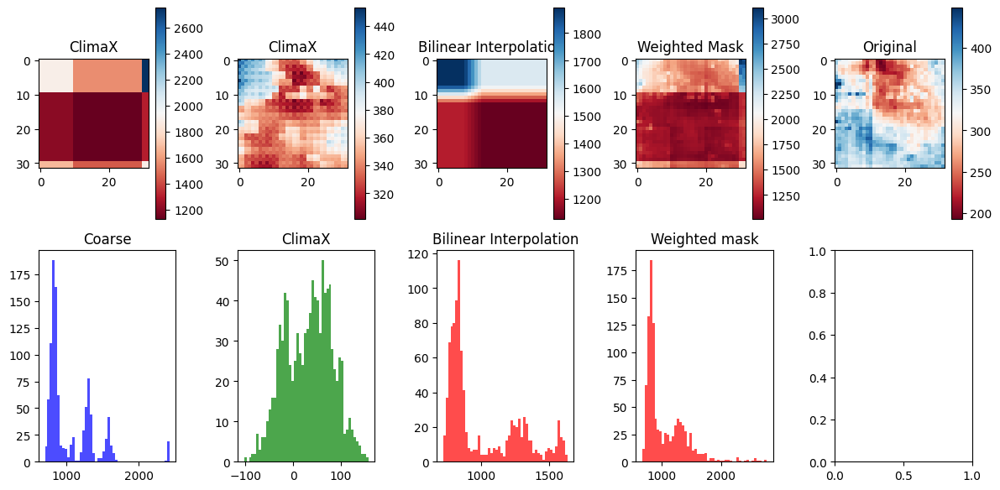

Time step 76
torch.Size([80, 1, 32, 32])


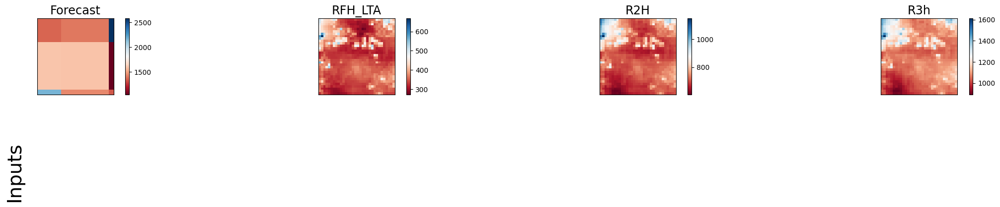

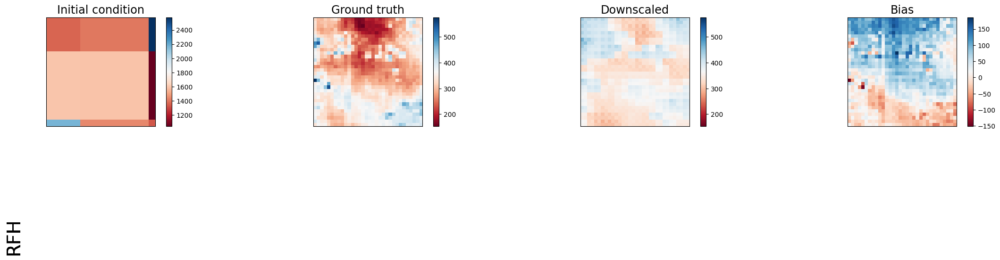

Selected device: cuda:0
+----------------------+--------------------+---------------------+------------------------+---------------------+
|                      | Coarse             | ClimaX              | Bilinear Interpolation | Weighted Mask       |
+----------------------+--------------------+---------------------+------------------------+---------------------+
| lat_weighted_mse_val | 1514798.375        | 4708.20947265625    | 1462919.5              | 1542019.0           |
| lat_weighted_rmse    | 1230.771484375     | 68.61639404296875   | 1209.5120849609375     | 1241.780517578125   |
| spearman             | 0.4091093121255853 | 0.4216891397995839  | 0.30087879002230594    | 0.45667330412156937 |
| mean_bias            | -1212.069091796875 | 42.739166259765625  | 1206.08544921875       | 1216.2584228515625  |
| pearson              | 0.1865957551156998 | 0.46056169918044343 | 0.30959064173772344    | 0.3972601359402249  |
+----------------------+--------------------+-----------

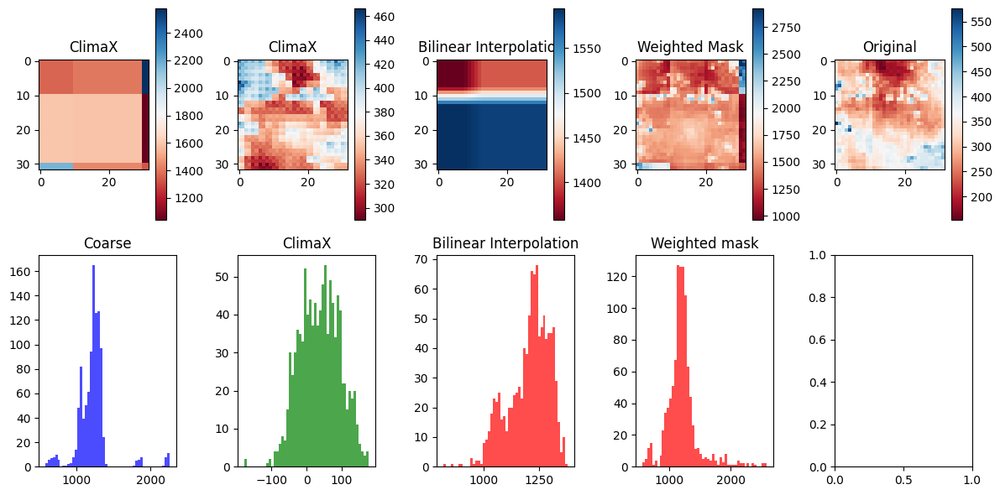

Time step 77
torch.Size([80, 1, 32, 32])


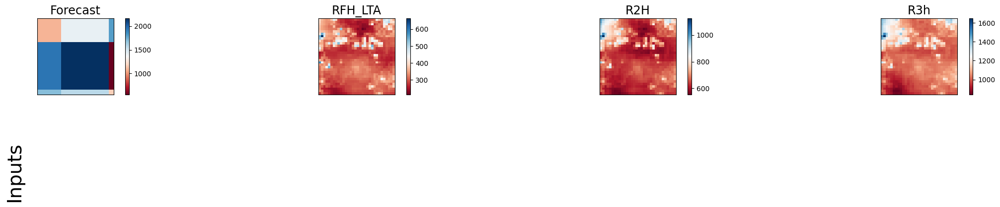

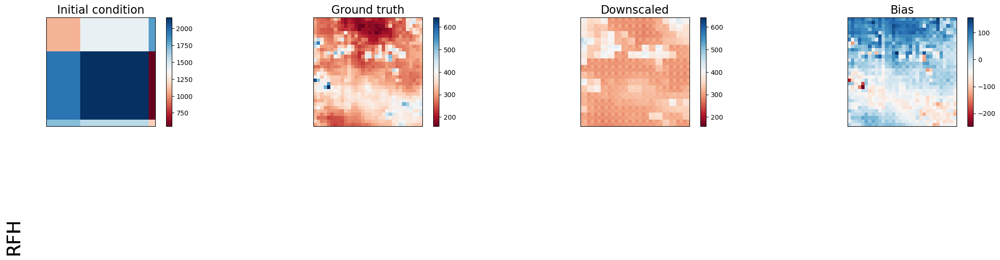

Selected device: cuda:0
+----------------------+---------------------+---------------------+------------------------+--------------------+
|                      | Coarse              | ClimaX              | Bilinear Interpolation | Weighted Mask      |
+----------------------+---------------------+---------------------+------------------------+--------------------+
| lat_weighted_mse_val | 2274701.25          | 3236.530517578125   | 2411151.25             | 2325282.5          |
| lat_weighted_rmse    | 1508.2113037109375  | 56.8905143737793    | 1552.7882080078125     | 1524.8876953125    |
| spearman             | 0.09047383174469699 | 0.47373256441918227 | 0.4025833494144064     | 0.6110835848116436 |
| mean_bias            | -1442.2838134765625 | 9.696075439453125   | 1513.750244140625      | 1447.9556884765625 |
| pearson              | 0.14409864935197686 | 0.4643512234675522  | 0.3864385337486318     | 0.5670428524182363 |
+----------------------+---------------------+----------

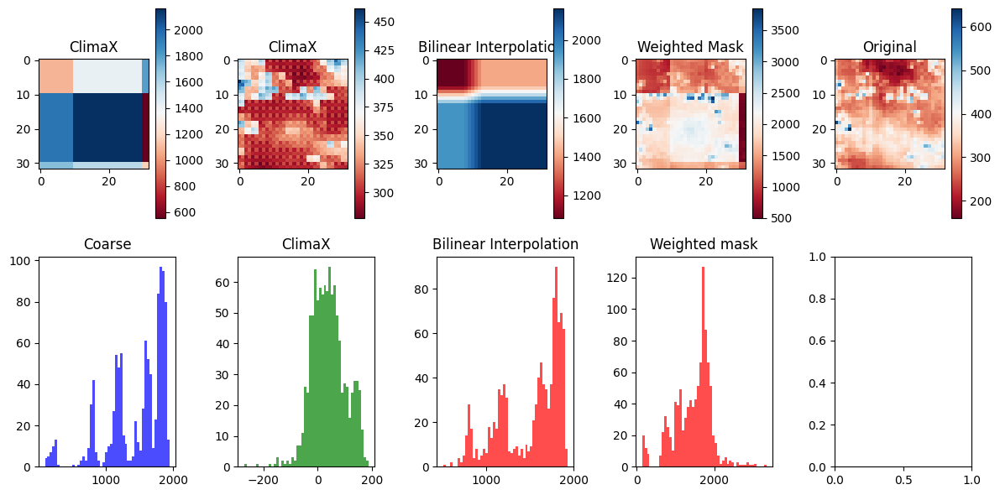

Time step 78
torch.Size([80, 1, 32, 32])


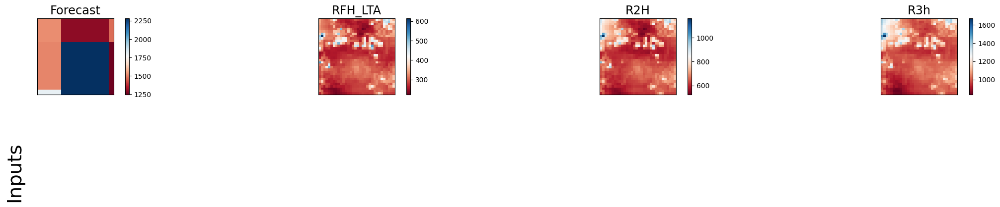

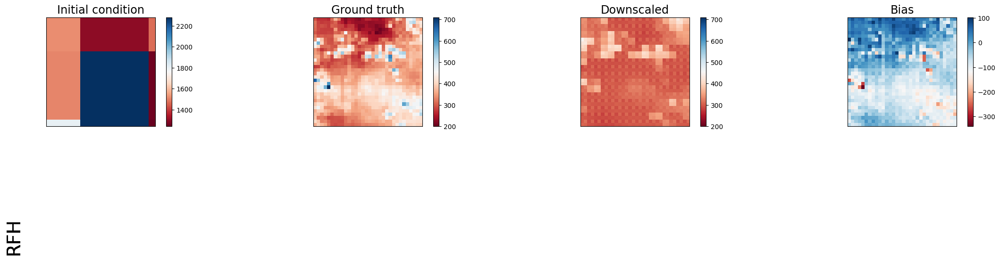

Selected device: cuda:0
+----------------------+---------------------+---------------------+------------------------+--------------------+
|                      | Coarse              | ClimaX              | Bilinear Interpolation | Weighted Mask      |
+----------------------+---------------------+---------------------+------------------------+--------------------+
| lat_weighted_mse_val | 2358071.0           | 5660.1943359375     | 2226108.5              | 2255984.5          |
| lat_weighted_rmse    | 1535.6011962890625  | 75.23426055908203   | 1492.014892578125      | 1501.9935302734375 |
| spearman             | 0.10859089997952227 | 0.42258173618034844 | 0.442830608043511      | 0.6439749713254741 |
| mean_bias            | -1473.3602294921875 | -45.070068359375    | 1444.2093505859375     | 1432.047607421875  |
| pearson              | 0.06792909672643448 | 0.43219147462967444 | 0.4083134462326035     | 0.6333360781697074 |
+----------------------+---------------------+----------

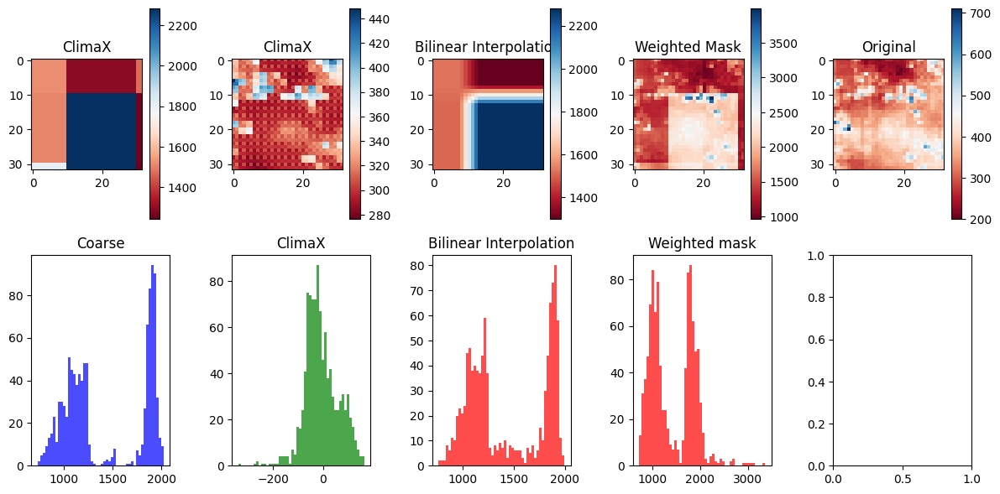

Time step 79
torch.Size([80, 1, 32, 32])


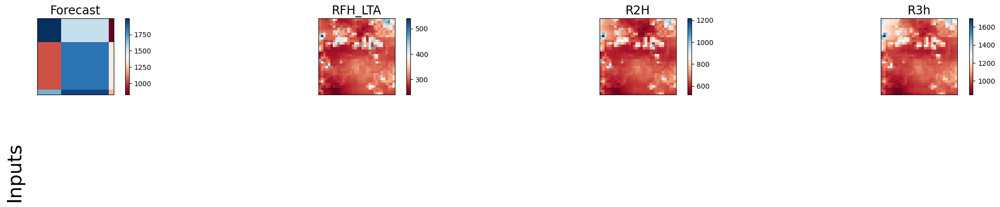

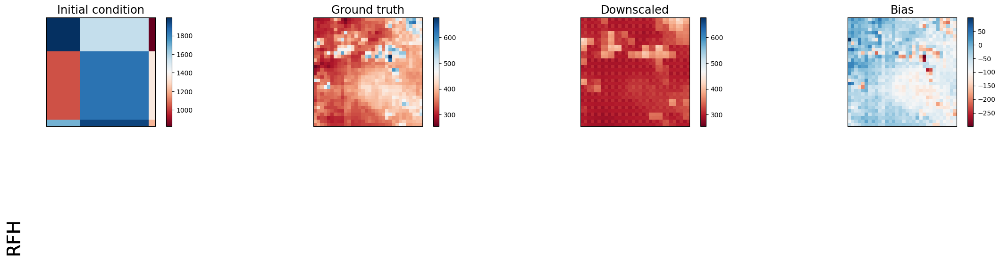

Selected device: cuda:0
+----------------------+----------------------+--------------------+------------------------+--------------------+
|                      | Coarse               | ClimaX             | Bilinear Interpolation | Weighted Mask      |
+----------------------+----------------------+--------------------+------------------------+--------------------+
| lat_weighted_mse_val | 1776710.0            | 5610.33740234375   | 1619526.75             | 1639483.5          |
| lat_weighted_rmse    | 1332.932861328125    | 74.90218353271484  | 1272.6063232421875     | 1280.4232177734375 |
| spearman             | -0.2057989690136335  | 0.6405384228120792 | 0.24763822094167862    | 0.4145388182625977 |
| mean_bias            | -1282.2626953125     | -60.7598876953125  | 1238.571533203125      | 1225.4892578125    |
| pearson              | -0.29383797696300873 | 0.6504372872704534 | 0.2722930099842993     | 0.4575681557129651 |
+----------------------+----------------------+---------

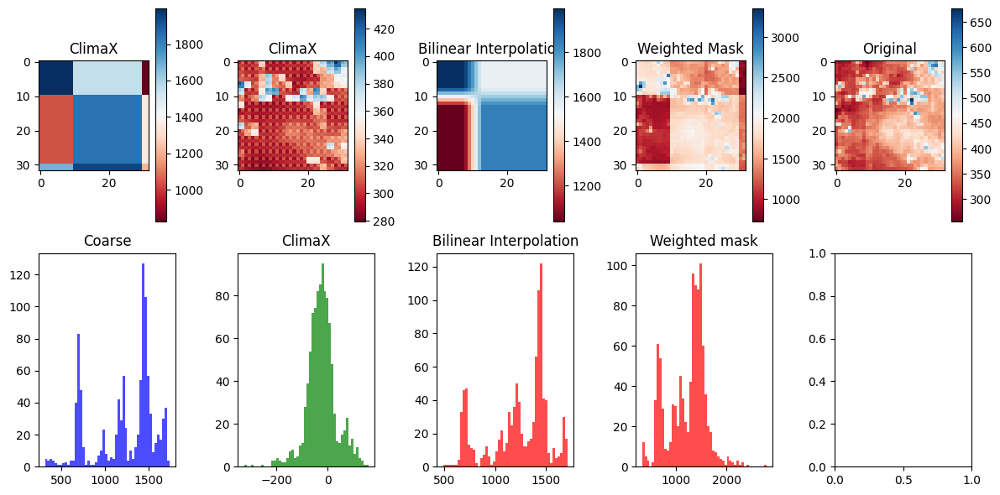

In [11]:
for t in range(timesteps):
    print("Time step",t)
    print(gt.shape)
    plot_inputs(tensors, var_name, pred_task,t)
    plot_pred(tensors_pred, var_name, pred_task,t)


    bilinear_inter = bilinear_interpolate(forecast[t].unsqueeze(dim=0))
    weighted_mask = Downscale_Weight(rfh_lta[t].cpu().numpy(),forecast[t].cpu().numpy(), verbose=False)

    compare_results(gt, forecast, pred , bilinear_inter, weighted_mask, model,t,denormalize_out)
    plot_compare(gt, forecast, pred, bilinear_inter, weighted_mask,t,denormalize_out)


# Compare Members

## variability Members in one block

In [126]:
def plot_members(tensors):
    index = 0
    
    timesteps = tensors[0].shape[0]
    print(timesteps)
    
    for t in range(0,timesteps,5):
        print(t)
        
        fig, axes = plt.subplots(1, 6, figsize=(24, 2))  # You can adjust the figure size as needed
        
        # Plot your data in each subplot
        im0 = axes[0].imshow(tensors[0][t,0], cmap=plt.cm.RdBu)
        im1 = axes[1].imshow(tensors[1][t,0], cmap=plt.cm.RdBu)
        im2 = axes[2].imshow(tensors[1][t+1,0], cmap=plt.cm.RdBu)
        im3 = axes[3].imshow(tensors[1][t+2,0], cmap=plt.cm.RdBu)
        im4 = axes[4].imshow(tensors[1][t+3,0], cmap=plt.cm.RdBu)
        im5 = axes[5].imshow(tensors[1][t+4,0], cmap=plt.cm.RdBu)

        # Set titles for each subplot
        axes[0].set_title(f'Ground Truth - Time Step {t}')
        axes[1].set_title(f'Downscaled  - Time Step {t} member 1')
        axes[2].set_title(f'Downscaled  - Time Step {t} member 2')
        axes[3].set_title(f'Downscaled  - Time Step {t} member 3')
        axes[4].set_title(f'Downscaled  - Time Step {t} member 4')
        axes[5].set_title(f'Downscaled  - Time Step {t} member 5')

        # Add colorbars
        cbar0 = fig.colorbar(im0, ax=axes[0])
        cbar1 = fig.colorbar(im1, ax=axes[1])
        cbar2 = fig.colorbar(im2, ax=axes[2])
        cbar3 = fig.colorbar(im3, ax=axes[3])
        cbar4 = fig.colorbar(im4, ax=axes[4])
        cbar5 = fig.colorbar(im5, ax=axes[5])

        # Adjust spacing between subplots
        plt.tight_layout()

        plt.show()
        
        
        
# Est ce que ClimaX enleve la variabilité des differnet members
    
    

    

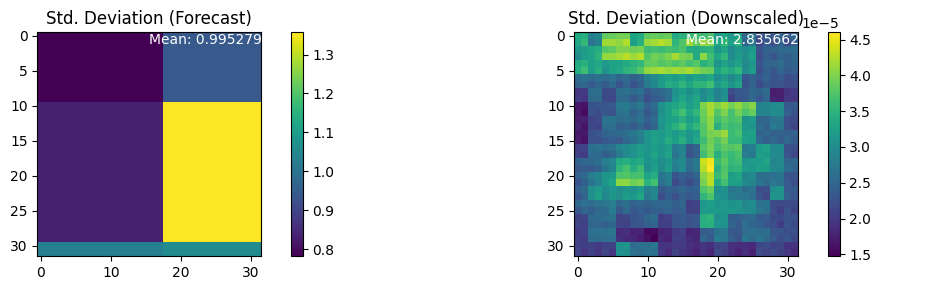

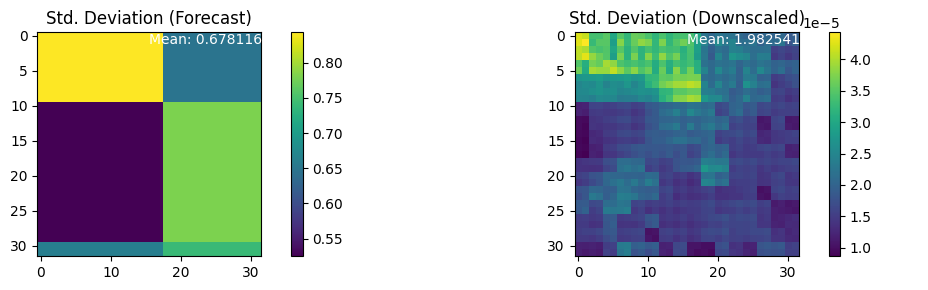

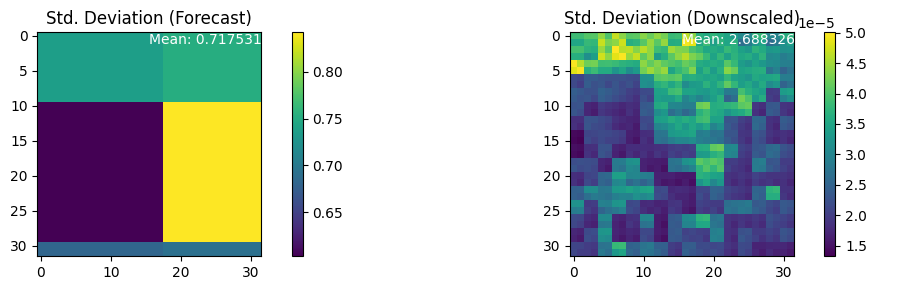

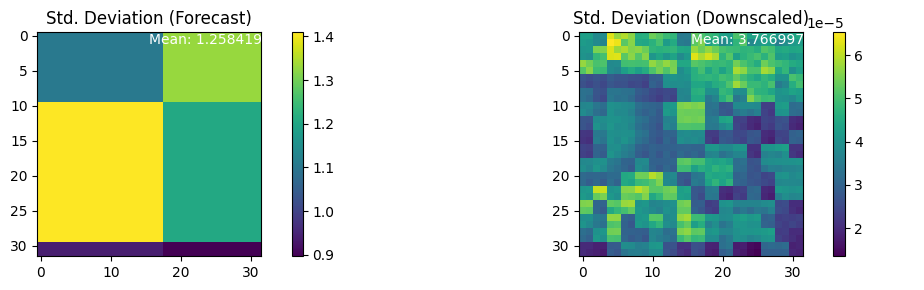

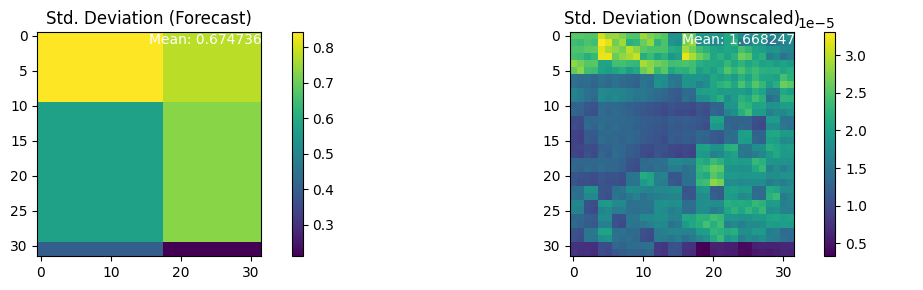

...

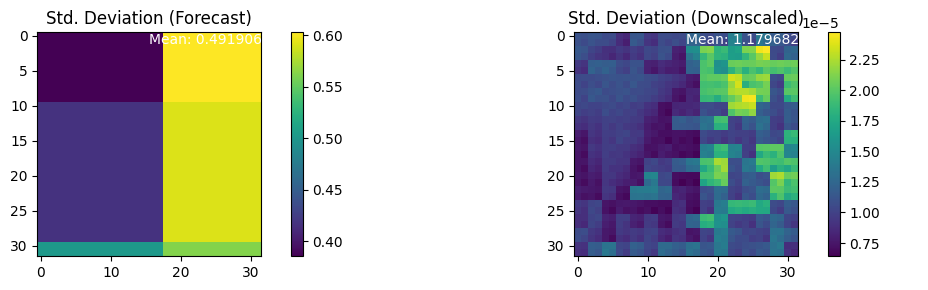

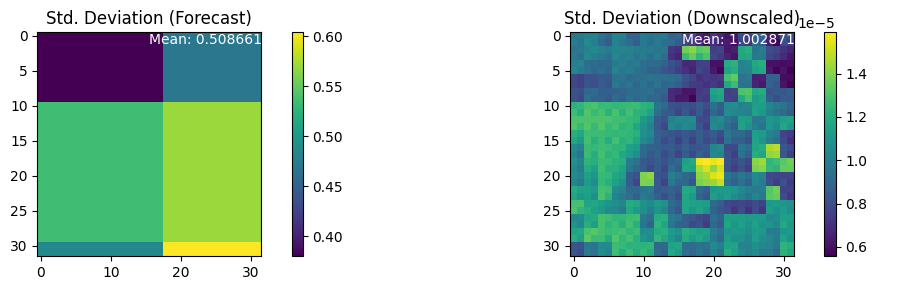

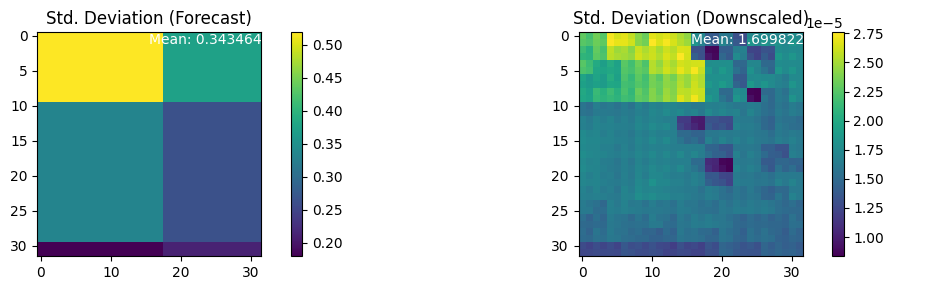

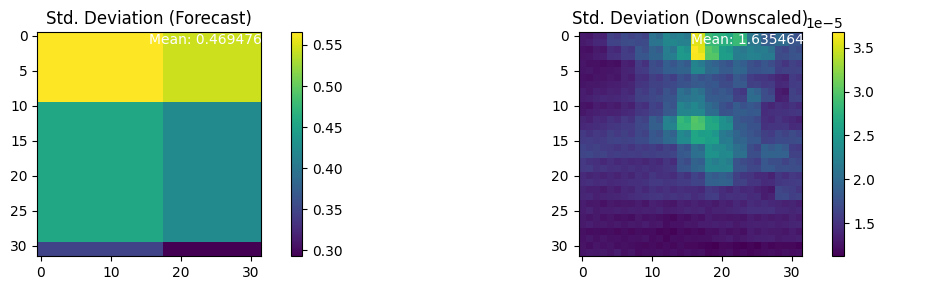

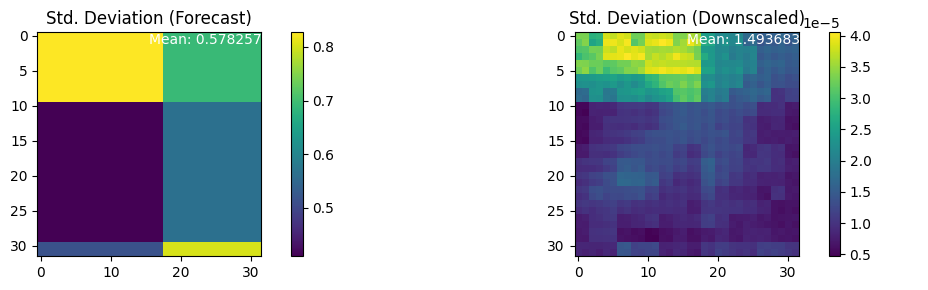

In [132]:
import torch
import matplotlib.pyplot as plt

# Assuming you have 'init_cond_normalized' and 'pred_normalized' as PyTorch tensors
t_step = 5  # Step size for iteration

for t in range(0, init_cond.shape[0], t_step):
    subarray_forecast = init_cond_normalized[t:t + t_step]
    subarray_downscaled = pred_normalized[t:t + t_step, 0]

    std_image_forecast = torch.std(subarray_forecast, dim=0)
    std_image_downscaled = torch.std(subarray_downscaled, dim=0)
    
    # Calculate the mean of std_image_forecast and std_image_downscaled
    mean_std_forecast = std_image_forecast.mean().item()
    mean_std_downscaled = std_image_downscaled.mean().item()

    # Create subplots with two columns
    fig, axs = plt.subplots(1, 2, figsize=(12, 3))

    # Display std_image_forecast on the first subplot
    axs[0].imshow(std_image_forecast)
    axs[0].set_title('Std. Deviation (Forecast)')
    cbar = plt.colorbar(axs[0].imshow(std_image_forecast), ax=axs[0])
    axs[0].text(0.5, 0.95, f"Mean: {mean_std_forecast}", transform=axs[0].transAxes, color='white')
    
    # Display std_image_downscaled on the second subplot
    axs[1].imshow(std_image_downscaled)
    axs[1].set_title('Std. Deviation (Downscaled)')
    cbar = plt.colorbar(axs[1].imshow(std_image_downscaled), ax=axs[1])
    axs[1].text(0.5, 0.95, f"Mean: {mean_std_downscaled}", transform=axs[1].transAxes, color='white')

    plt.tight_layout()
    plt.show()


80
0


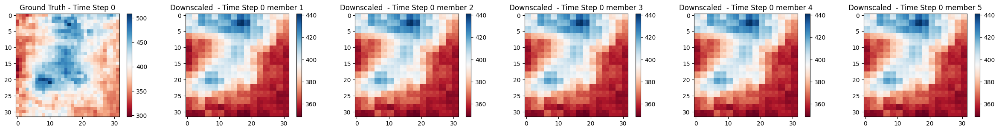

5


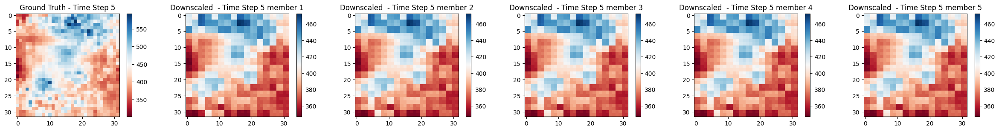

10


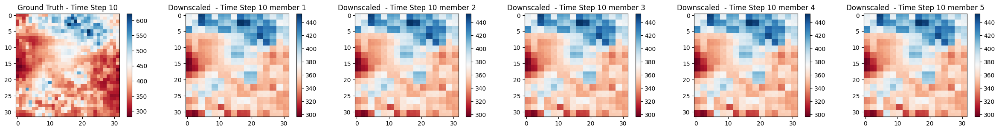

15


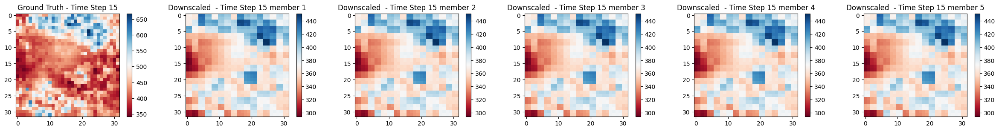

20


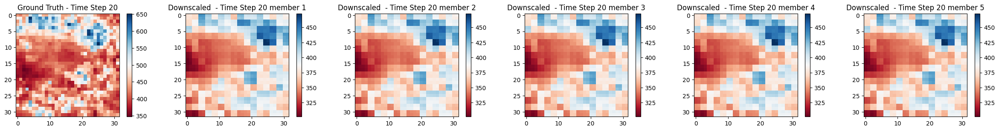

25


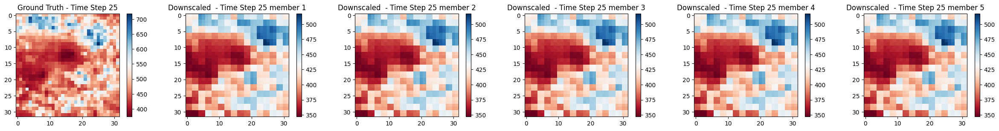

30


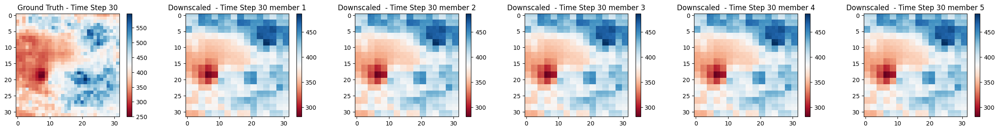

35


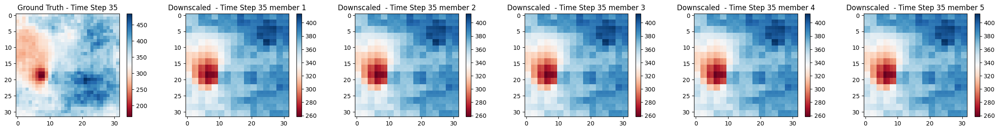

40


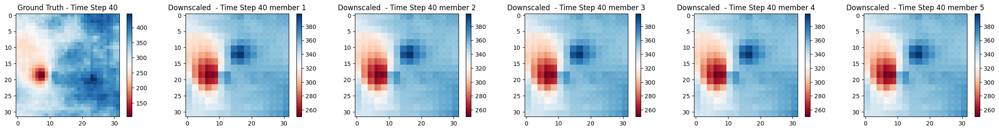

45


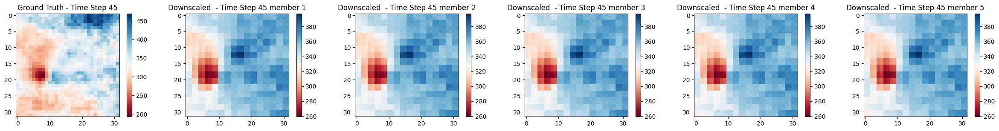

50


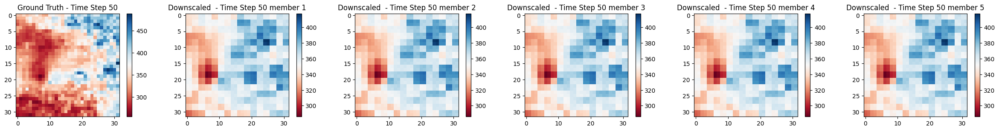

55


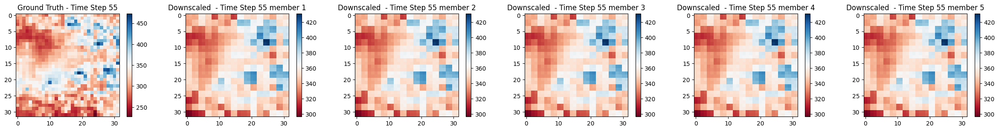

60


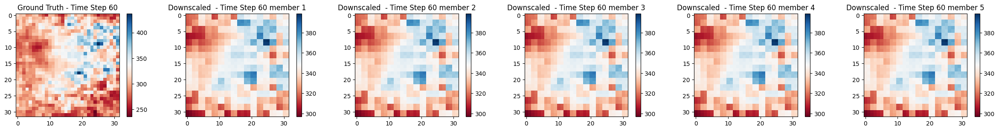

65


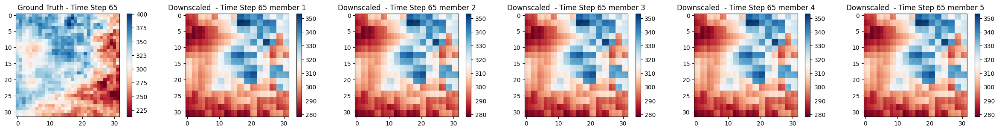

70


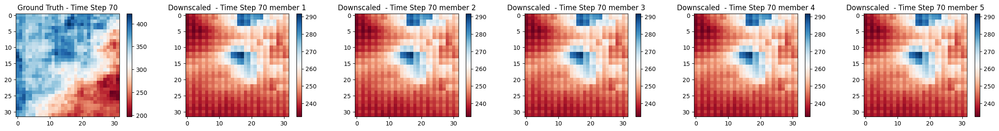

75


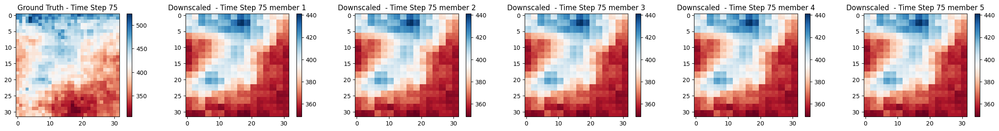

In [52]:
tensors_inp = [gt.cpu().numpy() , pred.cpu().numpy()]
tensors_out = [gt.cpu().numpy() , pred.cpu().numpy()]
plot_members(tensors, tensors_inp)

## variability Member after Member

In [126]:
def plot_members(tensors):
    index = 0
    
    timesteps = tensors[0].shape[0]
    print(timesteps)
    
    for t in range(0,timesteps,5):
        print(t)
        
        fig, axes = plt.subplots(1, 6, figsize=(24, 2))  # You can adjust the figure size as needed
        
        # Plot your data in each subplot
        im0 = axes[0].imshow(tensors[0][t,0], cmap=plt.cm.RdBu)
        im1 = axes[1].imshow(tensors[1][t,0], cmap=plt.cm.RdBu)
        im2 = axes[2].imshow(tensors[1][t+1,0], cmap=plt.cm.RdBu)
        im3 = axes[3].imshow(tensors[1][t+2,0], cmap=plt.cm.RdBu)
        im4 = axes[4].imshow(tensors[1][t+3,0], cmap=plt.cm.RdBu)
        im5 = axes[5].imshow(tensors[1][t+4,0], cmap=plt.cm.RdBu)

        # Set titles for each subplot
        axes[0].set_title(f'Ground Truth - Time Step {t}')
        axes[1].set_title(f'Downscaled  - Time Step {t} member 1')
        axes[2].set_title(f'Downscaled  - Time Step {t} member 2')
        axes[3].set_title(f'Downscaled  - Time Step {t} member 3')
        axes[4].set_title(f'Downscaled  - Time Step {t} member 4')
        axes[5].set_title(f'Downscaled  - Time Step {t} member 5')

        # Add colorbars
        cbar0 = fig.colorbar(im0, ax=axes[0])
        cbar1 = fig.colorbar(im1, ax=axes[1])
        cbar2 = fig.colorbar(im2, ax=axes[2])
        cbar3 = fig.colorbar(im3, ax=axes[3])
        cbar4 = fig.colorbar(im4, ax=axes[4])
        cbar5 = fig.colorbar(im5, ax=axes[5])

        # Adjust spacing between subplots
        plt.tight_layout()

        plt.show()
        
        
        
# Est ce que ClimaX enleve la variabilité des differnet members
    
    

    

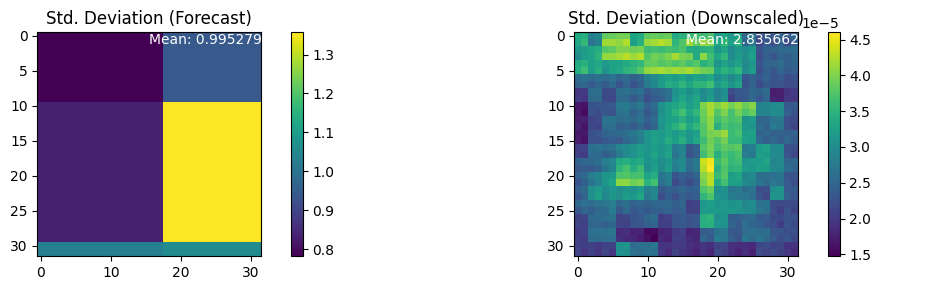

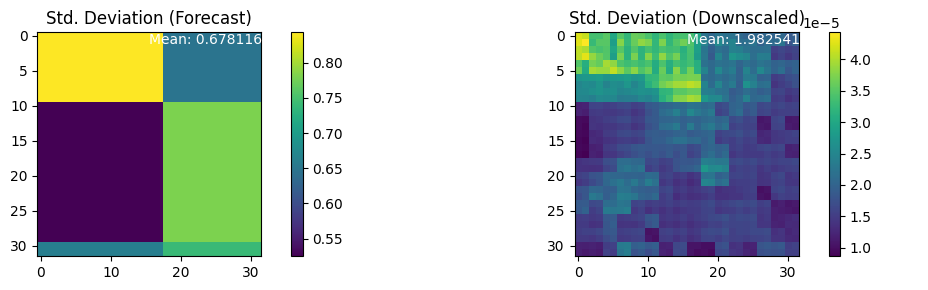

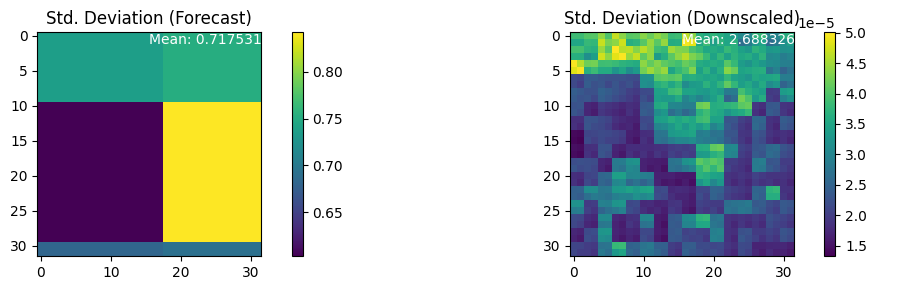

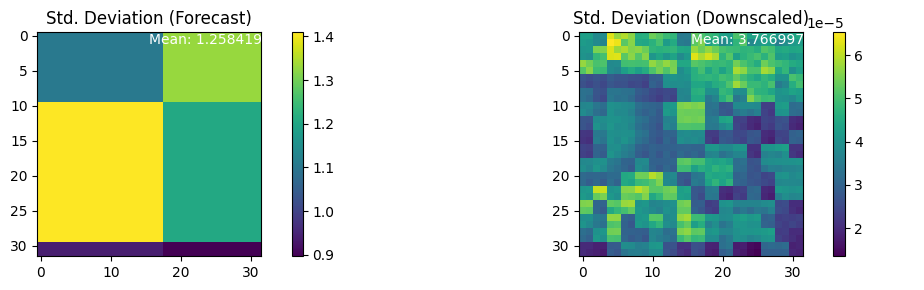

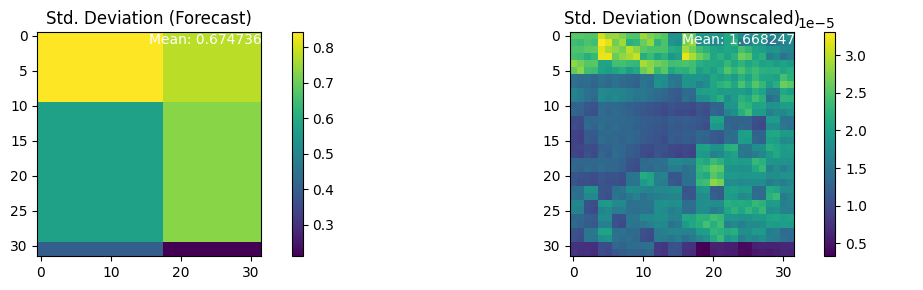

...

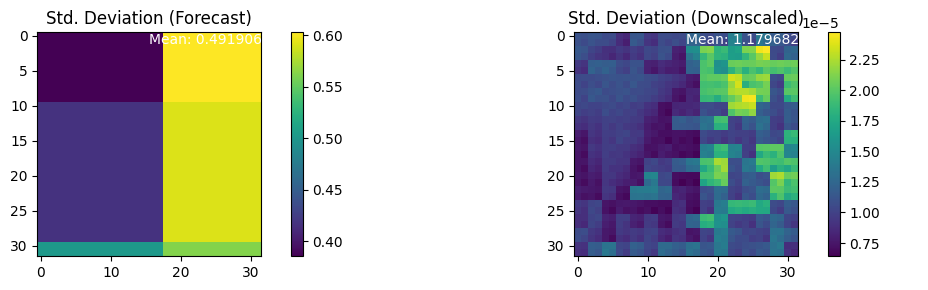

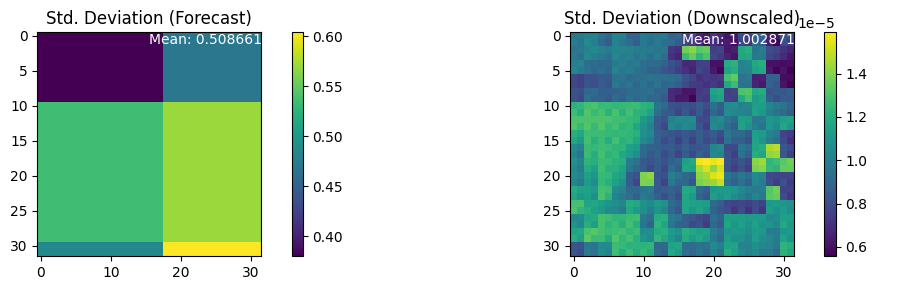

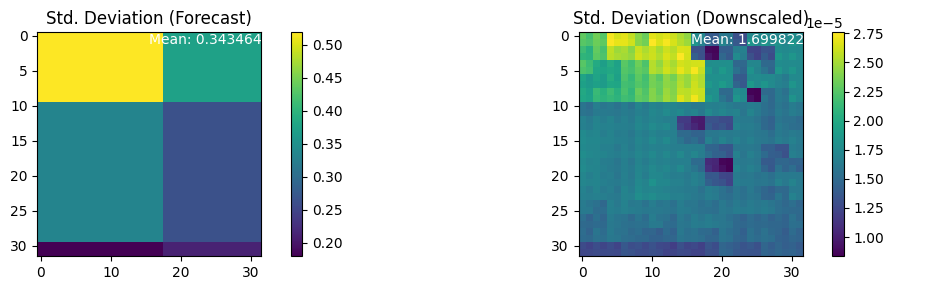

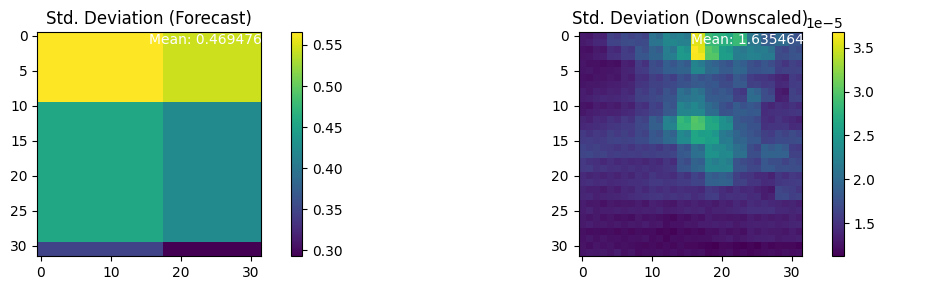

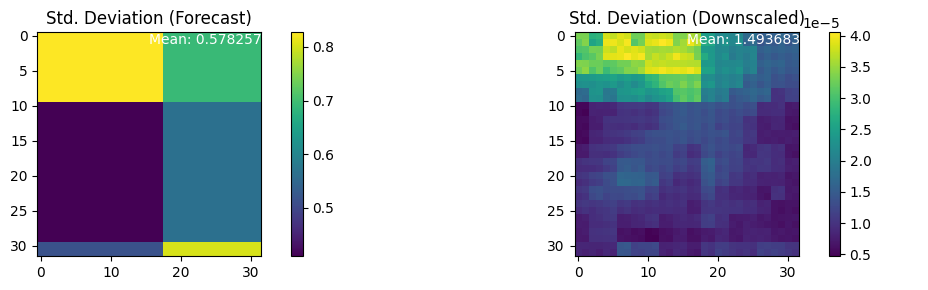

In [132]:
import torch
import matplotlib.pyplot as plt

# Assuming you have 'init_cond_normalized' and 'pred_normalized' as PyTorch tensors
t_step = 5  # Step size for iteration

for t in range(0, init_cond.shape[0], t_step):
    subarray_forecast = init_cond_normalized[t:t + t_step]
    subarray_downscaled = pred_normalized[t:t + t_step, 0]

    std_image_forecast = torch.std(subarray_forecast, dim=0)
    std_image_downscaled = torch.std(subarray_downscaled, dim=0)
    
    # Calculate the mean of std_image_forecast and std_image_downscaled
    mean_std_forecast = std_image_forecast.mean().item()
    mean_std_downscaled = std_image_downscaled.mean().item()

    # Create subplots with two columns
    fig, axs = plt.subplots(1, 2, figsize=(12, 3))

    # Display std_image_forecast on the first subplot
    axs[0].imshow(std_image_forecast)
    axs[0].set_title('Std. Deviation (Forecast)')
    cbar = plt.colorbar(axs[0].imshow(std_image_forecast), ax=axs[0])
    axs[0].text(0.5, 0.95, f"Mean: {mean_std_forecast}", transform=axs[0].transAxes, color='white')
    
    # Display std_image_downscaled on the second subplot
    axs[1].imshow(std_image_downscaled)
    axs[1].set_title('Std. Deviation (Downscaled)')
    cbar = plt.colorbar(axs[1].imshow(std_image_downscaled), ax=axs[1])
    axs[1].text(0.5, 0.95, f"Mean: {mean_std_downscaled}", transform=axs[1].transAxes, color='white')

    plt.tight_layout()
    plt.show()


80
0


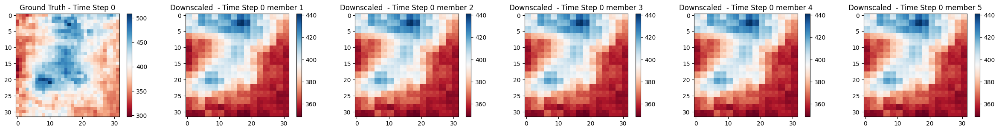

5


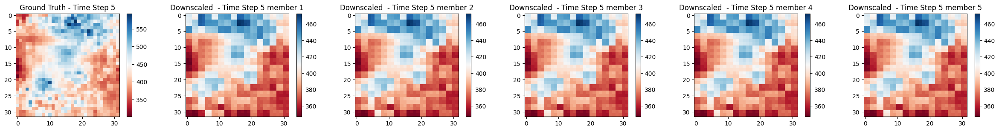

10


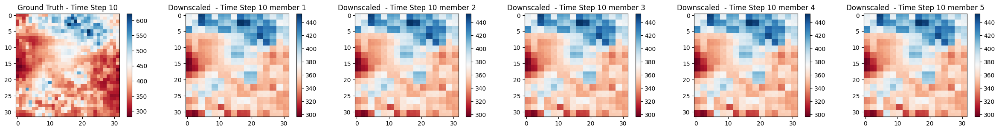

15


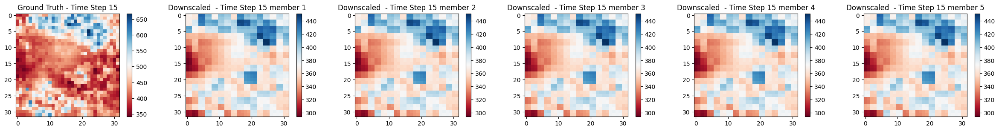

20


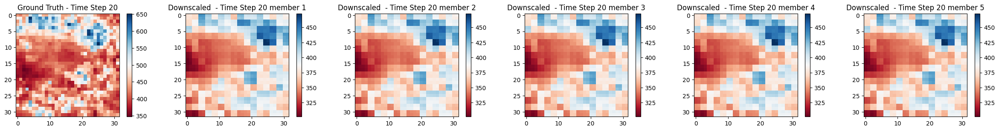

25


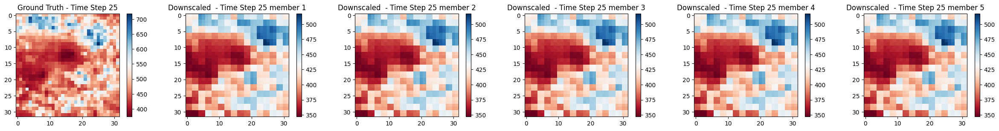

30


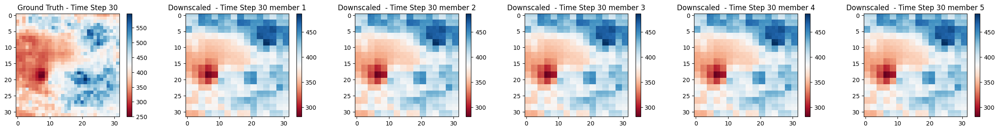

35


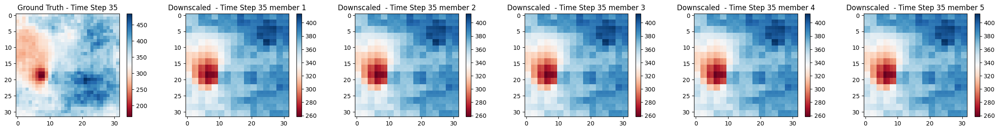

40


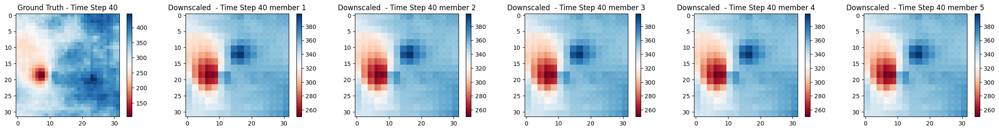

45


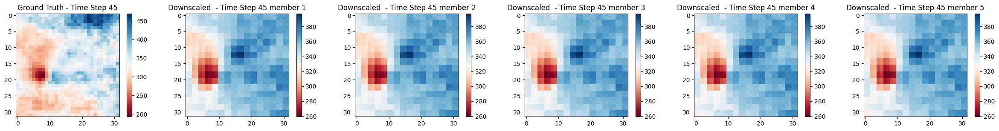

50


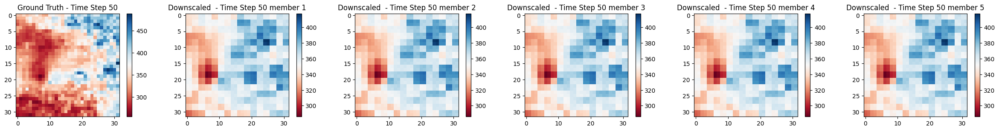

55


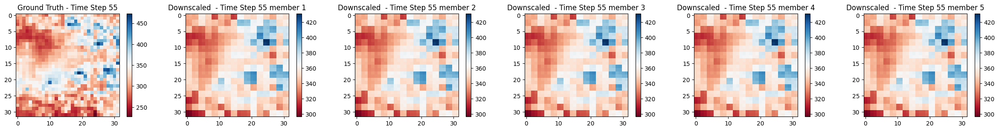

60


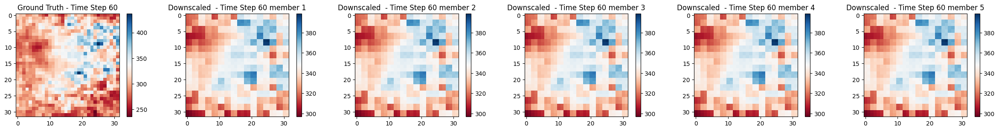

65


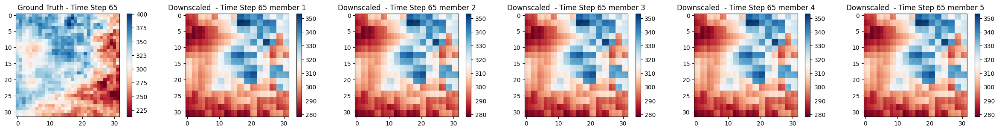

70


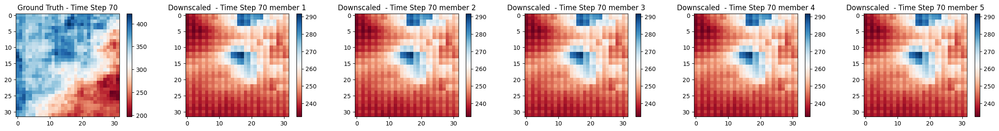

75


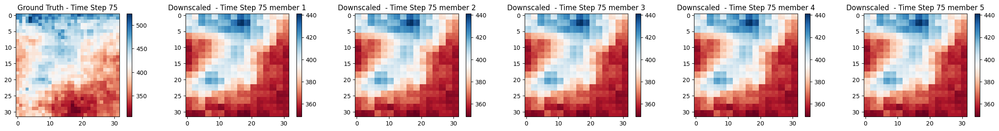

In [52]:
tensors_inp = [gt.cpu().numpy() , pred.cpu().numpy()]
tensors_out = [gt.cpu().numpy() , pred.cpu().numpy()]
plot_members(tensors, tensors_inp)